<a href="https://colab.research.google.com/github/arpanbiswas52/varTBO/blob/main/dKLBO_spectral_(Notebookversion).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **dKLBO Spectral**
Jan, 2023

This is the physics-driven, human-augmented, dynamic, dkl-BO recommder system framework for automated experiement with microscope. (Colab Version)


## *   Rama Vasudevan proposed the idea
## *   Maxim Ziatdinov developed deep learning kernel function in AtomAI (Python) library
## *   Arpan Biswas developed the architecture of dKLBO spectral recommder system 
## *   Arpan Biswas, Rama Vasudevan, Yongtao Liu adapted to make it compatible with microscopy measurement



#Problem Description
Build a BO framework-

Here we have a image data, where X is the input location of the image

Each location in the image, we have a spectral data, from where user select if the data is good/bad (discrete choice). We take the means of all good spectral only to generate the target spectral.

At the mid of execution, the user also have option to either eliminate (or update the preferance) all the previously stored (if user suddenly find a desired spectral) spectral, and put more weights on new found spectral.

The goal is to build a optimization (BO) model where we adaptively sample towards region (in image) of good spectral, and find optimal location point closest to the current chosen target spectral (as per user voting).

#Workflow: Run BO to find the optimal location for user-desired spectral as per voting
Here we vote the quality of spectral

User interaction part:

During the play (for each function evaluation)-

- View spectral image. User have three rating options as 0, 1, 2: 0-Bad, 1-Good, 2-Very good. **To answer 0-Bad spectral, user can just jit ENTER to save time**

- If user rated as Good or Very Good, and user already have a current target spectral (user already selected at least one good/very good spectral in earlier iterations), another message pops up if the user want to update preference of new spectral Vs the current target spectral(Y or N). **To answer No, user can just jit ENTER to save time**

  - If user choose "Y", user have option (any number between 0-10) to provide weights of new spectral. For example: If user provide 10 as input, the updated target spectral will be only the new chosen spectral and all the other earlier selected good spectral will be eliminated from target.

  - If user choose "N", as default the updated target spectral is the mean of all the earlier selected spectral and the new spectral.

- User will get prompt at each BO iteration if they are satisfied with current target spectral or need further updating(Y or N). **To answer No, user can just jit ENTER to save time**

  - If user select Y, target spectral will be updated as per voting of new spectral and **human-guided dynamic objective evaluation** will be conducted

  - If user select N, target spectral will be fixed and an **automated objective evaluation** will be conducted for future BO iteration (like normal BO and no further prompt of target updating)


After END OF PLAY, the code automatically save below data (serially) in optim.results.npy

- Best locations, from evaluated samples and GP estimated

- User rating of spectral at each evaluated locations in image

- the matrices of evaluated location and the respective obj values

In [ ]:
!pip install --upgrade --no-cache-dir gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: gdown
    Found existing installation: gdown 4.4.0
    Uninstalling gdown-4.4.0:
      Successfully uninstalled gdown-4.4.0


In [ ]:
!pip install --upgrade torch==1.8.1 torchvision==0.9.1
!pip install smt
!pip install atomai
!pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 804.1 MB 6.3 kB/s 
     |████████████████████████████████| 17.4 MB 85.5 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.13.0+cu116
    Uninstalling torch-1.13.0+cu116:
      Successfully uninstalled torch-1.13.0+cu116
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.14.0+cu116
    Uninstalling torchvision-0.14.0+cu116:
      Successfully uninstalled torchvision-0.14.0+cu116
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.14.0 requires torch==1.13.0, but you have torch 1.8.1 which is incompatible.
torchaudio 0.13.0+cu116 requires torch==1.13.0, but you have torch 1.8.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-pytho

In [ ]:
import sys
import gdown
import torch
from torchvision import datasets, transforms
from torchmetrics.functional import structural_similarity_index_measure as ssim2
import matplotlib as mpl
import numpy as np
import matplotlib.pyplot as plt
import pickle
import numpy as np
import random
#import kornia as K
#import kornia.metrics as metrics
from PIL import Image
from typing import Tuple
import ipywidgets as widgets
from IPython.display import display
import pylab as pl
from IPython.display import clear_output
import pdb
from skimage.transform import resize
from mpl_toolkits.axes_grid1 import make_axes_locatable
#import gpim
from sklearn.decomposition import PCA
import matplotlib.gridspec as gridspec
from copy import deepcopy

from typing import Union
import pickle

from mpl_toolkits.axes_grid1 import make_axes_locatable
from smt.sampling_methods import LHS
from torch.optim import SGD
from torch.optim import Adam
from scipy.stats import norm
from scipy.interpolate import interp1d
from skimage.metrics import structural_similarity as ssim
from skimage import filters
from skimage.restoration import denoise_bilateral
import atomai as aoi
from atomai import utils

import time

In [ ]:
class play_varTBO():

    def __init__(self):
      pass

    @classmethod
    def func_automated_obj(self, idx_x, idx_y, new_spec_x, new_spec_y, target_func):
        idx1 = int(idx_x)
        idx2 = int(idx_y)
        rf = 10

        #Calculate ssim between target and ith loop shape
        pred = new_spec_y
        target = target_func
        ssim_spec = ssim(target, pred, data_range=pred.max() - pred.min())

        #This is the basic setting of obj func-- we can incorporate more info as per domain knowledge to improve
        #Into maximization problem
        obj = rf * ssim_spec  #Maximize reward and negative mse
        #print(obj)
        return obj

    @classmethod
    def func_human_interacted_obj(self, idx_x, idx_y, new_spec_x, new_spec_y, wcount_good, target_func, vote):
        idx1 = int(idx_x)
        idx2 = int(idx_y)
        rf = 1
        #print(wcount_good)
        if (wcount_good == 0): #We dont find a good loop yet from all initial sampling and thus target is unknown
            ssim_spec = np.random.rand(1)*(1) # Unif[0, 1] A sufficiently large value as we want to avoid selecting bad loops,
            # When we have a target, we will recalculate again to get more accuract estimate
            R = vote*rf

        else:
            #Calculate dissimilarity (mse) between target and ith loop shape

            pred = new_spec_y
            target = target_func
            ssim_spec = ssim(target, pred, data_range=pred.max() - pred.min())
            #plt.plot(new_spec_x, new_spec_y)
            #plt.show()
            #dev2_spectral = (target_func-new_spec_y)**2
            #mse_spectral = torch.mean(dev2_spectral)
            #Calculate reward as per voting, this will minimize the risk of similar function values of good and bad loop shape with similar mse
            R = vote*rf

        #This is the basic setting of obj func-- we can incorporate more info as per domain knowledge to improve
        #Into maximization problem
        obj = R + ssim_spec #Maximize reward and ssim
        #print(mse_spectral)
        return obj

    @classmethod
    def optimize_dKLgp(self, train_X, train_Y):
        data_dim = train_X.shape[-1]

        dklgp_surro = aoi.models.dklGPR(data_dim, embedim=2, precision="single")
        
        dklgp_surro.fit(train_X, train_Y, training_cycles=200)
        return dklgp_surro


    @classmethod
    def cal_posterior(self, gp_surro, test_X):
        y_pred_means = np.zeros((len(test_X), 1))
        y_pred_vars = np.zeros((len(test_X), 1))
        mean, var = gp_surro.predict(test_X, batch_size=len(test_X))
        #mean = torch.from_numpy(mean)
        #var = torch.from_numpy(var)
        y_pred_means[:, 0] = mean
        y_pred_vars[:, 0] = var
       
        return y_pred_means, y_pred_vars
    
    @classmethod
    def acqmanEI(self, y_means, y_vars, train_Y, ieval):
        #y_means = y_means.detach().numpy()
        #y_vars = y_vars.detach().numpy()
        y_std = np.sqrt(y_vars)
        fmax = train_Y.max()
        #fmax = fmax.detach().numpy()
        best_value = fmax
        EI_val = np.zeros(len(y_vars))
        Z = np.zeros(len(y_vars))
        eta = 0.01

        for i in range(0, len(y_std)):
            if (y_std[i] <=0):
                EI_val[i] = 0
            else:
                Z[i] =  (y_means[i]-best_value-eta)/y_std[i]
                EI_val[i] = (y_means[i]-best_value-eta)*norm.cdf(Z[i]) + y_std[i]*norm.pdf(Z[i])

        # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
        EI_val[ieval] = -1
        acq_val = np.max(EI_val)
        acq_cand = [k for k, j in enumerate(EI_val) if j == acq_val]
        #print(acq_val)
        return acq_cand, acq_val, EI_val

    @classmethod
    def augment_newdata_KL(self, acq_X, acq_X_norm, acq_indices, train_X, train_X_norm, train_indices, train_Y, 
                           new_spec_x, new_spec_y, eval_spec, img_space, var_params, u, m):
        wcount_good, pref, target_func = var_params[0], var_params[1], var_params[2]

        nextX = acq_X
        nextX_norm = acq_X_norm
        nextind = acq_indices
        train_X_norm = np.vstack((train_X_norm, nextX_norm))
        train_X = np.vstack((train_X, nextX))
        train_indices = np.vstack((train_indices, nextind))

        p = np.zeros((1, 1))
        #x = torch.empty((1,2))
        idx_x = int(train_indices[-1, 0])
        idx_y = int(train_indices[-1, 1])

        
        if (u == 0):
            print("Are you satisfied with current target? (y- yes or press ENTER- No)")
            update_target = str(input("Answer: "))
            if (update_target == "Y" or update_target == 'y'):
                print("Spectral target now fixed. Continue automated BO...")
                #First time switching to automated BO, need to recalculate the objectives again
                plt.plot(new_spec_x, new_spec_y)
                plt.title('loc:' +str(idx_y) +"," + str(idx_x), fontsize = 20)
                plt.show()
                train_Y = np.zeros((train_X.shape[0], 1))
                u = 1 # This is a switching parameter to not call for update target every iteration once the user is satisfied
                for i in range(0, train_X.shape[0]):
                    idx_x = int(train_indices[i, 0])
                    idx_y = int(train_indices[i, 1])
                    spec_y = eval_spec_y[idx_x, idx_y, :]
                    #print(idx_x, idx_y, spec_y)
                    train_Y[i, 0] = self.func_automated_obj(idx_x, idx_y, new_spec_x, spec_y, target_func)
  
            else:
                print("User still searching for best target. Continue BO with human interaction...")

                #Vote for new spectral sample and update(or not) target spectral function
                p[0, 0], wcount_good, target_func = self.generate_targetobj(idx_x, idx_y, new_spec_x, new_spec_y, img_space, wcount_good, target_func)
                pref = np.vstack((pref, p)) #Augment pref matrix

                if (p[0, 0] == 0):
                  # If target loop is not updated, we eval for the new samples only as the
                  # func value for others remain the same

                    next_feval = np.zeros((1, 1))
                    next_feval[0, 0] = self.func_human_interacted_obj(idx_x, idx_y, new_spec_x, new_spec_y, wcount_good, target_func, pref[-1, 0])
                    train_Y = np.vstack((train_Y, next_feval))
                else:
                    # If target loop is updated, we reevaluate the obj of old spectral samples and 
                    # eval for the new samples
                    train_Y = np.zeros((train_X.shape[0], 1))
                    for i in range(0, train_X.shape[0]):
                        #x[0, 0] = train_X[i, 0]
                        #x[0, 1] = train_X[i, 1]
                        idx_x = int(train_indices[i, 0])
                        idx_y = int(train_indices[i, 1])
                        spec_y = eval_spec_y[idx_x, idx_y, :]
                        #print(idx_x, idx_y, spec_y)
                        train_Y[i, 0] = self.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])
        else:
            fig,ax=plt.subplots(ncols=2,figsize=(12,5))
            ax[0].plot(new_spec_x, new_spec_y)
            ax[0].set_title('loc:' +str(idx_y) +"," + str(idx_x), fontsize = 20)
            ax[1].plot(new_spec_x,target_func)
            ax[1].set_title('Fixed target function', fontsize = 20)
            plt.show()
            next_feval = np.zeros((1, 1))
            next_feval[0, 0] = self.func_automated_obj(idx_x, idx_y, new_spec_x, new_spec_y, target_func)
            train_Y = np.vstack((train_Y, next_feval)) 

        var_params = [wcount_good, pref, target_func]
        m = m + 1
        return train_X, train_X_norm, train_indices, train_Y, var_params, u, m

    @classmethod
    def generate_targetobj(self, idx_x, idx_y, new_spec_x, new_spec_y, img_space, wcount_good, target_func):
      #count_good= 0
      idx1 = int(idx_x)
      idx2 = int(idx_y)
      if (wcount_good == 0):
        # Figure for user choice
        fig,ax=plt.subplots(ncols=2,figsize=(12,5))
        ax[0].imshow(img_space, origin="lower")
        ax[0].scatter(idx2, idx1, marker = 'x', color="red")
        ax[0].axes.xaxis.set_visible(False)
        ax[0].axes.yaxis.set_visible(False)
        ax[1].plot(new_spec_x, new_spec_y)
        ax[1].set_title('loc:' +str(idx2) +"," + str(idx1), fontsize = 20)
        plt.show()

      else:
        # Figure for user choice
        fig,ax=plt.subplots(ncols=3,figsize=(18,5))
        ax[0].imshow(img_space, origin="lower")
        ax[0].scatter(idx2, idx1, marker = 'x', color="red")
        ax[0].axes.xaxis.set_visible(False)
        ax[0].axes.yaxis.set_visible(False)
        ax[1].plot(new_spec_x, new_spec_y)
        ax[1].set_title('loc:' +str(idx2) +"," + str(idx1), fontsize = 20)
        ax[2].plot(new_spec_x,target_func)
        ax[2].set_title('Current target function', fontsize = 20)
        plt.show()

      print("Rating: 0-Bad or press ENTER, 1-Good, 2-Very good")
      time.sleep(0.5)
      vote = (input("enter rating: "))
      # For bad spectral, we can also input null values to accelerate the voting- This is similar to skipping voting for bad spectral
      #For good ones, user need to vote as either 1 or 2
      if (vote == ""):
        vote = 0
        print(vote)
      else:
        vote = float(vote)
        print(vote)

      if(vote>0):
        newspec_wt = 1
        if ((wcount_good) > 0): #Only if we already have selected good spectral in early iterations
          print("Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No")
          newspec_pref = str(input("Answer: "))
          # For no pref update, we can also press enter (skip) to accelerate the process
          if (newspec_pref == 'Y' or newspec_pref == 'y'):
            print("Provide weights between 0 and 10: \n10 being all the weights to new spectral as new target.")
            newspec_wt = float(input("enter weightage: "))/10
            print(newspec_wt)
          else:
            newspec_wt = 0.5
        wcount_good =wcount_good + vote
        target_func = (((1-newspec_wt)*target_func*(wcount_good-vote))+(newspec_wt*vote*new_spec_y))/(((
            wcount_good-vote)*(1-newspec_wt)) + (vote*newspec_wt))
        #Normalize
        target_func = (target_func - target_func.min())/(target_func.max() - target_func.min())
      return vote, wcount_good, target_func    

    @classmethod
    def estimate (self, train_indices, train_Y, indices, y_pred_means):
        #Best solution among the evaluated data
        loss = np.max(train_Y)
        ind_opt = np.argmax(train_Y)
        X_opt = np.zeros((1,2))
        X_opt[0, 0] = train_indices[ind_opt, 0]
        X_opt[0, 1] = train_indices[ind_opt, 1]
        #print(loss, ind)

        # Best estimated solution from GP model considering the non-evaluated solution
        loss = np.max(y_pred_means)
        ind_opt_GP = np.argmax(y_pred_means)
        X_opt_GP = np.zeros((1,2))
        X_opt_GP[0, 0] = indices[ind_opt_GP, 0]
        X_opt_GP[0, 1] = indices[ind_opt_GP, 1]
        #print(loss, ind)

        return X_opt, X_opt_GP, ind_opt, ind_opt_GP


# Help function

In [ ]:
def plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img_space, i):
  pen = 10**0
  #Objective map
  fig,ax=plt.subplots(ncols=3,figsize=(18,5))
  a= ax[0].imshow(img_space, origin = "lower")
  ax[0].scatter(train_indices[:,1], train_indices[:,0], marker='s', c=train_Y, cmap='jet', linewidth=0.2)
  ax[0].scatter(X_opt[0, 1], X_opt[0, 0], marker='x', c='r')
  ax[0].scatter(X_opt_GP[0, 1], X_opt_GP[0, 0], marker='o', c='r')
  ax[0].axes.xaxis.set_visible(False)
  ax[0].axes.yaxis.set_visible(False)

  a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means/pen, cmap='viridis', linewidth=0.2)
  ax[1].scatter(train_indices[:,1], train_indices[:,0], marker='s', c=train_Y, cmap='jet', linewidth=0.2)
  #ax[1].scatter(X_opt[0, 1], X_opt[0, 0], marker='x', c='r')
  #ax[1].scatter(X_opt_GP[0, 1], X_opt_GP[0, 0], marker='o', c='r')
  divider = make_axes_locatable(ax[1])
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(a, cax=cax, orientation='vertical')
  ax[1].set_title('Objective (GP mean) map', fontsize=10)
  ax[1].axes.xaxis.set_visible(False)
  ax[1].axes.yaxis.set_visible(False)
  #ax[1].colorbar(a)

  b = ax[2].scatter(indices[:,1], indices[:,0], c=y_pred_vars/(pen**2), cmap='viridis', linewidth=0.2)
  divider = make_axes_locatable(ax[2])
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(b, cax=cax, orientation='vertical')
  ax[2].set_title('Objective (GP var) map', fontsize=10)
  ax[2].axes.xaxis.set_visible(False)
  ax[2].axes.yaxis.set_visible(False)
  #ax[2].colorbar(b)

  plt.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
  plt.show()


#Load Dataset

In [ ]:
!gdown https://drive.google.com/uc?id=1iR791jgsJibeoSiw60I_Df61HXk5Flok
pickle_file_loc = r'beps_ground_truth_d1.p'
original_data = pickle.load(open(pickle_file_loc, "rb"))
beps_all = original_data['results_beps']

Downloading...
From: https://drive.google.com/uc?id=1iR791jgsJibeoSiw60I_Df61HXk5Flok
To: /content/beps_ground_truth.p
100% 827M/827M [00:04<00:00, 180MB/s]


In [ ]:
!gdown https://drive.google.com/uc?id=1R3FkuimCtqoQQgOU8nct6bglBo-G9rU3
results = np.load("iterative_results_d1.npy", allow_pickle=True)

Downloading...
From: https://drive.google.com/uc?id=1R3FkuimCtqoQQgOU8nct6bglBo-G9rU3
To: /content/iterative_results_d1.npy
100% 69.4M/69.4M [00:00<00:00, 94.5MB/s]


In [ ]:
img_big = results[0][-2]
dim = 50
img = resize(img_big, (50, 50),
                       anti_aliasing=True)

In [ ]:
spec_length = 64  #spectral data length
dim = 50
amp_slices = []
for ind in range(len(beps_all)):
    amp_slices.append(beps_all[ind][1][2])
amp_slices = np.array(amp_slices)
#img = amp_slices[:,10].reshape(50,50)

vdc_full = np.array(beps_all[0][1][0])
vdc_vec = vdc_full[-64:]

amp_mat = amp_slices[:,128:][:,1::2]
amp_masked = np.zeros_like(amp_mat)


spec_length = amp_mat.shape[-1]  #spectral data length
specim = np.reshape(amp_mat, (dim, dim, spec_length))

print(img.shape, vdc_vec.shape, amp_slices.shape, specim.shape)

(50, 50) (64,) (2500, 256) (50, 50, 64)


# Ground truth image

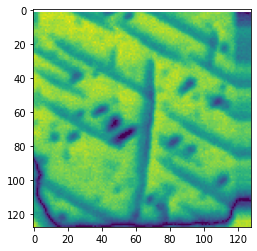

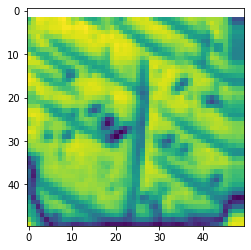

In [ ]:
plt.imshow(img_big)
plt.show()
plt.imshow(img)
plt.show()

Creating image patch

In [ ]:
window_size = 4

coordinates = aoi.utils.get_coord_grid(img, step=1, return_dict=False)
features, targets, indices = aoi.utils.extract_patches_and_spectra(
    specim, img, coordinates=coordinates, window_size=window_size, avg_pool=1)

features.shape, targets.shape

/usr/local/lib/python3.8/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((2115, 4, 4), (2115, 64))

In [ ]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features, targets = norm_(features), norm_(targets)

In [ ]:
n, d1, d2 = features.shape
num_start = int(10)
N = int(100)
m = 0
spec_length = 64  #spectral data length



spec_length = amp_mat.shape[-1]  #spectral data length

coordinates = utils.get_coord_grid(img, 1)
X_feas = features.reshape(n, d1*d2)

X_feas_norm = features.reshape(n, d1*d2)

amp_masked = np.zeros_like(targets)
np.random.seed(10)

idx = np.random.randint(0, len(X_feas), num_start)
for ind in range(num_start):
    amp_masked[int(idx[ind]),:] = targets[int(idx[ind]),:]

train_X = X_feas[idx]
train_X_norm = X_feas_norm[idx]
#indices = torch.from_numpy(indices)
train_indices = indices[idx]

print(X_feas.shape, X_feas_norm.shape,train_X.shape, train_X_norm.shape, train_indices.shape, amp_masked.shape)

(2115, 16) (2115, 16) (10, 16) (10, 16) (10, 2) (2115, 64)


Initial sampling

i is 0, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #1


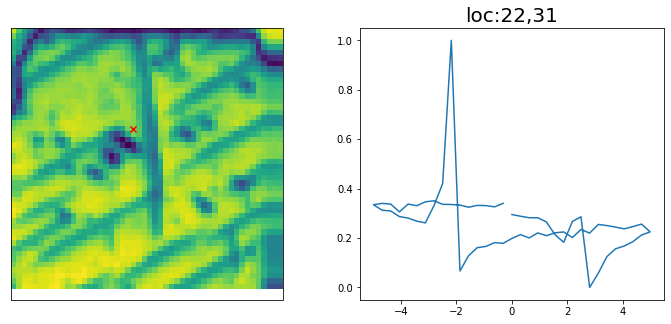

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 1, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #2


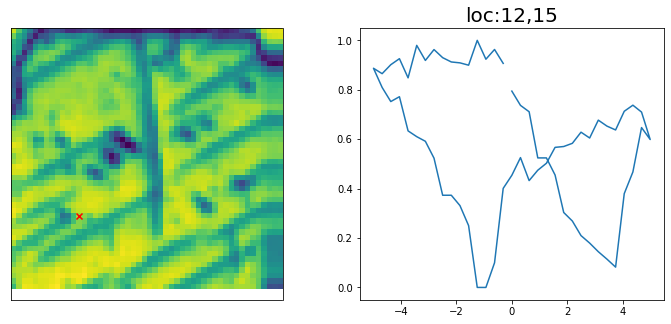

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
i is 2, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #3


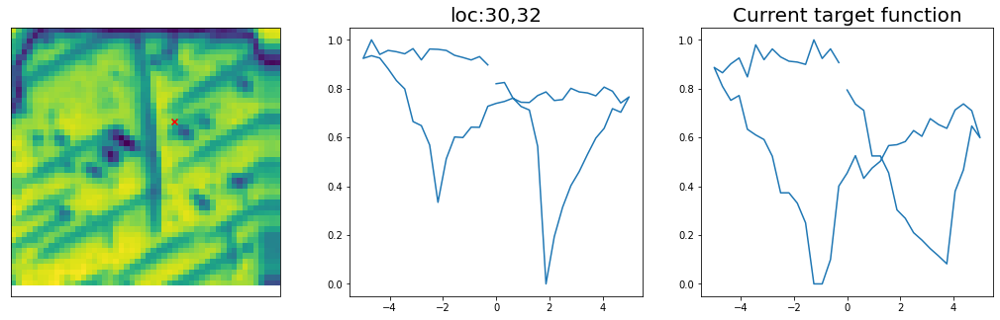

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 3, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #4


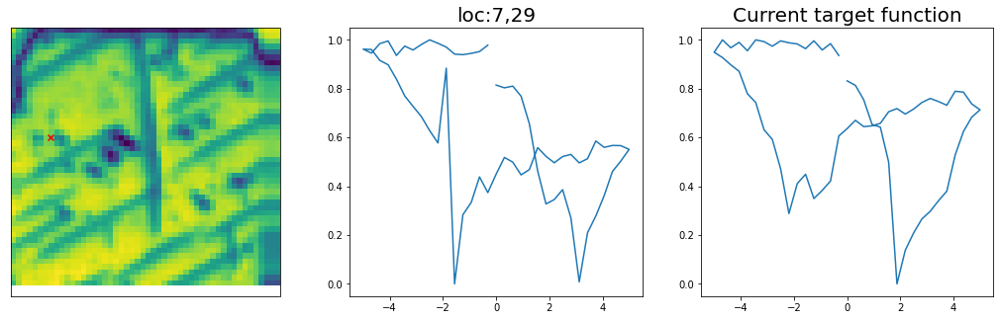

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 4, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #5


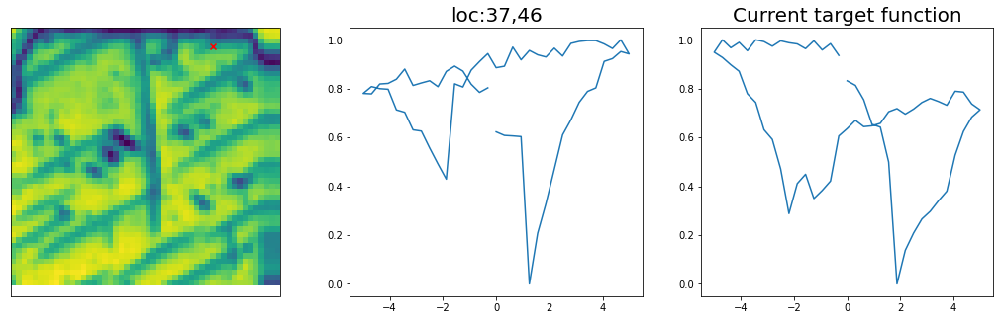

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 5, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #6


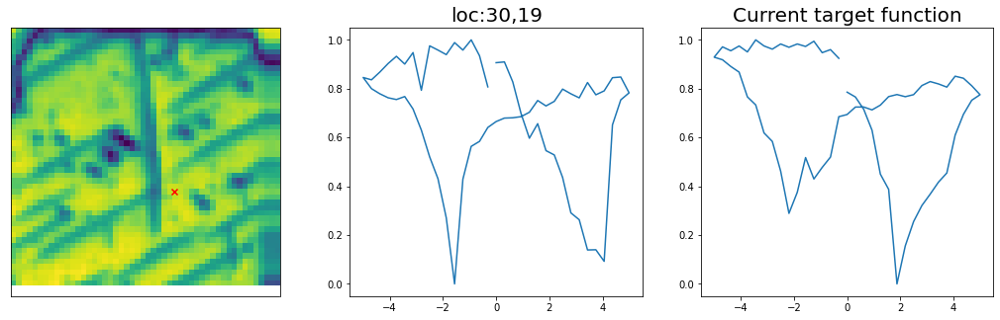

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 6, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #7


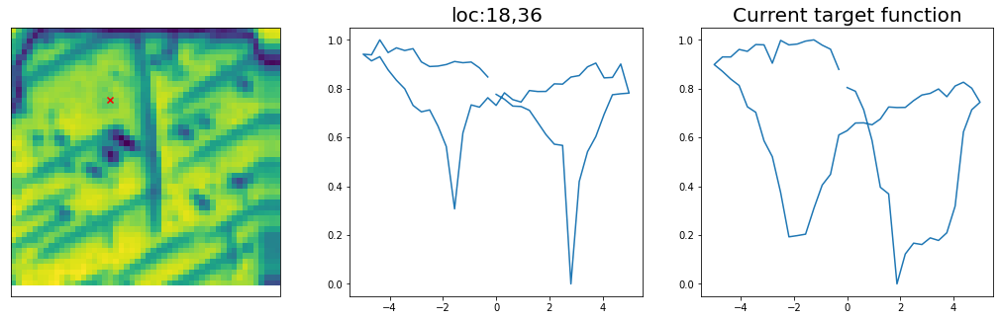

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 7, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #8


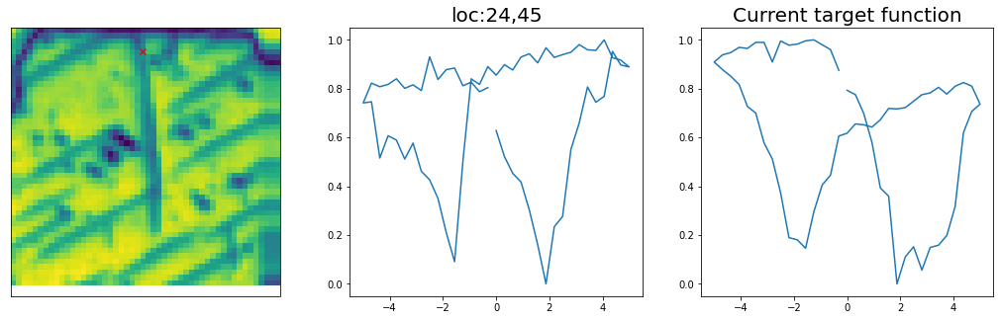

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 8, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #9


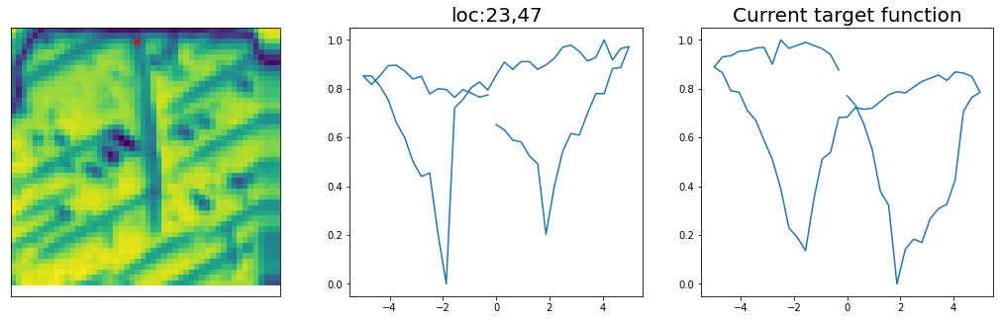

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 9, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #10


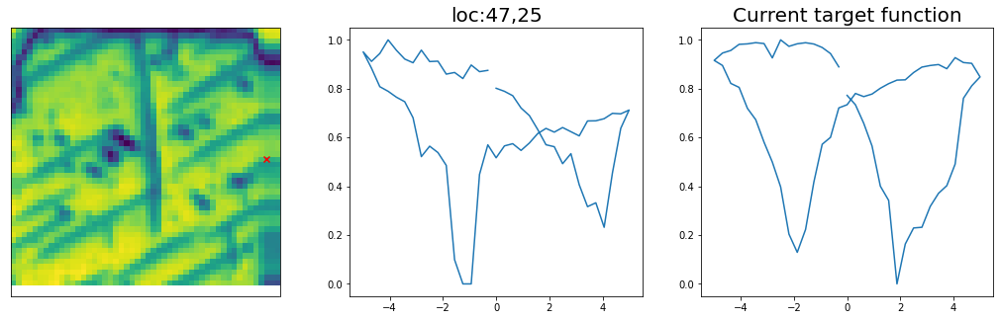

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0


In [ ]:
def return_new_measurement(full_dataset, points_measured):
    ampdat_masked = np.zeros_like(full_dataset)
    ampdat_masked[points_measured,:] = full_dataset[points_measured,:]
    return ampdat_masked, points_measured

# set parameters
IV = np.copy(amp_masked)
points_measured = np.array(idx)
last_points_measured = np.array(points_measured)
vdc = vdc_vec

train_Y = np.zeros((num_start, 1))
pref = np.zeros((num_start, 1))
init_spec = np.zeros((num_start, spec_length))
# Define a sparse grid to store evaluated spectral locations
eval_spec_y = np.zeros((img.shape[0],img.shape[0],spec_length))
#Evaluate initial training data
x = np.zeros((1,2))

# First generate target loop, based on initial training data
wcount_good= 0
target_func = np.zeros(spec_length)

mask = np.isin(points_measured, last_points_measured, invert = True)
new_points_measured = points_measured[mask]
last_points_measured = np.append(last_points_measured, new_points_measured)

for i in range(0, num_start):
    
    ##******************experiment start*******************##
    time.sleep(0.1)

    idx_x = int(train_indices[i, 0])
    idx_y = int(train_indices[i, 1])

    next_loc = np.asarray([idx_x, idx_y])
    
    print("i is {}, measurement done".format(i))
    
    mask = np.isin(points_measured, last_points_measured, invert = True)
    new_points_measured = points_measured[mask]
    last_points_measured = np.append(last_points_measured, new_points_measured)
    print('points measured {}'.format(points_measured))
    print('new_points_measured {}'.format(new_points_measured))

    new_iv = IV[last_points_measured,:]

    #new_spec_x = torch.from_numpy(vdc_vec)
    #new_spec_y = torch.from_numpy(new_iv)[i,:]

    new_spec_x = vdc_vec
    new_spec_y = new_iv[i,:]
    

    new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())

    init_spec[i,] = new_spec_y
    eval_spec_y[idx_x, idx_y, :] = new_spec_y
    print("\n\nSample #" + str(m + 1))
    pref[i, 0], wcount_good, target_func = play_varTBO.generate_targetobj(idx_x, idx_y, new_spec_x,new_spec_y, 
                                                              img, wcount_good, target_func)
    m = m + 1


# Once target loop is defined (unless are loops are selected bad by user), we compute the obj
for i in range(0, num_start):
  idx_x = int(train_indices[i, 0])
  idx_y = int(train_indices[i, 1])
  spec_y = eval_spec_y[idx_x, idx_y, :]
  #print(idx_x, idx_y, spec_y)
  train_Y[i, 0] = play_varTBO.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])

var_params = [wcount_good, pref, target_func]
test_X, test_X_norm, train_X, train_X_norm, train_Y, var_params, idx, m \
= X_feas, X_feas_norm, train_X, train_X_norm, train_Y, var_params, idx, m


Active learning through dklBO (using deep learning kernel with input image patches)

Epoch 1/200 ... Training loss: 1.8131
Epoch 10/200 ... Training loss: 1.6532
Epoch 20/200 ... Training loss: 1.5182
Epoch 30/200 ... Training loss: 1.4032
Epoch 40/200 ... Training loss: 1.2839
Epoch 50/200 ... Training loss: 1.1944
Epoch 60/200 ... Training loss: 1.1326
Epoch 70/200 ... Training loss: 1.0753
Epoch 80/200 ... Training loss: 1.0244
Epoch 90/200 ... Training loss: 0.9745
Epoch 100/200 ... Training loss: 0.929
Epoch 110/200 ... Training loss: 0.8886
Epoch 120/200 ... Training loss: 0.8712
Epoch 130/200 ... Training loss: 0.8049
Epoch 140/200 ... Training loss: 0.7614
Epoch 150/200 ... Training loss: 0.7168
Epoch 160/200 ... Training loss: 0.679
Epoch 170/200 ... Training loss: 0.6333
Epoch 180/200 ... Training loss: 0.5901
Epoch 190/200 ... Training loss: 0.5476
Epoch 200/200 ... Training loss: 0.5055
step:  1
Sample #11




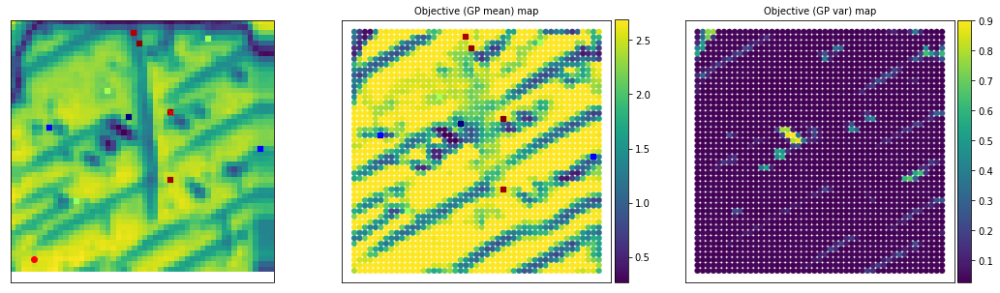

Are you satisfied with current target? (y- yes or press ENTER- No)
Answer: y
Spectral target now fixed. Continue automated BO...


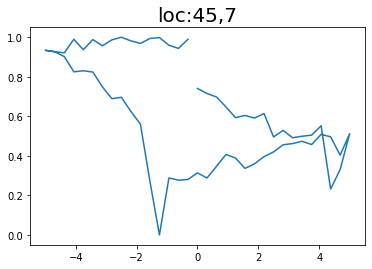

Epoch 1/200 ... Training loss: 5.5084
Epoch 10/200 ... Training loss: 4.68
Epoch 20/200 ... Training loss: 3.9123
Epoch 30/200 ... Training loss: 3.4458
Epoch 40/200 ... Training loss: 3.1491
Epoch 50/200 ... Training loss: 2.8827
Epoch 60/200 ... Training loss: 2.6828
Epoch 70/200 ... Training loss: 2.5173
Epoch 80/200 ... Training loss: 2.3908
Epoch 90/200 ... Training loss: 2.2905
Epoch 100/200 ... Training loss: 2.2036
Epoch 110/200 ... Training loss: 2.1282
Epoch 120/200 ... Training loss: 2.0616
Epoch 130/200 ... Training loss: 2.0024
Epoch 140/200 ... Training loss: 1.9492
Epoch 150/200 ... Training loss: 1.901
Epoch 160/200 ... Training loss: 1.857
Epoch 170/200 ... Training loss: 1.8164
Epoch 180/200 ... Training loss: 1.7784
Epoch 190/200 ... Training loss: 1.7427
Epoch 200/200 ... Training loss: 1.7094
step:  2
Sample #12




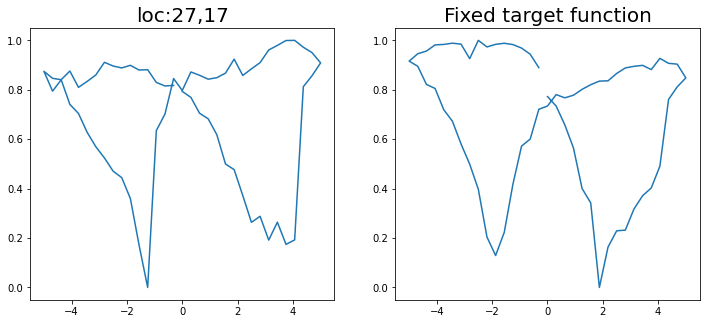

Epoch 1/200 ... Training loss: 5.154
Epoch 10/200 ... Training loss: 4.0796
Epoch 20/200 ... Training loss: 3.7141
Epoch 30/200 ... Training loss: 3.25
Epoch 40/200 ... Training loss: 2.9847
Epoch 50/200 ... Training loss: 2.7506
Epoch 60/200 ... Training loss: 2.5578
Epoch 70/200 ... Training loss: 2.4024
Epoch 80/200 ... Training loss: 2.2791
Epoch 90/200 ... Training loss: 2.1865
Epoch 100/200 ... Training loss: 2.106
Epoch 110/200 ... Training loss: 2.035
Epoch 120/200 ... Training loss: 1.9718
Epoch 130/200 ... Training loss: 1.9149
Epoch 140/200 ... Training loss: 1.8633
Epoch 150/200 ... Training loss: 1.816
Epoch 160/200 ... Training loss: 1.7725
Epoch 170/200 ... Training loss: 1.7322
Epoch 180/200 ... Training loss: 1.6945
Epoch 190/200 ... Training loss: 1.6592
Epoch 200/200 ... Training loss: 1.6251
step:  3
Sample #13




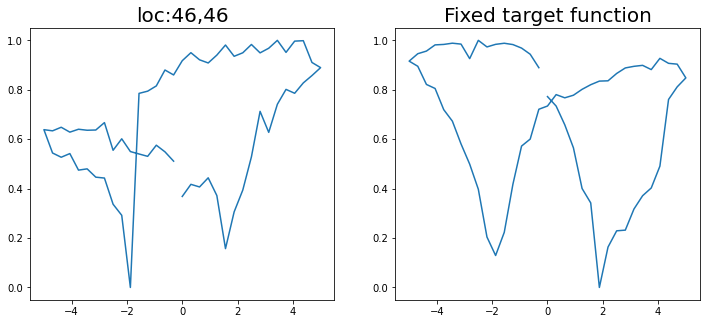

Epoch 1/200 ... Training loss: 4.8003
Epoch 10/200 ... Training loss: 4.0557
Epoch 20/200 ... Training loss: 3.3524
Epoch 30/200 ... Training loss: 3.0528
Epoch 40/200 ... Training loss: 2.8076
Epoch 50/200 ... Training loss: 2.5638
Epoch 60/200 ... Training loss: 2.4046
Epoch 70/200 ... Training loss: 2.271
Epoch 80/200 ... Training loss: 2.1668
Epoch 90/200 ... Training loss: 2.0784
Epoch 100/200 ... Training loss: 2.0096
Epoch 110/200 ... Training loss: 1.9372
Epoch 120/200 ... Training loss: 1.8732
Epoch 130/200 ... Training loss: 1.8167
Epoch 140/200 ... Training loss: 1.7654
Epoch 150/200 ... Training loss: 1.718
Epoch 160/200 ... Training loss: 1.6739
Epoch 170/200 ... Training loss: 1.6327
Epoch 180/200 ... Training loss: 1.5938
Epoch 190/200 ... Training loss: 1.5613
Epoch 200/200 ... Training loss: 1.5246
step:  4
Sample #14




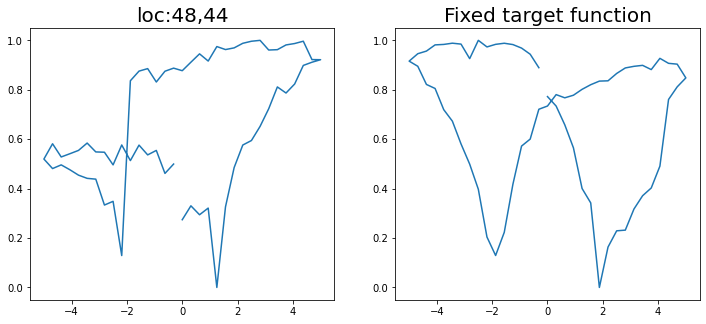

Epoch 1/200 ... Training loss: 4.4869
Epoch 10/200 ... Training loss: 3.5215
Epoch 20/200 ... Training loss: 3.2322
Epoch 30/200 ... Training loss: 3.0241
Epoch 40/200 ... Training loss: 2.7303
Epoch 50/200 ... Training loss: 2.487
Epoch 60/200 ... Training loss: 2.3156
Epoch 70/200 ... Training loss: 2.1955
Epoch 80/200 ... Training loss: 2.0957
Epoch 90/200 ... Training loss: 2.014
Epoch 100/200 ... Training loss: 1.9419
Epoch 110/200 ... Training loss: 1.877
Epoch 120/200 ... Training loss: 1.8458
Epoch 130/200 ... Training loss: 1.7681
Epoch 140/200 ... Training loss: 1.7168
Epoch 150/200 ... Training loss: 1.6665
Epoch 160/200 ... Training loss: 1.6209
Epoch 170/200 ... Training loss: 1.577
Epoch 180/200 ... Training loss: 1.5347
Epoch 190/200 ... Training loss: 1.4932
Epoch 200/200 ... Training loss: 1.4732
step:  5
Sample #15




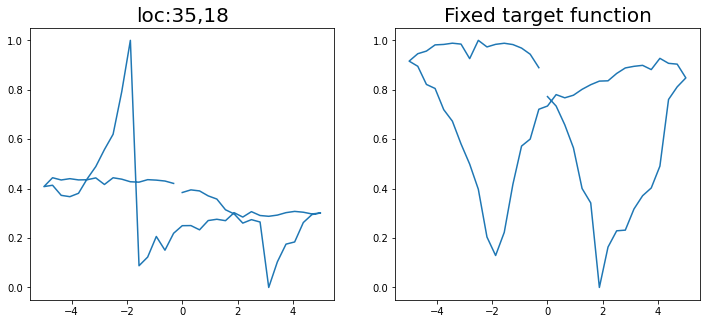

Epoch 1/200 ... Training loss: 4.6002
Epoch 10/200 ... Training loss: 3.8478
Epoch 20/200 ... Training loss: 3.1957
Epoch 30/200 ... Training loss: 2.7458
Epoch 40/200 ... Training loss: 2.4957
Epoch 50/200 ... Training loss: 2.3173
Epoch 60/200 ... Training loss: 2.1846
Epoch 70/200 ... Training loss: 2.0805
Epoch 80/200 ... Training loss: 2.0005
Epoch 90/200 ... Training loss: 1.9219
Epoch 100/200 ... Training loss: 1.8529
Epoch 110/200 ... Training loss: 1.7966
Epoch 120/200 ... Training loss: 1.7708
Epoch 130/200 ... Training loss: 1.6884
Epoch 140/200 ... Training loss: 1.6398
Epoch 150/200 ... Training loss: 1.5975
Epoch 160/200 ... Training loss: 1.5562
Epoch 170/200 ... Training loss: 1.5169
Epoch 180/200 ... Training loss: 1.4869
Epoch 190/200 ... Training loss: 1.4473
Epoch 200/200 ... Training loss: 1.4199
step:  6
Sample #16




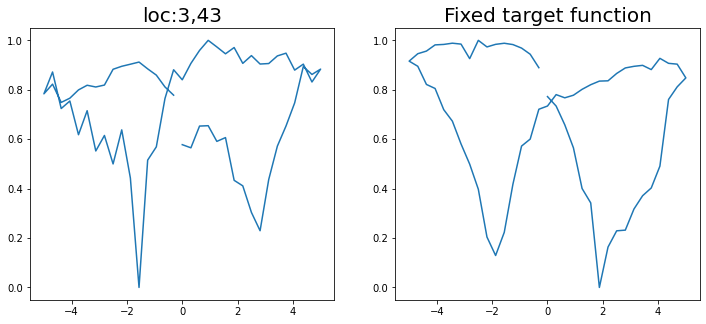

Epoch 1/200 ... Training loss: 4.3844
Epoch 10/200 ... Training loss: 3.5707
Epoch 20/200 ... Training loss: 3.0772
Epoch 30/200 ... Training loss: 2.6774
Epoch 40/200 ... Training loss: 2.4404
Epoch 50/200 ... Training loss: 2.2568
Epoch 60/200 ... Training loss: 2.1179
Epoch 70/200 ... Training loss: 2.0168
Epoch 80/200 ... Training loss: 1.9334
Epoch 90/200 ... Training loss: 1.8589
Epoch 100/200 ... Training loss: 1.8044
Epoch 110/200 ... Training loss: 1.7456
Epoch 120/200 ... Training loss: 1.6829
Epoch 130/200 ... Training loss: 1.6347
Epoch 140/200 ... Training loss: 1.5928
Epoch 150/200 ... Training loss: 1.5472
Epoch 160/200 ... Training loss: 1.5469
Epoch 170/200 ... Training loss: 1.4853
Epoch 180/200 ... Training loss: 1.4359
Epoch 190/200 ... Training loss: 1.4015
Epoch 200/200 ... Training loss: 1.3704
step:  7
Sample #17




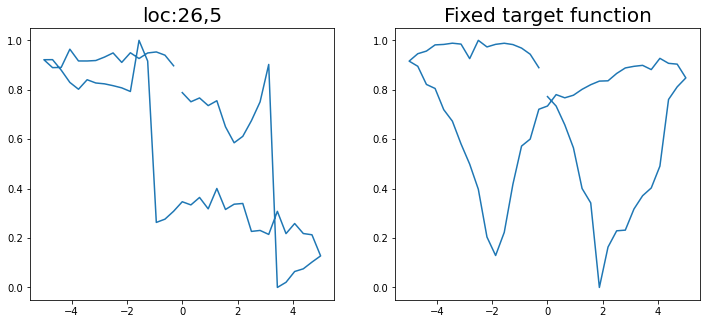

Epoch 1/200 ... Training loss: 4.4375
Epoch 10/200 ... Training loss: 4.2361
Epoch 20/200 ... Training loss: 3.7103
Epoch 30/200 ... Training loss: 3.2221
Epoch 40/200 ... Training loss: 2.8428
Epoch 50/200 ... Training loss: 2.3009
Epoch 60/200 ... Training loss: 2.0969
Epoch 70/200 ... Training loss: 1.9925
Epoch 80/200 ... Training loss: 1.9074
Epoch 90/200 ... Training loss: 1.8514
Epoch 100/200 ... Training loss: 1.7878
Epoch 110/200 ... Training loss: 1.7361
Epoch 120/200 ... Training loss: 1.7048
Epoch 130/200 ... Training loss: 1.6552
Epoch 140/200 ... Training loss: 1.619
Epoch 150/200 ... Training loss: 1.5928
Epoch 160/200 ... Training loss: 1.5485
Epoch 170/200 ... Training loss: 1.5193
Epoch 180/200 ... Training loss: 1.492
Epoch 190/200 ... Training loss: 1.6302
Epoch 200/200 ... Training loss: 1.5418
step:  8
Sample #18




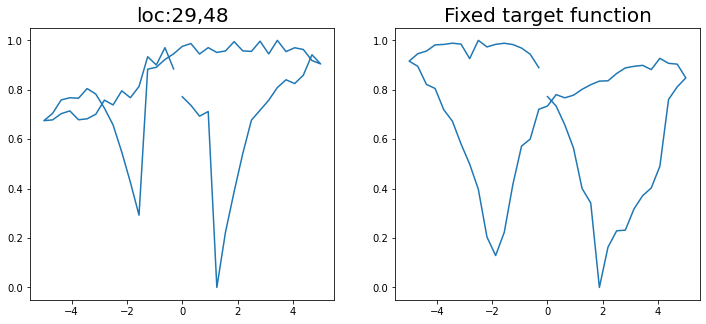

Epoch 1/200 ... Training loss: 4.2357
Epoch 10/200 ... Training loss: 4.0614
Epoch 20/200 ... Training loss: 3.5326
Epoch 30/200 ... Training loss: 3.0206
Epoch 40/200 ... Training loss: 2.5399
Epoch 50/200 ... Training loss: 2.2247
Epoch 60/200 ... Training loss: 2.0235
Epoch 70/200 ... Training loss: 1.9154
Epoch 80/200 ... Training loss: 1.8375
Epoch 90/200 ... Training loss: 1.7631
Epoch 100/200 ... Training loss: 1.7144
Epoch 110/200 ... Training loss: 1.6601
Epoch 120/200 ... Training loss: 1.6129
Epoch 130/200 ... Training loss: 1.5715
Epoch 140/200 ... Training loss: 1.536
Epoch 150/200 ... Training loss: 1.5
Epoch 160/200 ... Training loss: 1.482
Epoch 170/200 ... Training loss: 1.447
Epoch 180/200 ... Training loss: 1.4093
Epoch 190/200 ... Training loss: 1.3851
Epoch 200/200 ... Training loss: 1.366
step:  9
Sample #19




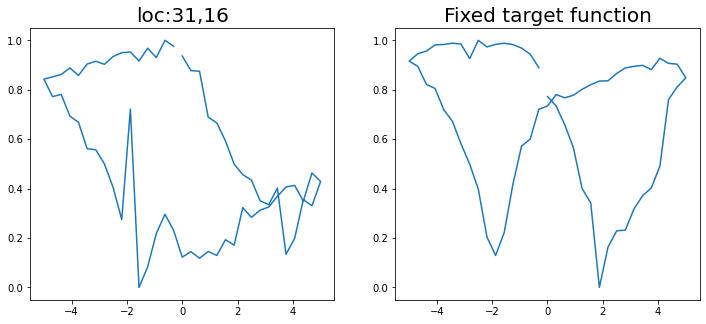

Epoch 1/200 ... Training loss: 4.1006
Epoch 10/200 ... Training loss: 3.9033
Epoch 20/200 ... Training loss: 3.4399
Epoch 30/200 ... Training loss: 3.0187
Epoch 40/200 ... Training loss: 2.5898
Epoch 50/200 ... Training loss: 2.3331
Epoch 60/200 ... Training loss: 2.1467
Epoch 70/200 ... Training loss: 2.0789
Epoch 80/200 ... Training loss: 1.984
Epoch 90/200 ... Training loss: 1.8964
Epoch 100/200 ... Training loss: 1.9023
Epoch 110/200 ... Training loss: 1.7668
Epoch 120/200 ... Training loss: 1.6759
Epoch 130/200 ... Training loss: 1.758
Epoch 140/200 ... Training loss: 1.6504
Epoch 150/200 ... Training loss: 1.5722
Epoch 160/200 ... Training loss: 1.5175
Epoch 170/200 ... Training loss: 1.4767
Epoch 180/200 ... Training loss: 1.4458
Epoch 190/200 ... Training loss: 1.4189
Epoch 200/200 ... Training loss: 1.3885
step:  10
Sample #20




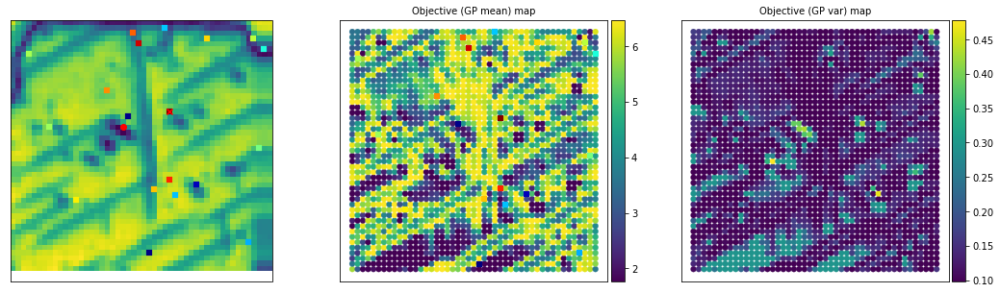

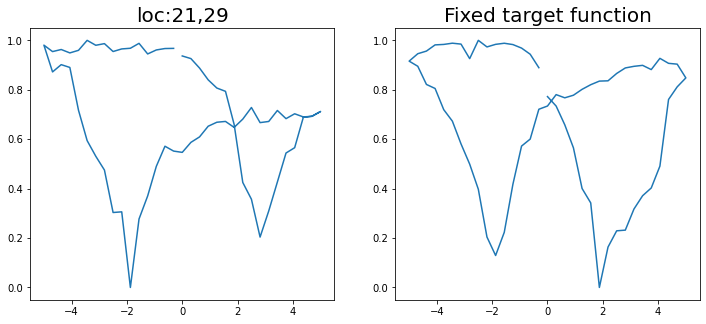

Epoch 1/200 ... Training loss: 4.0885
Epoch 10/200 ... Training loss: 3.7237
Epoch 20/200 ... Training loss: 3.1663
Epoch 30/200 ... Training loss: 2.9645
Epoch 40/200 ... Training loss: 2.7524
Epoch 50/200 ... Training loss: 2.36
Epoch 60/200 ... Training loss: 2.1736
Epoch 70/200 ... Training loss: 2.0236
Epoch 80/200 ... Training loss: 1.9655
Epoch 90/200 ... Training loss: 1.9801
Epoch 100/200 ... Training loss: 1.8724
Epoch 110/200 ... Training loss: 1.7613
Epoch 120/200 ... Training loss: 1.6889
Epoch 130/200 ... Training loss: 1.6765
Epoch 140/200 ... Training loss: 1.6516
Epoch 150/200 ... Training loss: 1.5977
Epoch 160/200 ... Training loss: 1.5048
Epoch 170/200 ... Training loss: 1.5901
Epoch 180/200 ... Training loss: 1.4769
Epoch 190/200 ... Training loss: 1.4498
Epoch 200/200 ... Training loss: 1.3927
step:  11
Sample #21




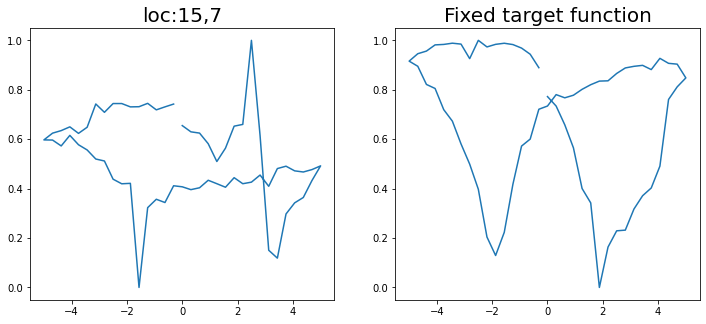

Epoch 1/200 ... Training loss: 3.9597
Epoch 10/200 ... Training loss: 3.3675
Epoch 20/200 ... Training loss: 3.3402
Epoch 30/200 ... Training loss: 2.7172
Epoch 40/200 ... Training loss: 2.3907
Epoch 50/200 ... Training loss: 2.2045
Epoch 60/200 ... Training loss: 2.0554
Epoch 70/200 ... Training loss: 1.9296
Epoch 80/200 ... Training loss: 1.9885
Epoch 90/200 ... Training loss: 1.8549
Epoch 100/200 ... Training loss: 1.7855
Epoch 110/200 ... Training loss: 1.663
Epoch 120/200 ... Training loss: 1.687
Epoch 130/200 ... Training loss: 1.5784
Epoch 140/200 ... Training loss: 1.5308
Epoch 150/200 ... Training loss: 1.4711
Epoch 160/200 ... Training loss: 1.4915
Epoch 170/200 ... Training loss: 1.4535
Epoch 180/200 ... Training loss: 1.3795
Epoch 190/200 ... Training loss: 1.3598
Epoch 200/200 ... Training loss: 1.307
step:  12
Sample #22




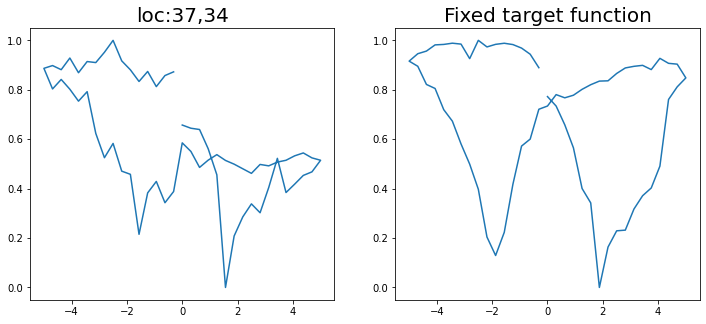

Epoch 1/200 ... Training loss: 3.8145
Epoch 10/200 ... Training loss: 3.164
Epoch 20/200 ... Training loss: 3.4192
Epoch 30/200 ... Training loss: 2.6868
Epoch 40/200 ... Training loss: 2.4975
Epoch 50/200 ... Training loss: 2.2595
Epoch 60/200 ... Training loss: 2.0187
Epoch 70/200 ... Training loss: 1.9165
Epoch 80/200 ... Training loss: 1.8026
Epoch 90/200 ... Training loss: 1.7471
Epoch 100/200 ... Training loss: 1.6338
Epoch 110/200 ... Training loss: 1.588
Epoch 120/200 ... Training loss: 1.5428
Epoch 130/200 ... Training loss: 1.4862
Epoch 140/200 ... Training loss: 1.4438
Epoch 150/200 ... Training loss: 1.4036
Epoch 160/200 ... Training loss: 1.411
Epoch 170/200 ... Training loss: 1.3461
Epoch 180/200 ... Training loss: 1.3103
Epoch 190/200 ... Training loss: 1.2786
Epoch 200/200 ... Training loss: 1.2572
step:  13
Sample #23




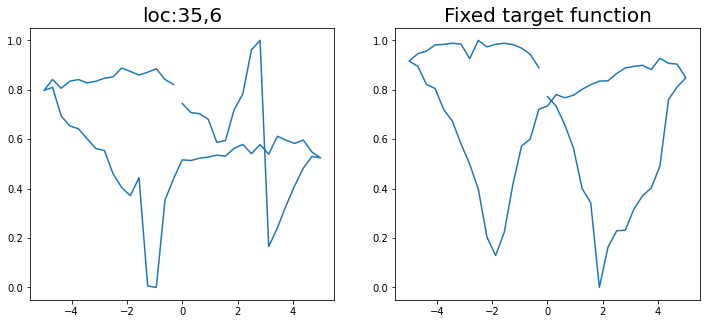

Epoch 1/200 ... Training loss: 3.6829
Epoch 10/200 ... Training loss: 3.503
Epoch 20/200 ... Training loss: 3.1846
Epoch 30/200 ... Training loss: 2.9268
Epoch 40/200 ... Training loss: 2.753
Epoch 50/200 ... Training loss: 2.5047
Epoch 60/200 ... Training loss: 2.1086
Epoch 70/200 ... Training loss: 2.1847
Epoch 80/200 ... Training loss: 1.9505
Epoch 90/200 ... Training loss: 1.8536
Epoch 100/200 ... Training loss: 1.7737
Epoch 110/200 ... Training loss: 1.687
Epoch 120/200 ... Training loss: 1.6132
Epoch 130/200 ... Training loss: 1.7885
Epoch 140/200 ... Training loss: 1.6401
Epoch 150/200 ... Training loss: 1.537
Epoch 160/200 ... Training loss: 1.4736
Epoch 170/200 ... Training loss: 1.4334
Epoch 180/200 ... Training loss: 1.3999
Epoch 190/200 ... Training loss: 1.3681
Epoch 200/200 ... Training loss: 1.3429
step:  14
Sample #24




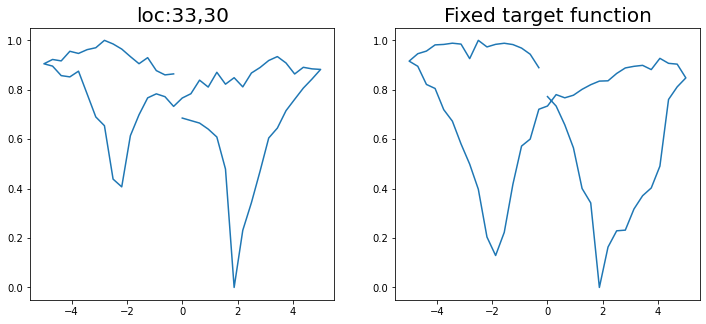

Epoch 1/200 ... Training loss: 3.6088
Epoch 10/200 ... Training loss: 3.4273
Epoch 20/200 ... Training loss: 3.1289
Epoch 30/200 ... Training loss: 2.8536
Epoch 40/200 ... Training loss: 2.682
Epoch 50/200 ... Training loss: 2.4857
Epoch 60/200 ... Training loss: 2.3545
Epoch 70/200 ... Training loss: 2.0895
Epoch 80/200 ... Training loss: 1.8218
Epoch 90/200 ... Training loss: 1.7711
Epoch 100/200 ... Training loss: 1.637
Epoch 110/200 ... Training loss: 1.5763
Epoch 120/200 ... Training loss: 1.5251
Epoch 130/200 ... Training loss: 1.4819
Epoch 140/200 ... Training loss: 1.4448
Epoch 150/200 ... Training loss: 1.4108
Epoch 160/200 ... Training loss: 1.3786
Epoch 170/200 ... Training loss: 1.355
Epoch 180/200 ... Training loss: 1.332
Epoch 190/200 ... Training loss: 1.3535
Epoch 200/200 ... Training loss: 1.3016
step:  15
Sample #25




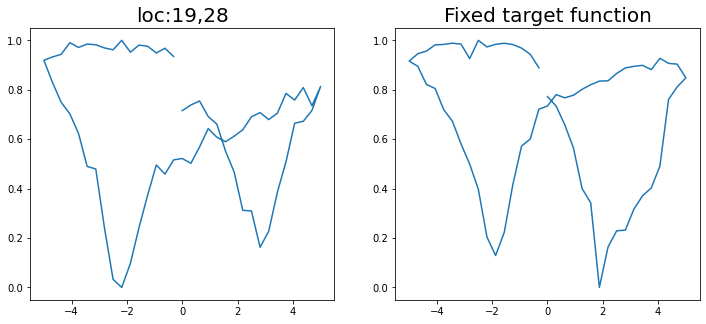

Epoch 1/200 ... Training loss: 3.6571
Epoch 10/200 ... Training loss: 3.4831
Epoch 20/200 ... Training loss: 3.2363
Epoch 30/200 ... Training loss: 2.9603
Epoch 40/200 ... Training loss: 2.7124
Epoch 50/200 ... Training loss: 2.5503
Epoch 60/200 ... Training loss: 2.2935
Epoch 70/200 ... Training loss: 1.8833
Epoch 80/200 ... Training loss: 1.8295
Epoch 90/200 ... Training loss: 1.6331
Epoch 100/200 ... Training loss: 1.5805
Epoch 110/200 ... Training loss: 1.5293
Epoch 120/200 ... Training loss: 1.4934
Epoch 130/200 ... Training loss: 1.4607
Epoch 140/200 ... Training loss: 1.4174
Epoch 150/200 ... Training loss: 1.3945
Epoch 160/200 ... Training loss: 1.3587
Epoch 170/200 ... Training loss: 1.3209
Epoch 180/200 ... Training loss: 1.2918
Epoch 190/200 ... Training loss: 1.2786
Epoch 200/200 ... Training loss: 1.239
step:  16
Sample #26




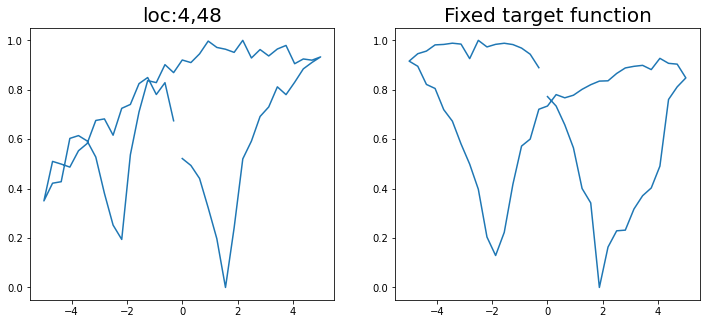

Epoch 1/200 ... Training loss: 3.634
Epoch 10/200 ... Training loss: 3.491
Epoch 20/200 ... Training loss: 2.9976
Epoch 30/200 ... Training loss: 2.8283
Epoch 40/200 ... Training loss: 2.5877
Epoch 50/200 ... Training loss: 2.2689
Epoch 60/200 ... Training loss: 2.0193
Epoch 70/200 ... Training loss: 1.8299
Epoch 80/200 ... Training loss: 1.728
Epoch 90/200 ... Training loss: 1.6306
Epoch 100/200 ... Training loss: 1.6336
Epoch 110/200 ... Training loss: 1.5181
Epoch 120/200 ... Training loss: 1.482
Epoch 130/200 ... Training loss: 1.4247
Epoch 140/200 ... Training loss: 1.3914
Epoch 150/200 ... Training loss: 1.4915
Epoch 160/200 ... Training loss: 1.398
Epoch 170/200 ... Training loss: 1.3199
Epoch 180/200 ... Training loss: 1.2852
Epoch 190/200 ... Training loss: 1.2454
Epoch 200/200 ... Training loss: 1.2045
step:  17
Sample #27




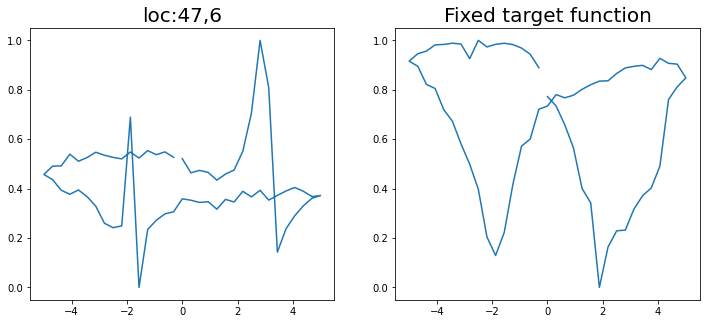

Epoch 1/200 ... Training loss: 3.6072
Epoch 10/200 ... Training loss: 3.4492
Epoch 20/200 ... Training loss: 2.9857
Epoch 30/200 ... Training loss: 2.8253
Epoch 40/200 ... Training loss: 2.511
Epoch 50/200 ... Training loss: 2.161
Epoch 60/200 ... Training loss: 1.8989
Epoch 70/200 ... Training loss: 1.7365
Epoch 80/200 ... Training loss: 1.6657
Epoch 90/200 ... Training loss: 1.647
Epoch 100/200 ... Training loss: 1.548
Epoch 110/200 ... Training loss: 1.4809
Epoch 120/200 ... Training loss: 1.4593
Epoch 130/200 ... Training loss: 1.4119
Epoch 140/200 ... Training loss: 1.463
Epoch 150/200 ... Training loss: 1.3424
Epoch 160/200 ... Training loss: 1.3137
Epoch 170/200 ... Training loss: 1.281
Epoch 180/200 ... Training loss: 1.2483
Epoch 190/200 ... Training loss: 1.2134
Epoch 200/200 ... Training loss: 1.1895
step:  18
Sample #28




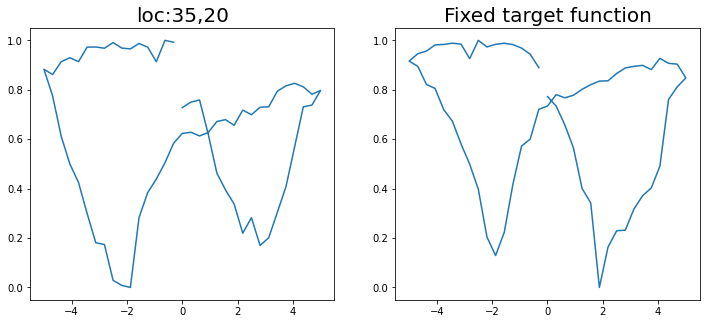

Epoch 1/200 ... Training loss: 3.6352
Epoch 10/200 ... Training loss: 3.487
Epoch 20/200 ... Training loss: 3.0328
Epoch 30/200 ... Training loss: 2.8392
Epoch 40/200 ... Training loss: 2.5364
Epoch 50/200 ... Training loss: 2.0687
Epoch 60/200 ... Training loss: 1.9945
Epoch 70/200 ... Training loss: 1.8113
Epoch 80/200 ... Training loss: 1.6679
Epoch 90/200 ... Training loss: 1.5911
Epoch 100/200 ... Training loss: 1.5477
Epoch 110/200 ... Training loss: 1.481
Epoch 120/200 ... Training loss: 1.4455
Epoch 130/200 ... Training loss: 1.3912
Epoch 140/200 ... Training loss: 1.3706
Epoch 150/200 ... Training loss: 1.328
Epoch 160/200 ... Training loss: 1.2912
Epoch 170/200 ... Training loss: 1.2557
Epoch 180/200 ... Training loss: 1.3646
Epoch 190/200 ... Training loss: 1.2791
Epoch 200/200 ... Training loss: 1.2268
step:  19
Sample #29




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


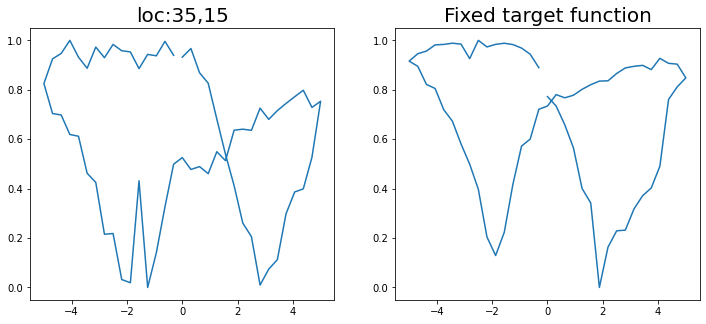

Epoch 1/200 ... Training loss: 3.6283
Epoch 10/200 ... Training loss: 3.4389
Epoch 20/200 ... Training loss: 3.1359
Epoch 30/200 ... Training loss: 2.8163
Epoch 40/200 ... Training loss: 2.603
Epoch 50/200 ... Training loss: 2.3242
Epoch 60/200 ... Training loss: 2.0054
Epoch 70/200 ... Training loss: 2.0459
Epoch 80/200 ... Training loss: 1.7575
Epoch 90/200 ... Training loss: 1.6385
Epoch 100/200 ... Training loss: 1.6007
Epoch 110/200 ... Training loss: 1.5181
Epoch 120/200 ... Training loss: 1.4672
Epoch 130/200 ... Training loss: 1.4466
Epoch 140/200 ... Training loss: 1.4191
Epoch 150/200 ... Training loss: 1.4494
Epoch 160/200 ... Training loss: 1.3897
Epoch 170/200 ... Training loss: 1.3235
Epoch 180/200 ... Training loss: 1.28
Epoch 190/200 ... Training loss: 1.265
Epoch 200/200 ... Training loss: 1.3386
step:  20
Sample #30




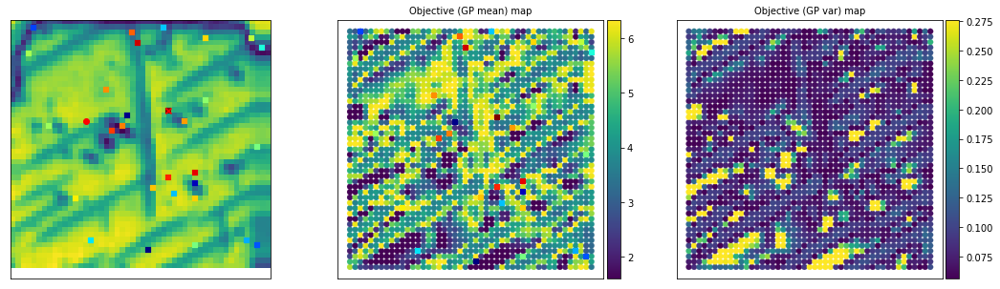

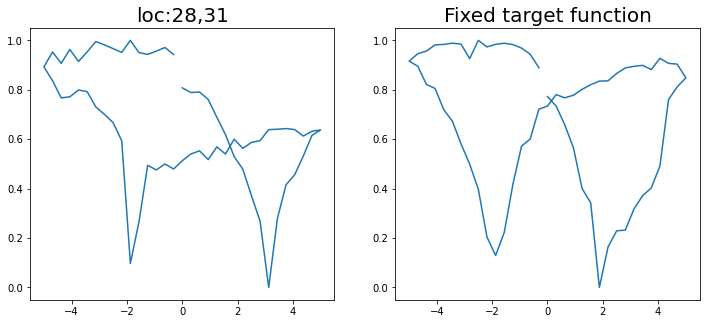

Epoch 1/200 ... Training loss: 3.5653
Epoch 10/200 ... Training loss: 3.372
Epoch 20/200 ... Training loss: 3.2543
Epoch 30/200 ... Training loss: 2.8087
Epoch 40/200 ... Training loss: 2.6017
Epoch 50/200 ... Training loss: 2.383
Epoch 60/200 ... Training loss: 2.1095
Epoch 70/200 ... Training loss: 2.0414
Epoch 80/200 ... Training loss: 1.8665
Epoch 90/200 ... Training loss: 1.6904
Epoch 100/200 ... Training loss: 1.605
Epoch 110/200 ... Training loss: 1.594
Epoch 120/200 ... Training loss: 1.5054
Epoch 130/200 ... Training loss: 1.454
Epoch 140/200 ... Training loss: 1.4152
Epoch 150/200 ... Training loss: 1.3713
Epoch 160/200 ... Training loss: 1.342
Epoch 170/200 ... Training loss: 1.3542
Epoch 180/200 ... Training loss: 1.3733
Epoch 190/200 ... Training loss: 1.2815
Epoch 200/200 ... Training loss: 1.2619
step:  21
Sample #31




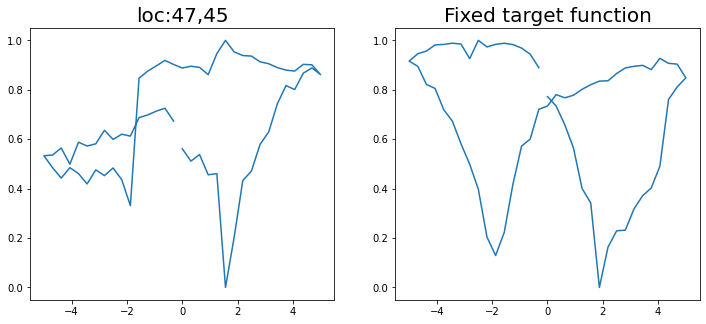

Epoch 1/200 ... Training loss: 3.5128
Epoch 10/200 ... Training loss: 3.3109
Epoch 20/200 ... Training loss: 2.8212
Epoch 30/200 ... Training loss: 2.6996
Epoch 40/200 ... Training loss: 2.4629
Epoch 50/200 ... Training loss: 2.1681
Epoch 60/200 ... Training loss: 1.873
Epoch 70/200 ... Training loss: 1.7447
Epoch 80/200 ... Training loss: 1.8925
Epoch 90/200 ... Training loss: 1.6723
Epoch 100/200 ... Training loss: 1.5356
Epoch 110/200 ... Training loss: 1.5411
Epoch 120/200 ... Training loss: 1.4673
Epoch 130/200 ... Training loss: 1.461
Epoch 140/200 ... Training loss: 1.4289
Epoch 150/200 ... Training loss: 1.3755
Epoch 160/200 ... Training loss: 1.318
Epoch 170/200 ... Training loss: 1.2772
Epoch 180/200 ... Training loss: 1.3464
Epoch 190/200 ... Training loss: 1.2359
Epoch 200/200 ... Training loss: 1.2028
step:  22
Sample #32




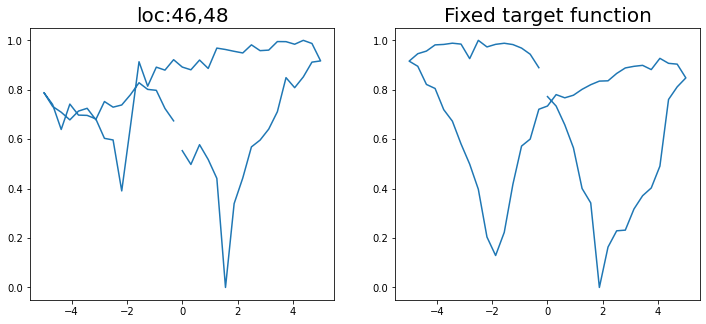

Epoch 1/200 ... Training loss: 3.4282
Epoch 10/200 ... Training loss: 3.2335
Epoch 20/200 ... Training loss: 2.9012
Epoch 30/200 ... Training loss: 2.716
Epoch 40/200 ... Training loss: 2.5397
Epoch 50/200 ... Training loss: 2.3574
Epoch 60/200 ... Training loss: 2.105
Epoch 70/200 ... Training loss: 1.9471
Epoch 80/200 ... Training loss: 1.7006
Epoch 90/200 ... Training loss: 1.5916
Epoch 100/200 ... Training loss: 1.5401
Epoch 110/200 ... Training loss: 1.488
Epoch 120/200 ... Training loss: 1.437
Epoch 130/200 ... Training loss: 1.4144
Epoch 140/200 ... Training loss: 1.5411
Epoch 150/200 ... Training loss: 1.4002
Epoch 160/200 ... Training loss: 1.3485
Epoch 170/200 ... Training loss: 1.295
Epoch 180/200 ... Training loss: 1.3818
Epoch 190/200 ... Training loss: 1.2609
Epoch 200/200 ... Training loss: 1.2425
step:  23
Sample #33




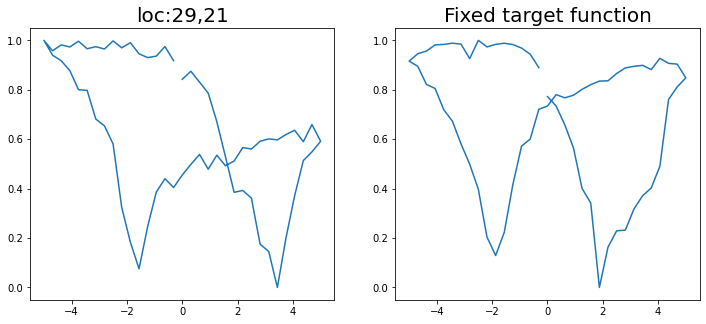

Epoch 1/200 ... Training loss: 3.4473
Epoch 10/200 ... Training loss: 3.2413
Epoch 20/200 ... Training loss: 2.938
Epoch 30/200 ... Training loss: 2.6845
Epoch 40/200 ... Training loss: 2.4967
Epoch 50/200 ... Training loss: 2.2502
Epoch 60/200 ... Training loss: 1.9852
Epoch 70/200 ... Training loss: 1.9541
Epoch 80/200 ... Training loss: 1.776
Epoch 90/200 ... Training loss: 1.6047
Epoch 100/200 ... Training loss: 1.5181
Epoch 110/200 ... Training loss: 1.5404
Epoch 120/200 ... Training loss: 1.4114
Epoch 130/200 ... Training loss: 1.376
Epoch 140/200 ... Training loss: 1.3416
Epoch 150/200 ... Training loss: 1.3189
Epoch 160/200 ... Training loss: 1.7825
Epoch 170/200 ... Training loss: 1.3906
Epoch 180/200 ... Training loss: 1.2866
Epoch 190/200 ... Training loss: 1.2274
Epoch 200/200 ... Training loss: 1.1809
step:  24
Sample #34




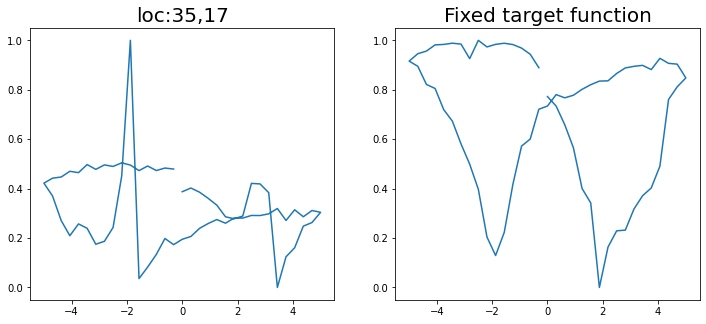

Epoch 1/200 ... Training loss: 3.5014
Epoch 10/200 ... Training loss: 3.2863
Epoch 20/200 ... Training loss: 2.9649
Epoch 30/200 ... Training loss: 2.724
Epoch 40/200 ... Training loss: 2.524
Epoch 50/200 ... Training loss: 2.2919
Epoch 60/200 ... Training loss: 2.0492
Epoch 70/200 ... Training loss: 1.8812
Epoch 80/200 ... Training loss: 1.8004
Epoch 90/200 ... Training loss: 1.7222
Epoch 100/200 ... Training loss: 1.575
Epoch 110/200 ... Training loss: 1.5018
Epoch 120/200 ... Training loss: 1.4662
Epoch 130/200 ... Training loss: 1.3934
Epoch 140/200 ... Training loss: 1.3434
Epoch 150/200 ... Training loss: 1.6201
Epoch 160/200 ... Training loss: 1.426
Epoch 170/200 ... Training loss: 1.3037
Epoch 180/200 ... Training loss: 1.257
Epoch 190/200 ... Training loss: 1.2191
Epoch 200/200 ... Training loss: 1.1751
step:  25
Sample #35




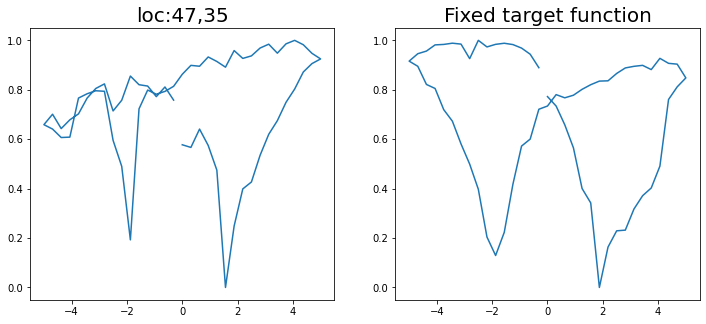

Epoch 1/200 ... Training loss: 3.4236
Epoch 10/200 ... Training loss: 3.2116
Epoch 20/200 ... Training loss: 2.7964
Epoch 30/200 ... Training loss: 2.6379
Epoch 40/200 ... Training loss: 2.4146
Epoch 50/200 ... Training loss: 2.1231
Epoch 60/200 ... Training loss: 1.8913
Epoch 70/200 ... Training loss: 1.7473
Epoch 80/200 ... Training loss: 1.7191
Epoch 90/200 ... Training loss: 1.5653
Epoch 100/200 ... Training loss: 1.5239
Epoch 110/200 ... Training loss: 1.4654
Epoch 120/200 ... Training loss: 1.4604
Epoch 130/200 ... Training loss: 1.3594
Epoch 140/200 ... Training loss: 1.3201
Epoch 150/200 ... Training loss: 1.2696
Epoch 160/200 ... Training loss: 1.2374
Epoch 170/200 ... Training loss: 1.2017
Epoch 180/200 ... Training loss: 1.1674
Epoch 190/200 ... Training loss: 1.1469
Epoch 200/200 ... Training loss: 1.1288
step:  26
Sample #36




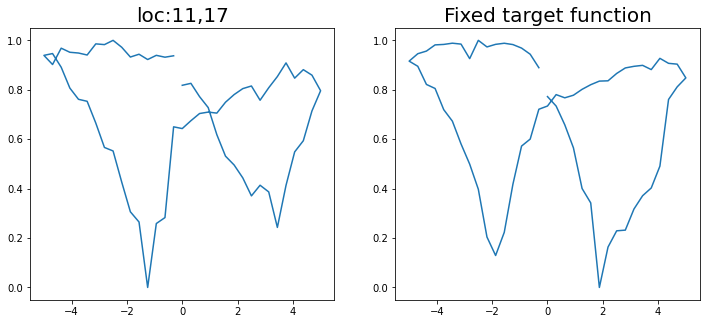

Epoch 1/200 ... Training loss: 3.3719
Epoch 10/200 ... Training loss: 3.1652
Epoch 20/200 ... Training loss: 2.9218
Epoch 30/200 ... Training loss: 2.6608
Epoch 40/200 ... Training loss: 2.4878
Epoch 50/200 ... Training loss: 2.3029
Epoch 60/200 ... Training loss: 2.0448
Epoch 70/200 ... Training loss: 1.7837
Epoch 80/200 ... Training loss: 1.6834
Epoch 90/200 ... Training loss: 1.6922
Epoch 100/200 ... Training loss: 1.4943
Epoch 110/200 ... Training loss: 1.4874
Epoch 120/200 ... Training loss: 1.3703
Epoch 130/200 ... Training loss: 1.3403
Epoch 140/200 ... Training loss: 1.3015
Epoch 150/200 ... Training loss: 1.2634
Epoch 160/200 ... Training loss: 1.2257
Epoch 170/200 ... Training loss: 1.1961
Epoch 180/200 ... Training loss: 1.1667
Epoch 190/200 ... Training loss: 1.1946
Epoch 200/200 ... Training loss: 1.1523
step:  27
Sample #37




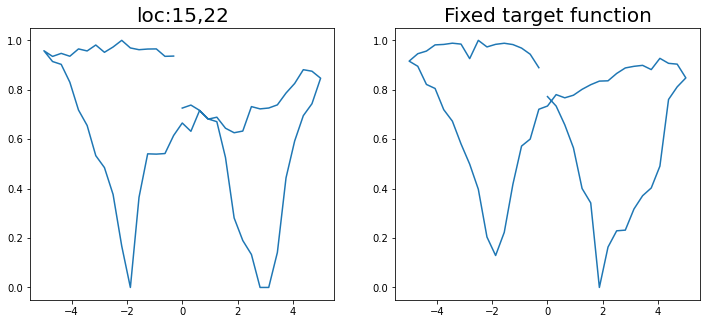

Epoch 1/200 ... Training loss: 3.4323
Epoch 10/200 ... Training loss: 3.1318
Epoch 20/200 ... Training loss: 2.7655
Epoch 30/200 ... Training loss: 2.6083
Epoch 40/200 ... Training loss: 2.2908
Epoch 50/200 ... Training loss: 1.8936
Epoch 60/200 ... Training loss: 1.7315
Epoch 70/200 ... Training loss: 1.6247
Epoch 80/200 ... Training loss: 1.5407
Epoch 90/200 ... Training loss: 1.4501
Epoch 100/200 ... Training loss: 1.3881
Epoch 110/200 ... Training loss: 1.3481
Epoch 120/200 ... Training loss: 1.2943
Epoch 130/200 ... Training loss: 1.2693
Epoch 140/200 ... Training loss: 1.286
Epoch 150/200 ... Training loss: 1.2351
Epoch 160/200 ... Training loss: 1.1698
Epoch 170/200 ... Training loss: 1.142
Epoch 180/200 ... Training loss: 1.583
Epoch 190/200 ... Training loss: 1.2277
Epoch 200/200 ... Training loss: 1.1067
step:  28
Sample #38




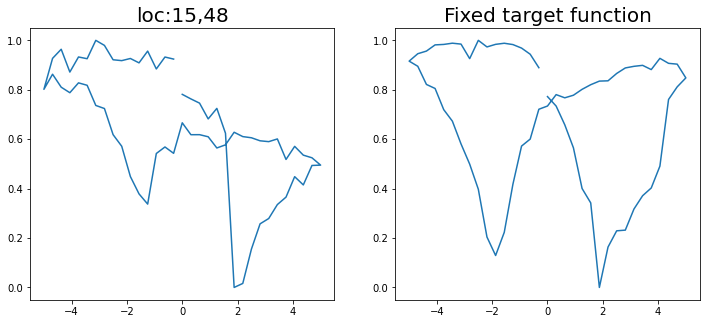

Epoch 1/200 ... Training loss: 3.3657
Epoch 10/200 ... Training loss: 3.1023
Epoch 20/200 ... Training loss: 2.9038
Epoch 30/200 ... Training loss: 2.7094
Epoch 40/200 ... Training loss: 2.5031
Epoch 50/200 ... Training loss: 2.2086
Epoch 60/200 ... Training loss: 1.9751
Epoch 70/200 ... Training loss: 1.7627
Epoch 80/200 ... Training loss: 1.6471
Epoch 90/200 ... Training loss: 1.5921
Epoch 100/200 ... Training loss: 1.5012
Epoch 110/200 ... Training loss: 1.4555
Epoch 120/200 ... Training loss: 1.4518
Epoch 130/200 ... Training loss: 1.4699
Epoch 140/200 ... Training loss: 1.3601
Epoch 150/200 ... Training loss: 1.2979
Epoch 160/200 ... Training loss: 1.263
Epoch 170/200 ... Training loss: 1.2242
Epoch 180/200 ... Training loss: 1.2678
Epoch 190/200 ... Training loss: 1.3054
Epoch 200/200 ... Training loss: 1.2285
step:  29
Sample #39




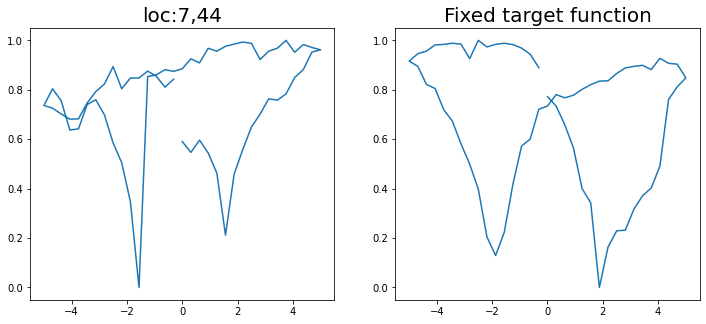

Epoch 1/200 ... Training loss: 3.3078
Epoch 10/200 ... Training loss: 3.0505
Epoch 20/200 ... Training loss: 2.768
Epoch 30/200 ... Training loss: 2.5818
Epoch 40/200 ... Training loss: 2.3909
Epoch 50/200 ... Training loss: 2.0369
Epoch 60/200 ... Training loss: 1.9471
Epoch 70/200 ... Training loss: 1.6827
Epoch 80/200 ... Training loss: 1.6078
Epoch 90/200 ... Training loss: 1.53
Epoch 100/200 ... Training loss: 1.4695
Epoch 110/200 ... Training loss: 1.3936
Epoch 120/200 ... Training loss: 1.407
Epoch 130/200 ... Training loss: 1.3504
Epoch 140/200 ... Training loss: 1.3222
Epoch 150/200 ... Training loss: 1.2389
Epoch 160/200 ... Training loss: 1.1939
Epoch 170/200 ... Training loss: 1.239
Epoch 180/200 ... Training loss: 1.1809
Epoch 190/200 ... Training loss: 1.2364
Epoch 200/200 ... Training loss: 1.0848
step:  30
Sample #40




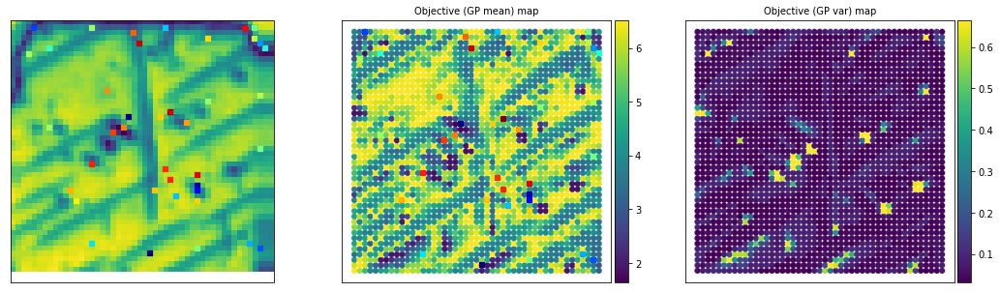

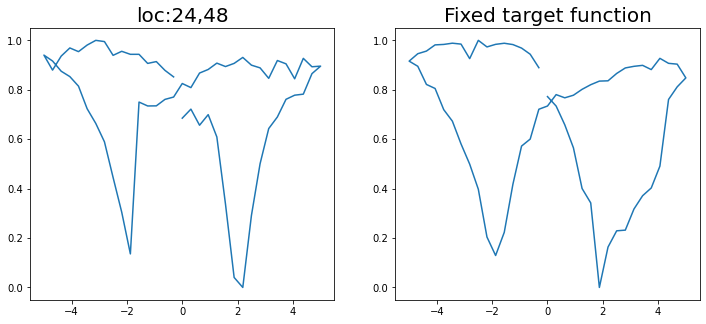

Epoch 1/200 ... Training loss: 3.259
Epoch 10/200 ... Training loss: 3.0121
Epoch 20/200 ... Training loss: 2.7274
Epoch 30/200 ... Training loss: 2.5314
Epoch 40/200 ... Training loss: 2.3181
Epoch 50/200 ... Training loss: 1.9634
Epoch 60/200 ... Training loss: 1.7882
Epoch 70/200 ... Training loss: 1.7092
Epoch 80/200 ... Training loss: 1.5958
Epoch 90/200 ... Training loss: 1.5043
Epoch 100/200 ... Training loss: 1.4648
Epoch 110/200 ... Training loss: 1.4153
Epoch 120/200 ... Training loss: 1.4847
Epoch 130/200 ... Training loss: 1.3426
Epoch 140/200 ... Training loss: 1.3395
Epoch 150/200 ... Training loss: 1.2512
Epoch 160/200 ... Training loss: 1.195
Epoch 170/200 ... Training loss: 1.2973
Epoch 180/200 ... Training loss: 1.1641
Epoch 190/200 ... Training loss: 1.134
Epoch 200/200 ... Training loss: 1.0763
step:  31
Sample #41




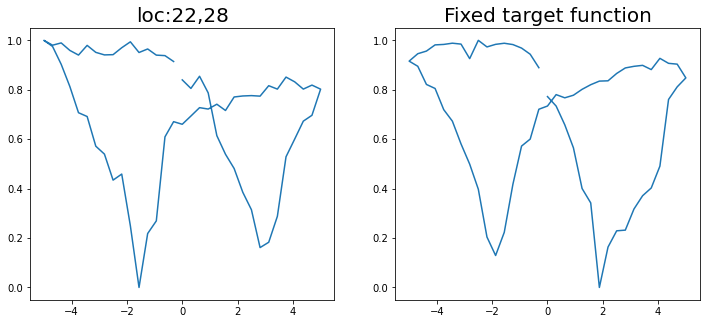

Epoch 1/200 ... Training loss: 3.2972
Epoch 10/200 ... Training loss: 3.0377
Epoch 20/200 ... Training loss: 2.7717
Epoch 30/200 ... Training loss: 2.5481
Epoch 40/200 ... Training loss: 2.3373
Epoch 50/200 ... Training loss: 1.9836
Epoch 60/200 ... Training loss: 1.7464
Epoch 70/200 ... Training loss: 1.5799
Epoch 80/200 ... Training loss: 1.488
Epoch 90/200 ... Training loss: 1.528
Epoch 100/200 ... Training loss: 2.1514
Epoch 110/200 ... Training loss: 1.9452
Epoch 120/200 ... Training loss: 1.7051
Epoch 130/200 ... Training loss: 1.5161
Epoch 140/200 ... Training loss: 1.3966
Epoch 150/200 ... Training loss: 1.327
Epoch 160/200 ... Training loss: 1.3445
Epoch 170/200 ... Training loss: 1.2971
Epoch 180/200 ... Training loss: 1.2423
Epoch 190/200 ... Training loss: 1.1792
Epoch 200/200 ... Training loss: 1.1787
step:  32
Sample #42




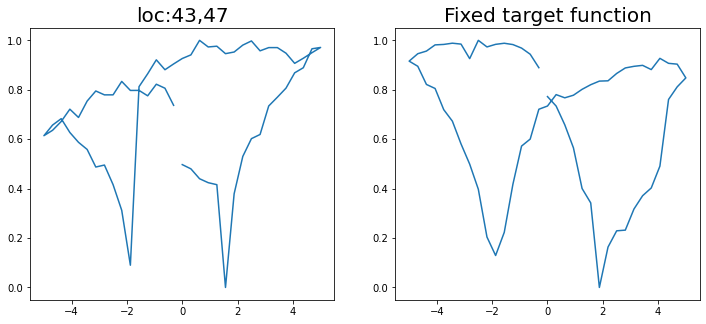

Epoch 1/200 ... Training loss: 3.2289
Epoch 10/200 ... Training loss: 2.9902
Epoch 20/200 ... Training loss: 2.6566
Epoch 30/200 ... Training loss: 2.5222
Epoch 40/200 ... Training loss: 2.3024
Epoch 50/200 ... Training loss: 2.0379
Epoch 60/200 ... Training loss: 1.8879
Epoch 70/200 ... Training loss: 1.6852
Epoch 80/200 ... Training loss: 1.534
Epoch 90/200 ... Training loss: 1.464
Epoch 100/200 ... Training loss: 1.4288
Epoch 110/200 ... Training loss: 1.4302
Epoch 120/200 ... Training loss: 1.3887
Epoch 130/200 ... Training loss: 1.2908
Epoch 140/200 ... Training loss: 1.2756
Epoch 150/200 ... Training loss: 1.2255
Epoch 160/200 ... Training loss: 1.1846
Epoch 170/200 ... Training loss: 1.1655
Epoch 180/200 ... Training loss: 1.1286
Epoch 190/200 ... Training loss: 1.0818
Epoch 200/200 ... Training loss: 1.1015
step:  33
Sample #43




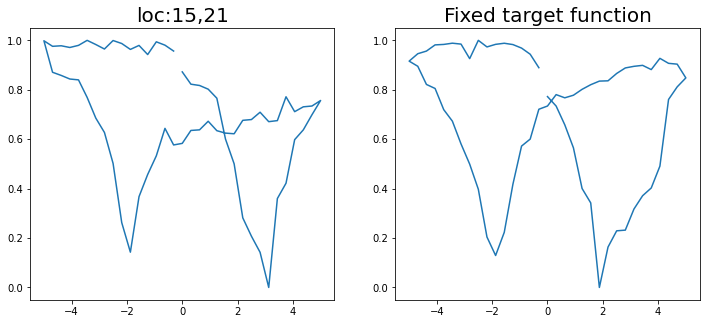

Epoch 1/200 ... Training loss: 3.2554
Epoch 10/200 ... Training loss: 2.887
Epoch 20/200 ... Training loss: 2.622
Epoch 30/200 ... Training loss: 2.3383
Epoch 40/200 ... Training loss: 1.9495
Epoch 50/200 ... Training loss: 1.7067
Epoch 60/200 ... Training loss: 1.6987
Epoch 70/200 ... Training loss: 1.5696
Epoch 80/200 ... Training loss: 1.4663
Epoch 90/200 ... Training loss: 1.3965
Epoch 100/200 ... Training loss: 1.365
Epoch 110/200 ... Training loss: 1.2839
Epoch 120/200 ... Training loss: 1.2437
Epoch 130/200 ... Training loss: 1.2988
Epoch 140/200 ... Training loss: 1.2285
Epoch 150/200 ... Training loss: 1.1536
Epoch 160/200 ... Training loss: 1.1061
Epoch 170/200 ... Training loss: 1.0962
Epoch 180/200 ... Training loss: 1.0845
Epoch 190/200 ... Training loss: 1.0611
Epoch 200/200 ... Training loss: 1.0743
step:  34
Sample #44




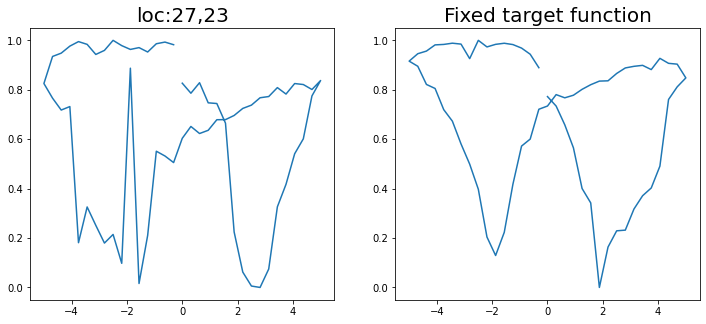

Epoch 1/200 ... Training loss: 3.2378
Epoch 10/200 ... Training loss: 2.982
Epoch 20/200 ... Training loss: 2.7387
Epoch 30/200 ... Training loss: 2.5304
Epoch 40/200 ... Training loss: 2.3653
Epoch 50/200 ... Training loss: 2.1232
Epoch 60/200 ... Training loss: 1.7567
Epoch 70/200 ... Training loss: 1.6058
Epoch 80/200 ... Training loss: 1.51
Epoch 90/200 ... Training loss: 1.4147
Epoch 100/200 ... Training loss: 1.4641
Epoch 110/200 ... Training loss: 1.3609
Epoch 120/200 ... Training loss: 1.3105
Epoch 130/200 ... Training loss: 1.3273
Epoch 140/200 ... Training loss: 1.3076
Epoch 150/200 ... Training loss: 1.2158
Epoch 160/200 ... Training loss: 1.1677
Epoch 170/200 ... Training loss: 1.1286
Epoch 180/200 ... Training loss: 1.1919
Epoch 190/200 ... Training loss: 1.1016
Epoch 200/200 ... Training loss: 1.0783
step:  35
Sample #45




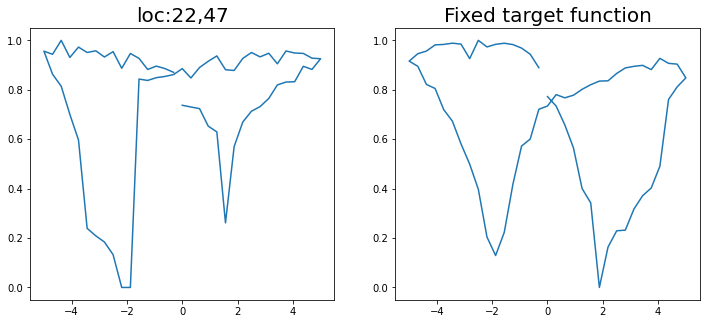

Epoch 1/200 ... Training loss: 3.1843
Epoch 10/200 ... Training loss: 2.9301
Epoch 20/200 ... Training loss: 2.7386
Epoch 30/200 ... Training loss: 2.4968
Epoch 40/200 ... Training loss: 2.3792
Epoch 50/200 ... Training loss: 2.1785
Epoch 60/200 ... Training loss: 1.896
Epoch 70/200 ... Training loss: 1.6587
Epoch 80/200 ... Training loss: 1.6404
Epoch 90/200 ... Training loss: 1.495
Epoch 100/200 ... Training loss: 1.4345
Epoch 110/200 ... Training loss: 1.3786
Epoch 120/200 ... Training loss: 1.4175
Epoch 130/200 ... Training loss: 1.2967
Epoch 140/200 ... Training loss: 1.2735
Epoch 150/200 ... Training loss: 1.2117
Epoch 160/200 ... Training loss: 1.1967
Epoch 170/200 ... Training loss: 1.1594
Epoch 180/200 ... Training loss: 1.1364
Epoch 190/200 ... Training loss: 1.1008
Epoch 200/200 ... Training loss: 1.2787
step:  36
Sample #46




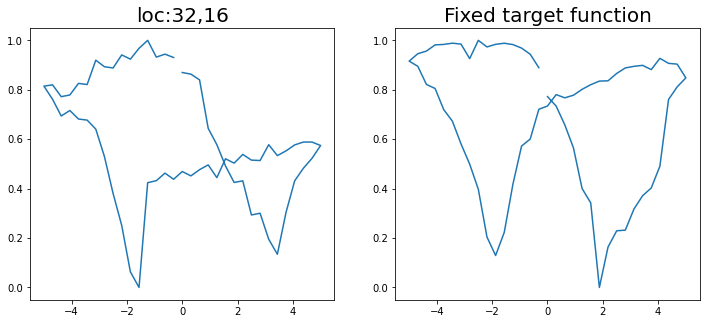

Epoch 1/200 ... Training loss: 3.1403
Epoch 10/200 ... Training loss: 2.8963
Epoch 20/200 ... Training loss: 2.598
Epoch 30/200 ... Training loss: 2.4659
Epoch 40/200 ... Training loss: 2.3281
Epoch 50/200 ... Training loss: 2.0498
Epoch 60/200 ... Training loss: 2.1018
Epoch 70/200 ... Training loss: 1.8539
Epoch 80/200 ... Training loss: 1.678
Epoch 90/200 ... Training loss: 1.5087
Epoch 100/200 ... Training loss: 1.6529
Epoch 110/200 ... Training loss: 1.4654
Epoch 120/200 ... Training loss: 1.4116
Epoch 130/200 ... Training loss: 1.3449
Epoch 140/200 ... Training loss: 1.2803
Epoch 150/200 ... Training loss: 1.2415
Epoch 160/200 ... Training loss: 1.208
Epoch 170/200 ... Training loss: 1.1943
Epoch 180/200 ... Training loss: 1.1934
Epoch 190/200 ... Training loss: 1.1154
Epoch 200/200 ... Training loss: 1.1517
step:  37
Sample #47




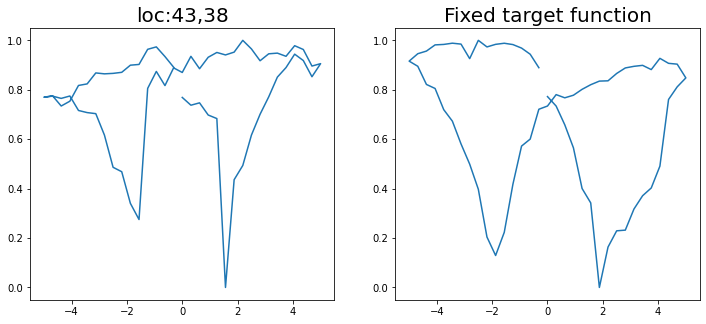

Epoch 1/200 ... Training loss: 3.0903
Epoch 10/200 ... Training loss: 2.8545
Epoch 20/200 ... Training loss: 2.6655
Epoch 30/200 ... Training loss: 2.4341
Epoch 40/200 ... Training loss: 2.3177
Epoch 50/200 ... Training loss: 2.1055
Epoch 60/200 ... Training loss: 1.8042
Epoch 70/200 ... Training loss: 1.6108
Epoch 80/200 ... Training loss: 1.8048
Epoch 90/200 ... Training loss: 1.5213
Epoch 100/200 ... Training loss: 1.4441
Epoch 110/200 ... Training loss: 1.4049
Epoch 120/200 ... Training loss: 1.3431
Epoch 130/200 ... Training loss: 1.3077
Epoch 140/200 ... Training loss: 1.409
Epoch 150/200 ... Training loss: 1.3115
Epoch 160/200 ... Training loss: 1.2341
Epoch 170/200 ... Training loss: 1.1974
Epoch 180/200 ... Training loss: 1.2119
Epoch 190/200 ... Training loss: 1.1396
Epoch 200/200 ... Training loss: 1.1209
step:  38
Sample #48




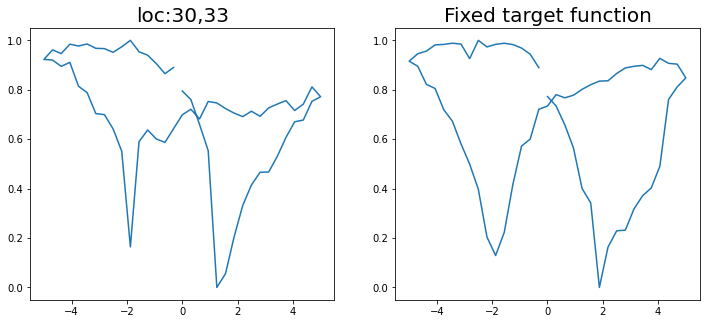

Epoch 1/200 ... Training loss: 3.0519
Epoch 10/200 ... Training loss: 2.8175
Epoch 20/200 ... Training loss: 2.5167
Epoch 30/200 ... Training loss: 2.4023
Epoch 40/200 ... Training loss: 2.2218
Epoch 50/200 ... Training loss: 1.8615
Epoch 60/200 ... Training loss: 1.6939
Epoch 70/200 ... Training loss: 1.5797
Epoch 80/200 ... Training loss: 1.5205
Epoch 90/200 ... Training loss: 1.4177
Epoch 100/200 ... Training loss: 1.4723
Epoch 110/200 ... Training loss: 1.3576
Epoch 120/200 ... Training loss: 1.3138
Epoch 130/200 ... Training loss: 1.2594
Epoch 140/200 ... Training loss: 1.2188
Epoch 150/200 ... Training loss: 1.1842
Epoch 160/200 ... Training loss: 1.2812
Epoch 170/200 ... Training loss: 1.1377
Epoch 180/200 ... Training loss: 1.1606
Epoch 190/200 ... Training loss: 1.066
Epoch 200/200 ... Training loss: 1.0431
step:  39
Sample #49




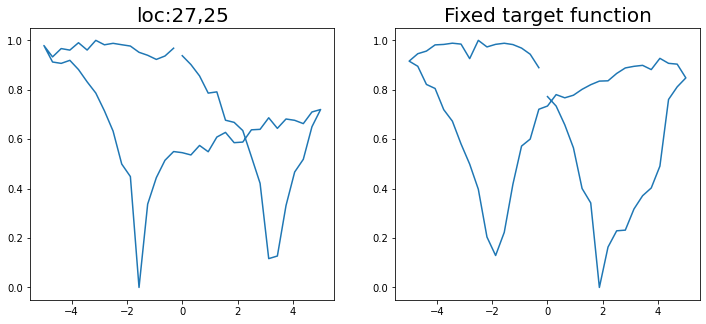

Epoch 1/200 ... Training loss: 3.0131
Epoch 10/200 ... Training loss: 2.7835
Epoch 20/200 ... Training loss: 2.4919
Epoch 30/200 ... Training loss: 2.3724
Epoch 40/200 ... Training loss: 2.2123
Epoch 50/200 ... Training loss: 1.9071
Epoch 60/200 ... Training loss: 1.742
Epoch 70/200 ... Training loss: 1.5359
Epoch 80/200 ... Training loss: 1.4276
Epoch 90/200 ... Training loss: 1.5397
Epoch 100/200 ... Training loss: 1.3744
Epoch 110/200 ... Training loss: 1.3024
Epoch 120/200 ... Training loss: 1.2618
Epoch 130/200 ... Training loss: 1.2611
Epoch 140/200 ... Training loss: 1.1993
Epoch 150/200 ... Training loss: 1.1585
Epoch 160/200 ... Training loss: 1.1422
Epoch 170/200 ... Training loss: 1.1407
Epoch 180/200 ... Training loss: 1.0951
Epoch 190/200 ... Training loss: 1.0616
Epoch 200/200 ... Training loss: 0.9877
step:  40
Sample #50




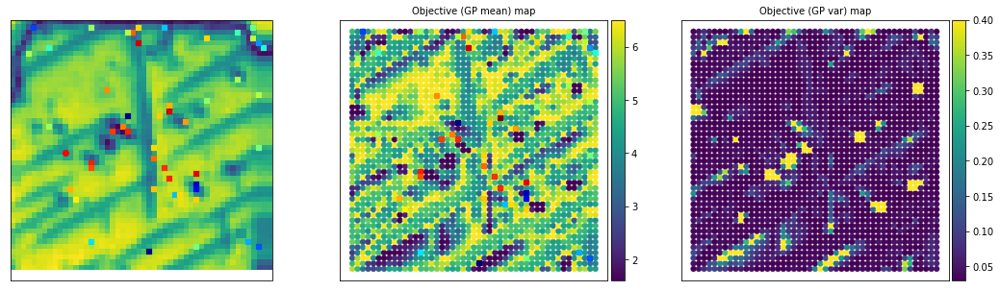

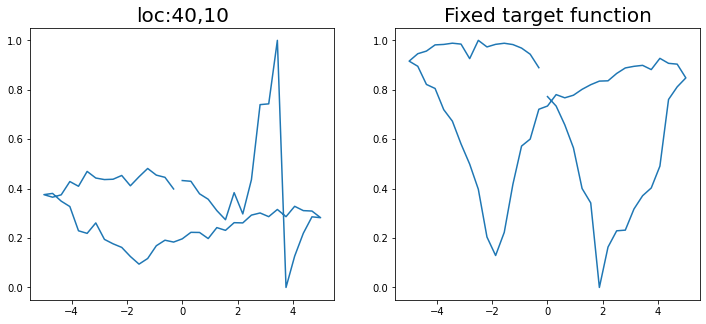

Epoch 1/200 ... Training loss: 3.0158
Epoch 10/200 ... Training loss: 2.7914
Epoch 20/200 ... Training loss: 2.5246
Epoch 30/200 ... Training loss: 2.3928
Epoch 40/200 ... Training loss: 2.2683
Epoch 50/200 ... Training loss: 2.0924
Epoch 60/200 ... Training loss: 1.7685
Epoch 70/200 ... Training loss: 1.5685
Epoch 80/200 ... Training loss: 1.473
Epoch 90/200 ... Training loss: 1.4273
Epoch 100/200 ... Training loss: 1.3941
Epoch 110/200 ... Training loss: 1.3143
Epoch 120/200 ... Training loss: 1.2806
Epoch 130/200 ... Training loss: 1.2508
Epoch 140/200 ... Training loss: 1.1901
Epoch 150/200 ... Training loss: 1.1467
Epoch 160/200 ... Training loss: 1.1926
Epoch 170/200 ... Training loss: 1.1307
Epoch 180/200 ... Training loss: 1.1204
Epoch 190/200 ... Training loss: 1.1306
Epoch 200/200 ... Training loss: 1.0439
step:  41
Sample #51




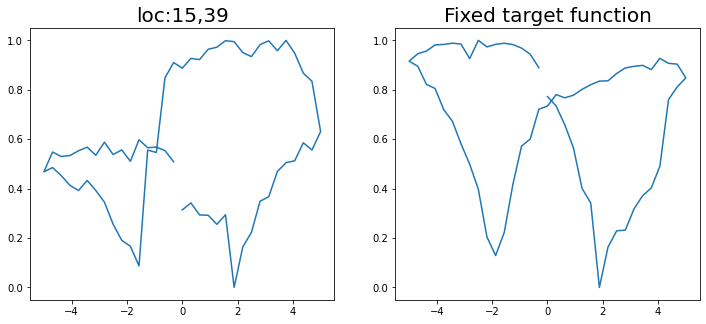

Epoch 1/200 ... Training loss: 2.9794
Epoch 10/200 ... Training loss: 2.7612
Epoch 20/200 ... Training loss: 2.5522
Epoch 30/200 ... Training loss: 2.3518
Epoch 40/200 ... Training loss: 2.2102
Epoch 50/200 ... Training loss: 1.947
Epoch 60/200 ... Training loss: 1.6807
Epoch 70/200 ... Training loss: 1.6738
Epoch 80/200 ... Training loss: 1.4768
Epoch 90/200 ... Training loss: 1.4039
Epoch 100/200 ... Training loss: 1.3618
Epoch 110/200 ... Training loss: 1.3329
Epoch 120/200 ... Training loss: 1.33
Epoch 130/200 ... Training loss: 1.2727
Epoch 140/200 ... Training loss: 1.2016
Epoch 150/200 ... Training loss: 1.2225
Epoch 160/200 ... Training loss: 1.1494
Epoch 170/200 ... Training loss: 1.086
Epoch 180/200 ... Training loss: 1.0454
Epoch 190/200 ... Training loss: 1.2194
Epoch 200/200 ... Training loss: 1.0098
step:  42
Sample #52




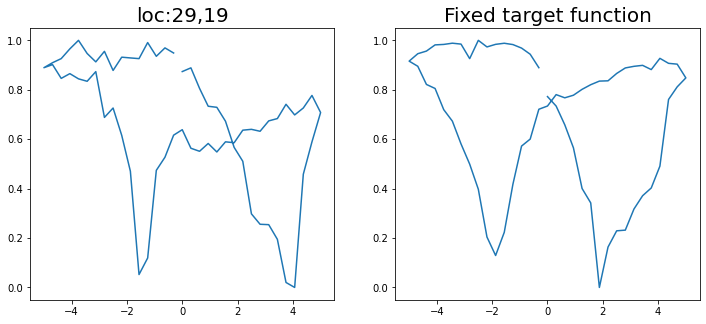

Epoch 1/200 ... Training loss: 2.9418
Epoch 10/200 ... Training loss: 2.7244
Epoch 20/200 ... Training loss: 2.4257
Epoch 30/200 ... Training loss: 2.32
Epoch 40/200 ... Training loss: 2.1504
Epoch 50/200 ... Training loss: 1.8721
Epoch 60/200 ... Training loss: 1.6371
Epoch 70/200 ... Training loss: 1.5155
Epoch 80/200 ... Training loss: 1.41
Epoch 90/200 ... Training loss: 1.583
Epoch 100/200 ... Training loss: 1.4048
Epoch 110/200 ... Training loss: 1.3254
Epoch 120/200 ... Training loss: 1.2871
Epoch 130/200 ... Training loss: 1.2427
Epoch 140/200 ... Training loss: 1.2272
Epoch 150/200 ... Training loss: 1.1871
Epoch 160/200 ... Training loss: 1.2551
Epoch 170/200 ... Training loss: 1.1221
Epoch 180/200 ... Training loss: 1.0646
Epoch 190/200 ... Training loss: 1.0231
Epoch 200/200 ... Training loss: 1.2251
step:  43
Sample #53




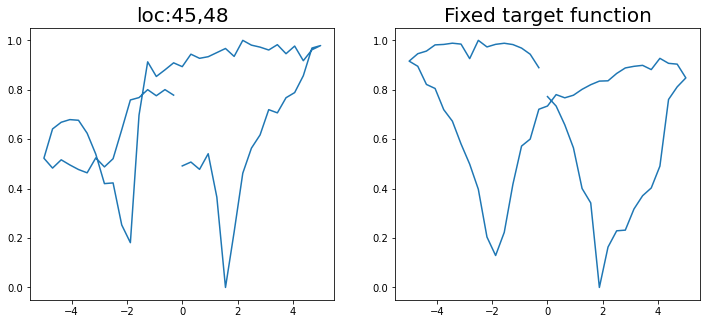

Epoch 1/200 ... Training loss: 2.9046
Epoch 10/200 ... Training loss: 2.7012
Epoch 20/200 ... Training loss: 2.4199
Epoch 30/200 ... Training loss: 2.3179
Epoch 40/200 ... Training loss: 2.1727
Epoch 50/200 ... Training loss: 1.8941
Epoch 60/200 ... Training loss: 1.6438
Epoch 70/200 ... Training loss: 1.5185
Epoch 80/200 ... Training loss: 1.4275
Epoch 90/200 ... Training loss: 1.416
Epoch 100/200 ... Training loss: 1.3396
Epoch 110/200 ... Training loss: 1.3053
Epoch 120/200 ... Training loss: 1.2422
Epoch 130/200 ... Training loss: 1.2458
Epoch 140/200 ... Training loss: 1.1817
Epoch 150/200 ... Training loss: 1.1448
Epoch 160/200 ... Training loss: 1.1513
Epoch 170/200 ... Training loss: 1.1094
Epoch 180/200 ... Training loss: 1.0412
Epoch 190/200 ... Training loss: 1.0517
Epoch 200/200 ... Training loss: 0.9769
step:  44
Sample #54




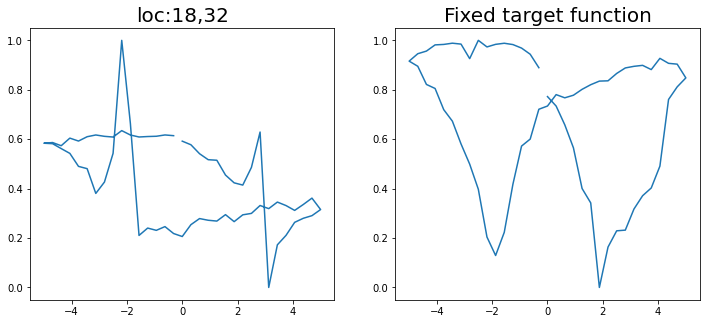

Epoch 1/200 ... Training loss: 2.939
Epoch 10/200 ... Training loss: 2.7507
Epoch 20/200 ... Training loss: 2.4992
Epoch 30/200 ... Training loss: 2.3764
Epoch 40/200 ... Training loss: 2.272
Epoch 50/200 ... Training loss: 2.1313
Epoch 60/200 ... Training loss: 1.9695
Epoch 70/200 ... Training loss: 1.7185
Epoch 80/200 ... Training loss: 1.5024
Epoch 90/200 ... Training loss: 1.4511
Epoch 100/200 ... Training loss: 1.3736
Epoch 110/200 ... Training loss: 1.3325
Epoch 120/200 ... Training loss: 1.2804
Epoch 130/200 ... Training loss: 1.2642
Epoch 140/200 ... Training loss: 1.2688
Epoch 150/200 ... Training loss: 1.2282
Epoch 160/200 ... Training loss: 1.2539
Epoch 170/200 ... Training loss: 1.1621
Epoch 180/200 ... Training loss: 1.1786
Epoch 190/200 ... Training loss: 1.127
Epoch 200/200 ... Training loss: 1.0548
step:  45
Sample #55




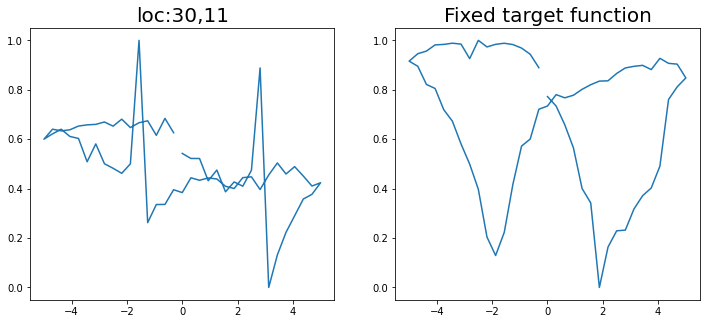

Epoch 1/200 ... Training loss: 2.9567
Epoch 10/200 ... Training loss: 2.761
Epoch 20/200 ... Training loss: 2.5861
Epoch 30/200 ... Training loss: 2.383
Epoch 40/200 ... Training loss: 2.2529
Epoch 50/200 ... Training loss: 1.9171
Epoch 60/200 ... Training loss: 1.689
Epoch 70/200 ... Training loss: 1.5753
Epoch 80/200 ... Training loss: 1.4656
Epoch 90/200 ... Training loss: 1.3874
Epoch 100/200 ... Training loss: 1.33
Epoch 110/200 ... Training loss: 1.3527
Epoch 120/200 ... Training loss: 1.4388
Epoch 130/200 ... Training loss: 1.2615
Epoch 140/200 ... Training loss: 1.2147
Epoch 150/200 ... Training loss: 1.1693
Epoch 160/200 ... Training loss: 1.1269
Epoch 170/200 ... Training loss: 1.3146
Epoch 180/200 ... Training loss: 1.1414
Epoch 190/200 ... Training loss: 1.0794
Epoch 200/200 ... Training loss: 1.0323
step:  46
Sample #56




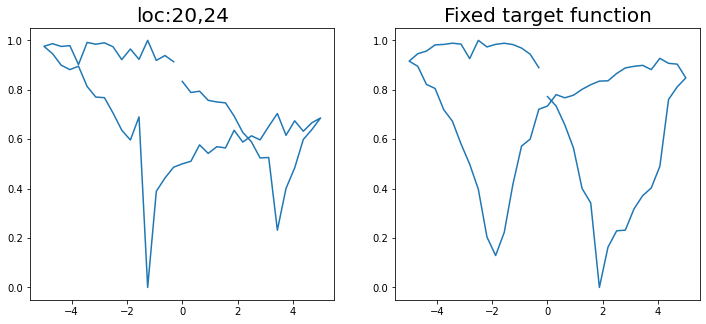

Epoch 1/200 ... Training loss: 2.919
Epoch 10/200 ... Training loss: 2.5398
Epoch 20/200 ... Training loss: 2.4195
Epoch 30/200 ... Training loss: 2.3007
Epoch 40/200 ... Training loss: 1.979
Epoch 50/200 ... Training loss: 1.7471
Epoch 60/200 ... Training loss: 1.6256
Epoch 70/200 ... Training loss: 1.5782
Epoch 80/200 ... Training loss: 1.4157
Epoch 90/200 ... Training loss: 1.3729
Epoch 100/200 ... Training loss: 1.2903
Epoch 110/200 ... Training loss: 1.2801
Epoch 120/200 ... Training loss: 1.2382
Epoch 130/200 ... Training loss: 1.2106
Epoch 140/200 ... Training loss: 1.204
Epoch 150/200 ... Training loss: 1.1831
Epoch 160/200 ... Training loss: 1.0863
Epoch 170/200 ... Training loss: 1.1568
Epoch 180/200 ... Training loss: 1.0615
Epoch 190/200 ... Training loss: 1.0195
Epoch 200/200 ... Training loss: 0.9999
step:  47
Sample #57




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


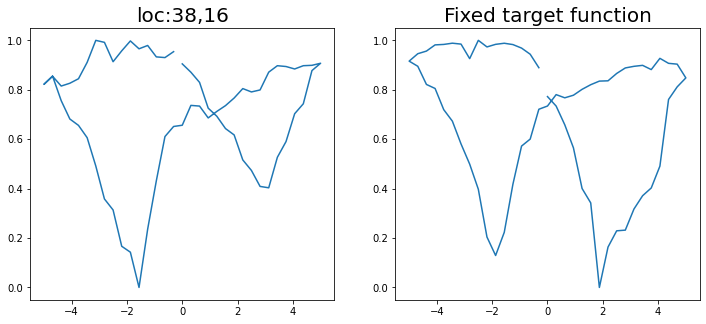

Epoch 1/200 ... Training loss: 2.9057
Epoch 10/200 ... Training loss: 2.702
Epoch 20/200 ... Training loss: 2.4963
Epoch 30/200 ... Training loss: 2.3492
Epoch 40/200 ... Training loss: 2.2469
Epoch 50/200 ... Training loss: 2.0808
Epoch 60/200 ... Training loss: 1.8655
Epoch 70/200 ... Training loss: 1.7469
Epoch 80/200 ... Training loss: 1.5691
Epoch 90/200 ... Training loss: 1.4924
Epoch 100/200 ... Training loss: 1.4962
Epoch 110/200 ... Training loss: 1.4699
Epoch 120/200 ... Training loss: 1.332
Epoch 130/200 ... Training loss: 1.3844
Epoch 140/200 ... Training loss: 1.2493
Epoch 150/200 ... Training loss: 1.2928
Epoch 160/200 ... Training loss: 1.2564
Epoch 170/200 ... Training loss: 1.2131
Epoch 180/200 ... Training loss: 1.1446
Epoch 190/200 ... Training loss: 1.1844
Epoch 200/200 ... Training loss: 1.1977
step:  48
Sample #58




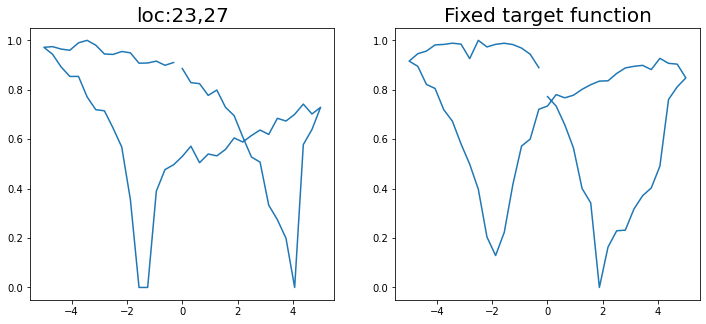

Epoch 1/200 ... Training loss: 2.8744
Epoch 10/200 ... Training loss: 2.651
Epoch 20/200 ... Training loss: 2.3877
Epoch 30/200 ... Training loss: 2.2841
Epoch 40/200 ... Training loss: 2.0785
Epoch 50/200 ... Training loss: 1.836
Epoch 60/200 ... Training loss: 1.7663
Epoch 70/200 ... Training loss: 1.6317
Epoch 80/200 ... Training loss: 1.5018
Epoch 90/200 ... Training loss: 1.5717
Epoch 100/200 ... Training loss: 1.4167
Epoch 110/200 ... Training loss: 1.3012
Epoch 120/200 ... Training loss: 1.2798
Epoch 130/200 ... Training loss: 1.232
Epoch 140/200 ... Training loss: 1.2322
Epoch 150/200 ... Training loss: 1.1508
Epoch 160/200 ... Training loss: 1.2632
Epoch 170/200 ... Training loss: 1.0968
Epoch 180/200 ... Training loss: 1.0561
Epoch 190/200 ... Training loss: 1.0199
Epoch 200/200 ... Training loss: 0.9831
step:  49
Sample #59




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


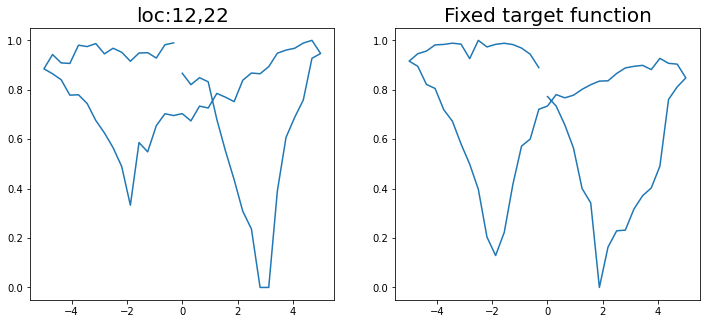

Epoch 1/200 ... Training loss: 2.8698
Epoch 10/200 ... Training loss: 2.58
Epoch 20/200 ... Training loss: 2.358
Epoch 30/200 ... Training loss: 2.2946
Epoch 40/200 ... Training loss: 2.0548
Epoch 50/200 ... Training loss: 1.8402
Epoch 60/200 ... Training loss: 1.7162
Epoch 70/200 ... Training loss: 1.8308
Epoch 80/200 ... Training loss: 1.6146
Epoch 90/200 ... Training loss: 1.5785
Epoch 100/200 ... Training loss: 1.3619
Epoch 110/200 ... Training loss: 1.4998
Epoch 120/200 ... Training loss: 1.3186
Epoch 130/200 ... Training loss: 1.2253
Epoch 140/200 ... Training loss: 1.2663
Epoch 150/200 ... Training loss: 1.2211
Epoch 160/200 ... Training loss: 1.1785
Epoch 170/200 ... Training loss: 1.2003
Epoch 180/200 ... Training loss: 1.0891
Epoch 190/200 ... Training loss: 1.0134
Epoch 200/200 ... Training loss: 1.1723
step:  50
Sample #60




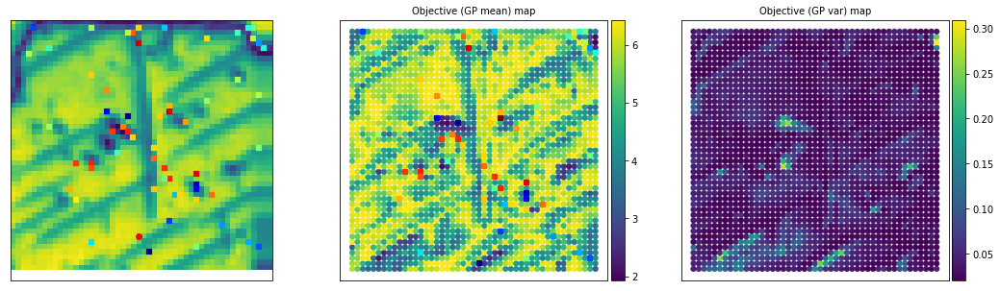

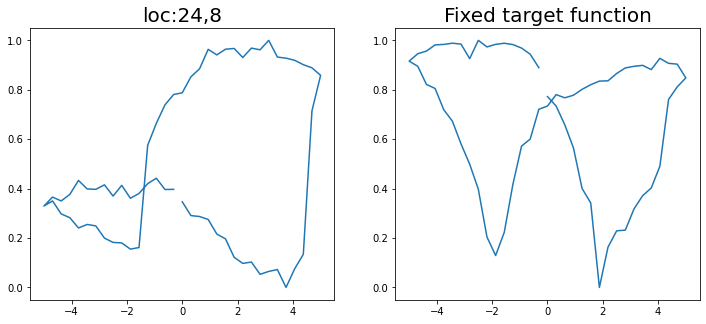

Epoch 1/200 ... Training loss: 2.8376
Epoch 10/200 ... Training loss: 2.6685
Epoch 20/200 ... Training loss: 2.3668
Epoch 30/200 ... Training loss: 2.2806
Epoch 40/200 ... Training loss: 2.1312
Epoch 50/200 ... Training loss: 1.9063
Epoch 60/200 ... Training loss: 1.7468
Epoch 70/200 ... Training loss: 1.63
Epoch 80/200 ... Training loss: 1.5127
Epoch 90/200 ... Training loss: 1.5631
Epoch 100/200 ... Training loss: 1.4496
Epoch 110/200 ... Training loss: 1.3029
Epoch 120/200 ... Training loss: 1.3696
Epoch 130/200 ... Training loss: 1.2719
Epoch 140/200 ... Training loss: 1.2878
Epoch 150/200 ... Training loss: 1.1685
Epoch 160/200 ... Training loss: 1.3111
Epoch 170/200 ... Training loss: 1.1971
Epoch 180/200 ... Training loss: 1.1416
Epoch 190/200 ... Training loss: 1.0909
Epoch 200/200 ... Training loss: 1.0424
step:  51
Sample #61




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


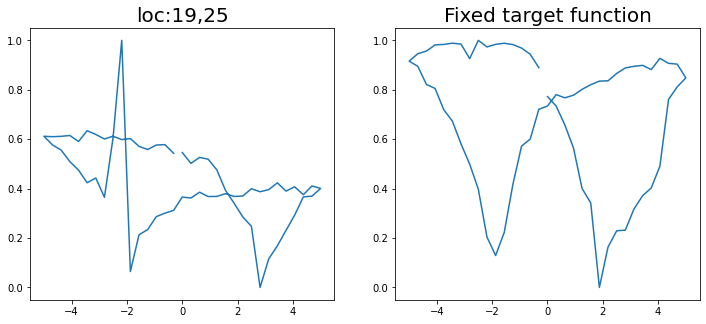

Epoch 1/200 ... Training loss: 2.8107
Epoch 10/200 ... Training loss: 2.5182
Epoch 20/200 ... Training loss: 2.3114
Epoch 30/200 ... Training loss: 2.2347
Epoch 40/200 ... Training loss: 2.0185
Epoch 50/200 ... Training loss: 1.8085
Epoch 60/200 ... Training loss: 1.7084
Epoch 70/200 ... Training loss: 1.7479
Epoch 80/200 ... Training loss: 1.4953
Epoch 90/200 ... Training loss: 1.4118
Epoch 100/200 ... Training loss: 1.4562
Epoch 110/200 ... Training loss: 1.3721
Epoch 120/200 ... Training loss: 1.2906
Epoch 130/200 ... Training loss: 1.229
Epoch 140/200 ... Training loss: 1.1671
Epoch 150/200 ... Training loss: 1.1567
Epoch 160/200 ... Training loss: 1.118
Epoch 170/200 ... Training loss: 1.2782
Epoch 180/200 ... Training loss: 1.1175
Epoch 190/200 ... Training loss: 1.1065
Epoch 200/200 ... Training loss: 1.1122
step:  52
Sample #62




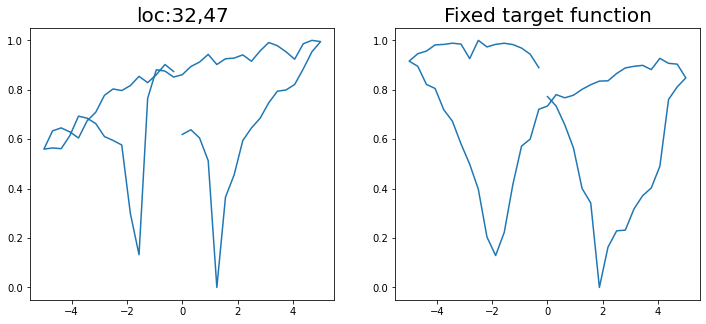

Epoch 1/200 ... Training loss: 2.7815
Epoch 10/200 ... Training loss: 2.628
Epoch 20/200 ... Training loss: 2.4912
Epoch 30/200 ... Training loss: 2.2687
Epoch 40/200 ... Training loss: 2.2173
Epoch 50/200 ... Training loss: 2.1208
Epoch 60/200 ... Training loss: 2.0081
Epoch 70/200 ... Training loss: 1.851
Epoch 80/200 ... Training loss: 1.6815
Epoch 90/200 ... Training loss: 1.5973
Epoch 100/200 ... Training loss: 1.7221
Epoch 110/200 ... Training loss: 1.5203
Epoch 120/200 ... Training loss: 1.4135
Epoch 130/200 ... Training loss: 1.7414
Epoch 140/200 ... Training loss: 1.5131
Epoch 150/200 ... Training loss: 1.3951
Epoch 160/200 ... Training loss: 1.3985
Epoch 170/200 ... Training loss: 1.3224
Epoch 180/200 ... Training loss: 1.2289
Epoch 190/200 ... Training loss: 1.2855
Epoch 200/200 ... Training loss: 1.2242
step:  53
Sample #63




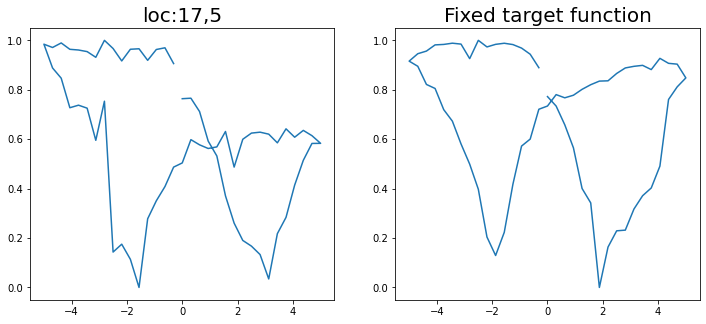

Epoch 1/200 ... Training loss: 2.7577
Epoch 10/200 ... Training loss: 2.4129
Epoch 20/200 ... Training loss: 2.2866
Epoch 30/200 ... Training loss: 2.0545
Epoch 40/200 ... Training loss: 1.8693
Epoch 50/200 ... Training loss: 1.741
Epoch 60/200 ... Training loss: 1.6649
Epoch 70/200 ... Training loss: 1.4778
Epoch 80/200 ... Training loss: 1.4416
Epoch 90/200 ... Training loss: 1.4527
Epoch 100/200 ... Training loss: 1.3635
Epoch 110/200 ... Training loss: 1.2339
Epoch 120/200 ... Training loss: 1.3731
Epoch 130/200 ... Training loss: 1.1981
Epoch 140/200 ... Training loss: 1.1086
Epoch 150/200 ... Training loss: 1.334
Epoch 160/200 ... Training loss: 1.1459
Epoch 170/200 ... Training loss: 1.2262
Epoch 180/200 ... Training loss: 1.1523
Epoch 190/200 ... Training loss: 0.9958
Epoch 200/200 ... Training loss: 0.9585
step:  54
Sample #64




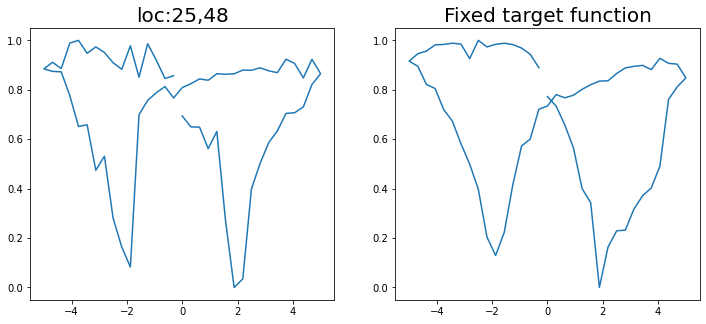

Epoch 1/200 ... Training loss: 2.7541
Epoch 10/200 ... Training loss: 2.5912
Epoch 20/200 ... Training loss: 2.3483
Epoch 30/200 ... Training loss: 2.2187
Epoch 40/200 ... Training loss: 2.0533
Epoch 50/200 ... Training loss: 1.8433
Epoch 60/200 ... Training loss: 1.7582
Epoch 70/200 ... Training loss: 1.5864
Epoch 80/200 ... Training loss: 1.531
Epoch 90/200 ... Training loss: 1.4113
Epoch 100/200 ... Training loss: 1.42
Epoch 110/200 ... Training loss: 1.3585
Epoch 120/200 ... Training loss: 1.2657
Epoch 130/200 ... Training loss: 1.2765
Epoch 140/200 ... Training loss: 1.22
Epoch 150/200 ... Training loss: 1.1718
Epoch 160/200 ... Training loss: 1.2094
Epoch 170/200 ... Training loss: 1.1727
Epoch 180/200 ... Training loss: 1.2042
Epoch 190/200 ... Training loss: 1.0403
Epoch 200/200 ... Training loss: 0.9718
step:  55
Sample #65




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


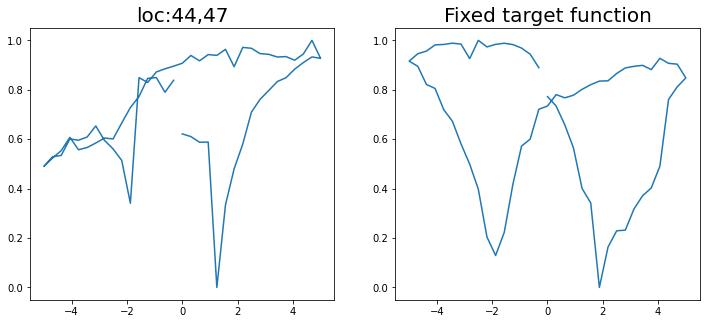

Epoch 1/200 ... Training loss: 2.7585
Epoch 10/200 ... Training loss: 2.5357
Epoch 20/200 ... Training loss: 2.2858
Epoch 30/200 ... Training loss: 2.1853
Epoch 40/200 ... Training loss: 1.9457
Epoch 50/200 ... Training loss: 1.7677
Epoch 60/200 ... Training loss: 1.6801
Epoch 70/200 ... Training loss: 1.5671
Epoch 80/200 ... Training loss: 1.4865
Epoch 90/200 ... Training loss: 1.398
Epoch 100/200 ... Training loss: 1.3883
Epoch 110/200 ... Training loss: 1.3464
Epoch 120/200 ... Training loss: 1.2524
Epoch 130/200 ... Training loss: 1.2356
Epoch 140/200 ... Training loss: 1.2962
Epoch 150/200 ... Training loss: 1.1837
Epoch 160/200 ... Training loss: 1.1561
Epoch 170/200 ... Training loss: 1.0515
Epoch 180/200 ... Training loss: 1.0128
Epoch 190/200 ... Training loss: 0.9864
Epoch 200/200 ... Training loss: 0.9401
step:  56
Sample #66




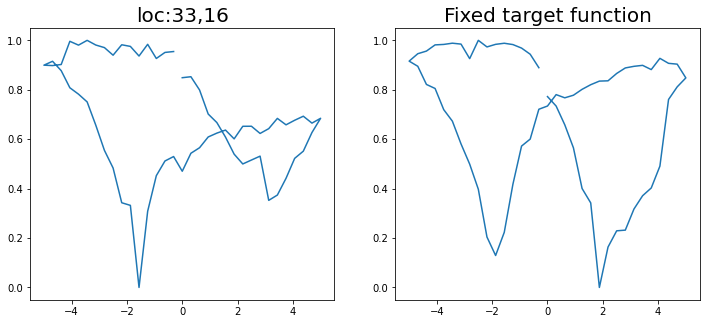

Epoch 1/200 ... Training loss: 2.7407
Epoch 10/200 ... Training loss: 2.7167
Epoch 20/200 ... Training loss: 2.2226
Epoch 30/200 ... Training loss: 2.1003
Epoch 40/200 ... Training loss: 1.9577
Epoch 50/200 ... Training loss: 1.7771
Epoch 60/200 ... Training loss: 1.6916
Epoch 70/200 ... Training loss: 1.5939
Epoch 80/200 ... Training loss: 1.686
Epoch 90/200 ... Training loss: 1.4855
Epoch 100/200 ... Training loss: 1.4461
Epoch 110/200 ... Training loss: 1.3405
Epoch 120/200 ... Training loss: 1.2959
Epoch 130/200 ... Training loss: 1.2688
Epoch 140/200 ... Training loss: 1.3182
Epoch 150/200 ... Training loss: 1.2112
Epoch 160/200 ... Training loss: 1.1255
Epoch 170/200 ... Training loss: 1.101
Epoch 180/200 ... Training loss: 1.0994
Epoch 190/200 ... Training loss: 1.0911
Epoch 200/200 ... Training loss: 1.1218
step:  57
Sample #67




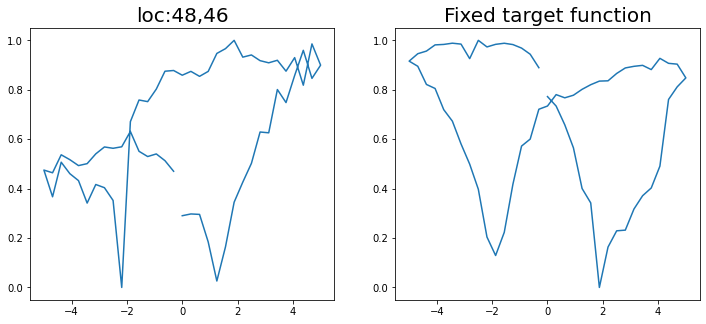

Epoch 1/200 ... Training loss: 2.7236
Epoch 10/200 ... Training loss: 2.5484
Epoch 20/200 ... Training loss: 2.2934
Epoch 30/200 ... Training loss: 2.15
Epoch 40/200 ... Training loss: 1.91
Epoch 50/200 ... Training loss: 1.797
Epoch 60/200 ... Training loss: 1.7251
Epoch 70/200 ... Training loss: 1.6737
Epoch 80/200 ... Training loss: 1.4768
Epoch 90/200 ... Training loss: 1.4072
Epoch 100/200 ... Training loss: 1.3046
Epoch 110/200 ... Training loss: 1.4097
Epoch 120/200 ... Training loss: 1.2987
Epoch 130/200 ... Training loss: 1.2246
Epoch 140/200 ... Training loss: 1.1761
Epoch 150/200 ... Training loss: 1.1874
Epoch 160/200 ... Training loss: 1.102
Epoch 170/200 ... Training loss: 1.4285
Epoch 180/200 ... Training loss: 1.1762
Epoch 190/200 ... Training loss: 1.0579
Epoch 200/200 ... Training loss: 1.052
step:  58
Sample #68




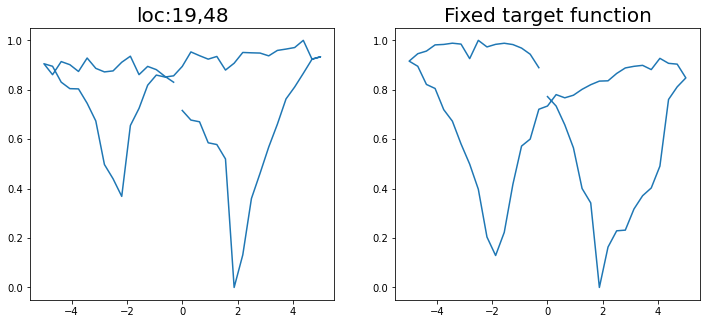

Epoch 1/200 ... Training loss: 2.7256
Epoch 10/200 ... Training loss: 2.407
Epoch 20/200 ... Training loss: 2.2999
Epoch 30/200 ... Training loss: 2.0706
Epoch 40/200 ... Training loss: 1.8698
Epoch 50/200 ... Training loss: 1.7285
Epoch 60/200 ... Training loss: 1.6904
Epoch 70/200 ... Training loss: 1.4913
Epoch 80/200 ... Training loss: 1.3777
Epoch 90/200 ... Training loss: 1.3092
Epoch 100/200 ... Training loss: 1.2533
Epoch 110/200 ... Training loss: 1.2114
Epoch 120/200 ... Training loss: 1.2118
Epoch 130/200 ... Training loss: 1.2569
Epoch 140/200 ... Training loss: 1.1375
Epoch 150/200 ... Training loss: 1.1693
Epoch 160/200 ... Training loss: 1.054
Epoch 170/200 ... Training loss: 1.0653
Epoch 180/200 ... Training loss: 1.0278
Epoch 190/200 ... Training loss: 0.9243
Epoch 200/200 ... Training loss: 0.965
step:  59
Sample #69




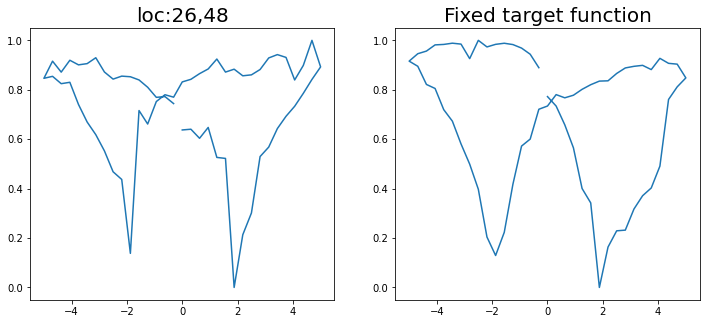

Epoch 1/200 ... Training loss: 2.7326
Epoch 10/200 ... Training loss: 2.4216
Epoch 20/200 ... Training loss: 2.286
Epoch 30/200 ... Training loss: 2.1609
Epoch 40/200 ... Training loss: 1.9826
Epoch 50/200 ... Training loss: 1.7966
Epoch 60/200 ... Training loss: 1.6576
Epoch 70/200 ... Training loss: 1.641
Epoch 80/200 ... Training loss: 1.4631
Epoch 90/200 ... Training loss: 1.41
Epoch 100/200 ... Training loss: 1.4302
Epoch 110/200 ... Training loss: 1.2942
Epoch 120/200 ... Training loss: 1.2556
Epoch 130/200 ... Training loss: 1.3439
Epoch 140/200 ... Training loss: 1.2056
Epoch 150/200 ... Training loss: 1.1716
Epoch 160/200 ... Training loss: 1.1979
Epoch 170/200 ... Training loss: 1.0803
Epoch 180/200 ... Training loss: 1.1077
Epoch 190/200 ... Training loss: 1.0344
Epoch 200/200 ... Training loss: 0.9996
step:  60
Sample #70




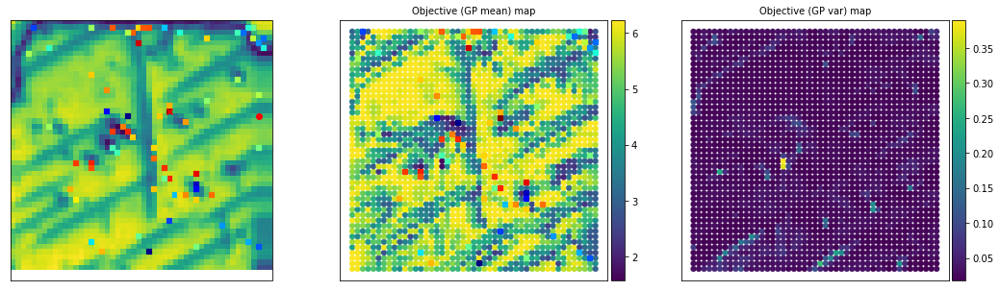

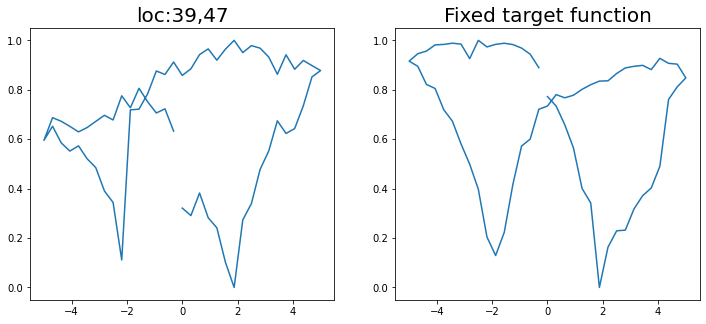

Epoch 1/200 ... Training loss: 2.705
Epoch 10/200 ... Training loss: 2.4546
Epoch 20/200 ... Training loss: 2.2484
Epoch 30/200 ... Training loss: 2.0701
Epoch 40/200 ... Training loss: 1.8441
Epoch 50/200 ... Training loss: 1.7006
Epoch 60/200 ... Training loss: 1.7139
Epoch 70/200 ... Training loss: 1.5483
Epoch 80/200 ... Training loss: 1.5113
Epoch 90/200 ... Training loss: 1.3998
Epoch 100/200 ... Training loss: 1.5791
Epoch 110/200 ... Training loss: 1.3755
Epoch 120/200 ... Training loss: 1.2658
Epoch 130/200 ... Training loss: 1.2322
Epoch 140/200 ... Training loss: 1.2597
Epoch 150/200 ... Training loss: 1.2151
Epoch 160/200 ... Training loss: 1.1865
Epoch 170/200 ... Training loss: 1.072
Epoch 180/200 ... Training loss: 1.0194
Epoch 190/200 ... Training loss: 1.0205
Epoch 200/200 ... Training loss: 0.9512
step:  61
Sample #71




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


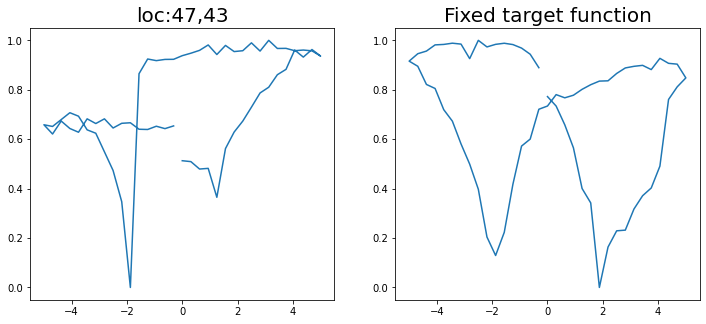

Epoch 1/200 ... Training loss: 2.6991
Epoch 10/200 ... Training loss: 2.4889
Epoch 20/200 ... Training loss: 2.2604
Epoch 30/200 ... Training loss: 2.0938
Epoch 40/200 ... Training loss: 1.865
Epoch 50/200 ... Training loss: 1.7369
Epoch 60/200 ... Training loss: 1.6403
Epoch 70/200 ... Training loss: 1.5983
Epoch 80/200 ... Training loss: 1.4402
Epoch 90/200 ... Training loss: 1.3385
Epoch 100/200 ... Training loss: 1.3077
Epoch 110/200 ... Training loss: 1.2684
Epoch 120/200 ... Training loss: 1.237
Epoch 130/200 ... Training loss: 1.2059
Epoch 140/200 ... Training loss: 1.2066
Epoch 150/200 ... Training loss: 1.1555
Epoch 160/200 ... Training loss: 1.1348
Epoch 170/200 ... Training loss: 1.0569
Epoch 180/200 ... Training loss: 1.0403
Epoch 190/200 ... Training loss: 0.9475
Epoch 200/200 ... Training loss: 1.1546
step:  62
Sample #72




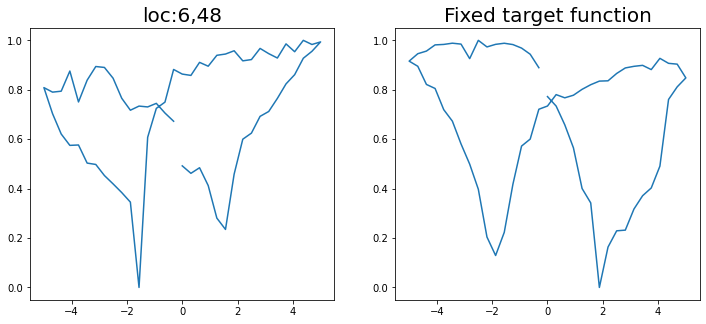

Epoch 1/200 ... Training loss: 2.6753
Epoch 10/200 ... Training loss: 2.5411
Epoch 20/200 ... Training loss: 2.3554
Epoch 30/200 ... Training loss: 2.1833
Epoch 40/200 ... Training loss: 2.0669
Epoch 50/200 ... Training loss: 1.9093
Epoch 60/200 ... Training loss: 1.7887
Epoch 70/200 ... Training loss: 1.6348
Epoch 80/200 ... Training loss: 1.5015
Epoch 90/200 ... Training loss: 1.4471
Epoch 100/200 ... Training loss: 1.3952
Epoch 110/200 ... Training loss: 1.4532
Epoch 120/200 ... Training loss: 1.3924
Epoch 130/200 ... Training loss: 1.3039
Epoch 140/200 ... Training loss: 1.3131
Epoch 150/200 ... Training loss: 1.2099
Epoch 160/200 ... Training loss: 1.2263
Epoch 170/200 ... Training loss: 1.1781
Epoch 180/200 ... Training loss: 1.2477
Epoch 190/200 ... Training loss: 1.1401
Epoch 200/200 ... Training loss: 1.1627
step:  63
Sample #73




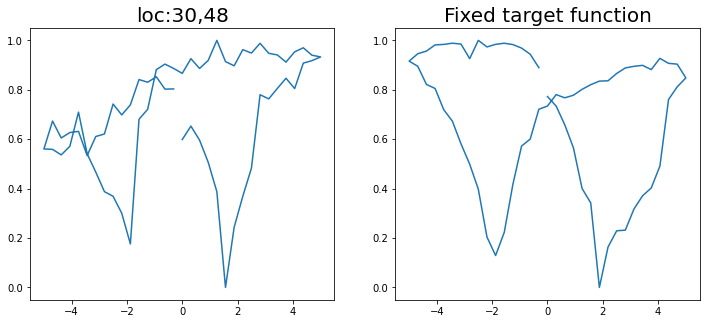

Epoch 1/200 ... Training loss: 2.6491
Epoch 10/200 ... Training loss: 2.3206
Epoch 20/200 ... Training loss: 2.201
Epoch 30/200 ... Training loss: 2.0466
Epoch 40/200 ... Training loss: 1.8285
Epoch 50/200 ... Training loss: 1.7571
Epoch 60/200 ... Training loss: 1.5945
Epoch 70/200 ... Training loss: 1.505
Epoch 80/200 ... Training loss: 1.3955
Epoch 90/200 ... Training loss: 1.4005
Epoch 100/200 ... Training loss: 1.3
Epoch 110/200 ... Training loss: 1.3087
Epoch 120/200 ... Training loss: 1.3055
Epoch 130/200 ... Training loss: 1.1684
Epoch 140/200 ... Training loss: 1.1072
Epoch 150/200 ... Training loss: 1.0818
Epoch 160/200 ... Training loss: 1.0913
Epoch 170/200 ... Training loss: 1.0431
Epoch 180/200 ... Training loss: 1.055
Epoch 190/200 ... Training loss: 1.0135
Epoch 200/200 ... Training loss: 0.9121
step:  64
Sample #74




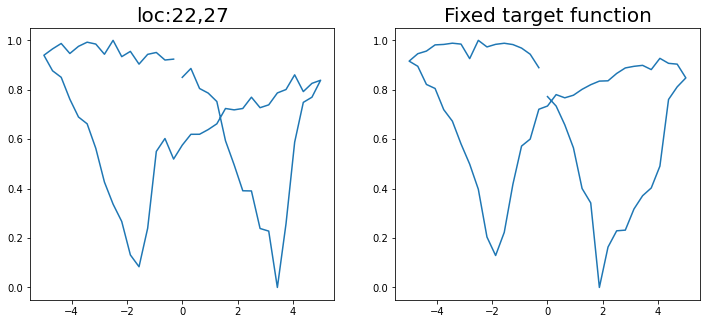

Epoch 1/200 ... Training loss: 2.6642
Epoch 10/200 ... Training loss: 2.3841
Epoch 20/200 ... Training loss: 2.1867
Epoch 30/200 ... Training loss: 1.9842
Epoch 40/200 ... Training loss: 1.7919
Epoch 50/200 ... Training loss: 1.7582
Epoch 60/200 ... Training loss: 1.5644
Epoch 70/200 ... Training loss: 1.531
Epoch 80/200 ... Training loss: 1.369
Epoch 90/200 ... Training loss: 1.3065
Epoch 100/200 ... Training loss: 1.2503
Epoch 110/200 ... Training loss: 1.2443
Epoch 120/200 ... Training loss: 1.237
Epoch 130/200 ... Training loss: 1.1839
Epoch 140/200 ... Training loss: 1.1161
Epoch 150/200 ... Training loss: 1.0559
Epoch 160/200 ... Training loss: 1.0623
Epoch 170/200 ... Training loss: 1.0882
Epoch 180/200 ... Training loss: 0.9643
Epoch 190/200 ... Training loss: 1.1444
Epoch 200/200 ... Training loss: 0.8702
step:  65
Sample #75




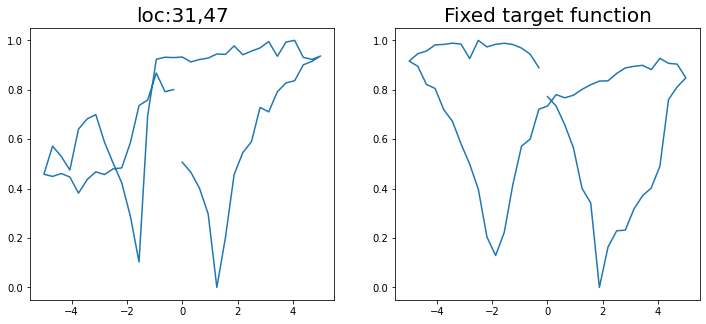

Epoch 1/200 ... Training loss: 2.6777
Epoch 10/200 ... Training loss: 2.3863
Epoch 20/200 ... Training loss: 2.2403
Epoch 30/200 ... Training loss: 2.0921
Epoch 40/200 ... Training loss: 1.8483
Epoch 50/200 ... Training loss: 1.7255
Epoch 60/200 ... Training loss: 1.7718
Epoch 70/200 ... Training loss: 1.5513
Epoch 80/200 ... Training loss: 1.4693
Epoch 90/200 ... Training loss: 1.4032
Epoch 100/200 ... Training loss: 1.4046
Epoch 110/200 ... Training loss: 1.3128
Epoch 120/200 ... Training loss: 1.212
Epoch 130/200 ... Training loss: 1.2717
Epoch 140/200 ... Training loss: 1.151
Epoch 150/200 ... Training loss: 1.1981
Epoch 160/200 ... Training loss: 1.0963
Epoch 170/200 ... Training loss: 1.0676
Epoch 180/200 ... Training loss: 1.0325
Epoch 190/200 ... Training loss: 0.9568
Epoch 200/200 ... Training loss: 1.0318
step:  66
Sample #76




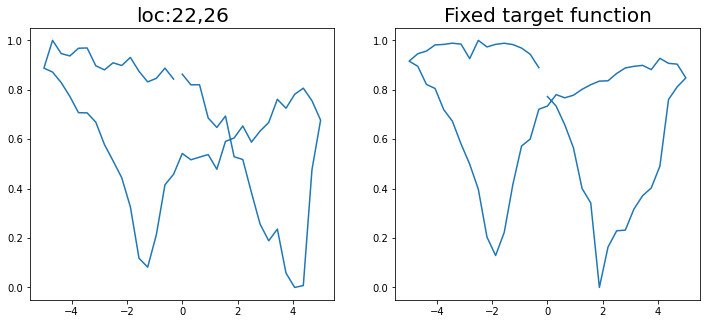

Epoch 1/200 ... Training loss: 2.635
Epoch 10/200 ... Training loss: 2.515
Epoch 20/200 ... Training loss: 2.2526
Epoch 30/200 ... Training loss: 2.1479
Epoch 40/200 ... Training loss: 2.0182
Epoch 50/200 ... Training loss: 1.8188
Epoch 60/200 ... Training loss: 1.6871
Epoch 70/200 ... Training loss: 1.5404
Epoch 80/200 ... Training loss: 1.5003
Epoch 90/200 ... Training loss: 1.3669
Epoch 100/200 ... Training loss: 1.4048
Epoch 110/200 ... Training loss: 1.3331
Epoch 120/200 ... Training loss: 1.2574
Epoch 130/200 ... Training loss: 1.2529
Epoch 140/200 ... Training loss: 1.1654
Epoch 150/200 ... Training loss: 1.1318
Epoch 160/200 ... Training loss: 1.1287
Epoch 170/200 ... Training loss: 1.0542
Epoch 180/200 ... Training loss: 1.1648
Epoch 190/200 ... Training loss: 1.0188
Epoch 200/200 ... Training loss: 1.0214
step:  67
Sample #77




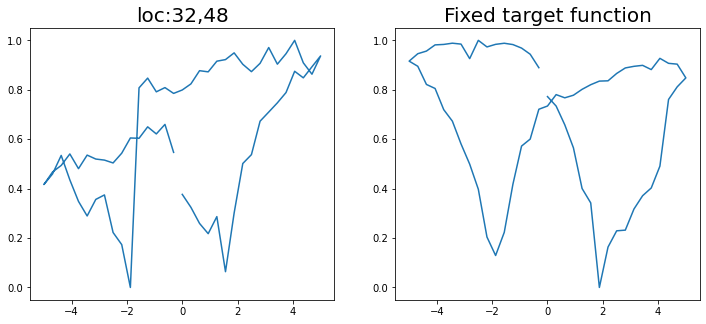

Epoch 1/200 ... Training loss: 2.6187
Epoch 10/200 ... Training loss: 2.3811
Epoch 20/200 ... Training loss: 2.2255
Epoch 30/200 ... Training loss: 2.0701
Epoch 40/200 ... Training loss: 1.85
Epoch 50/200 ... Training loss: 1.8517
Epoch 60/200 ... Training loss: 1.6773
Epoch 70/200 ... Training loss: 1.4986
Epoch 80/200 ... Training loss: 1.4246
Epoch 90/200 ... Training loss: 1.4323
Epoch 100/200 ... Training loss: 1.3559
Epoch 110/200 ... Training loss: 1.2983
Epoch 120/200 ... Training loss: 1.2365
Epoch 130/200 ... Training loss: 1.3361
Epoch 140/200 ... Training loss: 1.1961
Epoch 150/200 ... Training loss: 1.1223
Epoch 160/200 ... Training loss: 1.0914
Epoch 170/200 ... Training loss: 1.1437
Epoch 180/200 ... Training loss: 1.0557
Epoch 190/200 ... Training loss: 1.0517
Epoch 200/200 ... Training loss: 0.96
step:  68
Sample #78




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


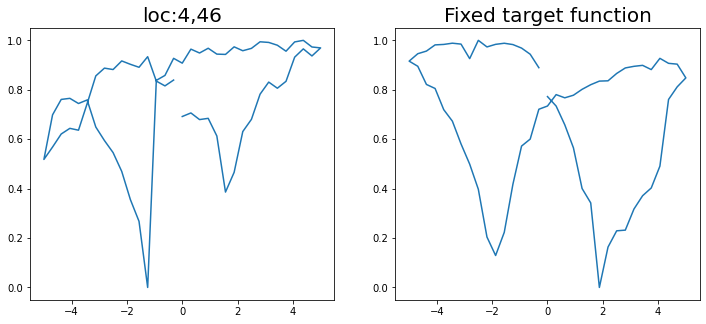

Epoch 1/200 ... Training loss: 2.5962
Epoch 10/200 ... Training loss: 2.4258
Epoch 20/200 ... Training loss: 2.2214
Epoch 30/200 ... Training loss: 2.1276
Epoch 40/200 ... Training loss: 2.0134
Epoch 50/200 ... Training loss: 1.8322
Epoch 60/200 ... Training loss: 1.7145
Epoch 70/200 ... Training loss: 1.5755
Epoch 80/200 ... Training loss: 1.5754
Epoch 90/200 ... Training loss: 1.4513
Epoch 100/200 ... Training loss: 1.4483
Epoch 110/200 ... Training loss: 1.3497
Epoch 120/200 ... Training loss: 1.31
Epoch 130/200 ... Training loss: 1.2433
Epoch 140/200 ... Training loss: 1.1944
Epoch 150/200 ... Training loss: 1.1717
Epoch 160/200 ... Training loss: 1.1226
Epoch 170/200 ... Training loss: 1.1051
Epoch 180/200 ... Training loss: 1.0598
Epoch 190/200 ... Training loss: 1.0214
Epoch 200/200 ... Training loss: 1.0452
step:  69
Sample #79




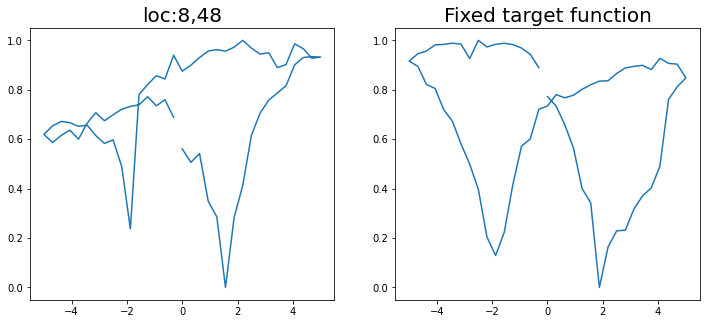

Epoch 1/200 ... Training loss: 2.5814
Epoch 10/200 ... Training loss: 2.3216
Epoch 20/200 ... Training loss: 2.2112
Epoch 30/200 ... Training loss: 2.1217
Epoch 40/200 ... Training loss: 2.0019
Epoch 50/200 ... Training loss: 1.8087
Epoch 60/200 ... Training loss: 1.7347
Epoch 70/200 ... Training loss: 1.5895
Epoch 80/200 ... Training loss: 1.6489
Epoch 90/200 ... Training loss: 1.4671
Epoch 100/200 ... Training loss: 1.5161
Epoch 110/200 ... Training loss: 1.39
Epoch 120/200 ... Training loss: 1.4184
Epoch 130/200 ... Training loss: 1.3024
Epoch 140/200 ... Training loss: 1.2208
Epoch 150/200 ... Training loss: 1.1934
Epoch 160/200 ... Training loss: 1.2462
Epoch 170/200 ... Training loss: 1.1308
Epoch 180/200 ... Training loss: 1.0729
Epoch 190/200 ... Training loss: 1.1452
Epoch 200/200 ... Training loss: 1.0709
step:  70
Sample #80




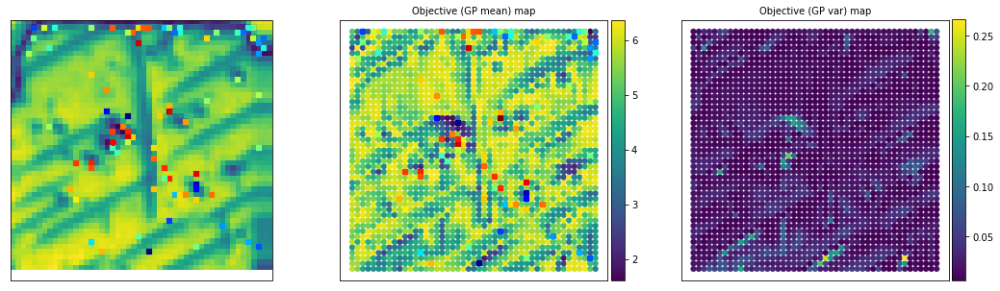

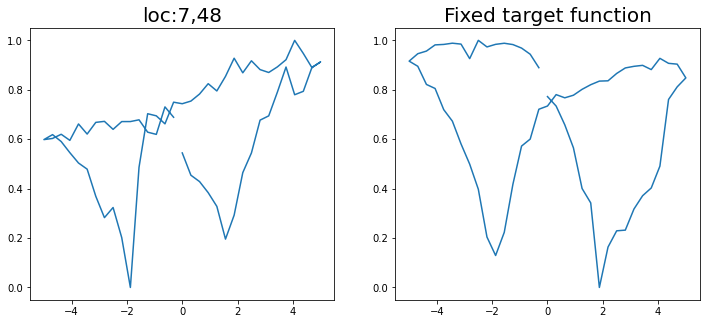

Epoch 1/200 ... Training loss: 2.559
Epoch 10/200 ... Training loss: 2.4125
Epoch 20/200 ... Training loss: 2.204
Epoch 30/200 ... Training loss: 2.1124
Epoch 40/200 ... Training loss: 2.0176
Epoch 50/200 ... Training loss: 1.8597
Epoch 60/200 ... Training loss: 1.6922
Epoch 70/200 ... Training loss: 1.5999
Epoch 80/200 ... Training loss: 1.7627
Epoch 90/200 ... Training loss: 1.5108
Epoch 100/200 ... Training loss: 1.4092
Epoch 110/200 ... Training loss: 1.3771
Epoch 120/200 ... Training loss: 1.3132
Epoch 130/200 ... Training loss: 1.2674
Epoch 140/200 ... Training loss: 1.3049
Epoch 150/200 ... Training loss: 1.2008
Epoch 160/200 ... Training loss: 1.1735
Epoch 170/200 ... Training loss: 1.147
Epoch 180/200 ... Training loss: 1.1083
Epoch 190/200 ... Training loss: 1.0617
Epoch 200/200 ... Training loss: 1.1222
step:  71
Sample #81




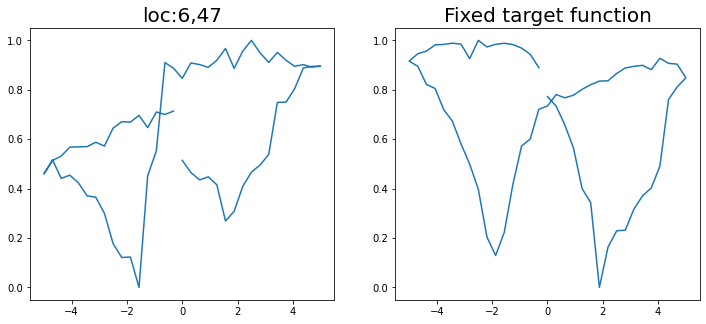

Epoch 1/200 ... Training loss: 2.5379
Epoch 10/200 ... Training loss: 2.3999
Epoch 20/200 ... Training loss: 2.1891
Epoch 30/200 ... Training loss: 2.0942
Epoch 40/200 ... Training loss: 1.9806
Epoch 50/200 ... Training loss: 1.7778
Epoch 60/200 ... Training loss: 1.6784
Epoch 70/200 ... Training loss: 1.5455
Epoch 80/200 ... Training loss: 1.5187
Epoch 90/200 ... Training loss: 1.3876
Epoch 100/200 ... Training loss: 1.3925
Epoch 110/200 ... Training loss: 1.3949
Epoch 120/200 ... Training loss: 1.2739
Epoch 130/200 ... Training loss: 1.3294
Epoch 140/200 ... Training loss: 1.2177
Epoch 150/200 ... Training loss: 1.24
Epoch 160/200 ... Training loss: 1.1881
Epoch 170/200 ... Training loss: 1.1353
Epoch 180/200 ... Training loss: 1.1065
Epoch 190/200 ... Training loss: 1.0155
Epoch 200/200 ... Training loss: 1.1011
step:  72
Sample #82




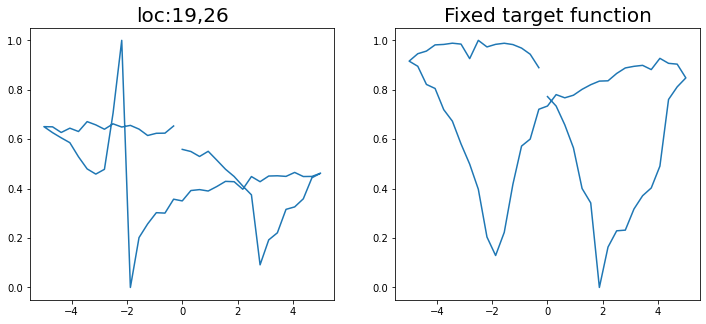

Epoch 1/200 ... Training loss: 2.5181
Epoch 10/200 ... Training loss: 2.4179
Epoch 20/200 ... Training loss: 2.2613
Epoch 30/200 ... Training loss: 2.1201
Epoch 40/200 ... Training loss: 2.0307
Epoch 50/200 ... Training loss: 1.9281
Epoch 60/200 ... Training loss: 1.7503
Epoch 70/200 ... Training loss: 1.6665
Epoch 80/200 ... Training loss: 1.5966
Epoch 90/200 ... Training loss: 1.5057
Epoch 100/200 ... Training loss: 1.4952
Epoch 110/200 ... Training loss: 1.4291
Epoch 120/200 ... Training loss: 1.4449
Epoch 130/200 ... Training loss: 1.3525
Epoch 140/200 ... Training loss: 1.2876
Epoch 150/200 ... Training loss: 1.4392
Epoch 160/200 ... Training loss: 1.2707
Epoch 170/200 ... Training loss: 1.2466
Epoch 180/200 ... Training loss: 1.2676
Epoch 190/200 ... Training loss: 1.2673
Epoch 200/200 ... Training loss: 1.1424
step:  73
Sample #83




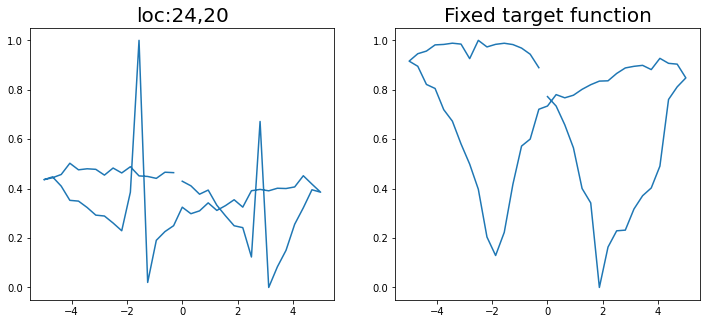

Epoch 1/200 ... Training loss: 2.5064
Epoch 10/200 ... Training loss: 2.3872
Epoch 20/200 ... Training loss: 2.1735
Epoch 30/200 ... Training loss: 2.0664
Epoch 40/200 ... Training loss: 1.9489
Epoch 50/200 ... Training loss: 1.7715
Epoch 60/200 ... Training loss: 1.6642
Epoch 70/200 ... Training loss: 1.5896
Epoch 80/200 ... Training loss: 1.4865
Epoch 90/200 ... Training loss: 1.4964
Epoch 100/200 ... Training loss: 1.5807
Epoch 110/200 ... Training loss: 1.4108
Epoch 120/200 ... Training loss: 1.4499
Epoch 130/200 ... Training loss: 1.2549
Epoch 140/200 ... Training loss: 1.2531
Epoch 150/200 ... Training loss: 1.1836
Epoch 160/200 ... Training loss: 1.2103
Epoch 170/200 ... Training loss: 1.2249
Epoch 180/200 ... Training loss: 1.111
Epoch 190/200 ... Training loss: 1.2168
Epoch 200/200 ... Training loss: 1.1057
step:  74
Sample #84




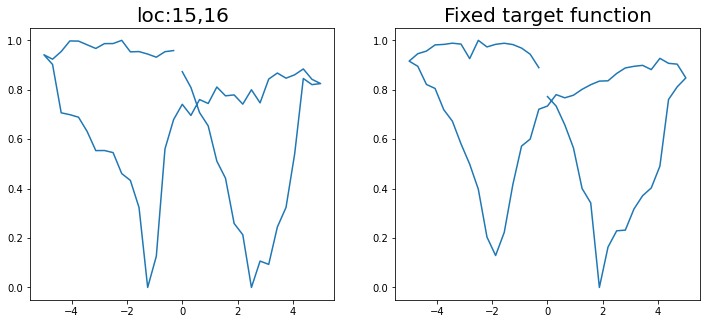

Epoch 1/200 ... Training loss: 2.4942
Epoch 10/200 ... Training loss: 2.4021
Epoch 20/200 ... Training loss: 2.2365
Epoch 30/200 ... Training loss: 2.0944
Epoch 40/200 ... Training loss: 2.0005
Epoch 50/200 ... Training loss: 1.8508
Epoch 60/200 ... Training loss: 1.6816
Epoch 70/200 ... Training loss: 1.5789
Epoch 80/200 ... Training loss: 1.5396
Epoch 90/200 ... Training loss: 1.517
Epoch 100/200 ... Training loss: 1.4609
Epoch 110/200 ... Training loss: 1.3644
Epoch 120/200 ... Training loss: 1.4303
Epoch 130/200 ... Training loss: 1.3127
Epoch 140/200 ... Training loss: 1.2548
Epoch 150/200 ... Training loss: 1.206
Epoch 160/200 ... Training loss: 1.2211
Epoch 170/200 ... Training loss: 1.1511
Epoch 180/200 ... Training loss: 1.127
Epoch 190/200 ... Training loss: 1.1596
Epoch 200/200 ... Training loss: 1.033
step:  75
Sample #85




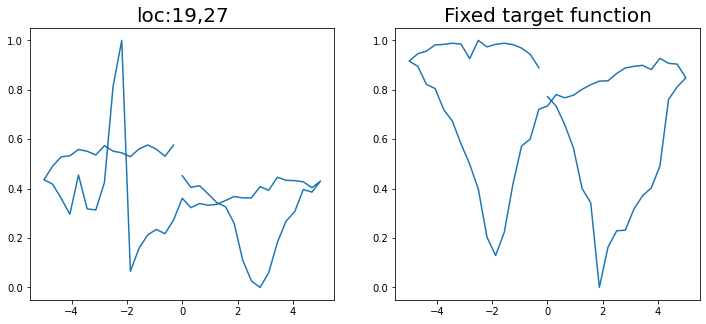

Epoch 1/200 ... Training loss: 2.4905
Epoch 10/200 ... Training loss: 2.384
Epoch 20/200 ... Training loss: 2.2276
Epoch 30/200 ... Training loss: 2.0901
Epoch 40/200 ... Training loss: 2.0049
Epoch 50/200 ... Training loss: 1.8921
Epoch 60/200 ... Training loss: 1.6979
Epoch 70/200 ... Training loss: 1.5882
Epoch 80/200 ... Training loss: 1.6114
Epoch 90/200 ... Training loss: 1.5079
Epoch 100/200 ... Training loss: 1.4584
Epoch 110/200 ... Training loss: 1.4088
Epoch 120/200 ... Training loss: 1.3247
Epoch 130/200 ... Training loss: 1.4111
Epoch 140/200 ... Training loss: 1.3449
Epoch 150/200 ... Training loss: 1.2439
Epoch 160/200 ... Training loss: 1.2406
Epoch 170/200 ... Training loss: 1.203
Epoch 180/200 ... Training loss: 1.2294
Epoch 190/200 ... Training loss: 1.1816
Epoch 200/200 ... Training loss: 1.0982
step:  76
Sample #86




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


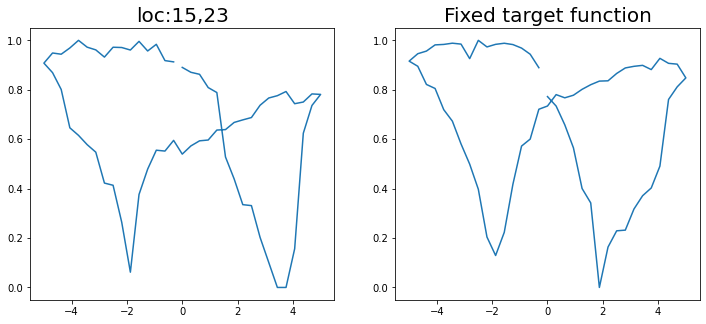

Epoch 1/200 ... Training loss: 2.5132
Epoch 10/200 ... Training loss: 2.4001
Epoch 20/200 ... Training loss: 2.1245
Epoch 30/200 ... Training loss: 2.0182
Epoch 40/200 ... Training loss: 1.8593
Epoch 50/200 ... Training loss: 1.7244
Epoch 60/200 ... Training loss: 1.6363
Epoch 70/200 ... Training loss: 1.6107
Epoch 80/200 ... Training loss: 1.4846
Epoch 90/200 ... Training loss: 1.4285
Epoch 100/200 ... Training loss: 1.3704
Epoch 110/200 ... Training loss: 1.4081
Epoch 120/200 ... Training loss: 1.4299
Epoch 130/200 ... Training loss: 1.2774
Epoch 140/200 ... Training loss: 1.2114
Epoch 150/200 ... Training loss: 1.2532
Epoch 160/200 ... Training loss: 1.1685
Epoch 170/200 ... Training loss: 1.0744
Epoch 180/200 ... Training loss: 1.1319
Epoch 190/200 ... Training loss: 1.0076
Epoch 200/200 ... Training loss: 0.9791
step:  77
Sample #87




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


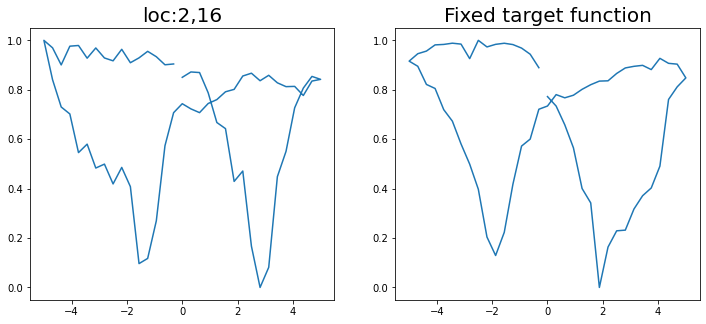

Epoch 1/200 ... Training loss: 2.4951
Epoch 10/200 ... Training loss: 2.2627
Epoch 20/200 ... Training loss: 2.1215
Epoch 30/200 ... Training loss: 1.9809
Epoch 40/200 ... Training loss: 1.8201
Epoch 50/200 ... Training loss: 1.7021
Epoch 60/200 ... Training loss: 1.588
Epoch 70/200 ... Training loss: 1.5703
Epoch 80/200 ... Training loss: 1.3808
Epoch 90/200 ... Training loss: 1.5819
Epoch 100/200 ... Training loss: 1.3837
Epoch 110/200 ... Training loss: 1.3712
Epoch 120/200 ... Training loss: 1.2712
Epoch 130/200 ... Training loss: 1.2069
Epoch 140/200 ... Training loss: 1.1571
Epoch 150/200 ... Training loss: 1.3307
Epoch 160/200 ... Training loss: 1.1743
Epoch 170/200 ... Training loss: 1.0961
Epoch 180/200 ... Training loss: 0.9983
Epoch 190/200 ... Training loss: 0.9117
Epoch 200/200 ... Training loss: 0.9164
step:  78
Sample #88




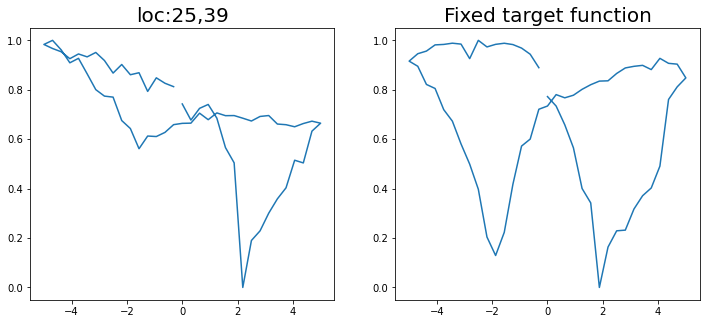

Epoch 1/200 ... Training loss: 2.4775
Epoch 10/200 ... Training loss: 2.3514
Epoch 20/200 ... Training loss: 2.1309
Epoch 30/200 ... Training loss: 2.0492
Epoch 40/200 ... Training loss: 1.9683
Epoch 50/200 ... Training loss: 1.8404
Epoch 60/200 ... Training loss: 1.7231
Epoch 70/200 ... Training loss: 1.6494
Epoch 80/200 ... Training loss: 1.5565
Epoch 90/200 ... Training loss: 1.4865
Epoch 100/200 ... Training loss: 1.4892
Epoch 110/200 ... Training loss: 1.4463
Epoch 120/200 ... Training loss: 1.4478
Epoch 130/200 ... Training loss: 1.3295
Epoch 140/200 ... Training loss: 1.4382
Epoch 150/200 ... Training loss: 1.2577
Epoch 160/200 ... Training loss: 1.2635
Epoch 170/200 ... Training loss: 1.2104
Epoch 180/200 ... Training loss: 1.1097
Epoch 190/200 ... Training loss: 1.1327
Epoch 200/200 ... Training loss: 1.131
step:  79
Sample #89




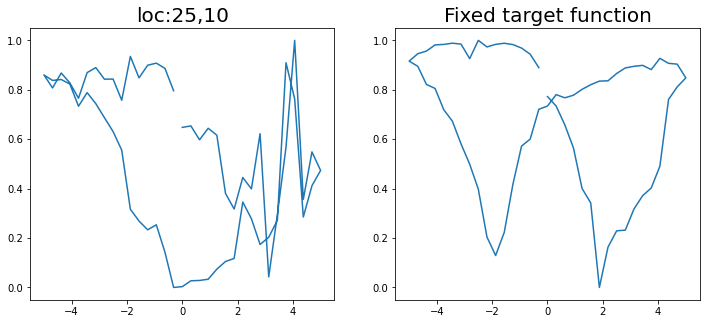

Epoch 1/200 ... Training loss: 2.5501
Epoch 10/200 ... Training loss: 2.3712
Epoch 20/200 ... Training loss: 2.1927
Epoch 30/200 ... Training loss: 2.0939
Epoch 40/200 ... Training loss: 1.9726
Epoch 50/200 ... Training loss: 1.8932
Epoch 60/200 ... Training loss: 1.7622
Epoch 70/200 ... Training loss: 1.7768
Epoch 80/200 ... Training loss: 1.6368
Epoch 90/200 ... Training loss: 1.5457
Epoch 100/200 ... Training loss: 1.4526
Epoch 110/200 ... Training loss: 1.5216
Epoch 120/200 ... Training loss: 1.4341
Epoch 130/200 ... Training loss: 1.3453
Epoch 140/200 ... Training loss: 1.4126
Epoch 150/200 ... Training loss: 1.3519
Epoch 160/200 ... Training loss: 1.2027
Epoch 170/200 ... Training loss: 1.1922
Epoch 180/200 ... Training loss: 1.1575
Epoch 190/200 ... Training loss: 1.0822
Epoch 200/200 ... Training loss: 1.0589
step:  80
Sample #90




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


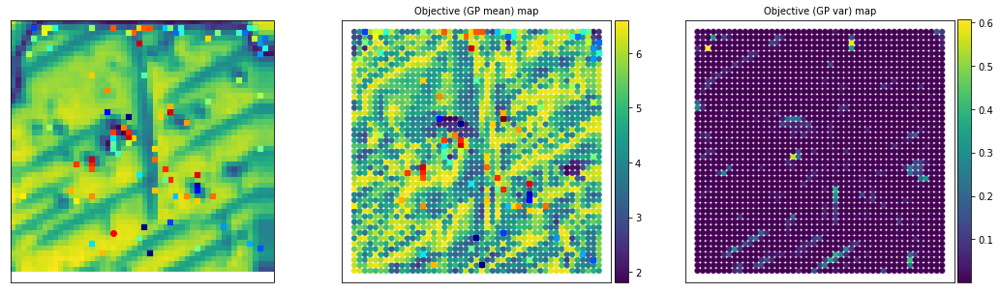

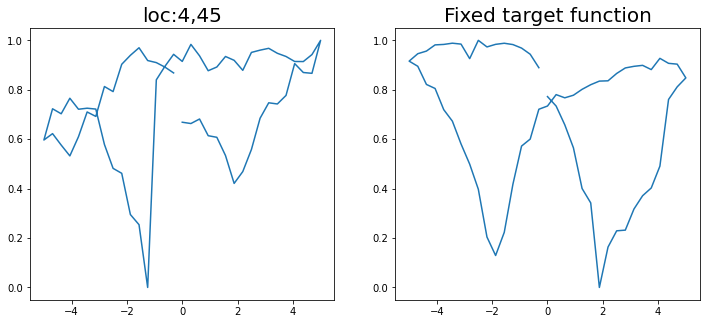

Epoch 1/200 ... Training loss: 2.541
Epoch 10/200 ... Training loss: 2.3945
Epoch 20/200 ... Training loss: 2.2028
Epoch 30/200 ... Training loss: 2.0995
Epoch 40/200 ... Training loss: 1.9968
Epoch 50/200 ... Training loss: 1.8434
Epoch 60/200 ... Training loss: 1.8086
Epoch 70/200 ... Training loss: 1.6611
Epoch 80/200 ... Training loss: 1.7736
Epoch 90/200 ... Training loss: 1.5396
Epoch 100/200 ... Training loss: 1.6227
Epoch 110/200 ... Training loss: 1.4763
Epoch 120/200 ... Training loss: 1.3594
Epoch 130/200 ... Training loss: 1.3395
Epoch 140/200 ... Training loss: 1.4912
Epoch 150/200 ... Training loss: 1.3791
Epoch 160/200 ... Training loss: 1.228
Epoch 170/200 ... Training loss: 1.2067
Epoch 180/200 ... Training loss: 1.2281
Epoch 190/200 ... Training loss: 1.2553
Epoch 200/200 ... Training loss: 1.2397
step:  81
Sample #91




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


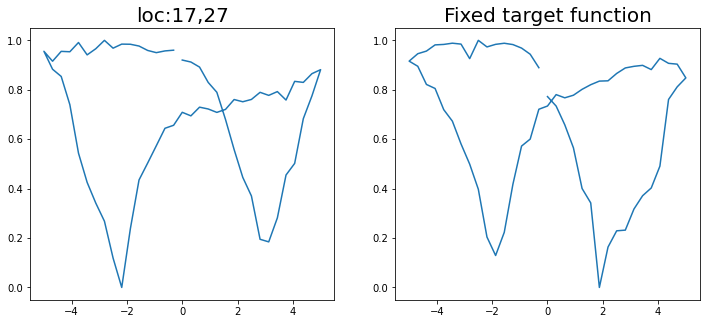

Epoch 1/200 ... Training loss: 2.5475
Epoch 10/200 ... Training loss: 2.3246
Epoch 20/200 ... Training loss: 2.1797
Epoch 30/200 ... Training loss: 2.0896
Epoch 40/200 ... Training loss: 1.9177
Epoch 50/200 ... Training loss: 1.7709
Epoch 60/200 ... Training loss: 1.6544
Epoch 70/200 ... Training loss: 1.6182
Epoch 80/200 ... Training loss: 1.5647
Epoch 90/200 ... Training loss: 1.4125
Epoch 100/200 ... Training loss: 1.3906
Epoch 110/200 ... Training loss: 1.2585
Epoch 120/200 ... Training loss: 1.3167
Epoch 130/200 ... Training loss: 1.2823
Epoch 140/200 ... Training loss: 1.1817
Epoch 150/200 ... Training loss: 1.1461
Epoch 160/200 ... Training loss: 1.1179
Epoch 170/200 ... Training loss: 1.0327
Epoch 180/200 ... Training loss: 1.1675
Epoch 190/200 ... Training loss: 0.9817
Epoch 200/200 ... Training loss: 0.9776
step:  82
Sample #92




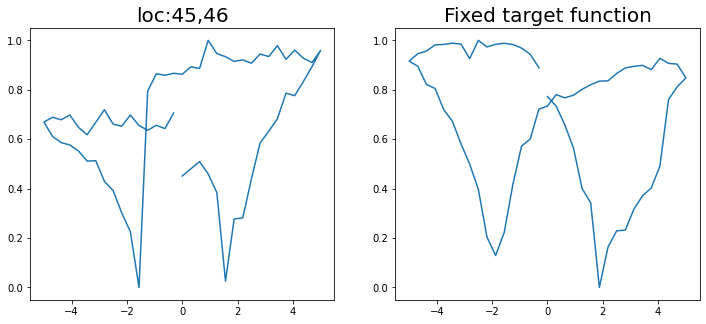

Epoch 1/200 ... Training loss: 2.5291
Epoch 10/200 ... Training loss: 2.3602
Epoch 20/200 ... Training loss: 2.2035
Epoch 30/200 ... Training loss: 2.1105
Epoch 40/200 ... Training loss: 2.0244
Epoch 50/200 ... Training loss: 1.8736
Epoch 60/200 ... Training loss: 1.6577
Epoch 70/200 ... Training loss: 1.6694
Epoch 80/200 ... Training loss: 1.5263
Epoch 90/200 ... Training loss: 1.499
Epoch 100/200 ... Training loss: 1.4237
Epoch 110/200 ... Training loss: 1.3287
Epoch 120/200 ... Training loss: 1.3977
Epoch 130/200 ... Training loss: 1.2411
Epoch 140/200 ... Training loss: 1.2228
Epoch 150/200 ... Training loss: 1.1596
Epoch 160/200 ... Training loss: 1.1731
Epoch 170/200 ... Training loss: 1.125
Epoch 180/200 ... Training loss: 1.0671
Epoch 190/200 ... Training loss: 1.1621
Epoch 200/200 ... Training loss: 1.0327
step:  83
Sample #93




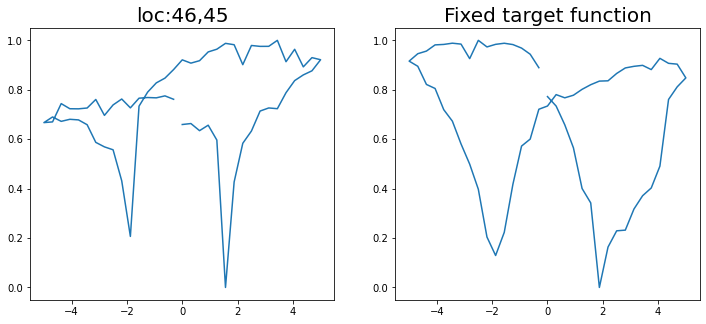

Epoch 1/200 ... Training loss: 2.5181
Epoch 10/200 ... Training loss: 2.4124
Epoch 20/200 ... Training loss: 2.2782
Epoch 30/200 ... Training loss: 2.1423
Epoch 40/200 ... Training loss: 2.0646
Epoch 50/200 ... Training loss: 2.0003
Epoch 60/200 ... Training loss: 1.9066
Epoch 70/200 ... Training loss: 1.7429
Epoch 80/200 ... Training loss: 1.616
Epoch 90/200 ... Training loss: 1.5902
Epoch 100/200 ... Training loss: 1.5919
Epoch 110/200 ... Training loss: 1.4861
Epoch 120/200 ... Training loss: 1.3715
Epoch 130/200 ... Training loss: 1.4084
Epoch 140/200 ... Training loss: 1.4606
Epoch 150/200 ... Training loss: 1.3186
Epoch 160/200 ... Training loss: 1.3
Epoch 170/200 ... Training loss: 1.1997
Epoch 180/200 ... Training loss: 1.2199
Epoch 190/200 ... Training loss: 1.1669
Epoch 200/200 ... Training loss: 1.1147
step:  84
Sample #94




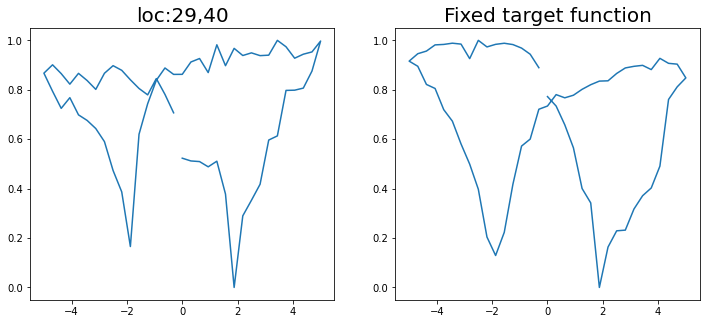

Epoch 1/200 ... Training loss: 2.5052
Epoch 10/200 ... Training loss: 2.35
Epoch 20/200 ... Training loss: 2.1869
Epoch 30/200 ... Training loss: 2.0919
Epoch 40/200 ... Training loss: 2.0284
Epoch 50/200 ... Training loss: 1.9236
Epoch 60/200 ... Training loss: 1.6639
Epoch 70/200 ... Training loss: 1.6705
Epoch 80/200 ... Training loss: 1.5658
Epoch 90/200 ... Training loss: 1.4607
Epoch 100/200 ... Training loss: 1.4359
Epoch 110/200 ... Training loss: 1.3358
Epoch 120/200 ... Training loss: 1.4014
Epoch 130/200 ... Training loss: 1.3703
Epoch 140/200 ... Training loss: 1.2625
Epoch 150/200 ... Training loss: 1.1795
Epoch 160/200 ... Training loss: 1.2201
Epoch 170/200 ... Training loss: 1.184
Epoch 180/200 ... Training loss: 1.1489
Epoch 190/200 ... Training loss: 1.0746
Epoch 200/200 ... Training loss: 1.0635
step:  85
Sample #95




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


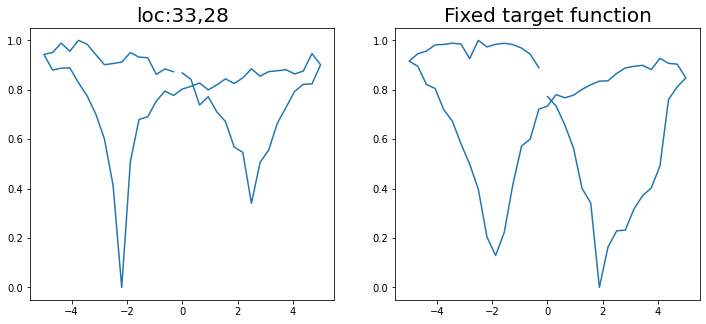

Epoch 1/200 ... Training loss: 2.5027
Epoch 10/200 ... Training loss: 2.391
Epoch 20/200 ... Training loss: 2.25
Epoch 30/200 ... Training loss: 2.1381
Epoch 40/200 ... Training loss: 2.0588
Epoch 50/200 ... Training loss: 1.9902
Epoch 60/200 ... Training loss: 1.878
Epoch 70/200 ... Training loss: 1.8139
Epoch 80/200 ... Training loss: 1.665
Epoch 90/200 ... Training loss: 1.5638
Epoch 100/200 ... Training loss: 1.5967
Epoch 110/200 ... Training loss: 1.4704
Epoch 120/200 ... Training loss: 1.3791
Epoch 130/200 ... Training loss: 1.3522
Epoch 140/200 ... Training loss: 1.4077
Epoch 150/200 ... Training loss: 1.3143
Epoch 160/200 ... Training loss: 1.239
Epoch 170/200 ... Training loss: 1.3581
Epoch 180/200 ... Training loss: 1.2188
Epoch 190/200 ... Training loss: 1.144
Epoch 200/200 ... Training loss: 1.3339
step:  86
Sample #96




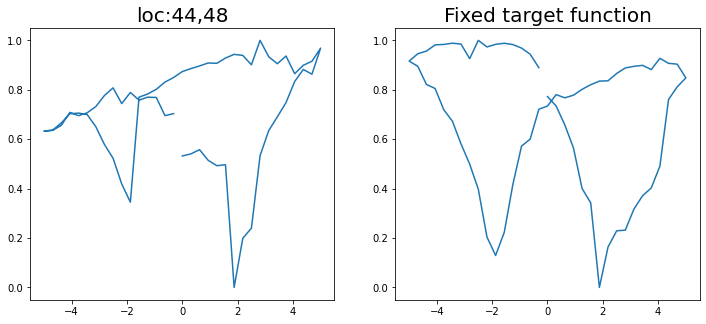

Epoch 1/200 ... Training loss: 2.485
Epoch 10/200 ... Training loss: 2.3722
Epoch 20/200 ... Training loss: 2.2056
Epoch 30/200 ... Training loss: 2.0994
Epoch 40/200 ... Training loss: 2.0174
Epoch 50/200 ... Training loss: 1.8946
Epoch 60/200 ... Training loss: 1.6885
Epoch 70/200 ... Training loss: 1.6256
Epoch 80/200 ... Training loss: 1.6343
Epoch 90/200 ... Training loss: 1.607
Epoch 100/200 ... Training loss: 1.5204
Epoch 110/200 ... Training loss: 1.46
Epoch 120/200 ... Training loss: 1.4198
Epoch 130/200 ... Training loss: 1.3429
Epoch 140/200 ... Training loss: 1.3216
Epoch 150/200 ... Training loss: 1.3456
Epoch 160/200 ... Training loss: 1.2834
Epoch 170/200 ... Training loss: 1.295
Epoch 180/200 ... Training loss: 1.1798
Epoch 190/200 ... Training loss: 1.1938
Epoch 200/200 ... Training loss: 1.3294
step:  87
Sample #97




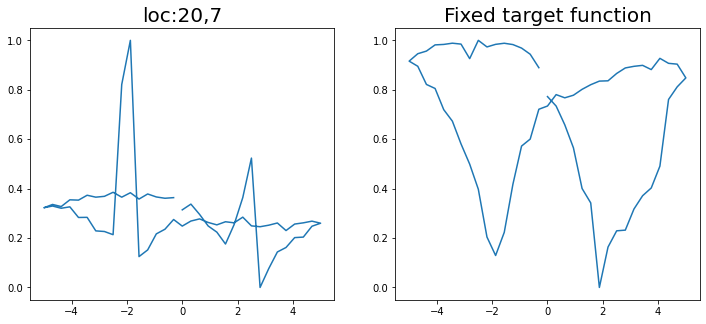

Epoch 1/200 ... Training loss: 2.563
Epoch 10/200 ... Training loss: 2.3989
Epoch 20/200 ... Training loss: 2.2483
Epoch 30/200 ... Training loss: 2.1492
Epoch 40/200 ... Training loss: 2.0598
Epoch 50/200 ... Training loss: 1.9234
Epoch 60/200 ... Training loss: 1.7523
Epoch 70/200 ... Training loss: 1.8741
Epoch 80/200 ... Training loss: 1.6936
Epoch 90/200 ... Training loss: 1.5708
Epoch 100/200 ... Training loss: 1.5827
Epoch 110/200 ... Training loss: 1.4969
Epoch 120/200 ... Training loss: 1.4304
Epoch 130/200 ... Training loss: 1.6691
Epoch 140/200 ... Training loss: 1.4568
Epoch 150/200 ... Training loss: 1.4301
Epoch 160/200 ... Training loss: 1.4308
Epoch 170/200 ... Training loss: 1.2835
Epoch 180/200 ... Training loss: 1.3451
Epoch 190/200 ... Training loss: 1.1867
Epoch 200/200 ... Training loss: 1.1796
step:  88
Sample #98




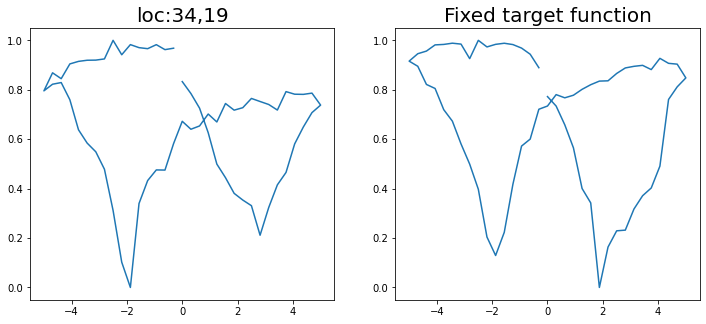

Epoch 1/200 ... Training loss: 2.5997
Epoch 10/200 ... Training loss: 2.4846
Epoch 20/200 ... Training loss: 2.3503
Epoch 30/200 ... Training loss: 2.2292
Epoch 40/200 ... Training loss: 2.1365
Epoch 50/200 ... Training loss: 2.0625
Epoch 60/200 ... Training loss: 1.938
Epoch 70/200 ... Training loss: 1.7786
Epoch 80/200 ... Training loss: 1.6877
Epoch 90/200 ... Training loss: 1.6291
Epoch 100/200 ... Training loss: 1.5316
Epoch 110/200 ... Training loss: 1.4863
Epoch 120/200 ... Training loss: 1.5055
Epoch 130/200 ... Training loss: 1.4454
Epoch 140/200 ... Training loss: 1.4262
Epoch 150/200 ... Training loss: 1.3506
Epoch 160/200 ... Training loss: 1.2507
Epoch 170/200 ... Training loss: 1.3788
Epoch 180/200 ... Training loss: 1.3557
Epoch 190/200 ... Training loss: 1.1862
Epoch 200/200 ... Training loss: 1.4225
step:  89
Sample #99




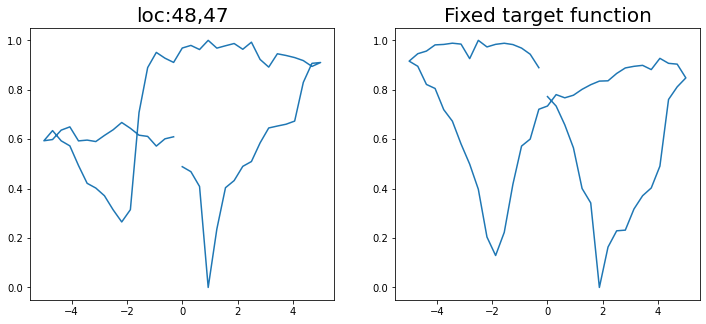

Epoch 1/200 ... Training loss: 2.5832
Epoch 10/200 ... Training loss: 2.456
Epoch 20/200 ... Training loss: 2.2944
Epoch 30/200 ... Training loss: 2.1819
Epoch 40/200 ... Training loss: 2.105
Epoch 50/200 ... Training loss: 2.0014
Epoch 60/200 ... Training loss: 1.7788
Epoch 70/200 ... Training loss: 1.6487
Epoch 80/200 ... Training loss: 1.6224
Epoch 90/200 ... Training loss: 1.5834
Epoch 100/200 ... Training loss: 1.4889
Epoch 110/200 ... Training loss: 1.4616
Epoch 120/200 ... Training loss: 1.5937
Epoch 130/200 ... Training loss: 1.465
Epoch 140/200 ... Training loss: 1.3501
Epoch 150/200 ... Training loss: 1.2985
Epoch 160/200 ... Training loss: 1.6398
Epoch 170/200 ... Training loss: 1.3512
Epoch 180/200 ... Training loss: 1.2633
Epoch 190/200 ... Training loss: 1.4097
Epoch 200/200 ... Training loss: 1.2257
step:  90
Sample #100




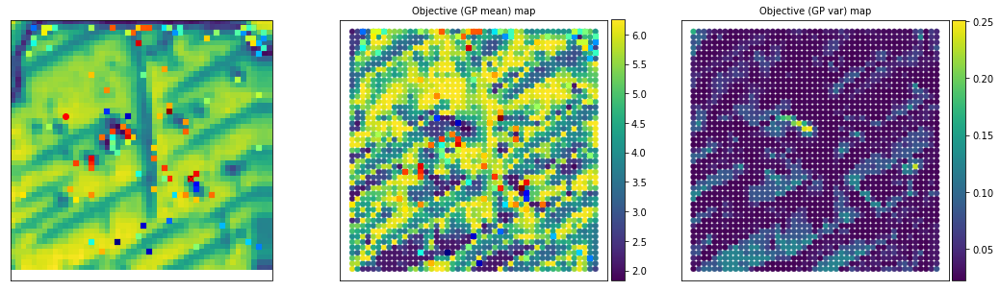

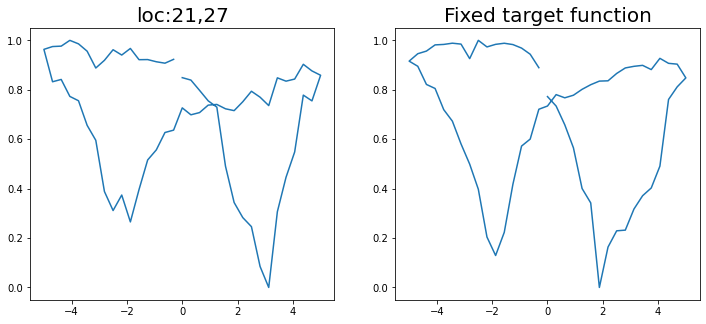

Epoch 1/200 ... Training loss: 2.5989
Epoch 10/200 ... Training loss: 2.4592
Epoch 20/200 ... Training loss: 2.2792
Epoch 30/200 ... Training loss: 2.1764
Epoch 40/200 ... Training loss: 2.0748
Epoch 50/200 ... Training loss: 1.8986
Epoch 60/200 ... Training loss: 1.7634
Epoch 70/200 ... Training loss: 1.6471
Epoch 80/200 ... Training loss: 1.7474
Epoch 90/200 ... Training loss: 1.5454
Epoch 100/200 ... Training loss: 1.5512
Epoch 110/200 ... Training loss: 1.4233
Epoch 120/200 ... Training loss: 1.7359
Epoch 130/200 ... Training loss: 1.4324
Epoch 140/200 ... Training loss: 1.3376
Epoch 150/200 ... Training loss: 1.3094
Epoch 160/200 ... Training loss: 1.3049
Epoch 170/200 ... Training loss: 1.3396
Epoch 180/200 ... Training loss: 1.2029
Epoch 190/200 ... Training loss: 1.1525
Epoch 200/200 ... Training loss: 1.2987
step:  91
Sample #101




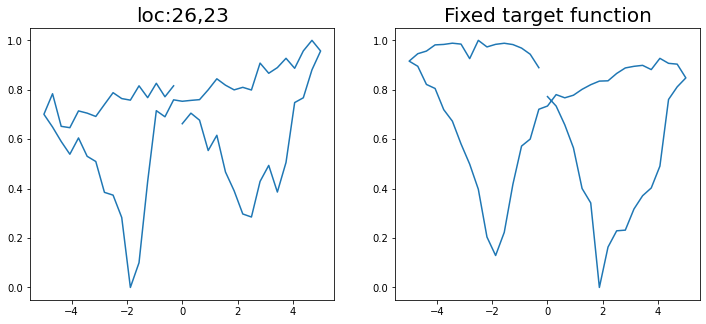

Epoch 1/200 ... Training loss: 2.5951
Epoch 10/200 ... Training loss: 2.4512
Epoch 20/200 ... Training loss: 2.2892
Epoch 30/200 ... Training loss: 2.1816
Epoch 40/200 ... Training loss: 2.0978
Epoch 50/200 ... Training loss: 1.9794
Epoch 60/200 ... Training loss: 1.8006
Epoch 70/200 ... Training loss: 1.6493
Epoch 80/200 ... Training loss: 1.5557
Epoch 90/200 ... Training loss: 1.5422
Epoch 100/200 ... Training loss: 1.4826
Epoch 110/200 ... Training loss: 1.4447
Epoch 120/200 ... Training loss: 1.3542
Epoch 130/200 ... Training loss: 1.4219
Epoch 140/200 ... Training loss: 1.238
Epoch 150/200 ... Training loss: 1.5497
Epoch 160/200 ... Training loss: 1.2474
Epoch 170/200 ... Training loss: 1.2373
Epoch 180/200 ... Training loss: 1.1669
Epoch 190/200 ... Training loss: 1.2773
Epoch 200/200 ... Training loss: 1.1086
step:  92
Sample #102




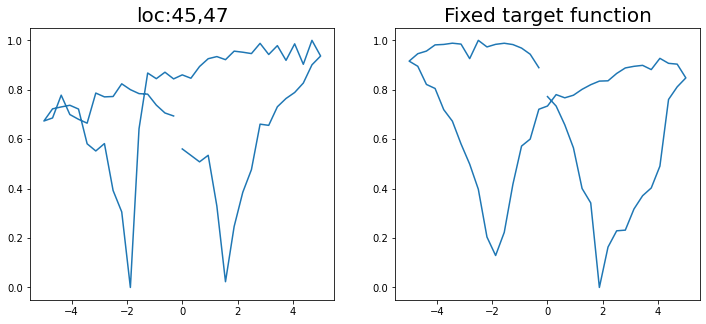

Epoch 1/200 ... Training loss: 2.5775
Epoch 10/200 ... Training loss: 2.3361
Epoch 20/200 ... Training loss: 2.185
Epoch 30/200 ... Training loss: 2.0583
Epoch 40/200 ... Training loss: 1.9171
Epoch 50/200 ... Training loss: 1.7003
Epoch 60/200 ... Training loss: 1.6226
Epoch 70/200 ... Training loss: 1.5588
Epoch 80/200 ... Training loss: 1.4728
Epoch 90/200 ... Training loss: 1.5041
Epoch 100/200 ... Training loss: 1.3777
Epoch 110/200 ... Training loss: 1.274
Epoch 120/200 ... Training loss: 1.5754
Epoch 130/200 ... Training loss: 1.3749
Epoch 140/200 ... Training loss: 1.2551
Epoch 150/200 ... Training loss: 1.4089
Epoch 160/200 ... Training loss: 1.2404
Epoch 170/200 ... Training loss: 1.2489
Epoch 180/200 ... Training loss: 1.1969
Epoch 190/200 ... Training loss: 1.047
Epoch 200/200 ... Training loss: 1.1167
step:  93
Sample #103




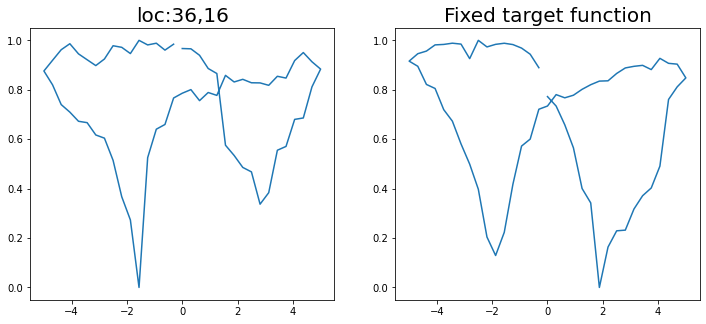

Epoch 1/200 ... Training loss: 2.588
Epoch 10/200 ... Training loss: 2.4565
Epoch 20/200 ... Training loss: 2.3046
Epoch 30/200 ... Training loss: 2.1905
Epoch 40/200 ... Training loss: 2.1021
Epoch 50/200 ... Training loss: 1.9835
Epoch 60/200 ... Training loss: 1.9093
Epoch 70/200 ... Training loss: 1.7451
Epoch 80/200 ... Training loss: 1.6276
Epoch 90/200 ... Training loss: 1.5832
Epoch 100/200 ... Training loss: 1.5022
Epoch 110/200 ... Training loss: 1.4488
Epoch 120/200 ... Training loss: 1.4276
Epoch 130/200 ... Training loss: 1.4818
Epoch 140/200 ... Training loss: 1.4044
Epoch 150/200 ... Training loss: 1.3008
Epoch 160/200 ... Training loss: 1.2822
Epoch 170/200 ... Training loss: 1.4351
Epoch 180/200 ... Training loss: 1.5969
Epoch 190/200 ... Training loss: 1.373
Epoch 200/200 ... Training loss: 1.2423
step:  94
Sample #104




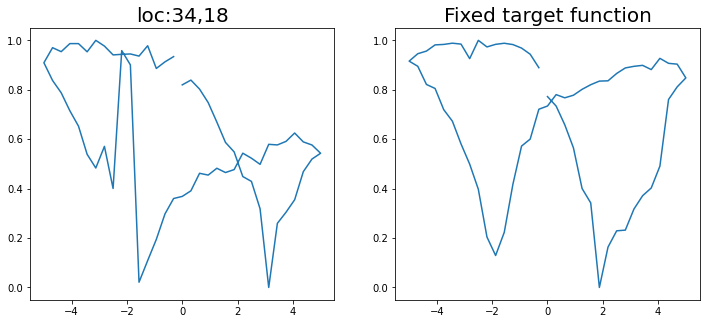

Epoch 1/200 ... Training loss: 2.5711
Epoch 10/200 ... Training loss: 2.444
Epoch 20/200 ... Training loss: 2.2919
Epoch 30/200 ... Training loss: 2.1732
Epoch 40/200 ... Training loss: 2.0891
Epoch 50/200 ... Training loss: 1.9877
Epoch 60/200 ... Training loss: 1.8177
Epoch 70/200 ... Training loss: 1.7193
Epoch 80/200 ... Training loss: 1.6284
Epoch 90/200 ... Training loss: 1.5257
Epoch 100/200 ... Training loss: 1.757
Epoch 110/200 ... Training loss: 1.4939
Epoch 120/200 ... Training loss: 1.5487
Epoch 130/200 ... Training loss: 1.3934
Epoch 140/200 ... Training loss: 1.3659
Epoch 150/200 ... Training loss: 1.3566
Epoch 160/200 ... Training loss: 1.2732
Epoch 170/200 ... Training loss: 1.31
Epoch 180/200 ... Training loss: 1.3028
Epoch 190/200 ... Training loss: 1.1965
Epoch 200/200 ... Training loss: 1.0939
step:  95
Sample #105




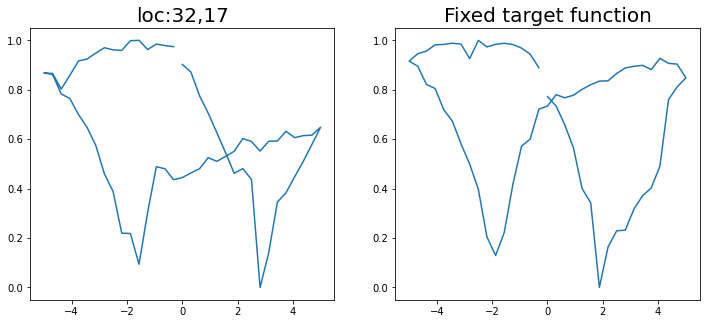

Epoch 1/200 ... Training loss: 2.5586
Epoch 10/200 ... Training loss: 2.4281
Epoch 20/200 ... Training loss: 2.2739
Epoch 30/200 ... Training loss: 2.16
Epoch 40/200 ... Training loss: 2.0631
Epoch 50/200 ... Training loss: 1.9538
Epoch 60/200 ... Training loss: 1.8067
Epoch 70/200 ... Training loss: 1.6968
Epoch 80/200 ... Training loss: 1.6155
Epoch 90/200 ... Training loss: 1.5114
Epoch 100/200 ... Training loss: 1.5223
Epoch 110/200 ... Training loss: 1.5634
Epoch 120/200 ... Training loss: 1.4415
Epoch 130/200 ... Training loss: 1.4525
Epoch 140/200 ... Training loss: 1.4078
Epoch 150/200 ... Training loss: 1.4388
Epoch 160/200 ... Training loss: 1.3563
Epoch 170/200 ... Training loss: 1.2904
Epoch 180/200 ... Training loss: 1.2882
Epoch 190/200 ... Training loss: 1.1932
Epoch 200/200 ... Training loss: 1.242
step:  96
Sample #106




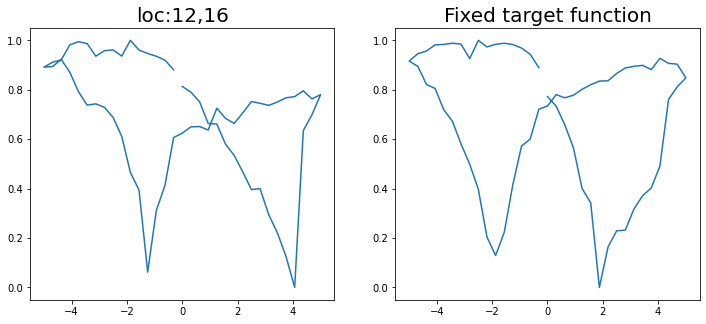

Epoch 1/200 ... Training loss: 2.5438
Epoch 10/200 ... Training loss: 2.4225
Epoch 20/200 ... Training loss: 2.2409
Epoch 30/200 ... Training loss: 2.162
Epoch 40/200 ... Training loss: 2.0798
Epoch 50/200 ... Training loss: 1.9763
Epoch 60/200 ... Training loss: 1.8225
Epoch 70/200 ... Training loss: 1.7025
Epoch 80/200 ... Training loss: 1.6155
Epoch 90/200 ... Training loss: 1.6199
Epoch 100/200 ... Training loss: 1.5352
Epoch 110/200 ... Training loss: 1.4647
Epoch 120/200 ... Training loss: 1.4621
Epoch 130/200 ... Training loss: 1.3752
Epoch 140/200 ... Training loss: 1.3155
Epoch 150/200 ... Training loss: 1.3155
Epoch 160/200 ... Training loss: 1.6618
Epoch 170/200 ... Training loss: 1.3528
Epoch 180/200 ... Training loss: 1.4774
Epoch 190/200 ... Training loss: 1.2731
Epoch 200/200 ... Training loss: 1.2251
step:  97
Sample #107




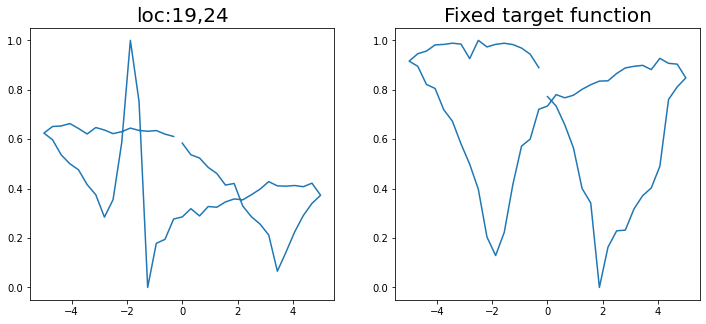

Epoch 1/200 ... Training loss: 2.5351
Epoch 10/200 ... Training loss: 2.4195
Epoch 20/200 ... Training loss: 2.2476
Epoch 30/200 ... Training loss: 2.1623
Epoch 40/200 ... Training loss: 2.0699
Epoch 50/200 ... Training loss: 1.9653
Epoch 60/200 ... Training loss: 1.9047
Epoch 70/200 ... Training loss: 1.7124
Epoch 80/200 ... Training loss: 1.5978
Epoch 90/200 ... Training loss: 1.6017
Epoch 100/200 ... Training loss: 1.4936
Epoch 110/200 ... Training loss: 1.423
Epoch 120/200 ... Training loss: 1.6168
Epoch 130/200 ... Training loss: 1.4327
Epoch 140/200 ... Training loss: 1.3231
Epoch 150/200 ... Training loss: 1.5068
Epoch 160/200 ... Training loss: 1.342
Epoch 170/200 ... Training loss: 1.351
Epoch 180/200 ... Training loss: 1.238
Epoch 190/200 ... Training loss: 1.3946
Epoch 200/200 ... Training loss: 1.2053
step:  98
Sample #108




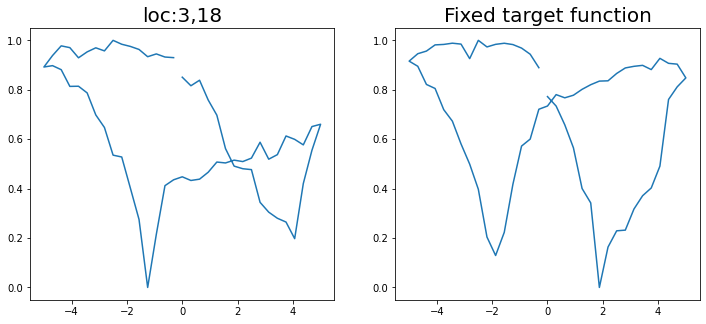

Epoch 1/200 ... Training loss: 2.5194
Epoch 10/200 ... Training loss: 2.3085
Epoch 20/200 ... Training loss: 2.1999
Epoch 30/200 ... Training loss: 2.0639
Epoch 40/200 ... Training loss: 1.9523
Epoch 50/200 ... Training loss: 1.7956
Epoch 60/200 ... Training loss: 1.6856
Epoch 70/200 ... Training loss: 1.5131
Epoch 80/200 ... Training loss: 1.5892
Epoch 90/200 ... Training loss: 1.4505
Epoch 100/200 ... Training loss: 1.412
Epoch 110/200 ... Training loss: 1.3257
Epoch 120/200 ... Training loss: 1.251
Epoch 130/200 ... Training loss: 1.1912
Epoch 140/200 ... Training loss: 1.106
Epoch 150/200 ... Training loss: 1.3471
Epoch 160/200 ... Training loss: 1.0834
Epoch 170/200 ... Training loss: 1.0214
Epoch 180/200 ... Training loss: 1.17
Epoch 190/200 ... Training loss: 0.9827
Epoch 200/200 ... Training loss: 0.8906
step:  99
Sample #109




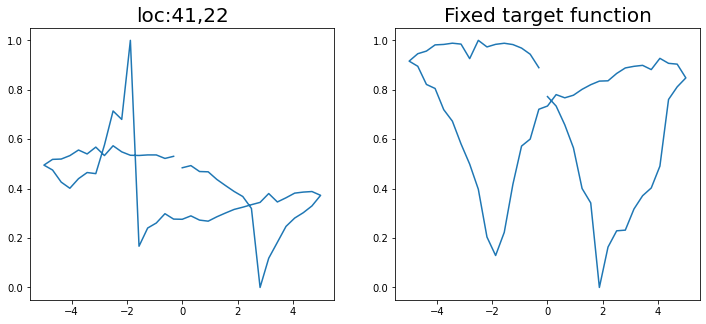

Epoch 1/200 ... Training loss: 2.5227
Epoch 10/200 ... Training loss: 2.2986
Epoch 20/200 ... Training loss: 2.1454
Epoch 30/200 ... Training loss: 2.0377
Epoch 40/200 ... Training loss: 1.9619
Epoch 50/200 ... Training loss: 1.8218
Epoch 60/200 ... Training loss: 1.7089
Epoch 70/200 ... Training loss: 1.6409
Epoch 80/200 ... Training loss: 1.5697
Epoch 90/200 ... Training loss: 1.585
Epoch 100/200 ... Training loss: 1.5006
Epoch 110/200 ... Training loss: 1.4023
Epoch 120/200 ... Training loss: 1.3323
Epoch 130/200 ... Training loss: 1.246
Epoch 140/200 ... Training loss: 1.2986
Epoch 150/200 ... Training loss: 1.2942
Epoch 160/200 ... Training loss: 1.1779
Epoch 170/200 ... Training loss: 1.2177
Epoch 180/200 ... Training loss: 1.1731
Epoch 190/200 ... Training loss: 1.103
Epoch 200/200 ... Training loss: 1.0548
step:  100
Sample #110




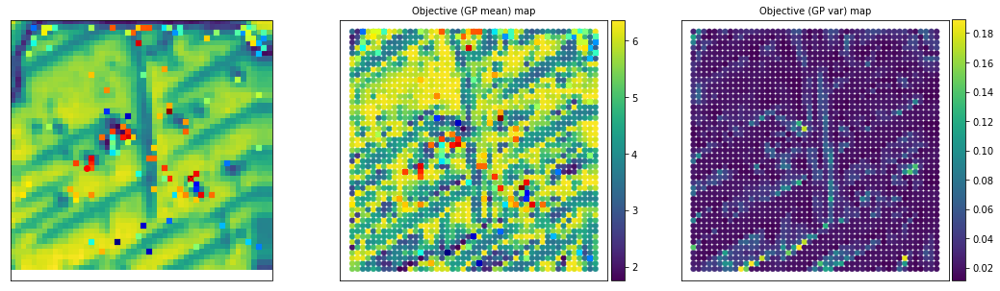

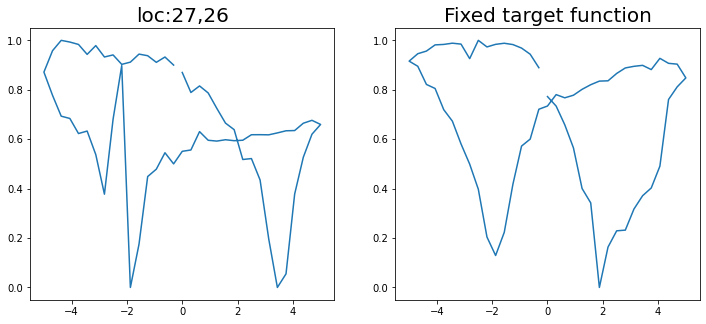

Epoch 1/200 ... Training loss: 2.5075
Epoch 10/200 ... Training loss: 2.3035
Epoch 20/200 ... Training loss: 2.2071
Epoch 30/200 ... Training loss: 2.1337
Epoch 40/200 ... Training loss: 2.0513
Epoch 50/200 ... Training loss: 1.9538
Epoch 60/200 ... Training loss: 1.81
Epoch 70/200 ... Training loss: 1.6969
Epoch 80/200 ... Training loss: 1.5753
Epoch 90/200 ... Training loss: 1.6351
Epoch 100/200 ... Training loss: 1.5599
Epoch 110/200 ... Training loss: 1.4309
Epoch 120/200 ... Training loss: 1.3772
Epoch 130/200 ... Training loss: 1.3668
Epoch 140/200 ... Training loss: 1.3566
Epoch 150/200 ... Training loss: 1.3062
Epoch 160/200 ... Training loss: 1.2373
Epoch 170/200 ... Training loss: 1.336
Epoch 180/200 ... Training loss: 1.1815
Epoch 190/200 ... Training loss: 1.141
Epoch 200/200 ... Training loss: 1.0798


#####----Max. sampling reached, model stopped----#####


/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


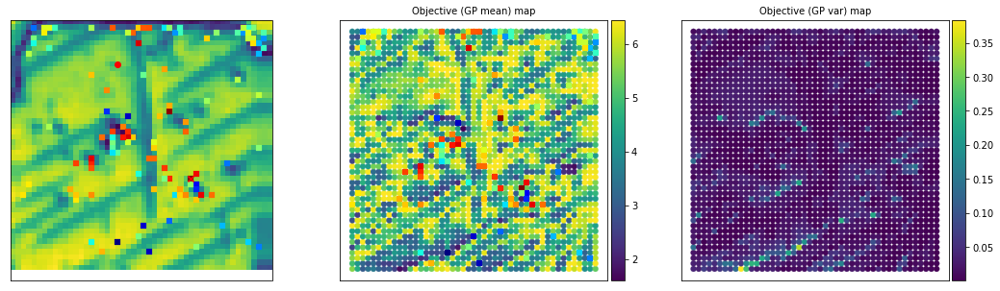

/usr/local/lib/python3.8/dist-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
## Gp model fit
# Calling function to fit and optimizize Hyperparameter of Gaussian Process (using Adam optimizer)
# Input args- Torch arrays of normalized training data, parameter X and objective eval Y
# Output args- Gaussian process model lists
switch_obj_index = 0 # This is the index parameter to switch from 0 to 1 when the user satisfy with updating target
#Set up the surrogat emodel
gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

for i in range(1, N + 1):
    print("step: ", i)
    print("Sample #" + str(m + 1)+ "\n\n")
    # Calculate posterior for analysis for intermidiate iterations
    y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_surro, test_X_norm)
        
    #Plot every tenth iteration after running the evaluation
    if ((i == 1) or ((i % 10) == 0)):
        #This will estimate the surrogate
        X_eval, X_GP, _, _ = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
        #print(X_eval, X_GP)
        fig = plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_eval, X_GP, img, i)
        #put the savefig within the plot function
        #fig.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
    #calculate acquisition function
    acq_cand, acq_val, EI_val = play_varTBO.acqmanEI(y_pred_means, y_pred_vars, train_Y, idx)
    val = acq_val
    ind = np.random.choice(acq_cand) # When multiple points have same acq values
    idx = np.hstack((idx, ind))
    #print(new_points_measured, idx)

    ## Find next point which maximizes the learning through exploration-exploitation
    if (i == 1):
        val_ini = val
      # Check for convergence
    if ((val) < 0):  # Stop for negligible expected improvement
        print("Model converged due to sufficient learning over search space ")
        break
    else:
        nextX = np.zeros((1, test_X.shape[1]))
        nextX_norm = np.zeros((1, test_X_norm.shape[1]))
        next_indices = np.zeros((1,2))
        nextX[0,:] = test_X[ind, :]
        nextX_norm [0, :] = test_X_norm[ind, :]
        next_indices[0, :] = indices[ind, :]
        idx_x = int(next_indices[0, 0])
        idx_y = int(next_indices[0, 1])

        next_loc = np.asarray([idx_x, idx_y])
        new_points_measured = idx
        
        #polarization loop area
        IV, points_measured = return_new_measurement(targets, new_points_measured)

        new_iv = IV[points_measured,:]

        #new_spec_x = torch.from_numpy(vdc_vec)
        #new_spec_y = torch.from_numpy(new_iv)[-1]

        new_spec_x = vdc_vec
        new_spec_y = new_iv[-1]

      
        new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
        
        #clear_output(wait=True) Comment out as I need to check the run in colab
        
        eval_spec_y[idx_x, idx_y, :] = new_spec_y
        # Evaluate true function for new data, augment data
        train_X, train_X_norm, train_indices, train_Y, var_params, switch_obj_index, m =\
        play_varTBO.augment_newdata_KL(nextX, nextX_norm, next_indices, train_X, train_X_norm, train_indices, train_Y,
                                        new_spec_x, new_spec_y, eval_spec_y, img, var_params, switch_obj_index, m)


        #print(next_indices)
        # Gp model fit
        # Updating GP with augmented training data
        gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

    ## Final posterior prediction after all the sampling done

if (i == N):
    print("\n\n#####----Max. sampling reached, model stopped----#####")

#Optimal GP learning
gp_opt = gp_surro
# Posterior calculation with converged GP model
y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_opt, test_X_norm)

# Plotting functions to check final iteration
X_opt, X_opt_GP, ind_opt, ind_opt_GP = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img, i)

explored_data = [train_indices, train_indices, train_Y]
final_GP_estim = [y_pred_means, y_pred_vars]
user_votes = var_params[1]
optim_results = [X_opt, X_opt_GP, ind_opt, ind_opt_GP, user_votes, explored_data]

#Save few data
np.save("optim_results", optim_results)

#Next data

In [ ]:
!gdown https://drive.google.com/uc?id=1pl7tJwDH0xsx21TwrN_i8KM7yEFHT4Xw
pickle_file_loc = r'beps_ground_truth_d2.p'
original_data = pickle.load(open(pickle_file_loc, "rb"))
beps_all = original_data['results_beps']

Downloading...
From: https://drive.google.com/uc?id=1pl7tJwDH0xsx21TwrN_i8KM7yEFHT4Xw
To: /content/beps_ground_truth_d2.p
100% 758M/758M [00:04<00:00, 172MB/s]


In [ ]:
!gdown https://drive.google.com/uc?id=1djbYo-Gjgu6oVGaZlnp3idkUDDOru991
results = np.load("iterative_results_d2.npy", allow_pickle=True)

Downloading...
From: https://drive.google.com/uc?id=1djbYo-Gjgu6oVGaZlnp3idkUDDOru991
To: /content/iterative_results_d2.npy
100% 112M/112M [00:00<00:00, 166MB/s]


In [ ]:
img_big = results[0][-2]

In [ ]:
dim = 50
img = resize(img_big, (50, 50),
                       anti_aliasing=True)

In [ ]:
spec_length = 64  #spectral data length
dim = 50
amp_slices = []
for ind in range(len(beps_all)):
    amp_slices.append(beps_all[ind][1][2])
amp_slices = np.array(amp_slices)
#img = amp_slices[:,10].reshape(50,50)

vdc_full = np.array(beps_all[0][1][0])
vdc_vec = vdc_full[-64:]

amp_mat = amp_slices[:,128:][:,1::2]
amp_masked = np.zeros_like(amp_mat)


spec_length = amp_mat.shape[-1]  #spectral data length
specim = np.reshape(amp_mat, (dim, dim, spec_length))

print(img.shape, vdc_vec.shape, amp_slices.shape, specim.shape)

(50, 50) (64,) (2500, 256) (50, 50, 64)


# Ground truth image

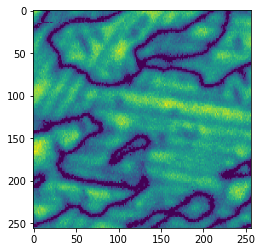

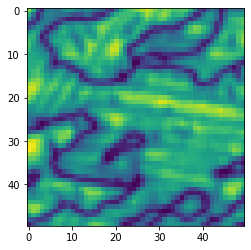

In [ ]:
plt.imshow(img_big)
plt.show()
plt.imshow(img)
plt.show()

In [ ]:
window_size = 4

coordinates = aoi.utils.get_coord_grid(img, step=1, return_dict=False)
features, targets, indices = aoi.utils.extract_patches_and_spectra(
    specim, img, coordinates=coordinates, window_size=window_size, avg_pool=1)

features.shape, targets.shape

/usr/local/lib/python3.8/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((2209, 4, 4), (2209, 64))

In [ ]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features, targets = norm_(features), norm_(targets)

In [ ]:
n, d1, d2 = features.shape
num_start = int(10)
N = int(200)
m = 0
spec_length = 64  #spectral data length



spec_length = amp_mat.shape[-1]  #spectral data length

coordinates = utils.get_coord_grid(img, 1)
X_feas = features.reshape(n, d1*d2)

X_feas_norm = features.reshape(n, d1*d2)

amp_masked = np.zeros_like(targets)
np.random.seed(10)

idx = np.random.randint(0, len(X_feas), num_start)
for ind in range(num_start):
    amp_masked[int(idx[ind]),:] = targets[int(idx[ind]),:]

train_X = X_feas[idx]
train_X_norm = X_feas_norm[idx]
#indices = torch.from_numpy(indices)
train_indices = indices[idx]

print(X_feas.shape, X_feas_norm.shape,train_X.shape, train_X_norm.shape, train_indices.shape, amp_masked.shape)

(2209, 16) (2209, 16) (10, 16) (10, 16) (10, 2) (2209, 64)


# Initial sampling

i is 0, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #1


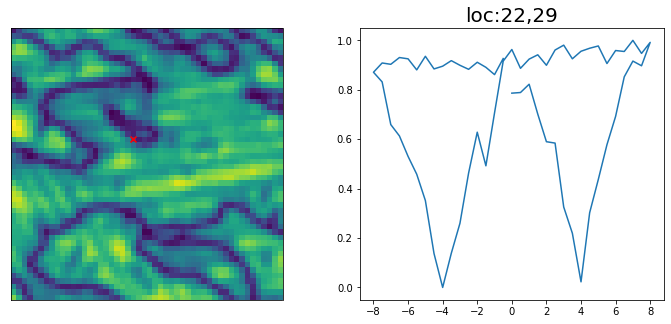

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
i is 1, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #2


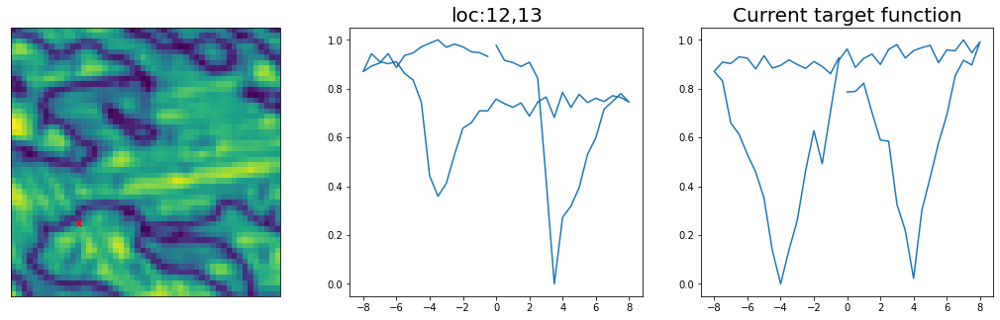

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 2, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #3


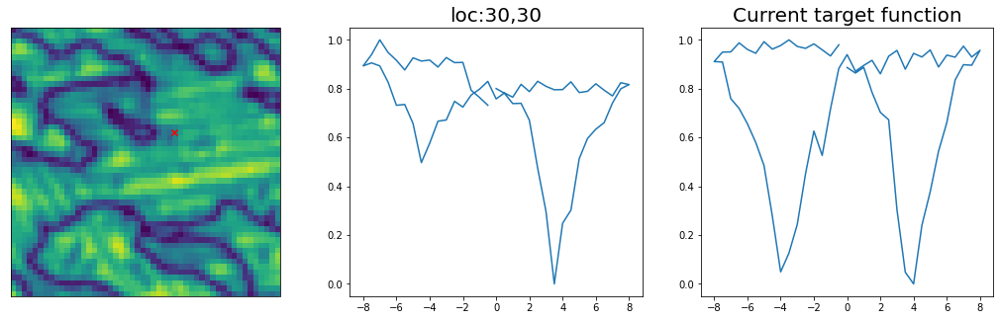

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 3, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #4


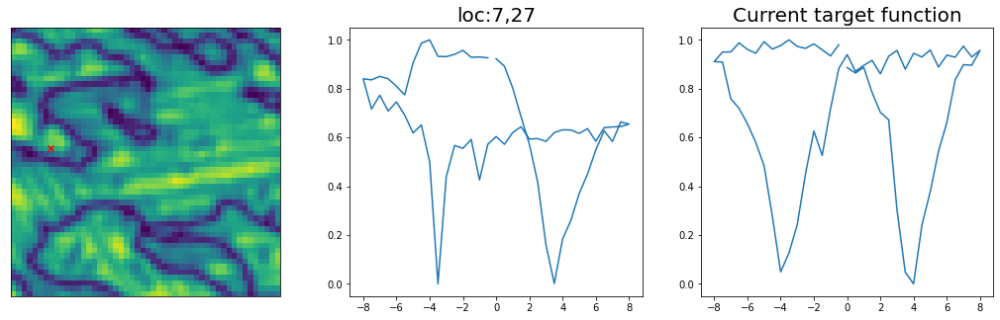

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 4, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #5


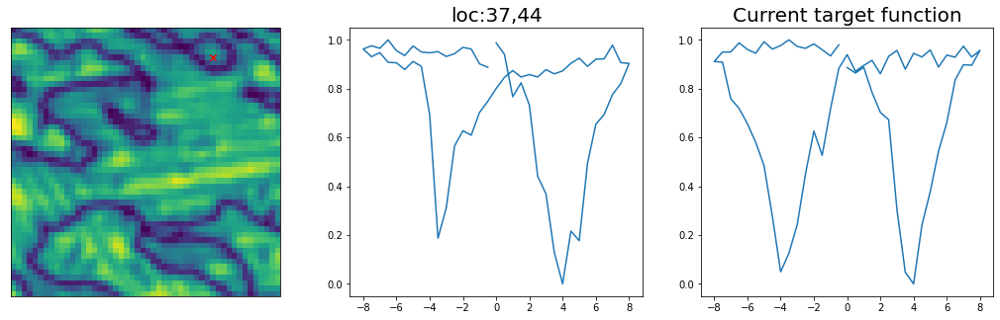

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 5, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #6


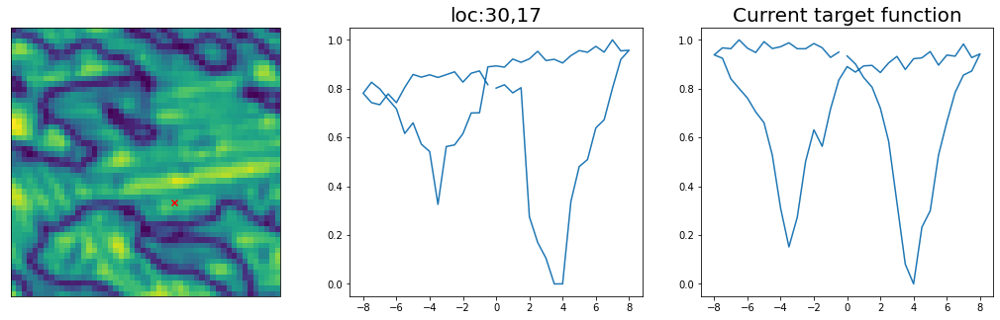

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 6, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #7


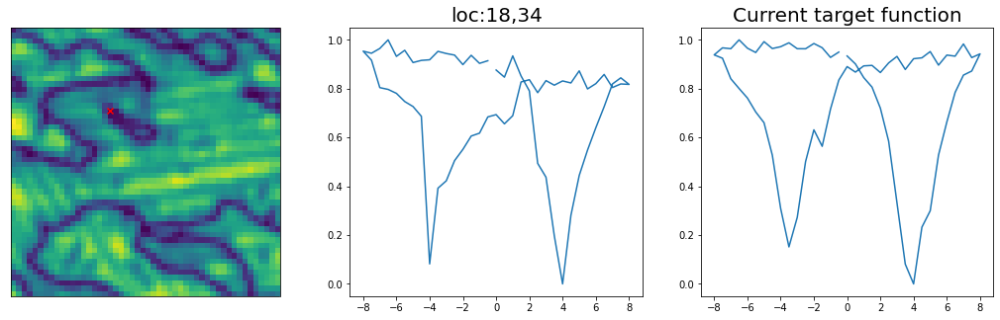

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 7, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #8


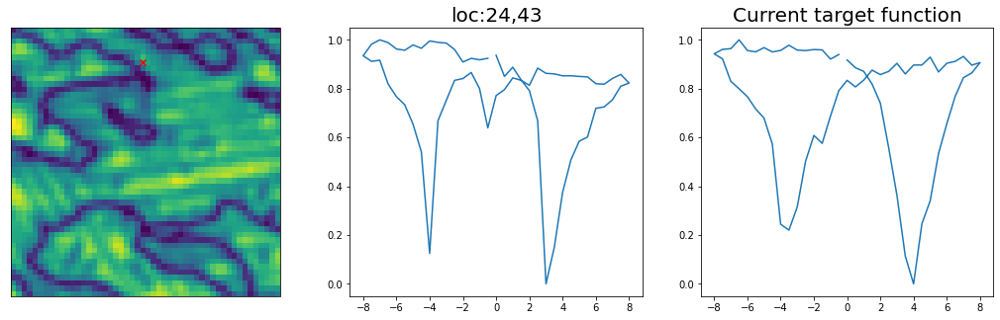

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 8, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #9


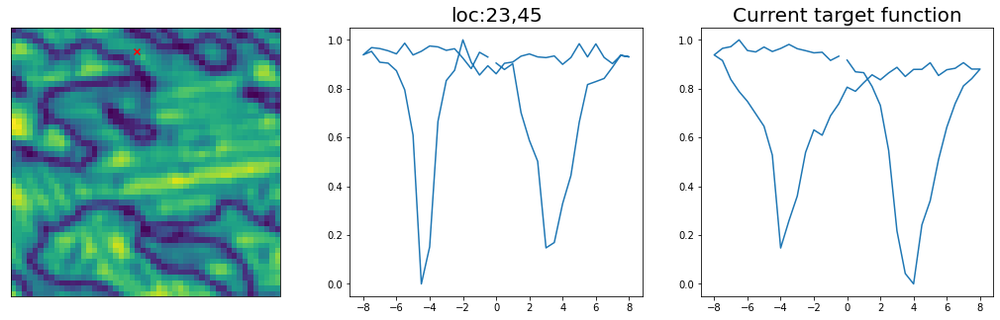

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 9, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #10


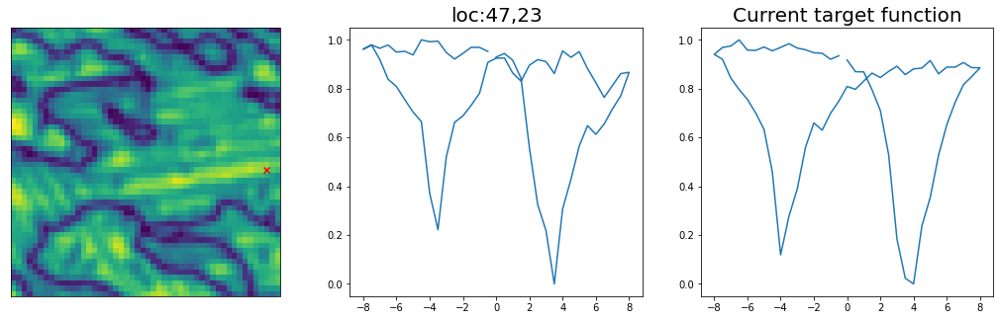

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 


In [ ]:
def return_new_measurement(full_dataset, points_measured):
    ampdat_masked = np.zeros_like(full_dataset)
    ampdat_masked[points_measured,:] = full_dataset[points_measured,:]
    return ampdat_masked, points_measured

# set parameters
IV = np.copy(amp_masked)
points_measured = np.array(idx)
last_points_measured = np.array(points_measured)
vdc = vdc_vec

train_Y = np.zeros((num_start, 1))
pref = np.zeros((num_start, 1))
init_spec = np.zeros((num_start, spec_length))
# Define a sparse grid to store evaluated spectral locations
eval_spec_y = np.zeros((img.shape[0],img.shape[0],spec_length))
#Evaluate initial training data
x = np.zeros((1,2))

# First generate target loop, based on initial training data
wcount_good= 0
target_func = np.zeros(spec_length)

mask = np.isin(points_measured, last_points_measured, invert = True)
new_points_measured = points_measured[mask]
last_points_measured = np.append(last_points_measured, new_points_measured)

for i in range(0, num_start):
    
    ##******************experiment start*******************##
    time.sleep(0.1)

    idx_x = int(train_indices[i, 0])
    idx_y = int(train_indices[i, 1])

    next_loc = np.asarray([idx_x, idx_y])
    
    print("i is {}, measurement done".format(i))
    
    mask = np.isin(points_measured, last_points_measured, invert = True)
    new_points_measured = points_measured[mask]
    last_points_measured = np.append(last_points_measured, new_points_measured)
    print('points measured {}'.format(points_measured))
    print('new_points_measured {}'.format(new_points_measured))

    new_iv = IV[last_points_measured,:]

    #new_spec_x = torch.from_numpy(vdc_vec)
    #new_spec_y = torch.from_numpy(new_iv)[i,:]

    new_spec_x = vdc_vec
    new_spec_y = new_iv[i,:]
    

    new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())

    init_spec[i,] = new_spec_y
    eval_spec_y[idx_x, idx_y, :] = new_spec_y
    print("\n\nSample #" + str(m + 1))
    pref[i, 0], wcount_good, target_func = play_varTBO.generate_targetobj(idx_x, idx_y, new_spec_x,new_spec_y, 
                                                              img, wcount_good, target_func)
    m = m + 1


# Once target loop is defined (unless are loops are selected bad by user), we compute the obj
for i in range(0, num_start):
  idx_x = int(train_indices[i, 0])
  idx_y = int(train_indices[i, 1])
  spec_y = eval_spec_y[idx_x, idx_y, :]
  #print(idx_x, idx_y, spec_y)
  train_Y[i, 0] = play_varTBO.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])

var_params = [wcount_good, pref, target_func]
test_X, test_X_norm, train_X, train_X_norm, train_Y, var_params, idx, m \
= X_feas, X_feas_norm, train_X, train_X_norm, train_Y, var_params, idx, m


# Run dKLBO

Epoch 1/200 ... Training loss: 1.7806
Epoch 10/200 ... Training loss: 1.6345
Epoch 20/200 ... Training loss: 1.5697
Epoch 30/200 ... Training loss: 1.4916
Epoch 40/200 ... Training loss: 1.4739
Epoch 50/200 ... Training loss: 1.4225
Epoch 60/200 ... Training loss: 1.3048
Epoch 70/200 ... Training loss: 1.1002
Epoch 80/200 ... Training loss: 1.0235
Epoch 90/200 ... Training loss: 0.9575
Epoch 100/200 ... Training loss: 0.8978
Epoch 110/200 ... Training loss: 0.8421
Epoch 120/200 ... Training loss: 0.7894
Epoch 130/200 ... Training loss: 0.7374
Epoch 140/200 ... Training loss: 0.687
Epoch 150/200 ... Training loss: 0.6379
Epoch 160/200 ... Training loss: 0.5929
Epoch 170/200 ... Training loss: 0.5477
Epoch 180/200 ... Training loss: 0.5006
Epoch 190/200 ... Training loss: 0.4529
Epoch 200/200 ... Training loss: 0.4071
step:  1
Sample #11




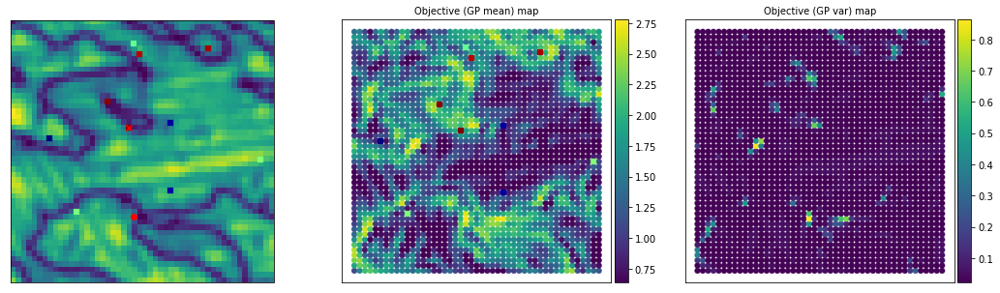

Are you satisfied with current target? (y- yes or press ENTER- No)
Answer: y
Spectral target now fixed. Continue automated BO...


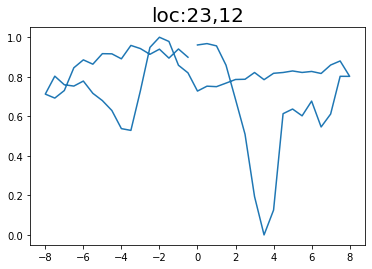

Epoch 1/200 ... Training loss: 6.1031
Epoch 10/200 ... Training loss: 5.3364
Epoch 20/200 ... Training loss: 4.7277
Epoch 30/200 ... Training loss: 4.2711
Epoch 40/200 ... Training loss: 3.8436
Epoch 50/200 ... Training loss: 3.4969
Epoch 60/200 ... Training loss: 3.2502
Epoch 70/200 ... Training loss: 3.0719
Epoch 80/200 ... Training loss: 2.91
Epoch 90/200 ... Training loss: 2.7698
Epoch 100/200 ... Training loss: 2.6537
Epoch 110/200 ... Training loss: 2.5458
Epoch 120/200 ... Training loss: 2.449
Epoch 130/200 ... Training loss: 2.375
Epoch 140/200 ... Training loss: 2.3006
Epoch 150/200 ... Training loss: 2.2229
Epoch 160/200 ... Training loss: 2.1567
Epoch 170/200 ... Training loss: 2.1007
Epoch 180/200 ... Training loss: 2.0289
Epoch 190/200 ... Training loss: 1.9722
Epoch 200/200 ... Training loss: 1.9157
step:  2
Sample #12




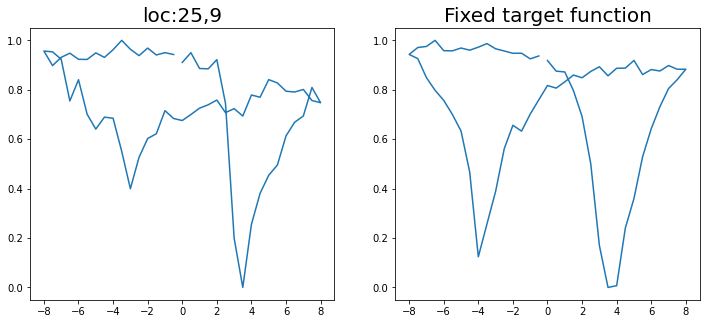

Epoch 1/200 ... Training loss: 5.6689
Epoch 10/200 ... Training loss: 5.125
Epoch 20/200 ... Training loss: 4.5047
Epoch 30/200 ... Training loss: 4.0389
Epoch 40/200 ... Training loss: 3.681
Epoch 50/200 ... Training loss: 3.3593
Epoch 60/200 ... Training loss: 3.1256
Epoch 70/200 ... Training loss: 2.9335
Epoch 80/200 ... Training loss: 2.7882
Epoch 90/200 ... Training loss: 2.6575
Epoch 100/200 ... Training loss: 2.5423
Epoch 110/200 ... Training loss: 2.4413
Epoch 120/200 ... Training loss: 2.354
Epoch 130/200 ... Training loss: 2.269
Epoch 140/200 ... Training loss: 2.2055
Epoch 150/200 ... Training loss: 2.1382
Epoch 160/200 ... Training loss: 2.076
Epoch 170/200 ... Training loss: 2.0261
Epoch 180/200 ... Training loss: 1.9833
Epoch 190/200 ... Training loss: 1.923
Epoch 200/200 ... Training loss: 1.869
step:  3
Sample #13




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


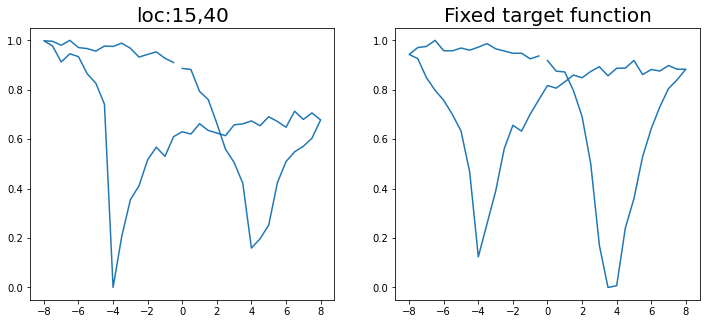

Epoch 1/200 ... Training loss: 5.4127
Epoch 10/200 ... Training loss: 4.7654
Epoch 20/200 ... Training loss: 4.1513
Epoch 30/200 ... Training loss: 3.6805
Epoch 40/200 ... Training loss: 3.3327
Epoch 50/200 ... Training loss: 3.087
Epoch 60/200 ... Training loss: 2.8869
Epoch 70/200 ... Training loss: 2.7294
Epoch 80/200 ... Training loss: 2.589
Epoch 90/200 ... Training loss: 2.4604
Epoch 100/200 ... Training loss: 2.3428
Epoch 110/200 ... Training loss: 2.241
Epoch 120/200 ... Training loss: 2.1476
Epoch 130/200 ... Training loss: 2.0605
Epoch 140/200 ... Training loss: 1.9787
Epoch 150/200 ... Training loss: 1.9011
Epoch 160/200 ... Training loss: 1.8268
Epoch 170/200 ... Training loss: 1.756
Epoch 180/200 ... Training loss: 1.6872
Epoch 190/200 ... Training loss: 1.6166
Epoch 200/200 ... Training loss: 1.5488
step:  4
Sample #14




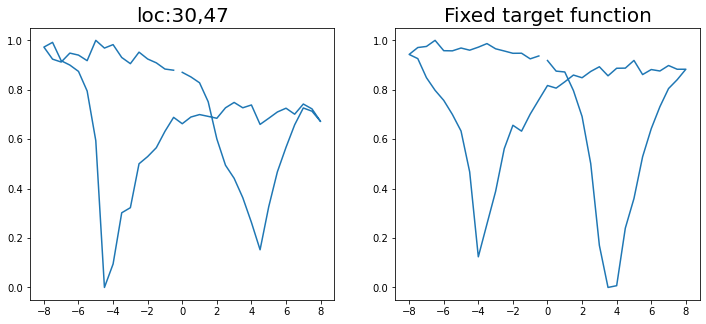

Epoch 1/200 ... Training loss: 5.0852
Epoch 10/200 ... Training loss: 4.6108
Epoch 20/200 ... Training loss: 3.8834
Epoch 30/200 ... Training loss: 3.5212
Epoch 40/200 ... Training loss: 3.2955
Epoch 50/200 ... Training loss: 2.9847
Epoch 60/200 ... Training loss: 2.7759
Epoch 70/200 ... Training loss: 2.631
Epoch 80/200 ... Training loss: 2.4992
Epoch 90/200 ... Training loss: 2.3894
Epoch 100/200 ... Training loss: 2.2856
Epoch 110/200 ... Training loss: 2.1824
Epoch 120/200 ... Training loss: 2.0942
Epoch 130/200 ... Training loss: 2.006
Epoch 140/200 ... Training loss: 2.005
Epoch 150/200 ... Training loss: 2.0225
Epoch 160/200 ... Training loss: 1.9133
Epoch 170/200 ... Training loss: 1.8293
Epoch 180/200 ... Training loss: 1.7452
Epoch 190/200 ... Training loss: 1.66
Epoch 200/200 ... Training loss: 1.5792
step:  5
Sample #15




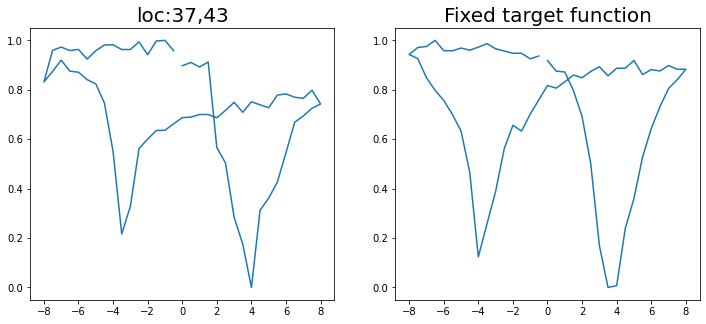

Epoch 1/200 ... Training loss: 4.8326
Epoch 10/200 ... Training loss: 4.4729
Epoch 20/200 ... Training loss: 3.8738
Epoch 30/200 ... Training loss: 3.5235
Epoch 40/200 ... Training loss: 3.1946
Epoch 50/200 ... Training loss: 2.9396
Epoch 60/200 ... Training loss: 2.7449
Epoch 70/200 ... Training loss: 2.5717
Epoch 80/200 ... Training loss: 2.4573
Epoch 90/200 ... Training loss: 2.3644
Epoch 100/200 ... Training loss: 2.2761
Epoch 110/200 ... Training loss: 2.1903
Epoch 120/200 ... Training loss: 2.1166
Epoch 130/200 ... Training loss: 2.0441
Epoch 140/200 ... Training loss: 1.9538
Epoch 150/200 ... Training loss: 1.8866
Epoch 160/200 ... Training loss: 1.8088
Epoch 170/200 ... Training loss: 1.7625
Epoch 180/200 ... Training loss: 1.6861
Epoch 190/200 ... Training loss: 1.607
Epoch 200/200 ... Training loss: 1.5221
step:  6
Sample #16




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


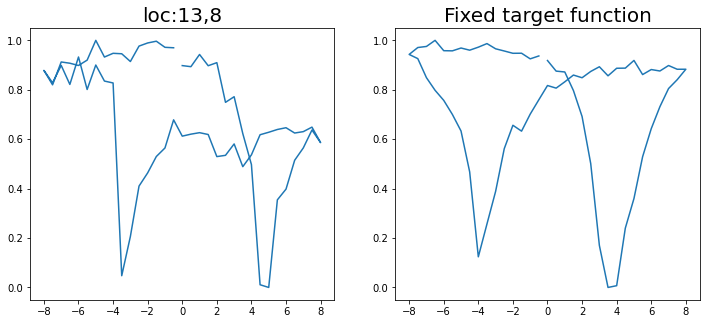

Epoch 1/200 ... Training loss: 4.8135
Epoch 10/200 ... Training loss: 4.2923
Epoch 20/200 ... Training loss: 3.9814
Epoch 30/200 ... Training loss: 3.6317
Epoch 40/200 ... Training loss: 3.0393
Epoch 50/200 ... Training loss: 2.8573
Epoch 60/200 ... Training loss: 2.6651
Epoch 70/200 ... Training loss: 2.5035
Epoch 80/200 ... Training loss: 2.3447
Epoch 90/200 ... Training loss: 2.2158
Epoch 100/200 ... Training loss: 2.1172
Epoch 110/200 ... Training loss: 2.0357
Epoch 120/200 ... Training loss: 1.958
Epoch 130/200 ... Training loss: 1.8816
Epoch 140/200 ... Training loss: 1.8144
Epoch 150/200 ... Training loss: 1.751
Epoch 160/200 ... Training loss: 1.6896
Epoch 170/200 ... Training loss: 1.6303
Epoch 180/200 ... Training loss: 1.5727
Epoch 190/200 ... Training loss: 1.5165
Epoch 200/200 ... Training loss: 1.4596
step:  7
Sample #17




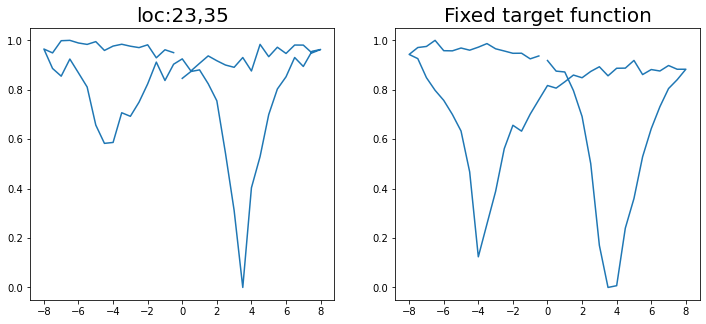

Epoch 1/200 ... Training loss: 4.5756
Epoch 10/200 ... Training loss: 4.0735
Epoch 20/200 ... Training loss: 3.6384
Epoch 30/200 ... Training loss: 3.3188
Epoch 40/200 ... Training loss: 3.0192
Epoch 50/200 ... Training loss: 2.7583
Epoch 60/200 ... Training loss: 2.5791
Epoch 70/200 ... Training loss: 2.4383
Epoch 80/200 ... Training loss: 2.303
Epoch 90/200 ... Training loss: 2.1665
Epoch 100/200 ... Training loss: 2.0705
Epoch 110/200 ... Training loss: 1.9832
Epoch 120/200 ... Training loss: 1.9072
Epoch 130/200 ... Training loss: 1.8364
Epoch 140/200 ... Training loss: 1.766
Epoch 150/200 ... Training loss: 1.6977
Epoch 160/200 ... Training loss: 1.6346
Epoch 170/200 ... Training loss: 1.5732
Epoch 180/200 ... Training loss: 1.5125
Epoch 190/200 ... Training loss: 1.4746
Epoch 200/200 ... Training loss: 1.4053
step:  8
Sample #18




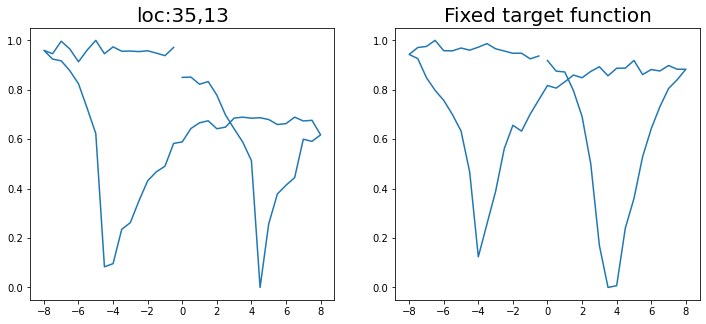

Epoch 1/200 ... Training loss: 4.3778
Epoch 10/200 ... Training loss: 4.1599
Epoch 20/200 ... Training loss: 3.6285
Epoch 30/200 ... Training loss: 3.3603
Epoch 40/200 ... Training loss: 2.9388
Epoch 50/200 ... Training loss: 2.6623
Epoch 60/200 ... Training loss: 2.4688
Epoch 70/200 ... Training loss: 2.3205
Epoch 80/200 ... Training loss: 2.1879
Epoch 90/200 ... Training loss: 2.0764
Epoch 100/200 ... Training loss: 1.9885
Epoch 110/200 ... Training loss: 1.9066
Epoch 120/200 ... Training loss: 1.8371
Epoch 130/200 ... Training loss: 1.7699
Epoch 140/200 ... Training loss: 1.6993
Epoch 150/200 ... Training loss: 1.6302
Epoch 160/200 ... Training loss: 1.5697
Epoch 170/200 ... Training loss: 1.512
Epoch 180/200 ... Training loss: 1.4468
Epoch 190/200 ... Training loss: 1.3877
Epoch 200/200 ... Training loss: 1.328
step:  9
Sample #19




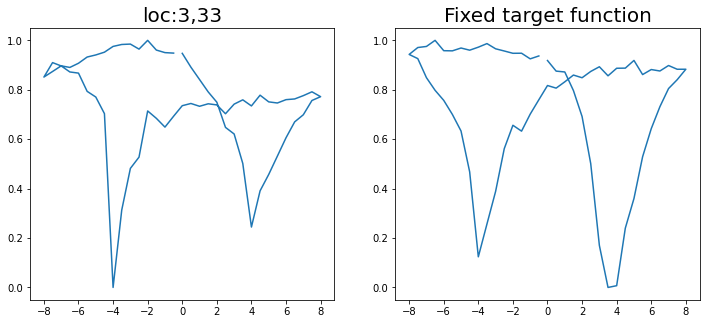

Epoch 1/200 ... Training loss: 4.2114
Epoch 10/200 ... Training loss: 4.0029
Epoch 20/200 ... Training loss: 3.4063
Epoch 30/200 ... Training loss: 2.9232
Epoch 40/200 ... Training loss: 2.6788
Epoch 50/200 ... Training loss: 2.4625
Epoch 60/200 ... Training loss: 2.2774
Epoch 70/200 ... Training loss: 2.143
Epoch 80/200 ... Training loss: 2.0367
Epoch 90/200 ... Training loss: 1.9417
Epoch 100/200 ... Training loss: 1.8512
Epoch 110/200 ... Training loss: 1.7673
Epoch 120/200 ... Training loss: 1.8162
Epoch 130/200 ... Training loss: 1.7135
Epoch 140/200 ... Training loss: 1.6307
Epoch 150/200 ... Training loss: 1.5563
Epoch 160/200 ... Training loss: 1.4796
Epoch 170/200 ... Training loss: 1.4045
Epoch 180/200 ... Training loss: 1.3295
Epoch 190/200 ... Training loss: 1.2569
Epoch 200/200 ... Training loss: 1.2332
step:  10
Sample #20




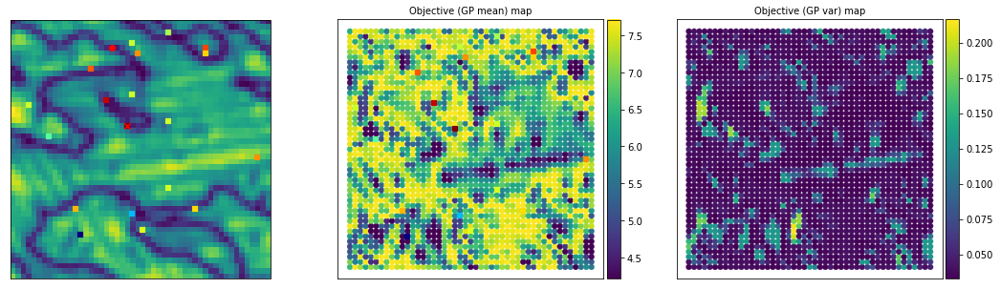

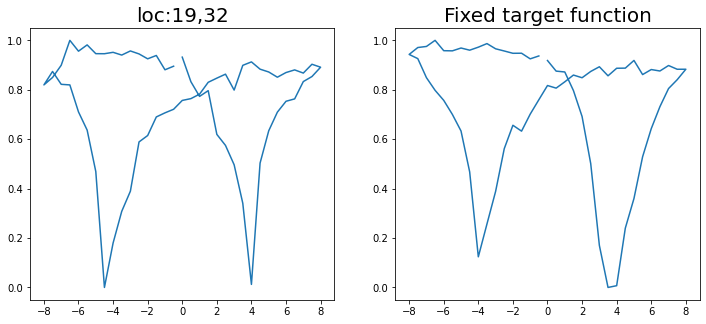

Epoch 1/200 ... Training loss: 4.0657
Epoch 10/200 ... Training loss: 3.6635
Epoch 20/200 ... Training loss: 3.2206
Epoch 30/200 ... Training loss: 2.7993
Epoch 40/200 ... Training loss: 2.5821
Epoch 50/200 ... Training loss: 2.3903
Epoch 60/200 ... Training loss: 2.2315
Epoch 70/200 ... Training loss: 2.0998
Epoch 80/200 ... Training loss: 1.9808
Epoch 90/200 ... Training loss: 1.8811
Epoch 100/200 ... Training loss: 1.7912
Epoch 110/200 ... Training loss: 1.704
Epoch 120/200 ... Training loss: 1.6208
Epoch 130/200 ... Training loss: 1.5525
Epoch 140/200 ... Training loss: 1.4722
Epoch 150/200 ... Training loss: 1.3932
Epoch 160/200 ... Training loss: 1.3258
Epoch 170/200 ... Training loss: 1.2493
Epoch 180/200 ... Training loss: 1.1891
Epoch 190/200 ... Training loss: 1.1096
Epoch 200/200 ... Training loss: 1.2497
step:  11
Sample #21




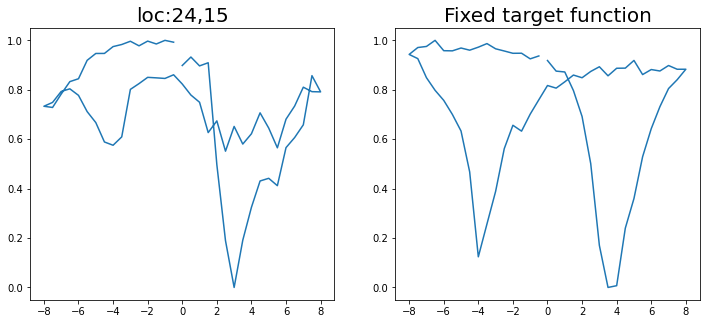

Epoch 1/200 ... Training loss: 4.1613
Epoch 10/200 ... Training loss: 3.9563
Epoch 20/200 ... Training loss: 3.4736
Epoch 30/200 ... Training loss: 3.147
Epoch 40/200 ... Training loss: 2.8531
Epoch 50/200 ... Training loss: 2.638
Epoch 60/200 ... Training loss: 2.4909
Epoch 70/200 ... Training loss: 2.3299
Epoch 80/200 ... Training loss: 2.1431
Epoch 90/200 ... Training loss: 1.9744
Epoch 100/200 ... Training loss: 1.8867
Epoch 110/200 ... Training loss: 1.8056
Epoch 120/200 ... Training loss: 1.7377
Epoch 130/200 ... Training loss: 1.6788
Epoch 140/200 ... Training loss: 1.6228
Epoch 150/200 ... Training loss: 1.5692
Epoch 160/200 ... Training loss: 1.5153
Epoch 170/200 ... Training loss: 1.4661
Epoch 180/200 ... Training loss: 1.4148
Epoch 190/200 ... Training loss: 1.3649
Epoch 200/200 ... Training loss: 1.315
step:  12
Sample #22




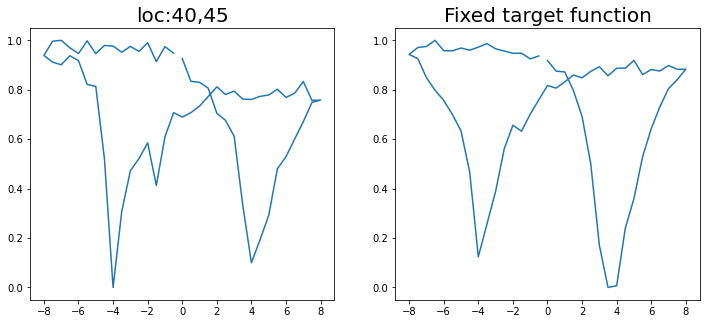

Epoch 1/200 ... Training loss: 4.0236
Epoch 10/200 ... Training loss: 3.6911
Epoch 20/200 ... Training loss: 3.3271
Epoch 30/200 ... Training loss: 2.9722
Epoch 40/200 ... Training loss: 2.7492
Epoch 50/200 ... Training loss: 2.5528
Epoch 60/200 ... Training loss: 2.3551
Epoch 70/200 ... Training loss: 2.1266
Epoch 80/200 ... Training loss: 1.9495
Epoch 90/200 ... Training loss: 1.8528
Epoch 100/200 ... Training loss: 1.7758
Epoch 110/200 ... Training loss: 1.707
Epoch 120/200 ... Training loss: 1.6433
Epoch 130/200 ... Training loss: 1.585
Epoch 140/200 ... Training loss: 1.5282
Epoch 150/200 ... Training loss: 1.4723
Epoch 160/200 ... Training loss: 1.4188
Epoch 170/200 ... Training loss: 1.379
Epoch 180/200 ... Training loss: 1.3168
Epoch 190/200 ... Training loss: 1.2617
Epoch 200/200 ... Training loss: 1.2311
step:  13
Sample #23




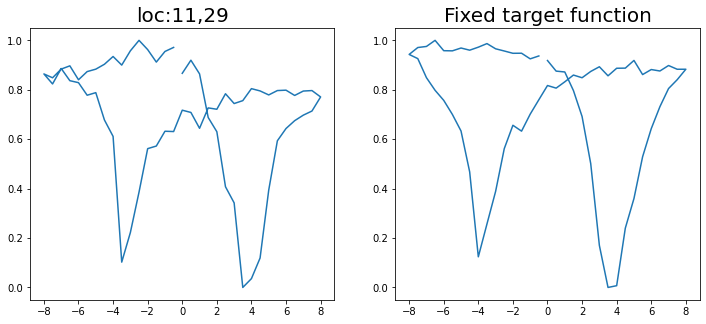

Epoch 1/200 ... Training loss: 3.8821
Epoch 10/200 ... Training loss: 3.5215
Epoch 20/200 ... Training loss: 3.1867
Epoch 30/200 ... Training loss: 2.785
Epoch 40/200 ... Training loss: 2.5905
Epoch 50/200 ... Training loss: 2.3159
Epoch 60/200 ... Training loss: 2.0745
Epoch 70/200 ... Training loss: 1.9361
Epoch 80/200 ... Training loss: 1.8421
Epoch 90/200 ... Training loss: 1.76
Epoch 100/200 ... Training loss: 1.684
Epoch 110/200 ... Training loss: 1.6123
Epoch 120/200 ... Training loss: 1.563
Epoch 130/200 ... Training loss: 1.4832
Epoch 140/200 ... Training loss: 1.4217
Epoch 150/200 ... Training loss: 1.3627
Epoch 160/200 ... Training loss: 1.3038
Epoch 170/200 ... Training loss: 1.2823
Epoch 180/200 ... Training loss: 1.2056
Epoch 190/200 ... Training loss: 1.1507
Epoch 200/200 ... Training loss: 1.1398
step:  14
Sample #24




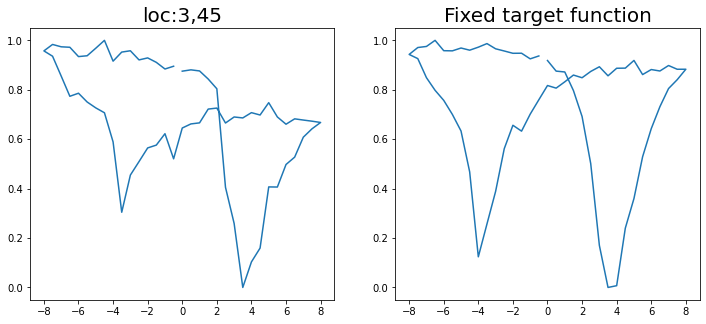

Epoch 1/200 ... Training loss: 3.7813
Epoch 10/200 ... Training loss: 3.1617
Epoch 20/200 ... Training loss: 2.8508
Epoch 30/200 ... Training loss: 2.5827
Epoch 40/200 ... Training loss: 2.2576
Epoch 50/200 ... Training loss: 2.0688
Epoch 60/200 ... Training loss: 1.9394
Epoch 70/200 ... Training loss: 1.8297
Epoch 80/200 ... Training loss: 1.7309
Epoch 90/200 ... Training loss: 1.6393
Epoch 100/200 ... Training loss: 1.562
Epoch 110/200 ... Training loss: 1.4836
Epoch 120/200 ... Training loss: 1.4087
Epoch 130/200 ... Training loss: 1.3352
Epoch 140/200 ... Training loss: 1.2635
Epoch 150/200 ... Training loss: 1.2183
Epoch 160/200 ... Training loss: 1.1458
Epoch 170/200 ... Training loss: 1.0725
Epoch 180/200 ... Training loss: 1.0118
Epoch 190/200 ... Training loss: 0.9546
Epoch 200/200 ... Training loss: 0.9179
step:  15
Sample #25




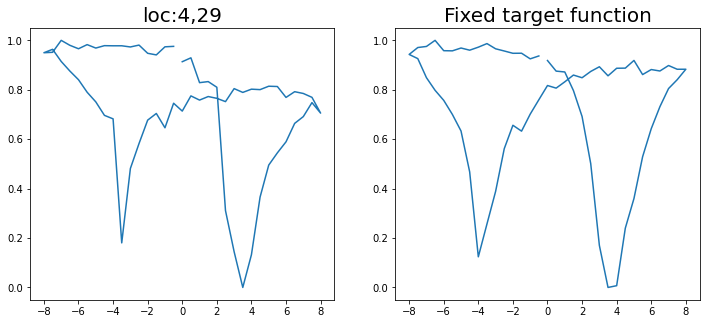

Epoch 1/200 ... Training loss: 3.7013
Epoch 10/200 ... Training loss: 3.2052
Epoch 20/200 ... Training loss: 2.7989
Epoch 30/200 ... Training loss: 2.562
Epoch 40/200 ... Training loss: 2.2549
Epoch 50/200 ... Training loss: 2.0434
Epoch 60/200 ... Training loss: 1.8987
Epoch 70/200 ... Training loss: 1.7858
Epoch 80/200 ... Training loss: 1.6843
Epoch 90/200 ... Training loss: 1.59
Epoch 100/200 ... Training loss: 1.5035
Epoch 110/200 ... Training loss: 1.4226
Epoch 120/200 ... Training loss: 1.3478
Epoch 130/200 ... Training loss: 1.2718
Epoch 140/200 ... Training loss: 1.2521
Epoch 150/200 ... Training loss: 1.179
Epoch 160/200 ... Training loss: 1.0838
Epoch 170/200 ... Training loss: 1.0137
Epoch 180/200 ... Training loss: 0.9526
Epoch 190/200 ... Training loss: 0.9402
Epoch 200/200 ... Training loss: 0.8627
step:  16
Sample #26




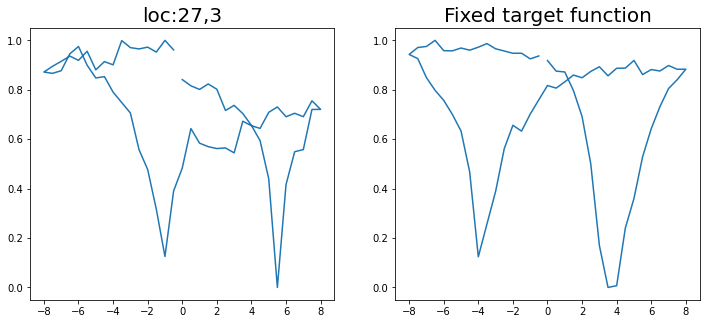

Epoch 1/200 ... Training loss: 3.9613
Epoch 10/200 ... Training loss: 3.5712
Epoch 20/200 ... Training loss: 3.063
Epoch 30/200 ... Training loss: 2.6521
Epoch 40/200 ... Training loss: 2.2501
Epoch 50/200 ... Training loss: 2.0478
Epoch 60/200 ... Training loss: 1.9109
Epoch 70/200 ... Training loss: 1.797
Epoch 80/200 ... Training loss: 1.7091
Epoch 90/200 ... Training loss: 1.6323
Epoch 100/200 ... Training loss: 1.564
Epoch 110/200 ... Training loss: 1.5011
Epoch 120/200 ... Training loss: 1.5421
Epoch 130/200 ... Training loss: 1.4662
Epoch 140/200 ... Training loss: 1.3642
Epoch 150/200 ... Training loss: 1.2958
Epoch 160/200 ... Training loss: 1.242
Epoch 170/200 ... Training loss: 1.1928
Epoch 180/200 ... Training loss: 1.1436
Epoch 190/200 ... Training loss: 1.1002
Epoch 200/200 ... Training loss: 1.0446
step:  17
Sample #27




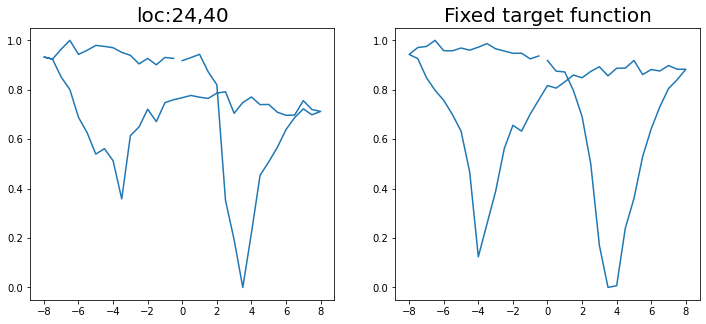

Epoch 1/200 ... Training loss: 3.8532
Epoch 10/200 ... Training loss: 3.4885
Epoch 20/200 ... Training loss: 3.0321
Epoch 30/200 ... Training loss: 2.6974
Epoch 40/200 ... Training loss: 2.2731
Epoch 50/200 ... Training loss: 2.0261
Epoch 60/200 ... Training loss: 1.8883
Epoch 70/200 ... Training loss: 1.7905
Epoch 80/200 ... Training loss: 1.6967
Epoch 90/200 ... Training loss: 1.6193
Epoch 100/200 ... Training loss: 1.5555
Epoch 110/200 ... Training loss: 1.4921
Epoch 120/200 ... Training loss: 1.4217
Epoch 130/200 ... Training loss: 1.364
Epoch 140/200 ... Training loss: 1.3075
Epoch 150/200 ... Training loss: 1.2547
Epoch 160/200 ... Training loss: 1.2034
Epoch 170/200 ... Training loss: 1.1711
Epoch 180/200 ... Training loss: 1.5498
Epoch 190/200 ... Training loss: 1.2398
Epoch 200/200 ... Training loss: 1.0922
step:  18
Sample #28




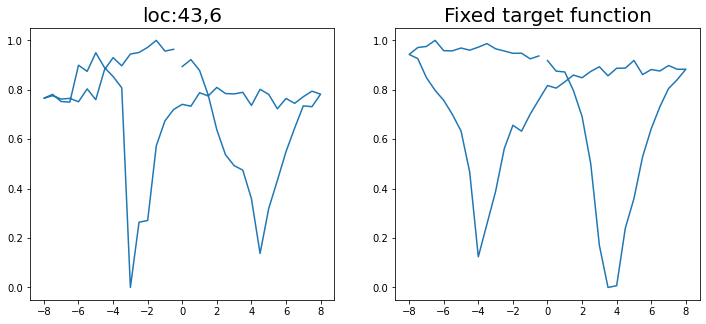

Epoch 1/200 ... Training loss: 3.9046
Epoch 10/200 ... Training loss: 3.5244
Epoch 20/200 ... Training loss: 3.094
Epoch 30/200 ... Training loss: 2.7299
Epoch 40/200 ... Training loss: 2.2696
Epoch 50/200 ... Training loss: 1.9742
Epoch 60/200 ... Training loss: 1.8558
Epoch 70/200 ... Training loss: 1.7574
Epoch 80/200 ... Training loss: 1.6727
Epoch 90/200 ... Training loss: 1.6045
Epoch 100/200 ... Training loss: 1.5405
Epoch 110/200 ... Training loss: 1.4772
Epoch 120/200 ... Training loss: 1.4181
Epoch 130/200 ... Training loss: 1.3858
Epoch 140/200 ... Training loss: 1.3127
Epoch 150/200 ... Training loss: 1.2637
Epoch 160/200 ... Training loss: 1.2105
Epoch 170/200 ... Training loss: 1.1647
Epoch 180/200 ... Training loss: 1.1167
Epoch 190/200 ... Training loss: 1.0778
Epoch 200/200 ... Training loss: 1.0245
step:  19
Sample #29




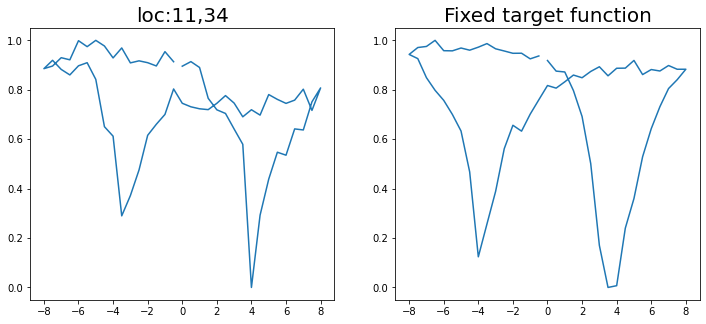

Epoch 1/200 ... Training loss: 3.8152
Epoch 10/200 ... Training loss: 3.4521
Epoch 20/200 ... Training loss: 2.9825
Epoch 30/200 ... Training loss: 2.5784
Epoch 40/200 ... Training loss: 2.2503
Epoch 50/200 ... Training loss: 1.9933
Epoch 60/200 ... Training loss: 1.8638
Epoch 70/200 ... Training loss: 1.762
Epoch 80/200 ... Training loss: 1.6744
Epoch 90/200 ... Training loss: 1.5875
Epoch 100/200 ... Training loss: 1.5147
Epoch 110/200 ... Training loss: 1.4504
Epoch 120/200 ... Training loss: 1.44
Epoch 130/200 ... Training loss: 1.3573
Epoch 140/200 ... Training loss: 1.289
Epoch 150/200 ... Training loss: 1.2368
Epoch 160/200 ... Training loss: 1.1844
Epoch 170/200 ... Training loss: 1.1338
Epoch 180/200 ... Training loss: 1.2781
Epoch 190/200 ... Training loss: 1.1095
Epoch 200/200 ... Training loss: 1.0224
step:  20
Sample #30




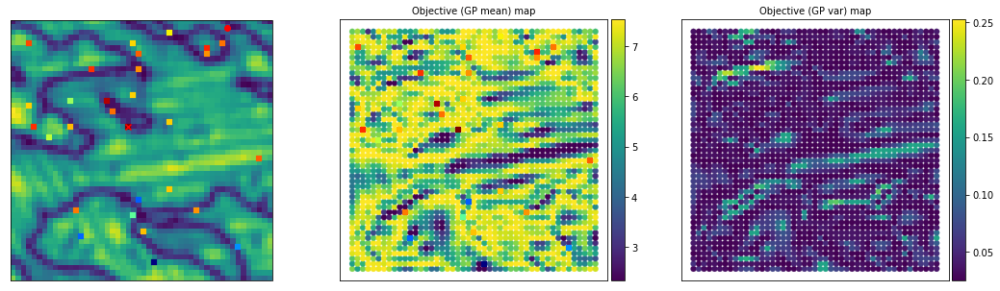

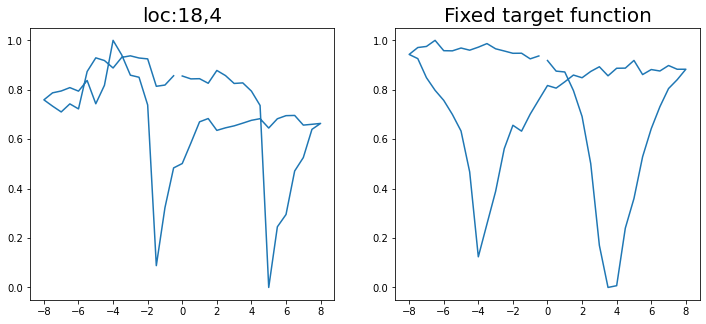

Epoch 1/200 ... Training loss: 4.2663
Epoch 10/200 ... Training loss: 3.7445
Epoch 20/200 ... Training loss: 3.3849
Epoch 30/200 ... Training loss: 2.9886
Epoch 40/200 ... Training loss: 2.7049
Epoch 50/200 ... Training loss: 2.181
Epoch 60/200 ... Training loss: 1.908
Epoch 70/200 ... Training loss: 1.7671
Epoch 80/200 ... Training loss: 1.6737
Epoch 90/200 ... Training loss: 1.608
Epoch 100/200 ... Training loss: 1.5502
Epoch 110/200 ... Training loss: 1.4975
Epoch 120/200 ... Training loss: 1.4507
Epoch 130/200 ... Training loss: 1.4603
Epoch 140/200 ... Training loss: 1.4579
Epoch 150/200 ... Training loss: 1.4017
Epoch 160/200 ... Training loss: 1.3323
Epoch 170/200 ... Training loss: 1.2819
Epoch 180/200 ... Training loss: 1.2413
Epoch 190/200 ... Training loss: 1.4315
Epoch 200/200 ... Training loss: 1.3226
step:  21
Sample #31




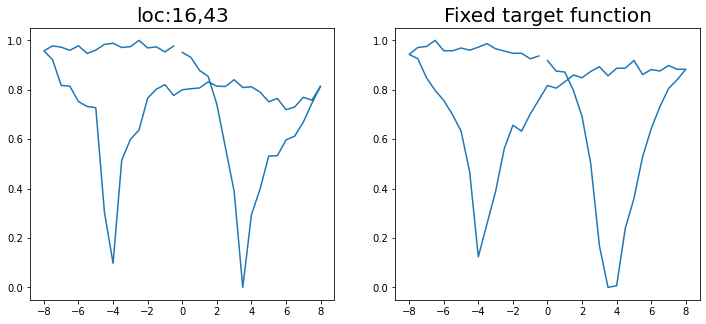

Epoch 1/200 ... Training loss: 4.2695
Epoch 10/200 ... Training loss: 3.9099
Epoch 20/200 ... Training loss: 3.5172
Epoch 30/200 ... Training loss: 3.1842
Epoch 40/200 ... Training loss: 2.9147
Epoch 50/200 ... Training loss: 2.69
Epoch 60/200 ... Training loss: 2.2051
Epoch 70/200 ... Training loss: 1.8853
Epoch 80/200 ... Training loss: 1.7503
Epoch 90/200 ... Training loss: 1.7069
Epoch 100/200 ... Training loss: 1.6638
Epoch 110/200 ... Training loss: 1.6267
Epoch 120/200 ... Training loss: 1.5941
Epoch 130/200 ... Training loss: 1.5653
Epoch 140/200 ... Training loss: 1.5392
Epoch 150/200 ... Training loss: 1.5155
Epoch 160/200 ... Training loss: 1.4938
Epoch 170/200 ... Training loss: 1.4738
Epoch 180/200 ... Training loss: 1.4553
Epoch 190/200 ... Training loss: 1.4382
Epoch 200/200 ... Training loss: 1.4222
step:  22
Sample #32




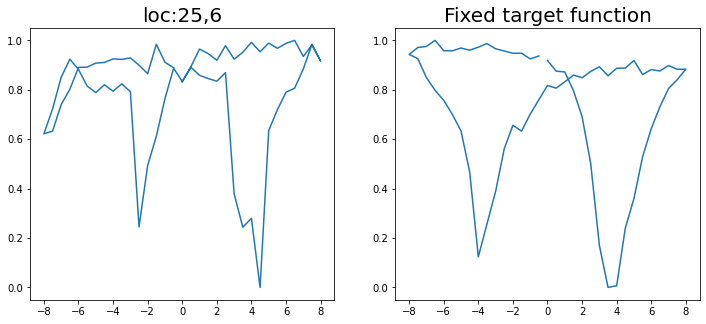

Epoch 1/200 ... Training loss: 4.222
Epoch 10/200 ... Training loss: 4.0246
Epoch 20/200 ... Training loss: 3.6049
Epoch 30/200 ... Training loss: 3.0299
Epoch 40/200 ... Training loss: 2.7593
Epoch 50/200 ... Training loss: 2.3428
Epoch 60/200 ... Training loss: 1.9668
Epoch 70/200 ... Training loss: 1.7578
Epoch 80/200 ... Training loss: 1.645
Epoch 90/200 ... Training loss: 1.5994
Epoch 100/200 ... Training loss: 1.5447
Epoch 110/200 ... Training loss: 1.4946
Epoch 120/200 ... Training loss: 1.4465
Epoch 130/200 ... Training loss: 1.4066
Epoch 140/200 ... Training loss: 1.3701
Epoch 150/200 ... Training loss: 1.333
Epoch 160/200 ... Training loss: 1.305
Epoch 170/200 ... Training loss: 1.2685
Epoch 180/200 ... Training loss: 1.2394
Epoch 190/200 ... Training loss: 1.2012
Epoch 200/200 ... Training loss: 1.169
step:  23
Sample #33




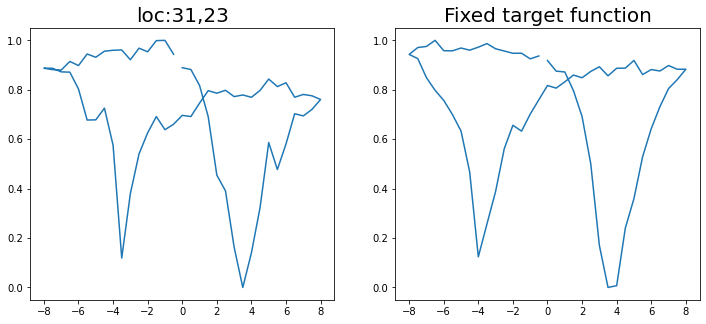

Epoch 1/200 ... Training loss: 4.2146
Epoch 10/200 ... Training loss: 3.9114
Epoch 20/200 ... Training loss: 3.6252
Epoch 30/200 ... Training loss: 3.3859
Epoch 40/200 ... Training loss: 3.1416
Epoch 50/200 ... Training loss: 2.947
Epoch 60/200 ... Training loss: 2.7686
Epoch 70/200 ... Training loss: 2.6202
Epoch 80/200 ... Training loss: 2.4611
Epoch 90/200 ... Training loss: 2.1738
Epoch 100/200 ... Training loss: 1.7039
Epoch 110/200 ... Training loss: 1.6953
Epoch 120/200 ... Training loss: 1.6239
Epoch 130/200 ... Training loss: 1.5704
Epoch 140/200 ... Training loss: 1.5208
Epoch 150/200 ... Training loss: 1.5143
Epoch 160/200 ... Training loss: 1.4534
Epoch 170/200 ... Training loss: 1.4217
Epoch 180/200 ... Training loss: 1.3907
Epoch 190/200 ... Training loss: 1.3587
Epoch 200/200 ... Training loss: 1.3301
step:  24
Sample #34




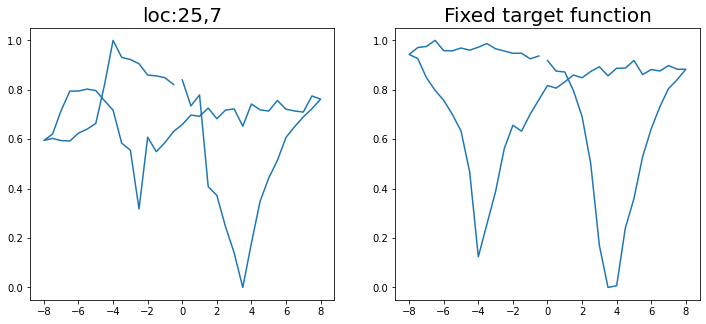

Epoch 1/200 ... Training loss: 4.1914
Epoch 10/200 ... Training loss: 3.9858
Epoch 20/200 ... Training loss: 3.6344
Epoch 30/200 ... Training loss: 3.3092
Epoch 40/200 ... Training loss: 3.0159
Epoch 50/200 ... Training loss: 2.7882
Epoch 60/200 ... Training loss: 2.4248
Epoch 70/200 ... Training loss: 1.8893
Epoch 80/200 ... Training loss: 1.6907
Epoch 90/200 ... Training loss: 1.6353
Epoch 100/200 ... Training loss: 1.5927
Epoch 110/200 ... Training loss: 1.5612
Epoch 120/200 ... Training loss: 1.5323
Epoch 130/200 ... Training loss: 1.464
Epoch 140/200 ... Training loss: 1.4155
Epoch 150/200 ... Training loss: 1.3825
Epoch 160/200 ... Training loss: 1.3472
Epoch 170/200 ... Training loss: 1.314
Epoch 180/200 ... Training loss: 1.3303
Epoch 190/200 ... Training loss: 1.2534
Epoch 200/200 ... Training loss: 1.2214
step:  25
Sample #35




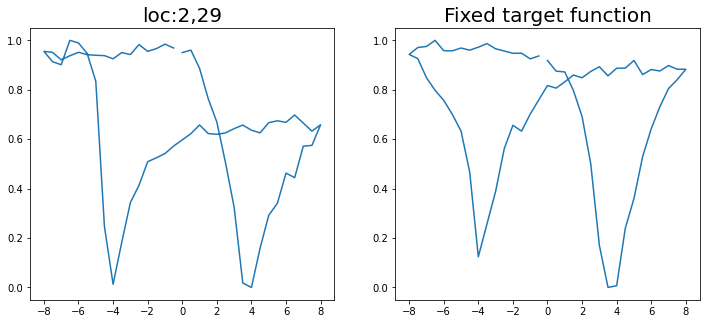

Epoch 1/200 ... Training loss: 4.0992
Epoch 10/200 ... Training loss: 3.8775
Epoch 20/200 ... Training loss: 3.5552
Epoch 30/200 ... Training loss: 3.287
Epoch 40/200 ... Training loss: 3.0777
Epoch 50/200 ... Training loss: 2.895
Epoch 60/200 ... Training loss: 2.7209
Epoch 70/200 ... Training loss: 2.5506
Epoch 80/200 ... Training loss: 2.2614
Epoch 90/200 ... Training loss: 1.9314
Epoch 100/200 ... Training loss: 1.6922
Epoch 110/200 ... Training loss: 1.576
Epoch 120/200 ... Training loss: 1.5178
Epoch 130/200 ... Training loss: 1.4747
Epoch 140/200 ... Training loss: 1.439
Epoch 150/200 ... Training loss: 1.4087
Epoch 160/200 ... Training loss: 1.3822
Epoch 170/200 ... Training loss: 1.3608
Epoch 180/200 ... Training loss: 1.35
Epoch 190/200 ... Training loss: 1.3105
Epoch 200/200 ... Training loss: 1.2744
step:  26
Sample #36




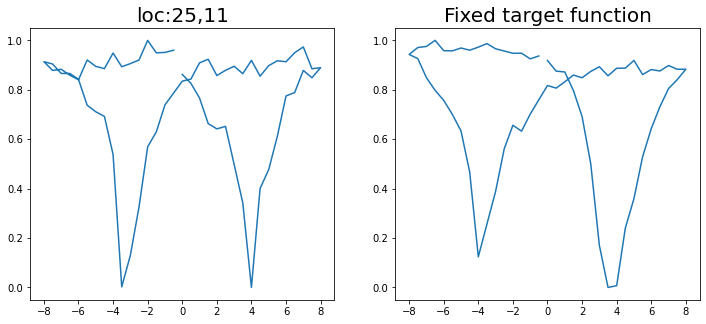

Epoch 1/200 ... Training loss: 4.0074
Epoch 10/200 ... Training loss: 3.8445
Epoch 20/200 ... Training loss: 3.4202
Epoch 30/200 ... Training loss: 3.1471
Epoch 40/200 ... Training loss: 2.7225
Epoch 50/200 ... Training loss: 2.3486
Epoch 60/200 ... Training loss: 1.9088
Epoch 70/200 ... Training loss: 1.7047
Epoch 80/200 ... Training loss: 1.5855
Epoch 90/200 ... Training loss: 1.5331
Epoch 100/200 ... Training loss: 1.4733
Epoch 110/200 ... Training loss: 1.432
Epoch 120/200 ... Training loss: 1.3882
Epoch 130/200 ... Training loss: 1.3506
Epoch 140/200 ... Training loss: 1.3155
Epoch 150/200 ... Training loss: 1.282
Epoch 160/200 ... Training loss: 1.2495
Epoch 170/200 ... Training loss: 1.2178
Epoch 180/200 ... Training loss: 1.2175
Epoch 190/200 ... Training loss: 1.161
Epoch 200/200 ... Training loss: 1.1254
step:  27
Sample #37




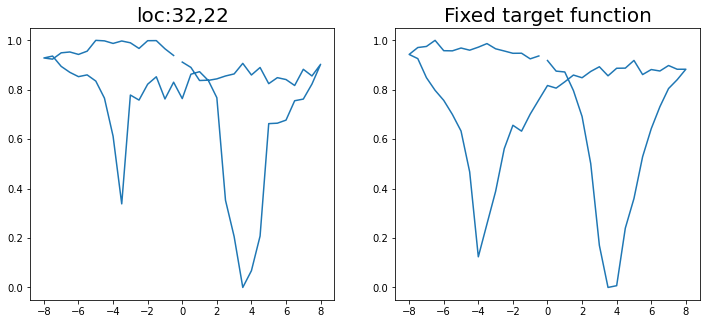

Epoch 1/200 ... Training loss: 3.983
Epoch 10/200 ... Training loss: 3.2958
Epoch 20/200 ... Training loss: 3.3696
Epoch 30/200 ... Training loss: 3.2028
Epoch 40/200 ... Training loss: 2.6974
Epoch 50/200 ... Training loss: 2.4734
Epoch 60/200 ... Training loss: 2.0038
Epoch 70/200 ... Training loss: 1.7166
Epoch 80/200 ... Training loss: 1.6016
Epoch 90/200 ... Training loss: 1.537
Epoch 100/200 ... Training loss: 1.486
Epoch 110/200 ... Training loss: 1.469
Epoch 120/200 ... Training loss: 1.4216
Epoch 130/200 ... Training loss: 1.3763
Epoch 140/200 ... Training loss: 1.3379
Epoch 150/200 ... Training loss: 1.3044
Epoch 160/200 ... Training loss: 1.269
Epoch 170/200 ... Training loss: 1.2355
Epoch 180/200 ... Training loss: 1.2046
Epoch 190/200 ... Training loss: 1.1732
Epoch 200/200 ... Training loss: 1.1423
step:  28
Sample #38




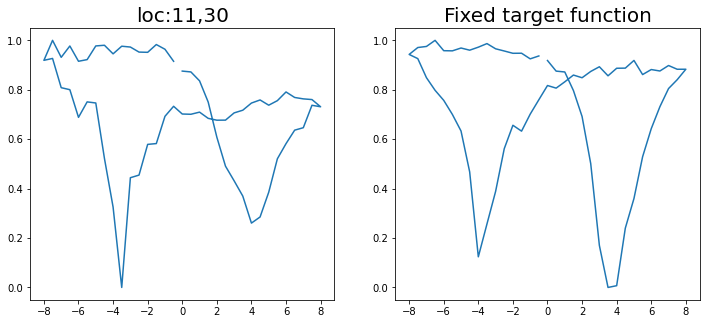

Epoch 1/200 ... Training loss: 3.9167
Epoch 10/200 ... Training loss: 3.725
Epoch 20/200 ... Training loss: 3.3282
Epoch 30/200 ... Training loss: 2.9584
Epoch 40/200 ... Training loss: 2.7337
Epoch 50/200 ... Training loss: 2.4402
Epoch 60/200 ... Training loss: 1.9775
Epoch 70/200 ... Training loss: 1.7145
Epoch 80/200 ... Training loss: 1.5907
Epoch 90/200 ... Training loss: 1.5686
Epoch 100/200 ... Training loss: 1.4592
Epoch 110/200 ... Training loss: 1.418
Epoch 120/200 ... Training loss: 1.3813
Epoch 130/200 ... Training loss: 1.3433
Epoch 140/200 ... Training loss: 1.3058
Epoch 150/200 ... Training loss: 1.2717
Epoch 160/200 ... Training loss: 1.2397
Epoch 170/200 ... Training loss: 1.2077
Epoch 180/200 ... Training loss: 1.2476
Epoch 190/200 ... Training loss: 1.1689
Epoch 200/200 ... Training loss: 1.1256
step:  29
Sample #39




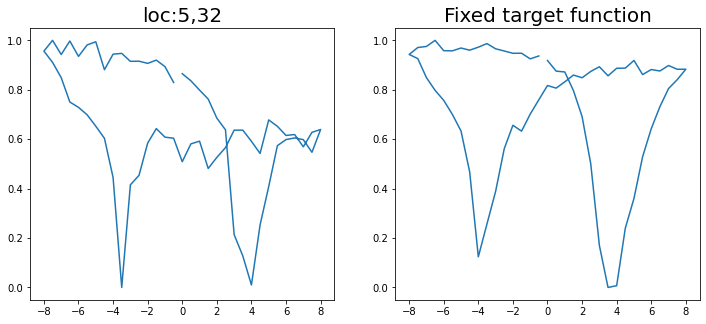

Epoch 1/200 ... Training loss: 3.8398
Epoch 10/200 ... Training loss: 3.713
Epoch 20/200 ... Training loss: 3.353
Epoch 30/200 ... Training loss: 2.9089
Epoch 40/200 ... Training loss: 2.7723
Epoch 50/200 ... Training loss: 2.6668
Epoch 60/200 ... Training loss: 2.3532
Epoch 70/200 ... Training loss: 2.0848
Epoch 80/200 ... Training loss: 1.754
Epoch 90/200 ... Training loss: 1.6078
Epoch 100/200 ... Training loss: 1.5139
Epoch 110/200 ... Training loss: 1.46
Epoch 120/200 ... Training loss: 1.4228
Epoch 130/200 ... Training loss: 1.3888
Epoch 140/200 ... Training loss: 1.3561
Epoch 150/200 ... Training loss: 1.3252
Epoch 160/200 ... Training loss: 1.2946
Epoch 170/200 ... Training loss: 1.2696
Epoch 180/200 ... Training loss: 1.7461
Epoch 190/200 ... Training loss: 1.3798
Epoch 200/200 ... Training loss: 1.3475
step:  30
Sample #40




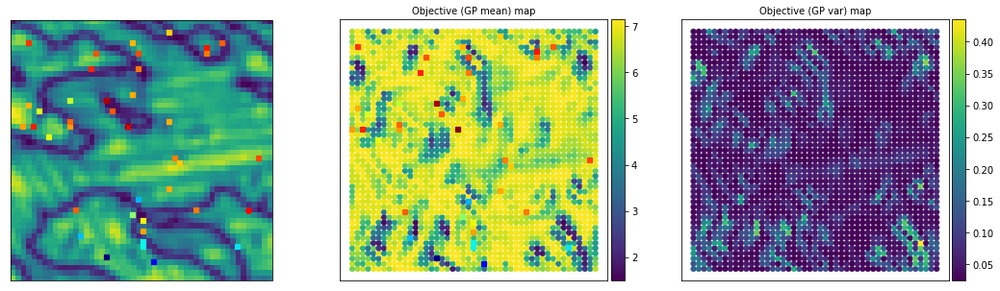

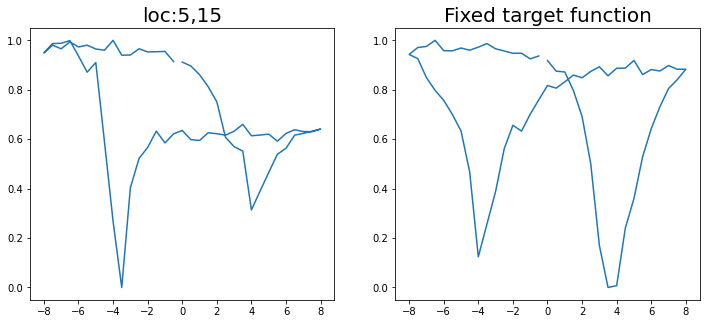

Epoch 1/200 ... Training loss: 3.7634
Epoch 10/200 ... Training loss: 3.5747
Epoch 20/200 ... Training loss: 3.2299
Epoch 30/200 ... Training loss: 3.008
Epoch 40/200 ... Training loss: 2.7207
Epoch 50/200 ... Training loss: 2.4883
Epoch 60/200 ... Training loss: 2.121
Epoch 70/200 ... Training loss: 1.7524
Epoch 80/200 ... Training loss: 1.5978
Epoch 90/200 ... Training loss: 1.5055
Epoch 100/200 ... Training loss: 1.4577
Epoch 110/200 ... Training loss: 1.4077
Epoch 120/200 ... Training loss: 1.3671
Epoch 130/200 ... Training loss: 1.3317
Epoch 140/200 ... Training loss: 1.2949
Epoch 150/200 ... Training loss: 1.262
Epoch 160/200 ... Training loss: 1.229
Epoch 170/200 ... Training loss: 1.2045
Epoch 180/200 ... Training loss: 1.1785
Epoch 190/200 ... Training loss: 1.1401
Epoch 200/200 ... Training loss: 1.1109
step:  31
Sample #41




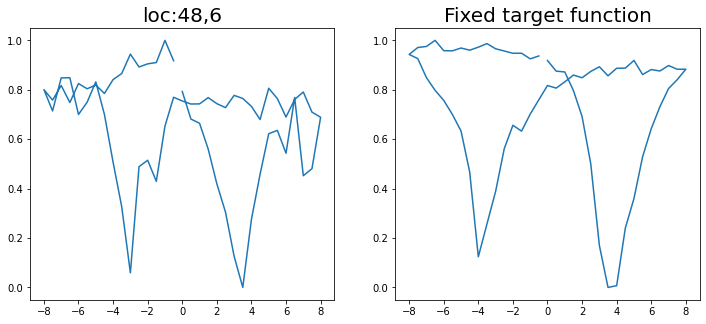

Epoch 1/200 ... Training loss: 3.7343
Epoch 10/200 ... Training loss: 3.1065
Epoch 20/200 ... Training loss: 2.8265
Epoch 30/200 ... Training loss: 2.5586
Epoch 40/200 ... Training loss: 1.8626
Epoch 50/200 ... Training loss: 1.6579
Epoch 60/200 ... Training loss: 1.5612
Epoch 70/200 ... Training loss: 1.5174
Epoch 80/200 ... Training loss: 1.4291
Epoch 90/200 ... Training loss: 1.3783
Epoch 100/200 ... Training loss: 1.3244
Epoch 110/200 ... Training loss: 1.2721
Epoch 120/200 ... Training loss: 1.2396
Epoch 130/200 ... Training loss: 1.288
Epoch 140/200 ... Training loss: 1.1557
Epoch 150/200 ... Training loss: 1.1177
Epoch 160/200 ... Training loss: 1.0681
Epoch 170/200 ... Training loss: 1.0265
Epoch 180/200 ... Training loss: 0.9844
Epoch 190/200 ... Training loss: 1.0038
Epoch 200/200 ... Training loss: 0.9125
step:  32
Sample #42




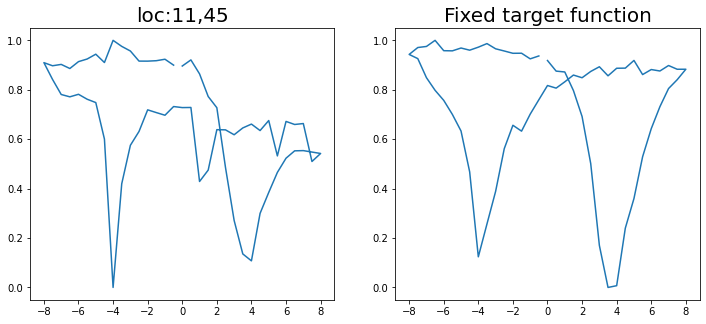

Epoch 1/200 ... Training loss: 3.6642
Epoch 10/200 ... Training loss: 3.0883
Epoch 20/200 ... Training loss: 2.6611
Epoch 30/200 ... Training loss: 2.2068
Epoch 40/200 ... Training loss: 1.7566
Epoch 50/200 ... Training loss: 1.6036
Epoch 60/200 ... Training loss: 1.5301
Epoch 70/200 ... Training loss: 1.4883
Epoch 80/200 ... Training loss: 1.4173
Epoch 90/200 ... Training loss: 1.3464
Epoch 100/200 ... Training loss: 1.294
Epoch 110/200 ... Training loss: 1.2414
Epoch 120/200 ... Training loss: 1.19
Epoch 130/200 ... Training loss: 1.149
Epoch 140/200 ... Training loss: 1.0989
Epoch 150/200 ... Training loss: 1.148
Epoch 160/200 ... Training loss: 1.0617
Epoch 170/200 ... Training loss: 0.9892
Epoch 180/200 ... Training loss: 0.9342
Epoch 190/200 ... Training loss: 0.9849
Epoch 200/200 ... Training loss: 0.8598
step:  33
Sample #43




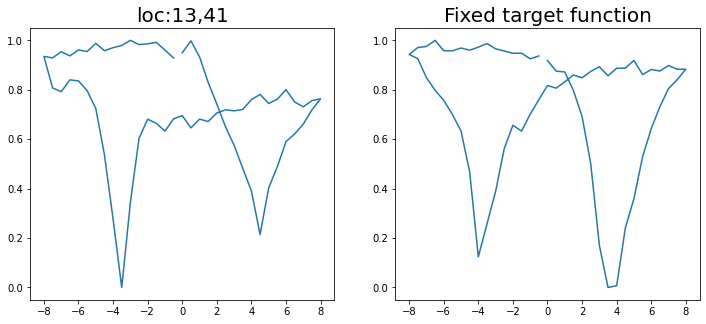

Epoch 1/200 ... Training loss: 3.6057
Epoch 10/200 ... Training loss: 3.2011
Epoch 20/200 ... Training loss: 2.7585
Epoch 30/200 ... Training loss: 2.3481
Epoch 40/200 ... Training loss: 1.7913
Epoch 50/200 ... Training loss: 1.6085
Epoch 60/200 ... Training loss: 1.5305
Epoch 70/200 ... Training loss: 1.4508
Epoch 80/200 ... Training loss: 1.384
Epoch 90/200 ... Training loss: 1.327
Epoch 100/200 ... Training loss: 1.2785
Epoch 110/200 ... Training loss: 1.2529
Epoch 120/200 ... Training loss: 1.1953
Epoch 130/200 ... Training loss: 1.1519
Epoch 140/200 ... Training loss: 1.101
Epoch 150/200 ... Training loss: 1.0909
Epoch 160/200 ... Training loss: 1.0406
Epoch 170/200 ... Training loss: 0.9905
Epoch 180/200 ... Training loss: 0.9456
Epoch 190/200 ... Training loss: 0.9104
Epoch 200/200 ... Training loss: 0.8673
step:  34
Sample #44




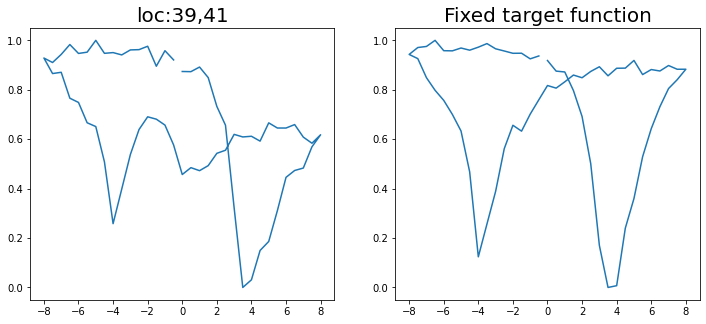

Epoch 1/200 ... Training loss: 3.5555
Epoch 10/200 ... Training loss: 3.081
Epoch 20/200 ... Training loss: 2.7049
Epoch 30/200 ... Training loss: 2.233
Epoch 40/200 ... Training loss: 1.7455
Epoch 50/200 ... Training loss: 1.5847
Epoch 60/200 ... Training loss: 1.5508
Epoch 70/200 ... Training loss: 1.4822
Epoch 80/200 ... Training loss: 1.3954
Epoch 90/200 ... Training loss: 1.3358
Epoch 100/200 ... Training loss: 1.2857
Epoch 110/200 ... Training loss: 1.2388
Epoch 120/200 ... Training loss: 1.185
Epoch 130/200 ... Training loss: 1.1481
Epoch 140/200 ... Training loss: 1.096
Epoch 150/200 ... Training loss: 1.0558
Epoch 160/200 ... Training loss: 1.0138
Epoch 170/200 ... Training loss: 0.9915
Epoch 180/200 ... Training loss: 0.9368
Epoch 190/200 ... Training loss: 0.8952
Epoch 200/200 ... Training loss: 0.8524
step:  35
Sample #45




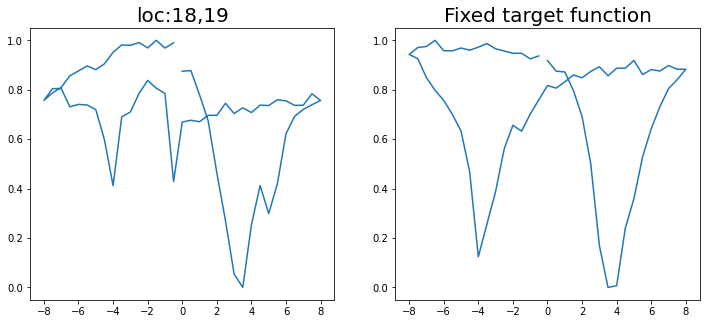

Epoch 1/200 ... Training loss: 3.507
Epoch 10/200 ... Training loss: 3.0212
Epoch 20/200 ... Training loss: 2.5341
Epoch 30/200 ... Training loss: 1.9456
Epoch 40/200 ... Training loss: 1.7927
Epoch 50/200 ... Training loss: 1.6078
Epoch 60/200 ... Training loss: 1.5268
Epoch 70/200 ... Training loss: 1.4549
Epoch 80/200 ... Training loss: 1.3835
Epoch 90/200 ... Training loss: 1.3172
Epoch 100/200 ... Training loss: 1.4487
Epoch 110/200 ... Training loss: 1.2308
Epoch 120/200 ... Training loss: 1.1805
Epoch 130/200 ... Training loss: 1.1217
Epoch 140/200 ... Training loss: 1.0713
Epoch 150/200 ... Training loss: 1.029
Epoch 160/200 ... Training loss: 1.0104
Epoch 170/200 ... Training loss: 0.9442
Epoch 180/200 ... Training loss: 0.897
Epoch 190/200 ... Training loss: 0.8496
Epoch 200/200 ... Training loss: 0.8579
step:  36
Sample #46




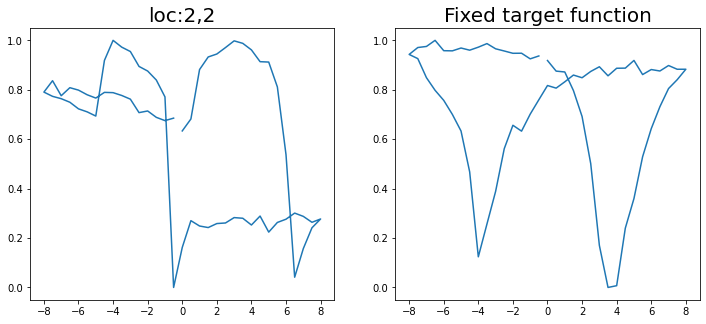

Epoch 1/200 ... Training loss: 3.862
Epoch 10/200 ... Training loss: 3.5306
Epoch 20/200 ... Training loss: 2.9607
Epoch 30/200 ... Training loss: 2.5516
Epoch 40/200 ... Training loss: 2.0454
Epoch 50/200 ... Training loss: 1.7464
Epoch 60/200 ... Training loss: 1.5532
Epoch 70/200 ... Training loss: 1.517
Epoch 80/200 ... Training loss: 1.4868
Epoch 90/200 ... Training loss: 1.3846
Epoch 100/200 ... Training loss: 1.3249
Epoch 110/200 ... Training loss: 1.2796
Epoch 120/200 ... Training loss: 1.2435
Epoch 130/200 ... Training loss: 1.2522
Epoch 140/200 ... Training loss: 1.2001
Epoch 150/200 ... Training loss: 1.1549
Epoch 160/200 ... Training loss: 1.1202
Epoch 170/200 ... Training loss: 1.0853
Epoch 180/200 ... Training loss: 1.0657
Epoch 190/200 ... Training loss: 1.0231
Epoch 200/200 ... Training loss: 0.9877
step:  37
Sample #47




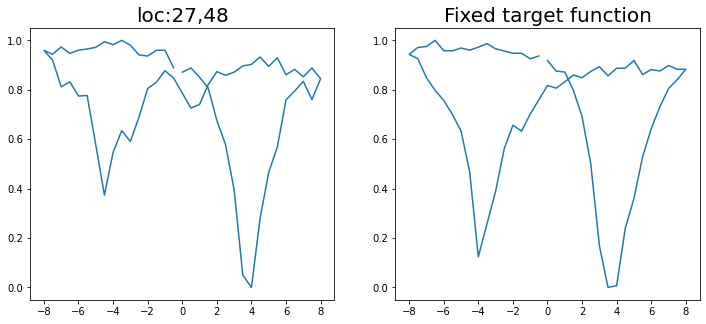

Epoch 1/200 ... Training loss: 3.8088
Epoch 10/200 ... Training loss: 3.3411
Epoch 20/200 ... Training loss: 2.8841
Epoch 30/200 ... Training loss: 2.5622
Epoch 40/200 ... Training loss: 1.9415
Epoch 50/200 ... Training loss: 1.6774
Epoch 60/200 ... Training loss: 1.5608
Epoch 70/200 ... Training loss: 1.4869
Epoch 80/200 ... Training loss: 1.4299
Epoch 90/200 ... Training loss: 1.3833
Epoch 100/200 ... Training loss: 1.3344
Epoch 110/200 ... Training loss: 1.3697
Epoch 120/200 ... Training loss: 1.2483
Epoch 130/200 ... Training loss: 1.2014
Epoch 140/200 ... Training loss: 1.1556
Epoch 150/200 ... Training loss: 1.1188
Epoch 160/200 ... Training loss: 1.081
Epoch 170/200 ... Training loss: 1.0654
Epoch 180/200 ... Training loss: 1.0459
Epoch 190/200 ... Training loss: 0.9821
Epoch 200/200 ... Training loss: 0.9429
step:  38
Sample #48




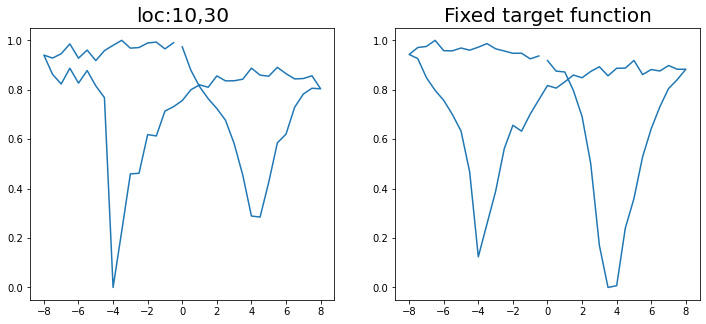

Epoch 1/200 ... Training loss: 3.7957
Epoch 10/200 ... Training loss: 3.3693
Epoch 20/200 ... Training loss: 2.9296
Epoch 30/200 ... Training loss: 2.6376
Epoch 40/200 ... Training loss: 1.9773
Epoch 50/200 ... Training loss: 1.7444
Epoch 60/200 ... Training loss: 1.5619
Epoch 70/200 ... Training loss: 1.48
Epoch 80/200 ... Training loss: 1.4209
Epoch 90/200 ... Training loss: 1.3667
Epoch 100/200 ... Training loss: 1.3132
Epoch 110/200 ... Training loss: 1.2688
Epoch 120/200 ... Training loss: 1.2246
Epoch 130/200 ... Training loss: 1.1793
Epoch 140/200 ... Training loss: 1.1538
Epoch 150/200 ... Training loss: 1.1218
Epoch 160/200 ... Training loss: 1.0741
Epoch 170/200 ... Training loss: 1.0359
Epoch 180/200 ... Training loss: 1.0056
Epoch 190/200 ... Training loss: 0.9965
Epoch 200/200 ... Training loss: 0.9383
step:  39
Sample #49




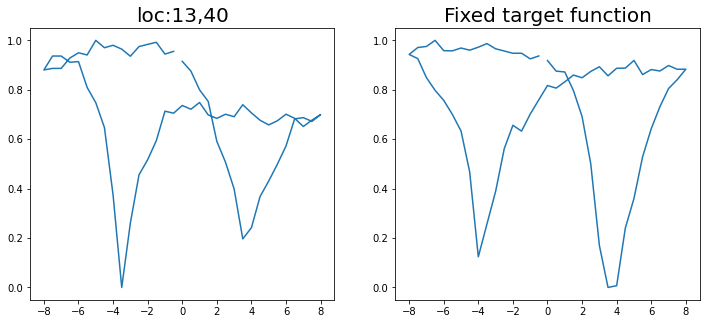

Epoch 1/200 ... Training loss: 3.742
Epoch 10/200 ... Training loss: 3.2438
Epoch 20/200 ... Training loss: 2.9769
Epoch 30/200 ... Training loss: 2.8171
Epoch 40/200 ... Training loss: 2.5424
Epoch 50/200 ... Training loss: 2.268
Epoch 60/200 ... Training loss: 2.1527
Epoch 70/200 ... Training loss: 1.7424
Epoch 80/200 ... Training loss: 1.5541
Epoch 90/200 ... Training loss: 1.4337
Epoch 100/200 ... Training loss: 1.3794
Epoch 110/200 ... Training loss: 1.3335
Epoch 120/200 ... Training loss: 1.2968
Epoch 130/200 ... Training loss: 1.2643
Epoch 140/200 ... Training loss: 1.2311
Epoch 150/200 ... Training loss: 1.2007
Epoch 160/200 ... Training loss: 1.1946
Epoch 170/200 ... Training loss: 1.1909
Epoch 180/200 ... Training loss: 1.1792
Epoch 190/200 ... Training loss: 1.1419
Epoch 200/200 ... Training loss: 1.1088
step:  40
Sample #50




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


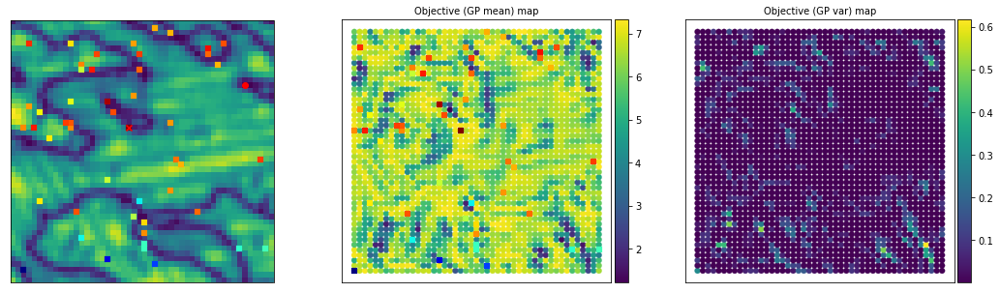

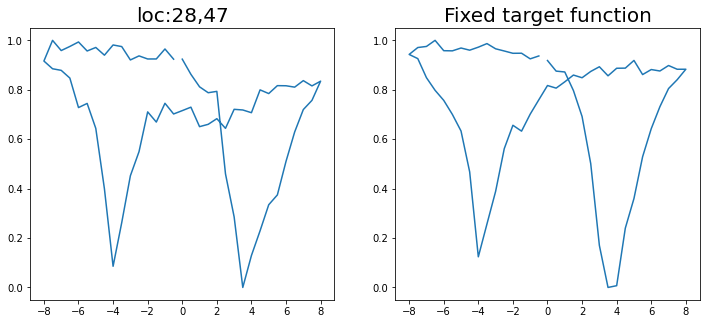

Epoch 1/200 ... Training loss: 3.701
Epoch 10/200 ... Training loss: 3.1354
Epoch 20/200 ... Training loss: 2.8003
Epoch 30/200 ... Training loss: 2.7286
Epoch 40/200 ... Training loss: 2.4461
Epoch 50/200 ... Training loss: 2.2069
Epoch 60/200 ... Training loss: 1.634
Epoch 70/200 ... Training loss: 1.5055
Epoch 80/200 ... Training loss: 1.4335
Epoch 90/200 ... Training loss: 1.3853
Epoch 100/200 ... Training loss: 1.4036
Epoch 110/200 ... Training loss: 1.352
Epoch 120/200 ... Training loss: 1.2723
Epoch 130/200 ... Training loss: 1.231
Epoch 140/200 ... Training loss: 1.1914
Epoch 150/200 ... Training loss: 1.1582
Epoch 160/200 ... Training loss: 1.1241
Epoch 170/200 ... Training loss: 1.1571
Epoch 180/200 ... Training loss: 1.0948
Epoch 190/200 ... Training loss: 1.048
Epoch 200/200 ... Training loss: 1.0057
step:  41
Sample #51




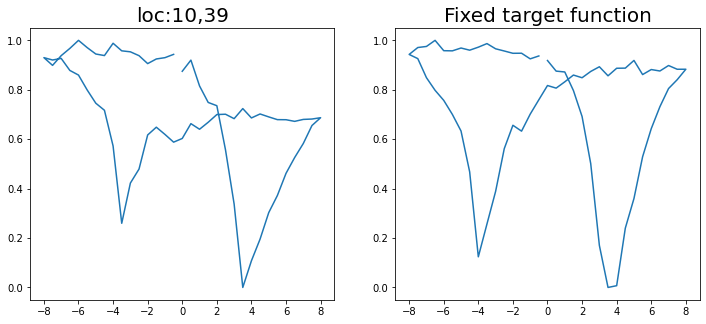

Epoch 1/200 ... Training loss: 3.6657
Epoch 10/200 ... Training loss: 3.0876
Epoch 20/200 ... Training loss: 2.4884
Epoch 30/200 ... Training loss: 1.9247
Epoch 40/200 ... Training loss: 1.7324
Epoch 50/200 ... Training loss: 1.5644
Epoch 60/200 ... Training loss: 1.4574
Epoch 70/200 ... Training loss: 1.5735
Epoch 80/200 ... Training loss: 1.4256
Epoch 90/200 ... Training loss: 1.3283
Epoch 100/200 ... Training loss: 1.2422
Epoch 110/200 ... Training loss: 1.1827
Epoch 120/200 ... Training loss: 1.144
Epoch 130/200 ... Training loss: 1.1054
Epoch 140/200 ... Training loss: 1.0596
Epoch 150/200 ... Training loss: 1.0176
Epoch 160/200 ... Training loss: 0.9853
Epoch 170/200 ... Training loss: 0.952
Epoch 180/200 ... Training loss: 0.9168
Epoch 190/200 ... Training loss: 0.8733
Epoch 200/200 ... Training loss: 0.8359
step:  42
Sample #52




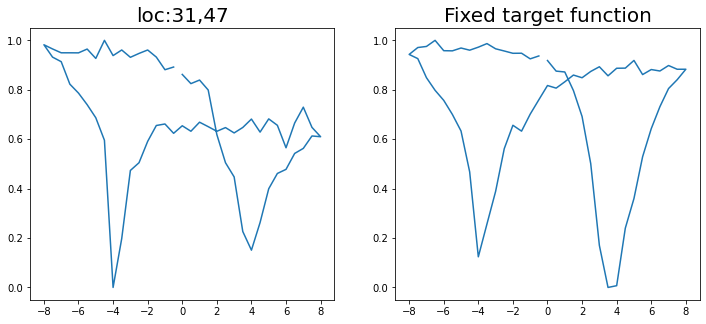

Epoch 1/200 ... Training loss: 3.6195
Epoch 10/200 ... Training loss: 3.2968
Epoch 20/200 ... Training loss: 2.8068
Epoch 30/200 ... Training loss: 2.6289
Epoch 40/200 ... Training loss: 2.3107
Epoch 50/200 ... Training loss: 2.1217
Epoch 60/200 ... Training loss: 1.7143
Epoch 70/200 ... Training loss: 1.5363
Epoch 80/200 ... Training loss: 1.394
Epoch 90/200 ... Training loss: 1.3327
Epoch 100/200 ... Training loss: 1.2908
Epoch 110/200 ... Training loss: 1.254
Epoch 120/200 ... Training loss: 1.2145
Epoch 130/200 ... Training loss: 1.1802
Epoch 140/200 ... Training loss: 1.2055
Epoch 150/200 ... Training loss: 1.1285
Epoch 160/200 ... Training loss: 1.0892
Epoch 170/200 ... Training loss: 1.0557
Epoch 180/200 ... Training loss: 1.0254
Epoch 190/200 ... Training loss: 1.0014
Epoch 200/200 ... Training loss: 0.9622
step:  43
Sample #53




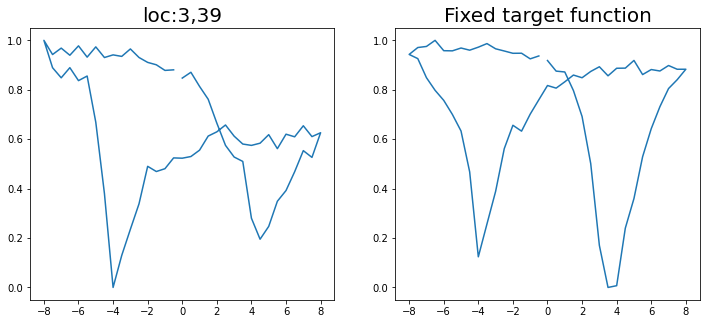

Epoch 1/200 ... Training loss: 3.5747
Epoch 10/200 ... Training loss: 3.3235
Epoch 20/200 ... Training loss: 2.6318
Epoch 30/200 ... Training loss: 2.5446
Epoch 40/200 ... Training loss: 2.1637
Epoch 50/200 ... Training loss: 1.636
Epoch 60/200 ... Training loss: 1.5613
Epoch 70/200 ... Training loss: 1.5419
Epoch 80/200 ... Training loss: 1.465
Epoch 90/200 ... Training loss: 1.39
Epoch 100/200 ... Training loss: 1.3153
Epoch 110/200 ... Training loss: 1.3148
Epoch 120/200 ... Training loss: 1.2369
Epoch 130/200 ... Training loss: 1.163
Epoch 140/200 ... Training loss: 1.12
Epoch 150/200 ... Training loss: 1.0836
Epoch 160/200 ... Training loss: 1.0566
Epoch 170/200 ... Training loss: 1.0414
Epoch 180/200 ... Training loss: 0.9881
Epoch 190/200 ... Training loss: 0.9759
Epoch 200/200 ... Training loss: 0.9317
step:  44
Sample #54




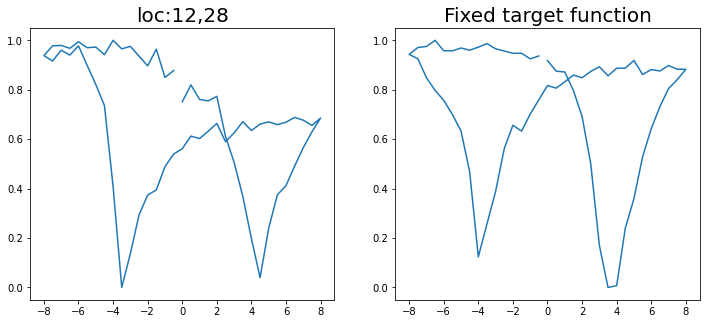

Epoch 1/200 ... Training loss: 3.5234
Epoch 10/200 ... Training loss: 3.1793
Epoch 20/200 ... Training loss: 2.5724
Epoch 30/200 ... Training loss: 2.5441
Epoch 40/200 ... Training loss: 2.1162
Epoch 50/200 ... Training loss: 1.6092
Epoch 60/200 ... Training loss: 1.5381
Epoch 70/200 ... Training loss: 1.4548
Epoch 80/200 ... Training loss: 1.3884
Epoch 90/200 ... Training loss: 1.3072
Epoch 100/200 ... Training loss: 1.288
Epoch 110/200 ... Training loss: 1.2133
Epoch 120/200 ... Training loss: 1.167
Epoch 130/200 ... Training loss: 1.1273
Epoch 140/200 ... Training loss: 1.0939
Epoch 150/200 ... Training loss: 1.0773
Epoch 160/200 ... Training loss: 1.0512
Epoch 170/200 ... Training loss: 0.9951
Epoch 180/200 ... Training loss: 0.9561
Epoch 190/200 ... Training loss: 0.9137
Epoch 200/200 ... Training loss: 0.9072
step:  45
Sample #55




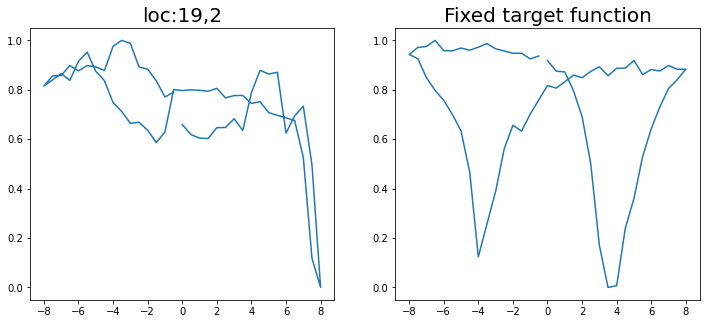

Epoch 1/200 ... Training loss: 3.747
Epoch 10/200 ... Training loss: 3.4619
Epoch 20/200 ... Training loss: 2.8997
Epoch 30/200 ... Training loss: 2.795
Epoch 40/200 ... Training loss: 2.6063
Epoch 50/200 ... Training loss: 2.2392
Epoch 60/200 ... Training loss: 1.9328
Epoch 70/200 ... Training loss: 1.5648
Epoch 80/200 ... Training loss: 1.4223
Epoch 90/200 ... Training loss: 1.3532
Epoch 100/200 ... Training loss: 1.3133
Epoch 110/200 ... Training loss: 1.2837
Epoch 120/200 ... Training loss: 1.3445
Epoch 130/200 ... Training loss: 1.2456
Epoch 140/200 ... Training loss: 1.1967
Epoch 150/200 ... Training loss: 1.159
Epoch 160/200 ... Training loss: 1.1307
Epoch 170/200 ... Training loss: 1.1046
Epoch 180/200 ... Training loss: 1.08
Epoch 190/200 ... Training loss: 1.0616
Epoch 200/200 ... Training loss: 1.0254
step:  46
Sample #56




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


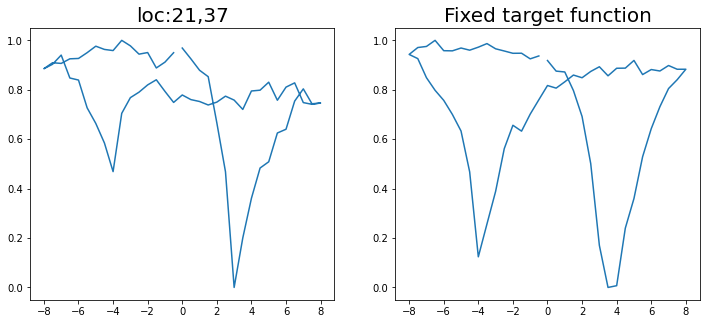

Epoch 1/200 ... Training loss: 3.6943
Epoch 10/200 ... Training loss: 3.4666
Epoch 20/200 ... Training loss: 2.8739
Epoch 30/200 ... Training loss: 2.745
Epoch 40/200 ... Training loss: 2.5739
Epoch 50/200 ... Training loss: 2.0945
Epoch 60/200 ... Training loss: 1.908
Epoch 70/200 ... Training loss: 1.8447
Epoch 80/200 ... Training loss: 1.4709
Epoch 90/200 ... Training loss: 1.4031
Epoch 100/200 ... Training loss: 1.41
Epoch 110/200 ... Training loss: 1.2852
Epoch 120/200 ... Training loss: 1.2441
Epoch 130/200 ... Training loss: 1.2047
Epoch 140/200 ... Training loss: 1.1738
Epoch 150/200 ... Training loss: 1.1452
Epoch 160/200 ... Training loss: 1.1191
Epoch 170/200 ... Training loss: 1.0883
Epoch 180/200 ... Training loss: 1.1121
Epoch 190/200 ... Training loss: 1.0544
Epoch 200/200 ... Training loss: 1.0156
step:  47
Sample #57




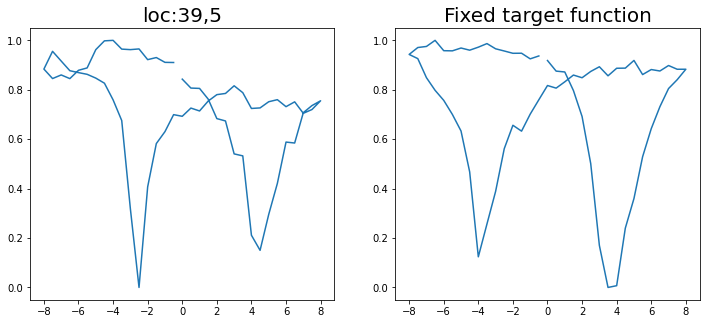

Epoch 1/200 ... Training loss: 3.6615
Epoch 10/200 ... Training loss: 3.45
Epoch 20/200 ... Training loss: 2.7945
Epoch 30/200 ... Training loss: 2.7093
Epoch 40/200 ... Training loss: 2.2177
Epoch 50/200 ... Training loss: 2.365
Epoch 60/200 ... Training loss: 1.9143
Epoch 70/200 ... Training loss: 1.6654
Epoch 80/200 ... Training loss: 1.4551
Epoch 90/200 ... Training loss: 1.4851
Epoch 100/200 ... Training loss: 1.3812
Epoch 110/200 ... Training loss: 1.2742
Epoch 120/200 ... Training loss: 1.2304
Epoch 130/200 ... Training loss: 1.1931
Epoch 140/200 ... Training loss: 1.1578
Epoch 150/200 ... Training loss: 1.1242
Epoch 160/200 ... Training loss: 1.1491
Epoch 170/200 ... Training loss: 1.0854
Epoch 180/200 ... Training loss: 1.0461
Epoch 190/200 ... Training loss: 1.0079
Epoch 200/200 ... Training loss: 0.9846
step:  48
Sample #58




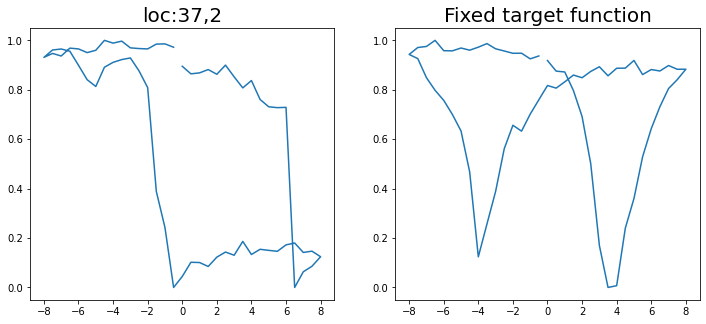

Epoch 1/200 ... Training loss: 3.8514
Epoch 10/200 ... Training loss: 3.0833
Epoch 20/200 ... Training loss: 2.5749
Epoch 30/200 ... Training loss: 1.953
Epoch 40/200 ... Training loss: 1.6268
Epoch 50/200 ... Training loss: 1.4854
Epoch 60/200 ... Training loss: 1.3935
Epoch 70/200 ... Training loss: 1.3142
Epoch 80/200 ... Training loss: 1.2563
Epoch 90/200 ... Training loss: 1.2115
Epoch 100/200 ... Training loss: 1.1625
Epoch 110/200 ... Training loss: 1.1322
Epoch 120/200 ... Training loss: 1.1097
Epoch 130/200 ... Training loss: 1.0604
Epoch 140/200 ... Training loss: 1.0526
Epoch 150/200 ... Training loss: 1.0287
Epoch 160/200 ... Training loss: 0.9616
Epoch 170/200 ... Training loss: 0.9997
Epoch 180/200 ... Training loss: 0.9656
Epoch 190/200 ... Training loss: 0.8721
Epoch 200/200 ... Training loss: 0.8272
step:  49
Sample #59




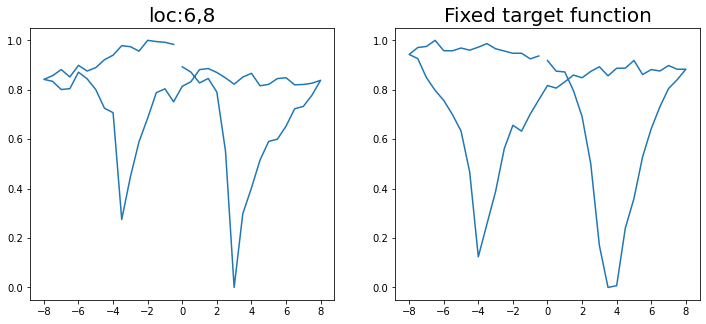

Epoch 1/200 ... Training loss: 3.7999
Epoch 10/200 ... Training loss: 3.1482
Epoch 20/200 ... Training loss: 2.5225
Epoch 30/200 ... Training loss: 2.1909
Epoch 40/200 ... Training loss: 1.8798
Epoch 50/200 ... Training loss: 1.6239
Epoch 60/200 ... Training loss: 1.4106
Epoch 70/200 ... Training loss: 1.3193
Epoch 80/200 ... Training loss: 1.288
Epoch 90/200 ... Training loss: 1.2318
Epoch 100/200 ... Training loss: 1.1731
Epoch 110/200 ... Training loss: 1.1389
Epoch 120/200 ... Training loss: 1.1228
Epoch 130/200 ... Training loss: 1.0652
Epoch 140/200 ... Training loss: 1.0361
Epoch 150/200 ... Training loss: 0.9953
Epoch 160/200 ... Training loss: 0.9779
Epoch 170/200 ... Training loss: 0.9805
Epoch 180/200 ... Training loss: 0.9175
Epoch 190/200 ... Training loss: 0.8691
Epoch 200/200 ... Training loss: 0.8502
step:  50
Sample #60




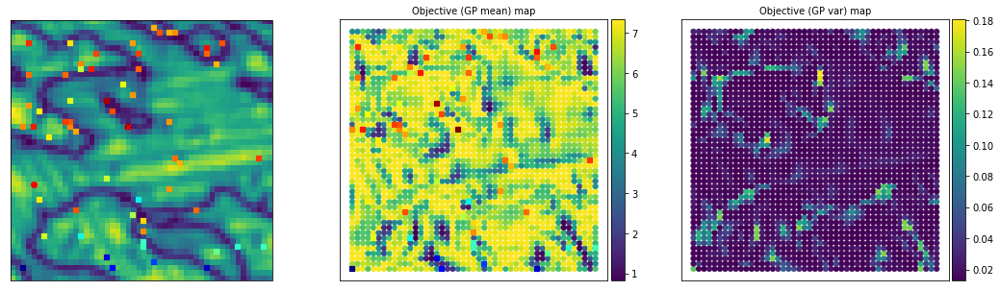

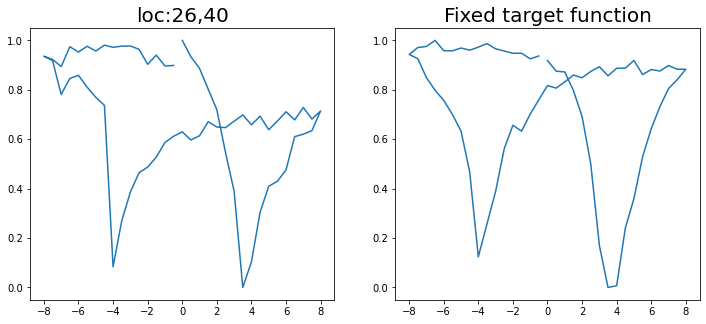

Epoch 1/200 ... Training loss: 3.8003
Epoch 10/200 ... Training loss: 3.0703
Epoch 20/200 ... Training loss: 2.6886
Epoch 30/200 ... Training loss: 2.1582
Epoch 40/200 ... Training loss: 1.9703
Epoch 50/200 ... Training loss: 1.6682
Epoch 60/200 ... Training loss: 1.4595
Epoch 70/200 ... Training loss: 1.3721
Epoch 80/200 ... Training loss: 1.4124
Epoch 90/200 ... Training loss: 1.2756
Epoch 100/200 ... Training loss: 1.2089
Epoch 110/200 ... Training loss: 1.1667
Epoch 120/200 ... Training loss: 1.1253
Epoch 130/200 ... Training loss: 1.0858
Epoch 140/200 ... Training loss: 1.0632
Epoch 150/200 ... Training loss: 1.0305
Epoch 160/200 ... Training loss: 0.9915
Epoch 170/200 ... Training loss: 0.9633
Epoch 180/200 ... Training loss: 0.9338
Epoch 190/200 ... Training loss: 0.8953
Epoch 200/200 ... Training loss: 0.8556
step:  51
Sample #61




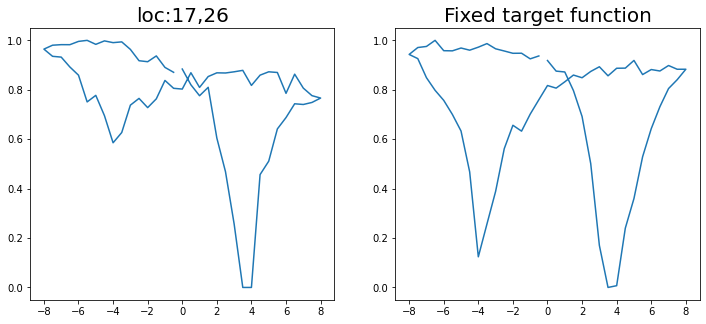

Epoch 1/200 ... Training loss: 3.7611
Epoch 10/200 ... Training loss: 3.0635
Epoch 20/200 ... Training loss: 2.6834
Epoch 30/200 ... Training loss: 2.1597
Epoch 40/200 ... Training loss: 1.8565
Epoch 50/200 ... Training loss: 1.5305
Epoch 60/200 ... Training loss: 1.413
Epoch 70/200 ... Training loss: 1.3358
Epoch 80/200 ... Training loss: 1.2585
Epoch 90/200 ... Training loss: 1.2091
Epoch 100/200 ... Training loss: 1.1813
Epoch 110/200 ... Training loss: 1.1341
Epoch 120/200 ... Training loss: 1.0933
Epoch 130/200 ... Training loss: 1.0816
Epoch 140/200 ... Training loss: 1.0722
Epoch 150/200 ... Training loss: 0.9964
Epoch 160/200 ... Training loss: 1.0125
Epoch 170/200 ... Training loss: 0.9914
Epoch 180/200 ... Training loss: 0.9332
Epoch 190/200 ... Training loss: 0.8754
Epoch 200/200 ... Training loss: 0.8777
step:  52
Sample #62




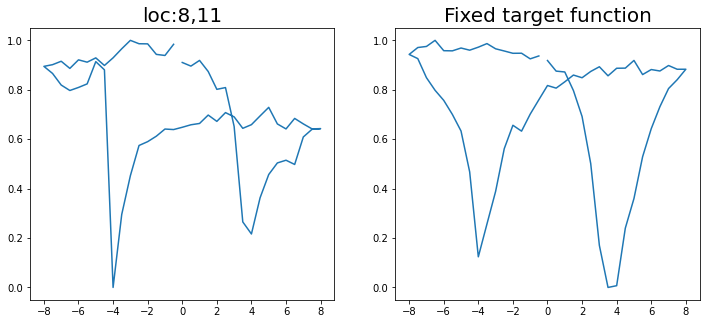

Epoch 1/200 ... Training loss: 3.7346
Epoch 10/200 ... Training loss: 3.0897
Epoch 20/200 ... Training loss: 2.686
Epoch 30/200 ... Training loss: 2.2981
Epoch 40/200 ... Training loss: 1.9678
Epoch 50/200 ... Training loss: 1.6445
Epoch 60/200 ... Training loss: 1.5229
Epoch 70/200 ... Training loss: 1.3707
Epoch 80/200 ... Training loss: 1.3487
Epoch 90/200 ... Training loss: 1.2409
Epoch 100/200 ... Training loss: 1.3815
Epoch 110/200 ... Training loss: 1.2052
Epoch 120/200 ... Training loss: 1.1537
Epoch 130/200 ... Training loss: 1.1022
Epoch 140/200 ... Training loss: 1.0632
Epoch 150/200 ... Training loss: 1.0409
Epoch 160/200 ... Training loss: 1.0119
Epoch 170/200 ... Training loss: 0.9632
Epoch 180/200 ... Training loss: 0.9594
Epoch 190/200 ... Training loss: 1.0225
Epoch 200/200 ... Training loss: 0.9485
step:  53
Sample #63




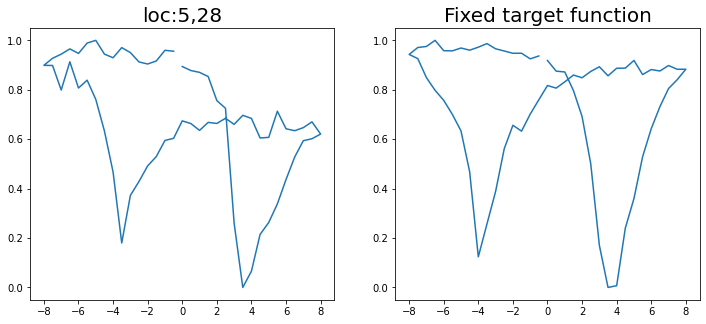

Epoch 1/200 ... Training loss: 3.689
Epoch 10/200 ... Training loss: 3.0885
Epoch 20/200 ... Training loss: 2.596
Epoch 30/200 ... Training loss: 2.1857
Epoch 40/200 ... Training loss: 1.9515
Epoch 50/200 ... Training loss: 1.6792
Epoch 60/200 ... Training loss: 1.4496
Epoch 70/200 ... Training loss: 1.3412
Epoch 80/200 ... Training loss: 1.2881
Epoch 90/200 ... Training loss: 1.2311
Epoch 100/200 ... Training loss: 1.2142
Epoch 110/200 ... Training loss: 1.1828
Epoch 120/200 ... Training loss: 1.1255
Epoch 130/200 ... Training loss: 1.0844
Epoch 140/200 ... Training loss: 1.0466
Epoch 150/200 ... Training loss: 1.0155
Epoch 160/200 ... Training loss: 0.9754
Epoch 170/200 ... Training loss: 0.9866
Epoch 180/200 ... Training loss: 0.9275
Epoch 190/200 ... Training loss: 0.8894
Epoch 200/200 ... Training loss: 1.0379
step:  54
Sample #64




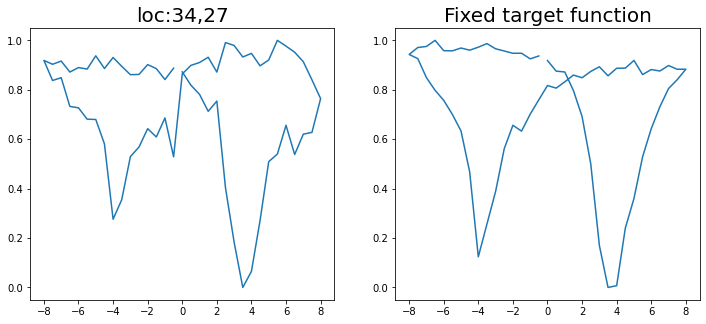

Epoch 1/200 ... Training loss: 3.6603
Epoch 10/200 ... Training loss: 2.9117
Epoch 20/200 ... Training loss: 2.4932
Epoch 30/200 ... Training loss: 2.0758
Epoch 40/200 ... Training loss: 1.7916
Epoch 50/200 ... Training loss: 1.5044
Epoch 60/200 ... Training loss: 1.4292
Epoch 70/200 ... Training loss: 1.3117
Epoch 80/200 ... Training loss: 1.2485
Epoch 90/200 ... Training loss: 1.1911
Epoch 100/200 ... Training loss: 1.1706
Epoch 110/200 ... Training loss: 1.1214
Epoch 120/200 ... Training loss: 1.0862
Epoch 130/200 ... Training loss: 1.0456
Epoch 140/200 ... Training loss: 1.0089
Epoch 150/200 ... Training loss: 1.0338
Epoch 160/200 ... Training loss: 0.9461
Epoch 170/200 ... Training loss: 0.9164
Epoch 180/200 ... Training loss: 0.8739
Epoch 190/200 ... Training loss: 0.865
Epoch 200/200 ... Training loss: 0.8528
step:  55
Sample #65




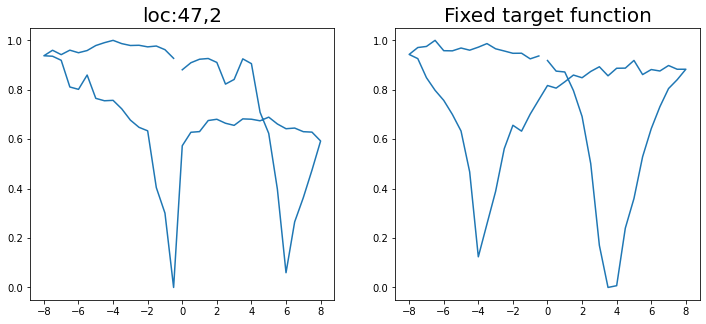

Epoch 1/200 ... Training loss: 3.6907
Epoch 10/200 ... Training loss: 2.9046
Epoch 20/200 ... Training loss: 2.4129
Epoch 30/200 ... Training loss: 2.0168
Epoch 40/200 ... Training loss: 1.6222
Epoch 50/200 ... Training loss: 1.4743
Epoch 60/200 ... Training loss: 1.3438
Epoch 70/200 ... Training loss: 1.2733
Epoch 80/200 ... Training loss: 1.2527
Epoch 90/200 ... Training loss: 1.1988
Epoch 100/200 ... Training loss: 1.1515
Epoch 110/200 ... Training loss: 1.0956
Epoch 120/200 ... Training loss: 1.0622
Epoch 130/200 ... Training loss: 1.0602
Epoch 140/200 ... Training loss: 0.9942
Epoch 150/200 ... Training loss: 1.0499
Epoch 160/200 ... Training loss: 0.9261
Epoch 170/200 ... Training loss: 0.886
Epoch 180/200 ... Training loss: 0.8364
Epoch 190/200 ... Training loss: 0.8256
Epoch 200/200 ... Training loss: 0.7716
step:  56
Sample #66




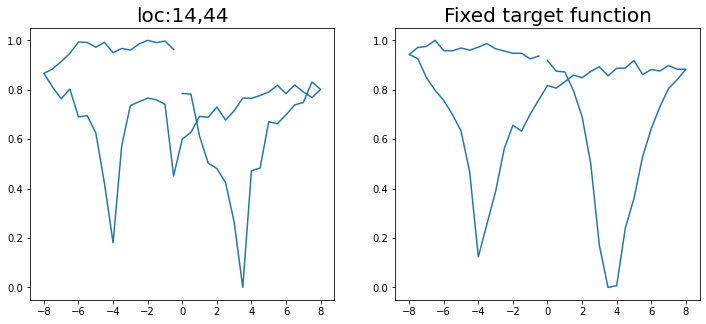

Epoch 1/200 ... Training loss: 3.6485
Epoch 10/200 ... Training loss: 2.8766
Epoch 20/200 ... Training loss: 2.3879
Epoch 30/200 ... Training loss: 2.2083
Epoch 40/200 ... Training loss: 1.7365
Epoch 50/200 ... Training loss: 1.5144
Epoch 60/200 ... Training loss: 1.367
Epoch 70/200 ... Training loss: 1.313
Epoch 80/200 ... Training loss: 1.223
Epoch 90/200 ... Training loss: 1.1787
Epoch 100/200 ... Training loss: 1.1306
Epoch 110/200 ... Training loss: 1.0934
Epoch 120/200 ... Training loss: 1.0492
Epoch 130/200 ... Training loss: 1.1907
Epoch 140/200 ... Training loss: 1.0251
Epoch 150/200 ... Training loss: 0.9831
Epoch 160/200 ... Training loss: 0.9229
Epoch 170/200 ... Training loss: 0.8958
Epoch 180/200 ... Training loss: 0.8642
Epoch 190/200 ... Training loss: 0.8151
Epoch 200/200 ... Training loss: 0.7863
step:  57
Sample #67




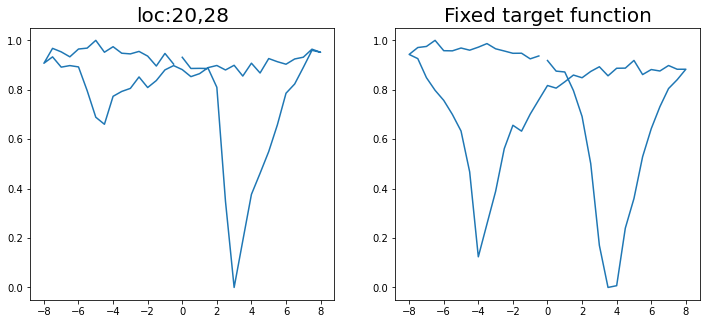

Epoch 1/200 ... Training loss: 3.6078
Epoch 10/200 ... Training loss: 2.9461
Epoch 20/200 ... Training loss: 2.5204
Epoch 30/200 ... Training loss: 2.0561
Epoch 40/200 ... Training loss: 1.9188
Epoch 50/200 ... Training loss: 1.5771
Epoch 60/200 ... Training loss: 1.4046
Epoch 70/200 ... Training loss: 1.3058
Epoch 80/200 ... Training loss: 1.3082
Epoch 90/200 ... Training loss: 1.244
Epoch 100/200 ... Training loss: 1.1647
Epoch 110/200 ... Training loss: 1.1129
Epoch 120/200 ... Training loss: 1.088
Epoch 130/200 ... Training loss: 1.0531
Epoch 140/200 ... Training loss: 1.0008
Epoch 150/200 ... Training loss: 0.9899
Epoch 160/200 ... Training loss: 0.9583
Epoch 170/200 ... Training loss: 0.913
Epoch 180/200 ... Training loss: 0.8684
Epoch 190/200 ... Training loss: 0.9644
Epoch 200/200 ... Training loss: 0.8625
step:  58
Sample #68




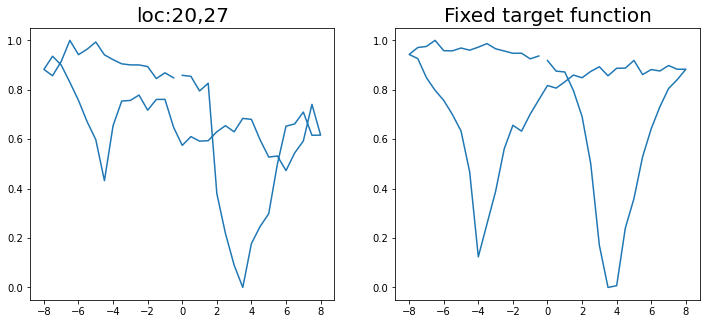

Epoch 1/200 ... Training loss: 3.5944
Epoch 10/200 ... Training loss: 3.0309
Epoch 20/200 ... Training loss: 2.6103
Epoch 30/200 ... Training loss: 2.0149
Epoch 40/200 ... Training loss: 1.6887
Epoch 50/200 ... Training loss: 1.8966
Epoch 60/200 ... Training loss: 1.5266
Epoch 70/200 ... Training loss: 1.4076
Epoch 80/200 ... Training loss: 1.3233
Epoch 90/200 ... Training loss: 1.2648
Epoch 100/200 ... Training loss: 1.2084
Epoch 110/200 ... Training loss: 1.1473
Epoch 120/200 ... Training loss: 1.0999
Epoch 130/200 ... Training loss: 1.0576
Epoch 140/200 ... Training loss: 1.042
Epoch 150/200 ... Training loss: 1.0321
Epoch 160/200 ... Training loss: 0.9513
Epoch 170/200 ... Training loss: 0.9131
Epoch 180/200 ... Training loss: 0.8712
Epoch 190/200 ... Training loss: 0.8499
Epoch 200/200 ... Training loss: 0.8103
step:  59
Sample #69




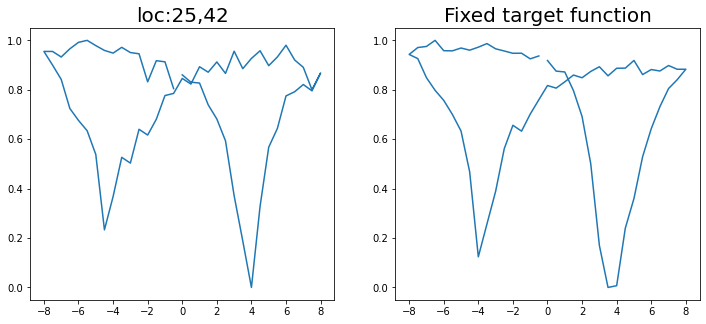

Epoch 1/200 ... Training loss: 3.5649
Epoch 10/200 ... Training loss: 3.1787
Epoch 20/200 ... Training loss: 2.6605
Epoch 30/200 ... Training loss: 2.3501
Epoch 40/200 ... Training loss: 1.7789
Epoch 50/200 ... Training loss: 1.6908
Epoch 60/200 ... Training loss: 1.471
Epoch 70/200 ... Training loss: 1.393
Epoch 80/200 ... Training loss: 1.3226
Epoch 90/200 ... Training loss: 1.2653
Epoch 100/200 ... Training loss: 1.2811
Epoch 110/200 ... Training loss: 1.3122
Epoch 120/200 ... Training loss: 1.2298
Epoch 130/200 ... Training loss: 1.177
Epoch 140/200 ... Training loss: 1.1444
Epoch 150/200 ... Training loss: 1.1107
Epoch 160/200 ... Training loss: 1.0988
Epoch 170/200 ... Training loss: 1.0722
Epoch 180/200 ... Training loss: 1.0045
Epoch 190/200 ... Training loss: 0.9695
Epoch 200/200 ... Training loss: 0.9097
step:  60
Sample #70




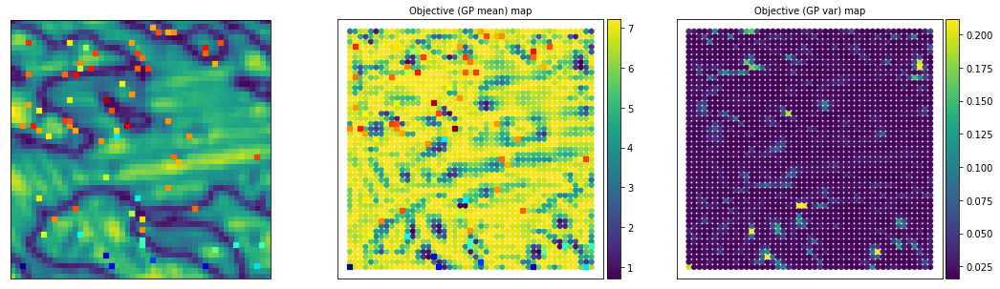

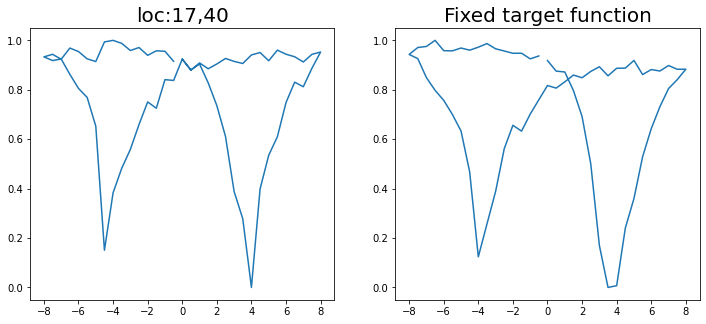

Epoch 1/200 ... Training loss: 3.5599
Epoch 10/200 ... Training loss: 2.9025
Epoch 20/200 ... Training loss: 2.5849
Epoch 30/200 ... Training loss: 2.1067
Epoch 40/200 ... Training loss: 1.6865
Epoch 50/200 ... Training loss: 1.4567
Epoch 60/200 ... Training loss: 1.355
Epoch 70/200 ... Training loss: 1.2669
Epoch 80/200 ... Training loss: 1.2163
Epoch 90/200 ... Training loss: 1.168
Epoch 100/200 ... Training loss: 1.1475
Epoch 110/200 ... Training loss: 1.3692
Epoch 120/200 ... Training loss: 1.1738
Epoch 130/200 ... Training loss: 1.1571
Epoch 140/200 ... Training loss: 1.4993
Epoch 150/200 ... Training loss: 1.0948
Epoch 160/200 ... Training loss: 0.9859
Epoch 170/200 ... Training loss: 0.926
Epoch 180/200 ... Training loss: 0.8762
Epoch 190/200 ... Training loss: 0.8581
Epoch 200/200 ... Training loss: 0.8083
step:  61
Sample #71




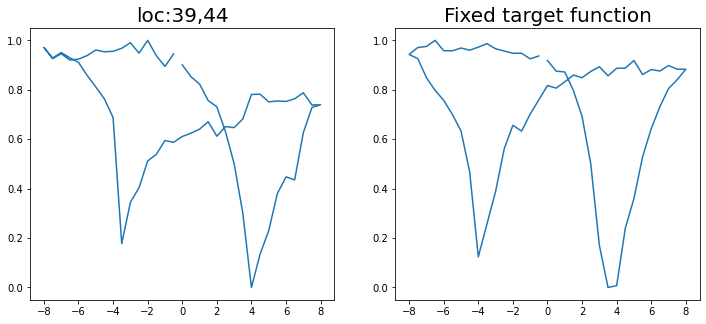

Epoch 1/200 ... Training loss: 3.5206
Epoch 10/200 ... Training loss: 2.8315
Epoch 20/200 ... Training loss: 2.4275
Epoch 30/200 ... Training loss: 1.866
Epoch 40/200 ... Training loss: 1.7144
Epoch 50/200 ... Training loss: 1.4913
Epoch 60/200 ... Training loss: 1.3383
Epoch 70/200 ... Training loss: 1.2443
Epoch 80/200 ... Training loss: 1.1894
Epoch 90/200 ... Training loss: 1.1806
Epoch 100/200 ... Training loss: 1.1274
Epoch 110/200 ... Training loss: 1.0715
Epoch 120/200 ... Training loss: 1.0206
Epoch 130/200 ... Training loss: 0.9843
Epoch 140/200 ... Training loss: 0.9629
Epoch 150/200 ... Training loss: 0.9202
Epoch 160/200 ... Training loss: 0.8812
Epoch 170/200 ... Training loss: 0.8885
Epoch 180/200 ... Training loss: 0.8163
Epoch 190/200 ... Training loss: 0.8171
Epoch 200/200 ... Training loss: 0.7339
step:  62
Sample #72




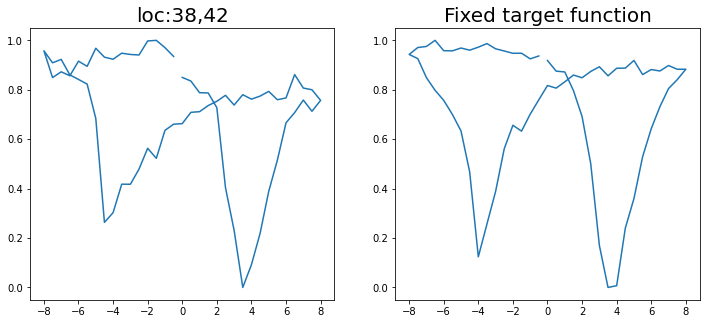

Epoch 1/200 ... Training loss: 3.4873
Epoch 10/200 ... Training loss: 2.8427
Epoch 20/200 ... Training loss: 2.4528
Epoch 30/200 ... Training loss: 2.0546
Epoch 40/200 ... Training loss: 1.7049
Epoch 50/200 ... Training loss: 1.6087
Epoch 60/200 ... Training loss: 1.3985
Epoch 70/200 ... Training loss: 1.3363
Epoch 80/200 ... Training loss: 1.2819
Epoch 90/200 ... Training loss: 1.2078
Epoch 100/200 ... Training loss: 1.152
Epoch 110/200 ... Training loss: 1.1026
Epoch 120/200 ... Training loss: 1.0577
Epoch 130/200 ... Training loss: 1.1906
Epoch 140/200 ... Training loss: 1.0642
Epoch 150/200 ... Training loss: 0.9758
Epoch 160/200 ... Training loss: 0.9286
Epoch 170/200 ... Training loss: 0.8962
Epoch 180/200 ... Training loss: 0.8468
Epoch 190/200 ... Training loss: 0.7993
Epoch 200/200 ... Training loss: 0.797
step:  63
Sample #73




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


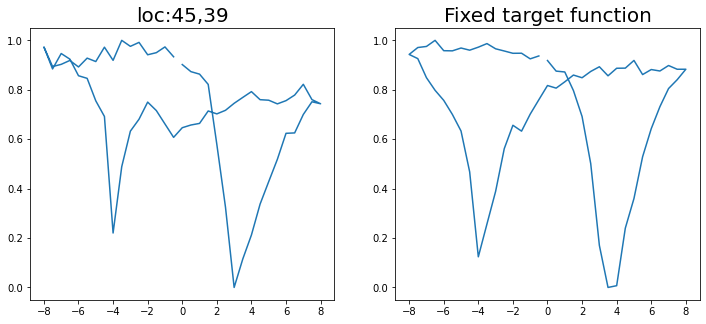

Epoch 1/200 ... Training loss: 3.4505
Epoch 10/200 ... Training loss: 3.1333
Epoch 20/200 ... Training loss: 2.8628
Epoch 30/200 ... Training loss: 2.518
Epoch 40/200 ... Training loss: 2.1868
Epoch 50/200 ... Training loss: 1.7697
Epoch 60/200 ... Training loss: 1.5281
Epoch 70/200 ... Training loss: 1.3962
Epoch 80/200 ... Training loss: 1.3164
Epoch 90/200 ... Training loss: 1.4981
Epoch 100/200 ... Training loss: 1.3192
Epoch 110/200 ... Training loss: 1.231
Epoch 120/200 ... Training loss: 1.1726
Epoch 130/200 ... Training loss: 1.1773
Epoch 140/200 ... Training loss: 1.2572
Epoch 150/200 ... Training loss: 1.1675
Epoch 160/200 ... Training loss: 1.0988
Epoch 170/200 ... Training loss: 1.0493
Epoch 180/200 ... Training loss: 0.9937
Epoch 190/200 ... Training loss: 0.9561
Epoch 200/200 ... Training loss: 0.9226
step:  64
Sample #74




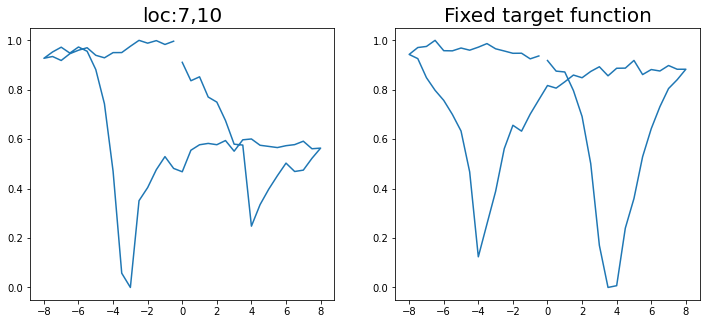

Epoch 1/200 ... Training loss: 3.4207
Epoch 10/200 ... Training loss: 2.9657
Epoch 20/200 ... Training loss: 2.5106
Epoch 30/200 ... Training loss: 2.0579
Epoch 40/200 ... Training loss: 1.6664
Epoch 50/200 ... Training loss: 1.5635
Epoch 60/200 ... Training loss: 1.3725
Epoch 70/200 ... Training loss: 1.297
Epoch 80/200 ... Training loss: 1.2238
Epoch 90/200 ... Training loss: 1.1842
Epoch 100/200 ... Training loss: 1.1349
Epoch 110/200 ... Training loss: 1.102
Epoch 120/200 ... Training loss: 1.0634
Epoch 130/200 ... Training loss: 1.0206
Epoch 140/200 ... Training loss: 0.9941
Epoch 150/200 ... Training loss: 0.9639
Epoch 160/200 ... Training loss: 0.9009
Epoch 170/200 ... Training loss: 0.8848
Epoch 180/200 ... Training loss: 0.8422
Epoch 190/200 ... Training loss: 0.7963
Epoch 200/200 ... Training loss: 0.7871
step:  65
Sample #75




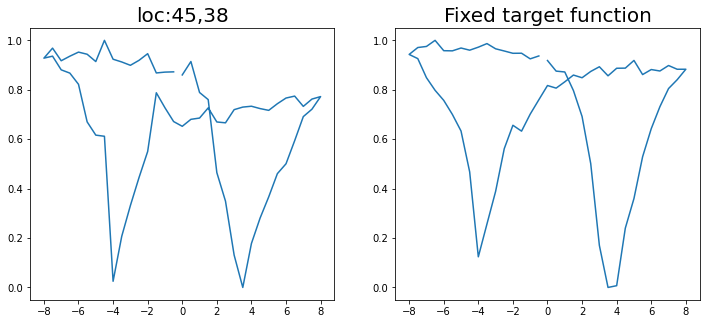

Epoch 1/200 ... Training loss: 3.3935
Epoch 10/200 ... Training loss: 3.08
Epoch 20/200 ... Training loss: 2.7214
Epoch 30/200 ... Training loss: 2.4401
Epoch 40/200 ... Training loss: 2.1488
Epoch 50/200 ... Training loss: 1.8084
Epoch 60/200 ... Training loss: 1.5346
Epoch 70/200 ... Training loss: 1.4552
Epoch 80/200 ... Training loss: 1.4456
Epoch 90/200 ... Training loss: 1.3149
Epoch 100/200 ... Training loss: 1.2743
Epoch 110/200 ... Training loss: 1.2253
Epoch 120/200 ... Training loss: 1.1518
Epoch 130/200 ... Training loss: 1.104
Epoch 140/200 ... Training loss: 1.0661
Epoch 150/200 ... Training loss: 1.0304
Epoch 160/200 ... Training loss: 0.9983
Epoch 170/200 ... Training loss: 0.98
Epoch 180/200 ... Training loss: 0.9903
Epoch 190/200 ... Training loss: 0.912
Epoch 200/200 ... Training loss: 0.8651
step:  66
Sample #76




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


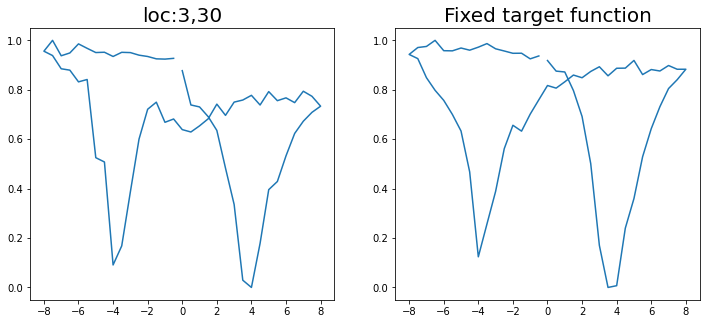

Epoch 1/200 ... Training loss: 3.3815
Epoch 10/200 ... Training loss: 2.8599
Epoch 20/200 ... Training loss: 2.4323
Epoch 30/200 ... Training loss: 1.896
Epoch 40/200 ... Training loss: 1.6094
Epoch 50/200 ... Training loss: 1.4452
Epoch 60/200 ... Training loss: 1.34
Epoch 70/200 ... Training loss: 1.2549
Epoch 80/200 ... Training loss: 1.2001
Epoch 90/200 ... Training loss: 1.1522
Epoch 100/200 ... Training loss: 1.3764
Epoch 110/200 ... Training loss: 1.131
Epoch 120/200 ... Training loss: 1.0544
Epoch 130/200 ... Training loss: 1.0373
Epoch 140/200 ... Training loss: 1.0344
Epoch 150/200 ... Training loss: 0.9838
Epoch 160/200 ... Training loss: 0.9398
Epoch 170/200 ... Training loss: 0.8771
Epoch 180/200 ... Training loss: 0.8383
Epoch 190/200 ... Training loss: 0.8009
Epoch 200/200 ... Training loss: 0.7424
step:  67
Sample #77




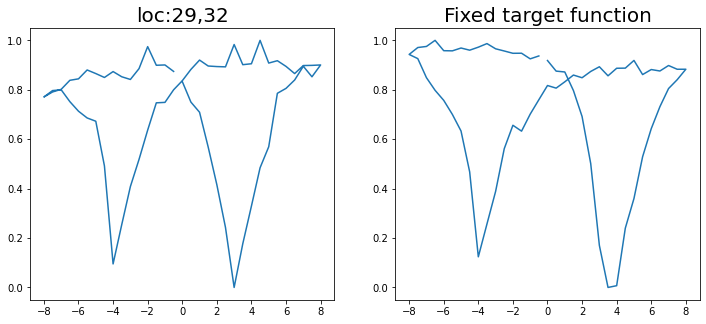

Epoch 1/200 ... Training loss: 3.3497
Epoch 10/200 ... Training loss: 2.7678
Epoch 20/200 ... Training loss: 2.4399
Epoch 30/200 ... Training loss: 1.9548
Epoch 40/200 ... Training loss: 1.6863
Epoch 50/200 ... Training loss: 1.4129
Epoch 60/200 ... Training loss: 1.2959
Epoch 70/200 ... Training loss: 1.2322
Epoch 80/200 ... Training loss: 1.1837
Epoch 90/200 ... Training loss: 1.1576
Epoch 100/200 ... Training loss: 1.095
Epoch 110/200 ... Training loss: 1.0547
Epoch 120/200 ... Training loss: 1.0185
Epoch 130/200 ... Training loss: 0.9852
Epoch 140/200 ... Training loss: 0.9781
Epoch 150/200 ... Training loss: 0.9138
Epoch 160/200 ... Training loss: 0.9547
Epoch 170/200 ... Training loss: 0.8555
Epoch 180/200 ... Training loss: 0.7966
Epoch 190/200 ... Training loss: 0.76
Epoch 200/200 ... Training loss: 0.7192
step:  68
Sample #78




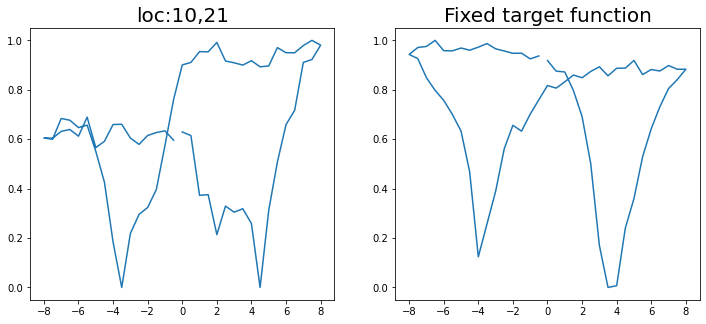

Epoch 1/200 ... Training loss: 3.3296
Epoch 10/200 ... Training loss: 2.9377
Epoch 20/200 ... Training loss: 2.5128
Epoch 30/200 ... Training loss: 2.0126
Epoch 40/200 ... Training loss: 1.7429
Epoch 50/200 ... Training loss: 1.4792
Epoch 60/200 ... Training loss: 1.3576
Epoch 70/200 ... Training loss: 1.3432
Epoch 80/200 ... Training loss: 1.2626
Epoch 90/200 ... Training loss: 1.195
Epoch 100/200 ... Training loss: 1.1494
Epoch 110/200 ... Training loss: 1.1016
Epoch 120/200 ... Training loss: 1.0426
Epoch 130/200 ... Training loss: 1.0071
Epoch 140/200 ... Training loss: 0.9674
Epoch 150/200 ... Training loss: 1.0041
Epoch 160/200 ... Training loss: 0.911
Epoch 170/200 ... Training loss: 0.8704
Epoch 180/200 ... Training loss: 0.8357
Epoch 190/200 ... Training loss: 0.7889
Epoch 200/200 ... Training loss: 0.7491
step:  69
Sample #79




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


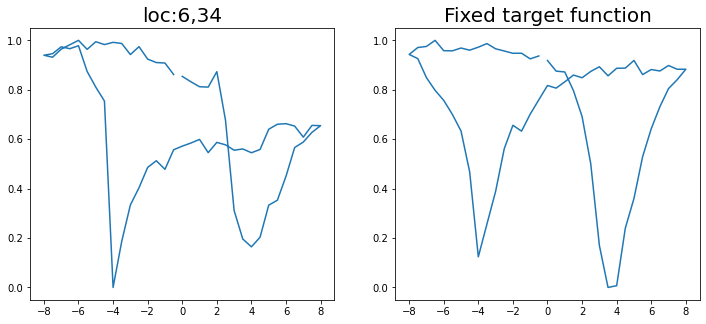

Epoch 1/200 ... Training loss: 3.298
Epoch 10/200 ... Training loss: 2.8037
Epoch 20/200 ... Training loss: 2.4547
Epoch 30/200 ... Training loss: 1.9831
Epoch 40/200 ... Training loss: 1.6103
Epoch 50/200 ... Training loss: 1.611
Epoch 60/200 ... Training loss: 1.402
Epoch 70/200 ... Training loss: 1.3218
Epoch 80/200 ... Training loss: 1.2465
Epoch 90/200 ... Training loss: 1.2539
Epoch 100/200 ... Training loss: 1.1539
Epoch 110/200 ... Training loss: 1.0854
Epoch 120/200 ... Training loss: 1.0553
Epoch 130/200 ... Training loss: 1.0101
Epoch 140/200 ... Training loss: 0.9607
Epoch 150/200 ... Training loss: 0.9598
Epoch 160/200 ... Training loss: 0.9008
Epoch 170/200 ... Training loss: 0.8407
Epoch 180/200 ... Training loss: 0.8245
Epoch 190/200 ... Training loss: 0.7722
Epoch 200/200 ... Training loss: 0.7224
step:  70
Sample #80




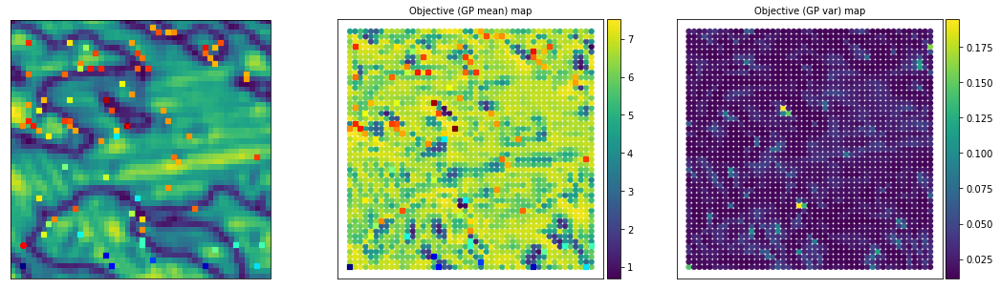

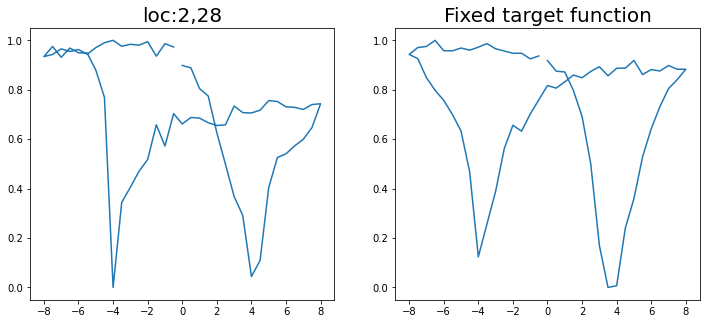

Epoch 1/200 ... Training loss: 3.2701
Epoch 10/200 ... Training loss: 2.9235
Epoch 20/200 ... Training loss: 2.5227
Epoch 30/200 ... Training loss: 2.0867
Epoch 40/200 ... Training loss: 1.7207
Epoch 50/200 ... Training loss: 1.4736
Epoch 60/200 ... Training loss: 1.4021
Epoch 70/200 ... Training loss: 1.3371
Epoch 80/200 ... Training loss: 1.2163
Epoch 90/200 ... Training loss: 1.1573
Epoch 100/200 ... Training loss: 1.1099
Epoch 110/200 ... Training loss: 1.0798
Epoch 120/200 ... Training loss: 1.1453
Epoch 130/200 ... Training loss: 1.0379
Epoch 140/200 ... Training loss: 0.973
Epoch 150/200 ... Training loss: 0.9225
Epoch 160/200 ... Training loss: 1.2211
Epoch 170/200 ... Training loss: 0.9282
Epoch 180/200 ... Training loss: 0.8499
Epoch 190/200 ... Training loss: 0.8061
Epoch 200/200 ... Training loss: 0.752
step:  71
Sample #81




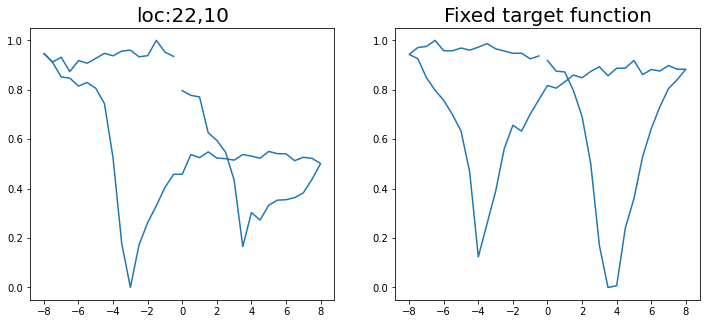

Epoch 1/200 ... Training loss: 3.2393
Epoch 10/200 ... Training loss: 2.8455
Epoch 20/200 ... Training loss: 2.4636
Epoch 30/200 ... Training loss: 2.0479
Epoch 40/200 ... Training loss: 1.7656
Epoch 50/200 ... Training loss: 1.652
Epoch 60/200 ... Training loss: 1.3913
Epoch 70/200 ... Training loss: 1.3385
Epoch 80/200 ... Training loss: 1.2472
Epoch 90/200 ... Training loss: 1.194
Epoch 100/200 ... Training loss: 1.2793
Epoch 110/200 ... Training loss: 1.2289
Epoch 120/200 ... Training loss: 1.1167
Epoch 130/200 ... Training loss: 1.0236
Epoch 140/200 ... Training loss: 0.9737
Epoch 150/200 ... Training loss: 1.0794
Epoch 160/200 ... Training loss: 0.9312
Epoch 170/200 ... Training loss: 0.8842
Epoch 180/200 ... Training loss: 0.881
Epoch 190/200 ... Training loss: 0.7987
Epoch 200/200 ... Training loss: 0.8278
step:  72
Sample #82




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


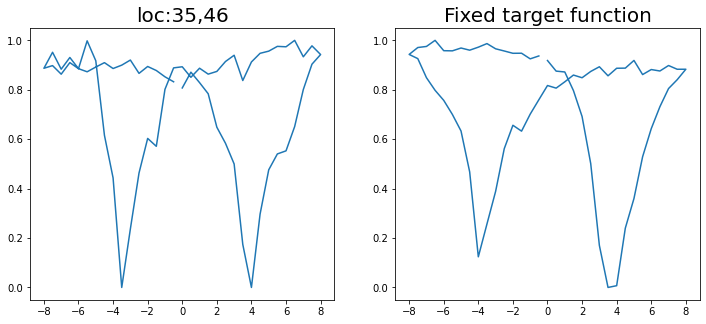

Epoch 1/200 ... Training loss: 3.2129
Epoch 10/200 ... Training loss: 2.8943
Epoch 20/200 ... Training loss: 2.4816
Epoch 30/200 ... Training loss: 2.2772
Epoch 40/200 ... Training loss: 1.8838
Epoch 50/200 ... Training loss: 1.6896
Epoch 60/200 ... Training loss: 1.4772
Epoch 70/200 ... Training loss: 1.3646
Epoch 80/200 ... Training loss: 1.3185
Epoch 90/200 ... Training loss: 1.2429
Epoch 100/200 ... Training loss: 1.1767
Epoch 110/200 ... Training loss: 1.1258
Epoch 120/200 ... Training loss: 1.0757
Epoch 130/200 ... Training loss: 1.0385
Epoch 140/200 ... Training loss: 0.9951
Epoch 150/200 ... Training loss: 0.9626
Epoch 160/200 ... Training loss: 0.9239
Epoch 170/200 ... Training loss: 0.8907
Epoch 180/200 ... Training loss: 0.8601
Epoch 190/200 ... Training loss: 0.8109
Epoch 200/200 ... Training loss: 0.7822
step:  73
Sample #83




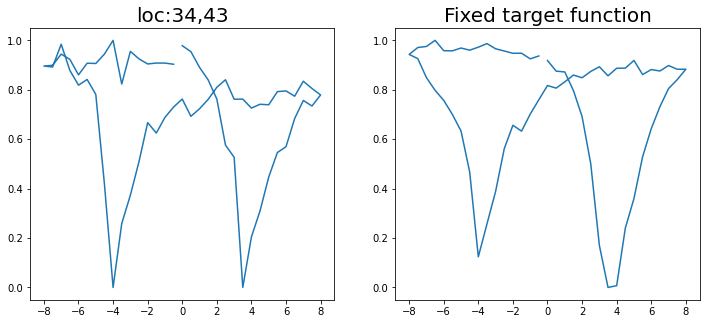

Epoch 1/200 ... Training loss: 3.1838
Epoch 10/200 ... Training loss: 2.6633
Epoch 20/200 ... Training loss: 2.4062
Epoch 30/200 ... Training loss: 2.0786
Epoch 40/200 ... Training loss: 1.7181
Epoch 50/200 ... Training loss: 1.4405
Epoch 60/200 ... Training loss: 1.3966
Epoch 70/200 ... Training loss: 1.3345
Epoch 80/200 ... Training loss: 1.2686
Epoch 90/200 ... Training loss: 1.2209
Epoch 100/200 ... Training loss: 1.1633
Epoch 110/200 ... Training loss: 1.155
Epoch 120/200 ... Training loss: 1.0614
Epoch 130/200 ... Training loss: 1.017
Epoch 140/200 ... Training loss: 0.9676
Epoch 150/200 ... Training loss: 0.9264
Epoch 160/200 ... Training loss: 0.9102
Epoch 170/200 ... Training loss: 0.8635
Epoch 180/200 ... Training loss: 0.8105
Epoch 190/200 ... Training loss: 0.7804
Epoch 200/200 ... Training loss: 0.7315
step:  74
Sample #84




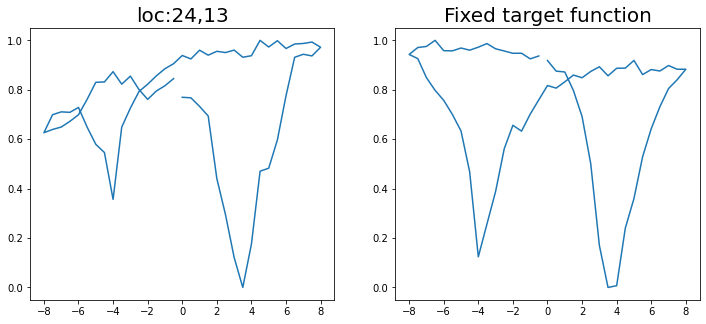

Epoch 1/200 ... Training loss: 3.1549
Epoch 10/200 ... Training loss: 2.6568
Epoch 20/200 ... Training loss: 2.3783
Epoch 30/200 ... Training loss: 1.9941
Epoch 40/200 ... Training loss: 1.5988
Epoch 50/200 ... Training loss: 1.5831
Epoch 60/200 ... Training loss: 1.4125
Epoch 70/200 ... Training loss: 1.3437
Epoch 80/200 ... Training loss: 1.2795
Epoch 90/200 ... Training loss: 1.2336
Epoch 100/200 ... Training loss: 1.2339
Epoch 110/200 ... Training loss: 1.1871
Epoch 120/200 ... Training loss: 1.1139
Epoch 130/200 ... Training loss: 1.0315
Epoch 140/200 ... Training loss: 0.9902
Epoch 150/200 ... Training loss: 0.9508
Epoch 160/200 ... Training loss: 1.1789
Epoch 170/200 ... Training loss: 0.9463
Epoch 180/200 ... Training loss: 0.8571
Epoch 190/200 ... Training loss: 0.7974
Epoch 200/200 ... Training loss: 0.7636
step:  75
Sample #85




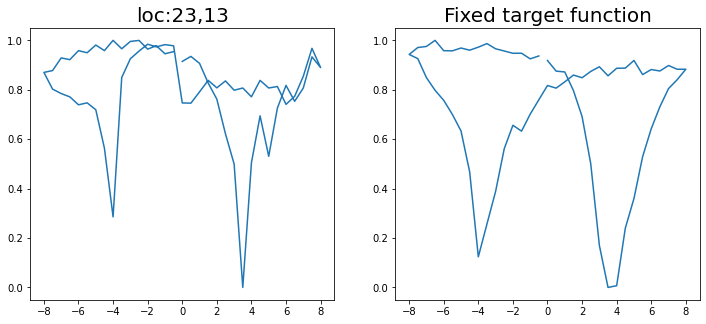

Epoch 1/200 ... Training loss: 3.1433
Epoch 10/200 ... Training loss: 2.6149
Epoch 20/200 ... Training loss: 2.3614
Epoch 30/200 ... Training loss: 1.8956
Epoch 40/200 ... Training loss: 1.8243
Epoch 50/200 ... Training loss: 1.5339
Epoch 60/200 ... Training loss: 1.5078
Epoch 70/200 ... Training loss: 1.32
Epoch 80/200 ... Training loss: 1.2578
Epoch 90/200 ... Training loss: 1.2012
Epoch 100/200 ... Training loss: 1.138
Epoch 110/200 ... Training loss: 1.0862
Epoch 120/200 ... Training loss: 1.041
Epoch 130/200 ... Training loss: 0.9914
Epoch 140/200 ... Training loss: 0.9416
Epoch 150/200 ... Training loss: 0.9171
Epoch 160/200 ... Training loss: 0.8755
Epoch 170/200 ... Training loss: 0.8312
Epoch 180/200 ... Training loss: 0.7799
Epoch 190/200 ... Training loss: 0.9287
Epoch 200/200 ... Training loss: 0.7609
step:  76
Sample #86




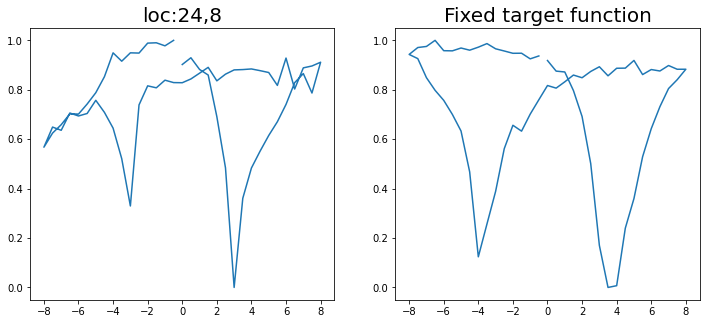

Epoch 1/200 ... Training loss: 3.1315
Epoch 10/200 ... Training loss: 2.8062
Epoch 20/200 ... Training loss: 2.4226
Epoch 30/200 ... Training loss: 2.1794
Epoch 40/200 ... Training loss: 1.7267
Epoch 50/200 ... Training loss: 1.6142
Epoch 60/200 ... Training loss: 1.4523
Epoch 70/200 ... Training loss: 1.3404
Epoch 80/200 ... Training loss: 1.3356
Epoch 90/200 ... Training loss: 1.3232
Epoch 100/200 ... Training loss: 1.2361
Epoch 110/200 ... Training loss: 1.1793
Epoch 120/200 ... Training loss: 1.12
Epoch 130/200 ... Training loss: 1.1414
Epoch 140/200 ... Training loss: 1.0726
Epoch 150/200 ... Training loss: 0.988
Epoch 160/200 ... Training loss: 0.9397
Epoch 170/200 ... Training loss: 1.129
Epoch 180/200 ... Training loss: 0.9647
Epoch 190/200 ... Training loss: 0.8585
Epoch 200/200 ... Training loss: 0.8051
step:  77
Sample #87




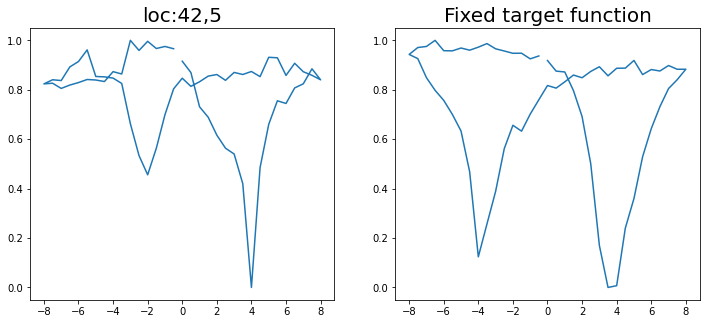

Epoch 1/200 ... Training loss: 3.1425
Epoch 10/200 ... Training loss: 2.69
Epoch 20/200 ... Training loss: 2.384
Epoch 30/200 ... Training loss: 2.1367
Epoch 40/200 ... Training loss: 1.6962
Epoch 50/200 ... Training loss: 1.7124
Epoch 60/200 ... Training loss: 1.4398
Epoch 70/200 ... Training loss: 1.3372
Epoch 80/200 ... Training loss: 1.2636
Epoch 90/200 ... Training loss: 1.2303
Epoch 100/200 ... Training loss: 1.1907
Epoch 110/200 ... Training loss: 1.1596
Epoch 120/200 ... Training loss: 1.1209
Epoch 130/200 ... Training loss: 1.0738
Epoch 140/200 ... Training loss: 1.0617
Epoch 150/200 ... Training loss: 1.0583
Epoch 160/200 ... Training loss: 0.9624
Epoch 170/200 ... Training loss: 0.8982
Epoch 180/200 ... Training loss: 0.8587
Epoch 190/200 ... Training loss: 0.8178
Epoch 200/200 ... Training loss: 0.7849
step:  78
Sample #88




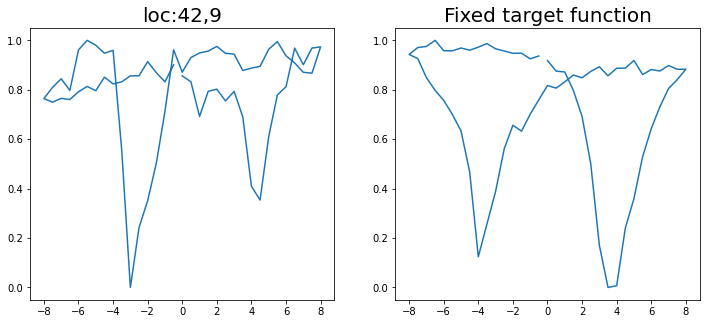

Epoch 1/200 ... Training loss: 3.2414
Epoch 10/200 ... Training loss: 2.7246
Epoch 20/200 ... Training loss: 2.4235
Epoch 30/200 ... Training loss: 2.0224
Epoch 40/200 ... Training loss: 1.5934
Epoch 50/200 ... Training loss: 1.6123
Epoch 60/200 ... Training loss: 1.4531
Epoch 70/200 ... Training loss: 1.3692
Epoch 80/200 ... Training loss: 1.2786
Epoch 90/200 ... Training loss: 1.1856
Epoch 100/200 ... Training loss: 1.1566
Epoch 110/200 ... Training loss: 1.096
Epoch 120/200 ... Training loss: 1.0565
Epoch 130/200 ... Training loss: 1.1019
Epoch 140/200 ... Training loss: 1.0713
Epoch 150/200 ... Training loss: 0.9798
Epoch 160/200 ... Training loss: 0.9072
Epoch 170/200 ... Training loss: 0.8615
Epoch 180/200 ... Training loss: 0.8346
Epoch 190/200 ... Training loss: 0.8286
Epoch 200/200 ... Training loss: 0.7531
step:  79
Sample #89




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


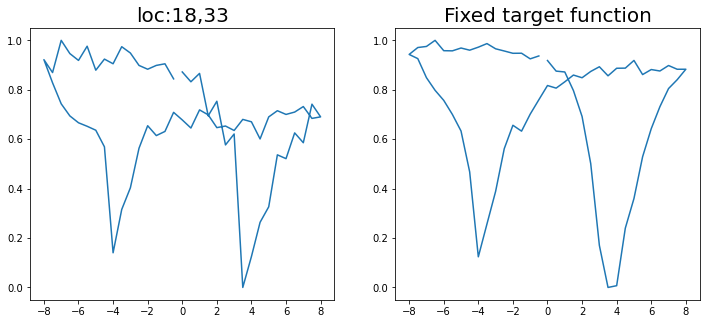

Epoch 1/200 ... Training loss: 3.2145
Epoch 10/200 ... Training loss: 2.6614
Epoch 20/200 ... Training loss: 2.4004
Epoch 30/200 ... Training loss: 1.9438
Epoch 40/200 ... Training loss: 1.5881
Epoch 50/200 ... Training loss: 1.5376
Epoch 60/200 ... Training loss: 1.4253
Epoch 70/200 ... Training loss: 1.326
Epoch 80/200 ... Training loss: 1.3478
Epoch 90/200 ... Training loss: 1.1825
Epoch 100/200 ... Training loss: 1.1995
Epoch 110/200 ... Training loss: 1.1045
Epoch 120/200 ... Training loss: 1.0388
Epoch 130/200 ... Training loss: 1.0117
Epoch 140/200 ... Training loss: 1.0351
Epoch 150/200 ... Training loss: 0.9672
Epoch 160/200 ... Training loss: 0.9012
Epoch 170/200 ... Training loss: 0.8609
Epoch 180/200 ... Training loss: 0.8109
Epoch 190/200 ... Training loss: 0.7916
Epoch 200/200 ... Training loss: 0.7835
step:  80
Sample #90




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


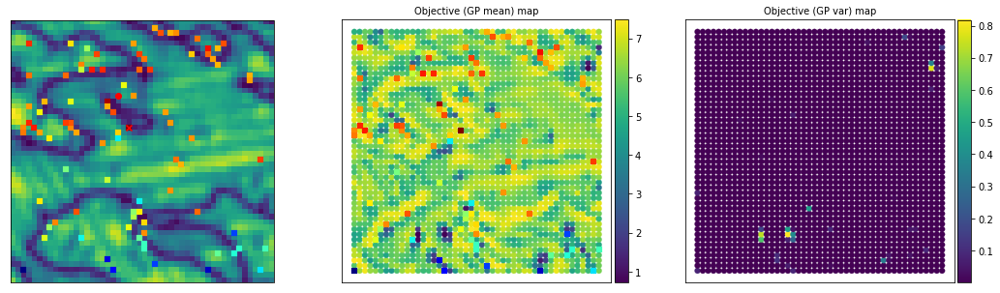

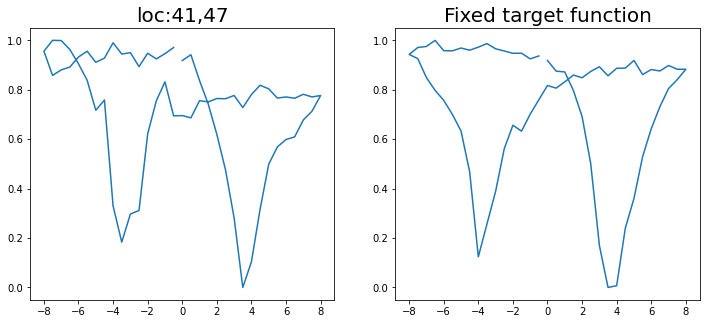

Epoch 1/200 ... Training loss: 3.1928
Epoch 10/200 ... Training loss: 2.6354
Epoch 20/200 ... Training loss: 2.2871
Epoch 30/200 ... Training loss: 1.8133
Epoch 40/200 ... Training loss: 1.6105
Epoch 50/200 ... Training loss: 1.3963
Epoch 60/200 ... Training loss: 1.3339
Epoch 70/200 ... Training loss: 1.2621
Epoch 80/200 ... Training loss: 1.1739
Epoch 90/200 ... Training loss: 1.1678
Epoch 100/200 ... Training loss: 1.1406
Epoch 110/200 ... Training loss: 1.0608
Epoch 120/200 ... Training loss: 1.0247
Epoch 130/200 ... Training loss: 0.9767
Epoch 140/200 ... Training loss: 0.926
Epoch 150/200 ... Training loss: 0.8797
Epoch 160/200 ... Training loss: 0.9145
Epoch 170/200 ... Training loss: 0.8283
Epoch 180/200 ... Training loss: 0.8063
Epoch 190/200 ... Training loss: 0.7242
Epoch 200/200 ... Training loss: 0.722
step:  81
Sample #91




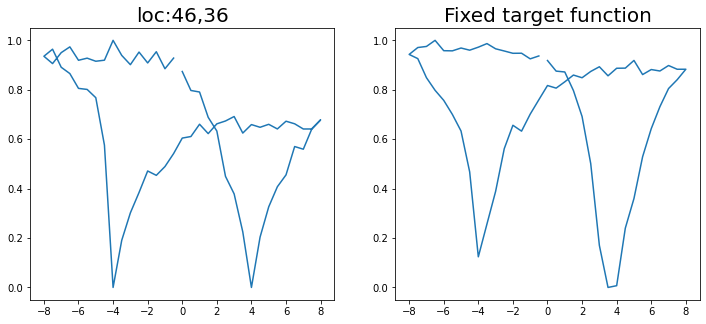

Epoch 1/200 ... Training loss: 3.2064
Epoch 10/200 ... Training loss: 2.8077
Epoch 20/200 ... Training loss: 2.4157
Epoch 30/200 ... Training loss: 2.0521
Epoch 40/200 ... Training loss: 1.6786
Epoch 50/200 ... Training loss: 1.4784
Epoch 60/200 ... Training loss: 1.3459
Epoch 70/200 ... Training loss: 1.3304
Epoch 80/200 ... Training loss: 1.2601
Epoch 90/200 ... Training loss: 1.2008
Epoch 100/200 ... Training loss: 1.1561
Epoch 110/200 ... Training loss: 1.0993
Epoch 120/200 ... Training loss: 1.068
Epoch 130/200 ... Training loss: 1.0195
Epoch 140/200 ... Training loss: 1.0478
Epoch 150/200 ... Training loss: 0.9824
Epoch 160/200 ... Training loss: 0.9188
Epoch 170/200 ... Training loss: 0.8715
Epoch 180/200 ... Training loss: 0.8178
Epoch 190/200 ... Training loss: 0.9534
Epoch 200/200 ... Training loss: 0.8013
step:  82
Sample #92




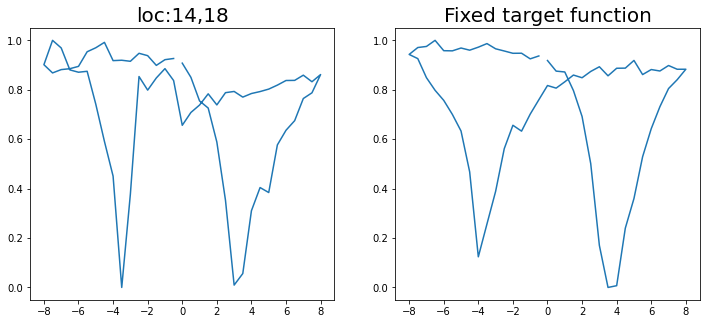

Epoch 1/200 ... Training loss: 3.1838
Epoch 10/200 ... Training loss: 2.7421
Epoch 20/200 ... Training loss: 2.3803
Epoch 30/200 ... Training loss: 1.8859
Epoch 40/200 ... Training loss: 1.597
Epoch 50/200 ... Training loss: 1.4019
Epoch 60/200 ... Training loss: 1.3163
Epoch 70/200 ... Training loss: 1.2434
Epoch 80/200 ... Training loss: 1.2259
Epoch 90/200 ... Training loss: 1.2202
Epoch 100/200 ... Training loss: 1.0928
Epoch 110/200 ... Training loss: 1.1275
Epoch 120/200 ... Training loss: 1.0238
Epoch 130/200 ... Training loss: 0.9824
Epoch 140/200 ... Training loss: 0.9303
Epoch 150/200 ... Training loss: 1.1905
Epoch 160/200 ... Training loss: 0.9264
Epoch 170/200 ... Training loss: 0.842
Epoch 180/200 ... Training loss: 0.8237
Epoch 190/200 ... Training loss: 0.7442
Epoch 200/200 ... Training loss: 0.7678
step:  83
Sample #93




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


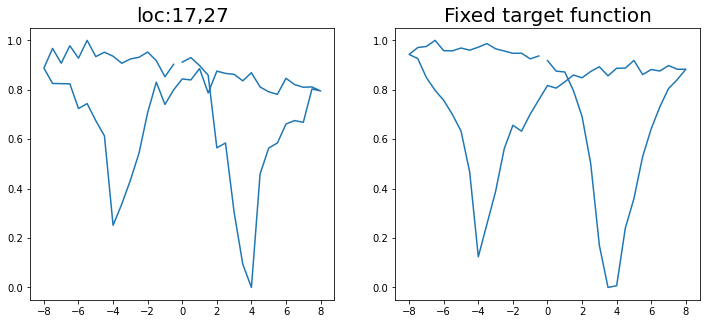

Epoch 1/200 ... Training loss: 3.164
Epoch 10/200 ... Training loss: 2.6718
Epoch 20/200 ... Training loss: 2.3294
Epoch 30/200 ... Training loss: 1.9128
Epoch 40/200 ... Training loss: 1.5796
Epoch 50/200 ... Training loss: 1.5891
Epoch 60/200 ... Training loss: 1.3936
Epoch 70/200 ... Training loss: 1.3052
Epoch 80/200 ... Training loss: 1.4706
Epoch 90/200 ... Training loss: 1.2329
Epoch 100/200 ... Training loss: 1.17
Epoch 110/200 ... Training loss: 1.1052
Epoch 120/200 ... Training loss: 1.0488
Epoch 130/200 ... Training loss: 1.0233
Epoch 140/200 ... Training loss: 0.9678
Epoch 150/200 ... Training loss: 0.92
Epoch 160/200 ... Training loss: 1.0808
Epoch 170/200 ... Training loss: 0.9081
Epoch 180/200 ... Training loss: 0.8135
Epoch 190/200 ... Training loss: 0.7585
Epoch 200/200 ... Training loss: 0.8359
step:  84
Sample #94




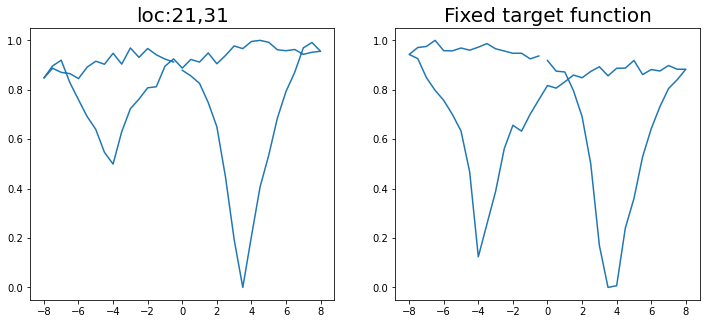

Epoch 1/200 ... Training loss: 3.1436
Epoch 10/200 ... Training loss: 2.5445
Epoch 20/200 ... Training loss: 2.2543
Epoch 30/200 ... Training loss: 1.794
Epoch 40/200 ... Training loss: 1.698
Epoch 50/200 ... Training loss: 1.4824
Epoch 60/200 ... Training loss: 1.3377
Epoch 70/200 ... Training loss: 1.2651
Epoch 80/200 ... Training loss: 1.3876
Epoch 90/200 ... Training loss: 1.246
Epoch 100/200 ... Training loss: 1.169
Epoch 110/200 ... Training loss: 1.0977
Epoch 120/200 ... Training loss: 1.0358
Epoch 130/200 ... Training loss: 1.0437
Epoch 140/200 ... Training loss: 1.0305
Epoch 150/200 ... Training loss: 0.9251
Epoch 160/200 ... Training loss: 0.8762
Epoch 170/200 ... Training loss: 0.8569
Epoch 180/200 ... Training loss: 0.786
Epoch 190/200 ... Training loss: 0.7702
Epoch 200/200 ... Training loss: 0.9184
step:  85
Sample #95




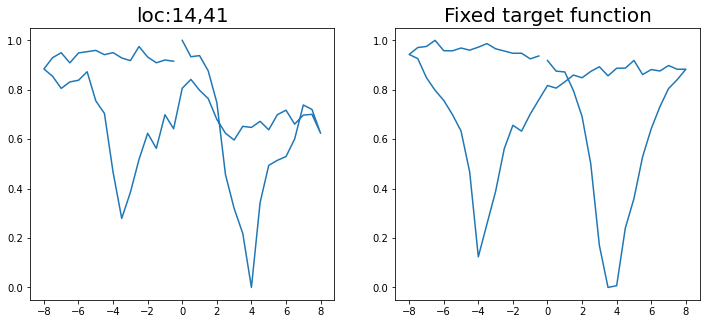

Epoch 1/200 ... Training loss: 3.1194
Epoch 10/200 ... Training loss: 2.5902
Epoch 20/200 ... Training loss: 2.2509
Epoch 30/200 ... Training loss: 1.7256
Epoch 40/200 ... Training loss: 1.5689
Epoch 50/200 ... Training loss: 1.3944
Epoch 60/200 ... Training loss: 1.3075
Epoch 70/200 ... Training loss: 1.249
Epoch 80/200 ... Training loss: 1.1933
Epoch 90/200 ... Training loss: 1.2975
Epoch 100/200 ... Training loss: 1.1642
Epoch 110/200 ... Training loss: 1.1084
Epoch 120/200 ... Training loss: 1.0516
Epoch 130/200 ... Training loss: 1.0033
Epoch 140/200 ... Training loss: 0.9974
Epoch 150/200 ... Training loss: 0.9431
Epoch 160/200 ... Training loss: 0.8747
Epoch 170/200 ... Training loss: 0.8249
Epoch 180/200 ... Training loss: 0.8407
Epoch 190/200 ... Training loss: 0.795
Epoch 200/200 ... Training loss: 0.6997
step:  86
Sample #96




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


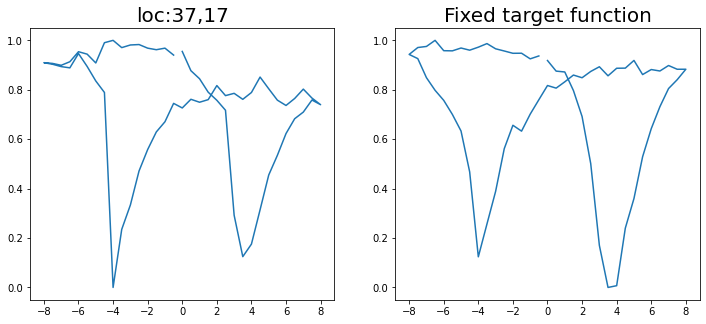

Epoch 1/200 ... Training loss: 3.1011
Epoch 10/200 ... Training loss: 2.5993
Epoch 20/200 ... Training loss: 2.3232
Epoch 30/200 ... Training loss: 1.926
Epoch 40/200 ... Training loss: 1.6045
Epoch 50/200 ... Training loss: 1.532
Epoch 60/200 ... Training loss: 1.3442
Epoch 70/200 ... Training loss: 1.2821
Epoch 80/200 ... Training loss: 1.2432
Epoch 90/200 ... Training loss: 1.2156
Epoch 100/200 ... Training loss: 1.1481
Epoch 110/200 ... Training loss: 1.148
Epoch 120/200 ... Training loss: 1.0561
Epoch 130/200 ... Training loss: 0.9896
Epoch 140/200 ... Training loss: 1.0949
Epoch 150/200 ... Training loss: 0.9939
Epoch 160/200 ... Training loss: 0.9029
Epoch 170/200 ... Training loss: 0.84
Epoch 180/200 ... Training loss: 0.7878
Epoch 190/200 ... Training loss: 0.8579
Epoch 200/200 ... Training loss: 0.7492
step:  87
Sample #97




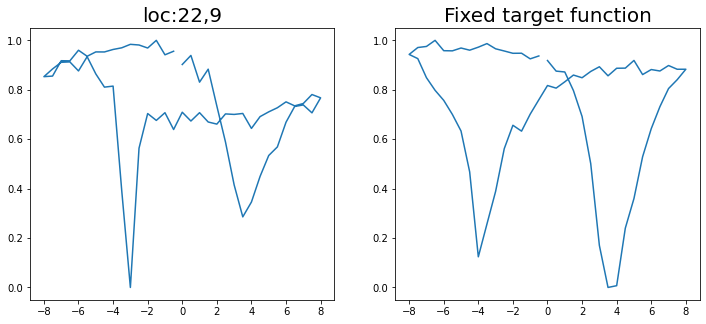

Epoch 1/200 ... Training loss: 3.0831
Epoch 10/200 ... Training loss: 2.6782
Epoch 20/200 ... Training loss: 2.3501
Epoch 30/200 ... Training loss: 2.0291
Epoch 40/200 ... Training loss: 1.5846
Epoch 50/200 ... Training loss: 1.5975
Epoch 60/200 ... Training loss: 1.3834
Epoch 70/200 ... Training loss: 1.298
Epoch 80/200 ... Training loss: 1.2425
Epoch 90/200 ... Training loss: 1.1965
Epoch 100/200 ... Training loss: 1.1398
Epoch 110/200 ... Training loss: 1.0828
Epoch 120/200 ... Training loss: 1.0352
Epoch 130/200 ... Training loss: 1.0296
Epoch 140/200 ... Training loss: 0.9668
Epoch 150/200 ... Training loss: 0.9055
Epoch 160/200 ... Training loss: 0.8544
Epoch 170/200 ... Training loss: 0.8599
Epoch 180/200 ... Training loss: 0.7998
Epoch 190/200 ... Training loss: 0.7492
Epoch 200/200 ... Training loss: 0.714
step:  88
Sample #98




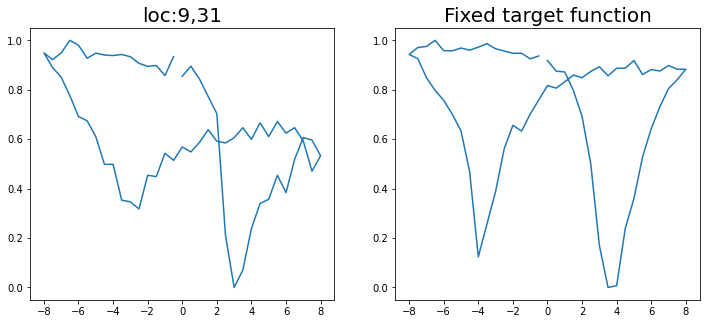

Epoch 1/200 ... Training loss: 3.0646
Epoch 10/200 ... Training loss: 2.5751
Epoch 20/200 ... Training loss: 2.3016
Epoch 30/200 ... Training loss: 1.9479
Epoch 40/200 ... Training loss: 1.8313
Epoch 50/200 ... Training loss: 1.5149
Epoch 60/200 ... Training loss: 1.3274
Epoch 70/200 ... Training loss: 1.2794
Epoch 80/200 ... Training loss: 1.2526
Epoch 90/200 ... Training loss: 1.2799
Epoch 100/200 ... Training loss: 1.1788
Epoch 110/200 ... Training loss: 1.0957
Epoch 120/200 ... Training loss: 1.0403
Epoch 130/200 ... Training loss: 1.1287
Epoch 140/200 ... Training loss: 0.9903
Epoch 150/200 ... Training loss: 0.9309
Epoch 160/200 ... Training loss: 1.0795
Epoch 170/200 ... Training loss: 0.8823
Epoch 180/200 ... Training loss: 0.8059
Epoch 190/200 ... Training loss: 0.7492
Epoch 200/200 ... Training loss: 0.7335
step:  89
Sample #99




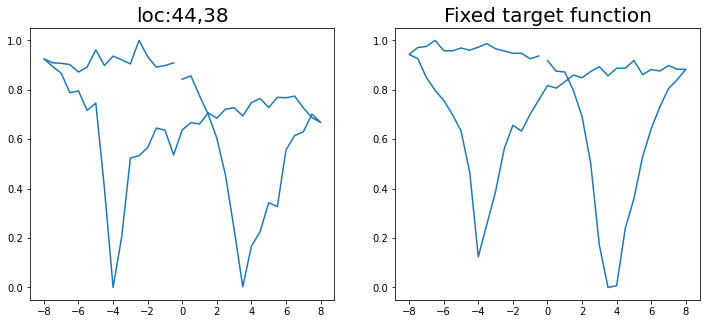

Epoch 1/200 ... Training loss: 3.0542
Epoch 10/200 ... Training loss: 2.5963
Epoch 20/200 ... Training loss: 2.2713
Epoch 30/200 ... Training loss: 1.8854
Epoch 40/200 ... Training loss: 1.9517
Epoch 50/200 ... Training loss: 1.591
Epoch 60/200 ... Training loss: 1.3823
Epoch 70/200 ... Training loss: 1.2725
Epoch 80/200 ... Training loss: 1.3131
Epoch 90/200 ... Training loss: 1.2108
Epoch 100/200 ... Training loss: 1.1461
Epoch 110/200 ... Training loss: 1.084
Epoch 120/200 ... Training loss: 1.0595
Epoch 130/200 ... Training loss: 1.022
Epoch 140/200 ... Training loss: 0.9944
Epoch 150/200 ... Training loss: 0.961
Epoch 160/200 ... Training loss: 0.8995
Epoch 170/200 ... Training loss: 0.8386
Epoch 180/200 ... Training loss: 0.8909
Epoch 190/200 ... Training loss: 0.7724
Epoch 200/200 ... Training loss: 0.7419
step:  90
Sample #100




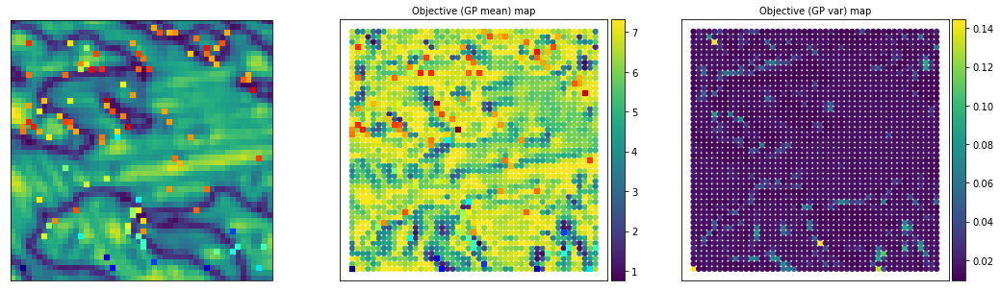

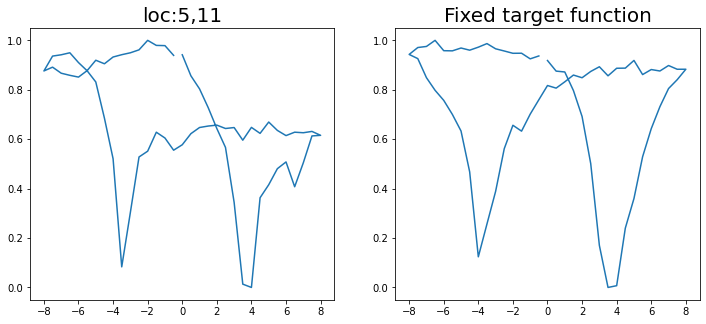

Epoch 1/200 ... Training loss: 3.032
Epoch 10/200 ... Training loss: 2.4078
Epoch 20/200 ... Training loss: 2.1181
Epoch 30/200 ... Training loss: 1.7248
Epoch 40/200 ... Training loss: 1.4867
Epoch 50/200 ... Training loss: 1.3733
Epoch 60/200 ... Training loss: 1.3664
Epoch 70/200 ... Training loss: 1.2625
Epoch 80/200 ... Training loss: 1.1906
Epoch 90/200 ... Training loss: 1.1057
Epoch 100/200 ... Training loss: 1.2619
Epoch 110/200 ... Training loss: 1.0345
Epoch 120/200 ... Training loss: 1.0127
Epoch 130/200 ... Training loss: 1.0273
Epoch 140/200 ... Training loss: 0.9192
Epoch 150/200 ... Training loss: 0.8469
Epoch 160/200 ... Training loss: 0.789
Epoch 170/200 ... Training loss: 0.7923
Epoch 180/200 ... Training loss: 0.7076
Epoch 190/200 ... Training loss: 0.6685
Epoch 200/200 ... Training loss: 0.715
step:  91
Sample #101




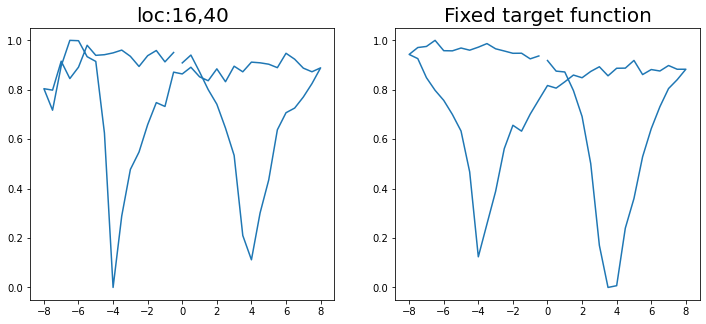

Epoch 1/200 ... Training loss: 3.0099
Epoch 10/200 ... Training loss: 2.5364
Epoch 20/200 ... Training loss: 2.2429
Epoch 30/200 ... Training loss: 1.8464
Epoch 40/200 ... Training loss: 1.7975
Epoch 50/200 ... Training loss: 1.5185
Epoch 60/200 ... Training loss: 1.3763
Epoch 70/200 ... Training loss: 1.3783
Epoch 80/200 ... Training loss: 1.2775
Epoch 90/200 ... Training loss: 1.1795
Epoch 100/200 ... Training loss: 1.1224
Epoch 110/200 ... Training loss: 1.0675
Epoch 120/200 ... Training loss: 1.1286
Epoch 130/200 ... Training loss: 1.0256
Epoch 140/200 ... Training loss: 0.9408
Epoch 150/200 ... Training loss: 0.905
Epoch 160/200 ... Training loss: 0.9115
Epoch 170/200 ... Training loss: 0.8517
Epoch 180/200 ... Training loss: 0.7824
Epoch 190/200 ... Training loss: 0.7774
Epoch 200/200 ... Training loss: 0.7644
step:  92
Sample #102




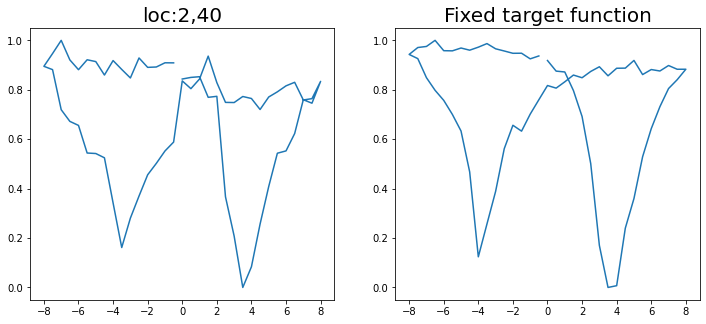

Epoch 1/200 ... Training loss: 2.9879
Epoch 10/200 ... Training loss: 2.5839
Epoch 20/200 ... Training loss: 2.2509
Epoch 30/200 ... Training loss: 1.8775
Epoch 40/200 ... Training loss: 1.5973
Epoch 50/200 ... Training loss: 1.3501
Epoch 60/200 ... Training loss: 1.3485
Epoch 70/200 ... Training loss: 1.2667
Epoch 80/200 ... Training loss: 1.173
Epoch 90/200 ... Training loss: 1.1203
Epoch 100/200 ... Training loss: 1.067
Epoch 110/200 ... Training loss: 1.2241
Epoch 120/200 ... Training loss: 1.0562
Epoch 130/200 ... Training loss: 0.9748
Epoch 140/200 ... Training loss: 1.0439
Epoch 150/200 ... Training loss: 0.9084
Epoch 160/200 ... Training loss: 0.8484
Epoch 170/200 ... Training loss: 0.8111
Epoch 180/200 ... Training loss: 0.7921
Epoch 190/200 ... Training loss: 0.7129
Epoch 200/200 ... Training loss: 1.0
step:  93
Sample #103




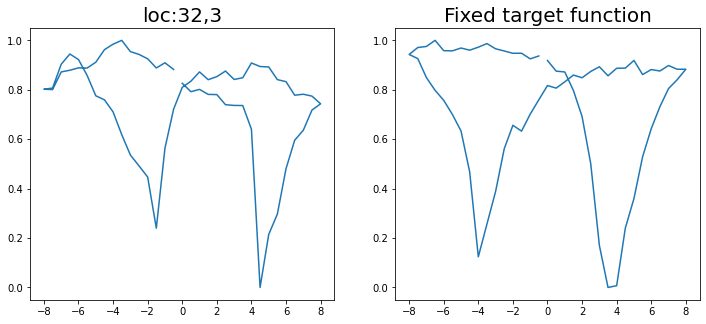

Epoch 1/200 ... Training loss: 2.9431
Epoch 10/200 ... Training loss: 2.6791
Epoch 20/200 ... Training loss: 2.3423
Epoch 30/200 ... Training loss: 2.0229
Epoch 40/200 ... Training loss: 1.959
Epoch 50/200 ... Training loss: 1.53
Epoch 60/200 ... Training loss: 1.3868
Epoch 70/200 ... Training loss: 1.2897
Epoch 80/200 ... Training loss: 1.2576
Epoch 90/200 ... Training loss: 1.1806
Epoch 100/200 ... Training loss: 1.1425
Epoch 110/200 ... Training loss: 1.084
Epoch 120/200 ... Training loss: 1.0436
Epoch 130/200 ... Training loss: 1.0474
Epoch 140/200 ... Training loss: 0.9886
Epoch 150/200 ... Training loss: 0.9851
Epoch 160/200 ... Training loss: 0.9083
Epoch 170/200 ... Training loss: 0.8566
Epoch 180/200 ... Training loss: 0.9218
Epoch 190/200 ... Training loss: 0.8107
Epoch 200/200 ... Training loss: 0.7837
step:  94
Sample #104




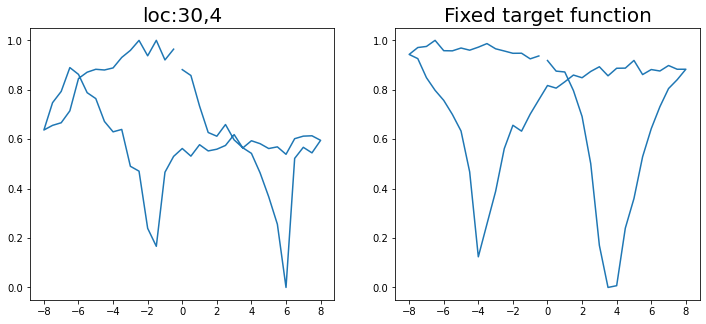

Epoch 1/200 ... Training loss: 2.9989
Epoch 10/200 ... Training loss: 2.7935
Epoch 20/200 ... Training loss: 2.4375
Epoch 30/200 ... Training loss: 2.276
Epoch 40/200 ... Training loss: 2.043
Epoch 50/200 ... Training loss: 1.7803
Epoch 60/200 ... Training loss: 1.6862
Epoch 70/200 ... Training loss: 1.4081
Epoch 80/200 ... Training loss: 1.3059
Epoch 90/200 ... Training loss: 1.2204
Epoch 100/200 ... Training loss: 1.1787
Epoch 110/200 ... Training loss: 1.1655
Epoch 120/200 ... Training loss: 1.1081
Epoch 130/200 ... Training loss: 1.05
Epoch 140/200 ... Training loss: 1.007
Epoch 150/200 ... Training loss: 0.975
Epoch 160/200 ... Training loss: 0.9517
Epoch 170/200 ... Training loss: 0.9151
Epoch 180/200 ... Training loss: 0.8705
Epoch 190/200 ... Training loss: 0.8254
Epoch 200/200 ... Training loss: 0.8224
step:  95
Sample #105




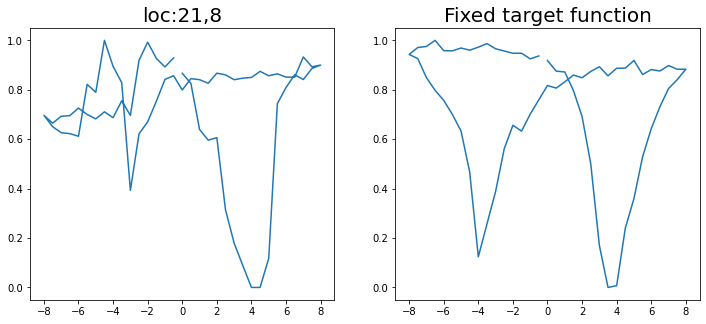

Epoch 1/200 ... Training loss: 2.9882
Epoch 10/200 ... Training loss: 2.7511
Epoch 20/200 ... Training loss: 2.4584
Epoch 30/200 ... Training loss: 2.2
Epoch 40/200 ... Training loss: 1.8275
Epoch 50/200 ... Training loss: 1.5258
Epoch 60/200 ... Training loss: 1.3237
Epoch 70/200 ... Training loss: 1.3592
Epoch 80/200 ... Training loss: 1.2346
Epoch 90/200 ... Training loss: 1.1509
Epoch 100/200 ... Training loss: 1.1966
Epoch 110/200 ... Training loss: 1.1156
Epoch 120/200 ... Training loss: 1.0424
Epoch 130/200 ... Training loss: 1.0632
Epoch 140/200 ... Training loss: 1.0204
Epoch 150/200 ... Training loss: 0.952
Epoch 160/200 ... Training loss: 0.9157
Epoch 170/200 ... Training loss: 0.901
Epoch 180/200 ... Training loss: 1.0495
Epoch 190/200 ... Training loss: 0.9021
Epoch 200/200 ... Training loss: 0.8395
step:  96
Sample #106




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


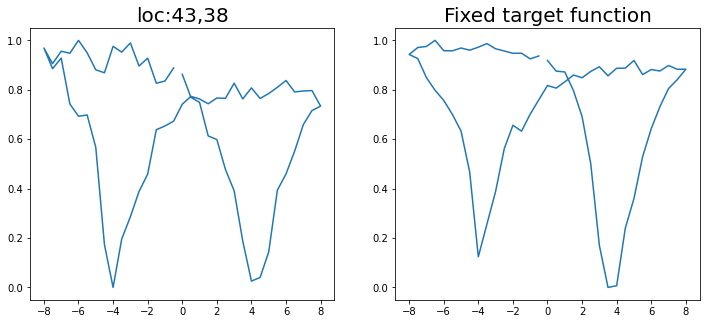

Epoch 1/200 ... Training loss: 2.9741
Epoch 10/200 ... Training loss: 2.7388
Epoch 20/200 ... Training loss: 2.4385
Epoch 30/200 ... Training loss: 2.1949
Epoch 40/200 ... Training loss: 1.8646
Epoch 50/200 ... Training loss: 1.5584
Epoch 60/200 ... Training loss: 1.3581
Epoch 70/200 ... Training loss: 1.2931
Epoch 80/200 ... Training loss: 1.192
Epoch 90/200 ... Training loss: 1.1743
Epoch 100/200 ... Training loss: 1.1475
Epoch 110/200 ... Training loss: 1.0919
Epoch 120/200 ... Training loss: 1.0477
Epoch 130/200 ... Training loss: 1.0898
Epoch 140/200 ... Training loss: 1.0058
Epoch 150/200 ... Training loss: 0.9677
Epoch 160/200 ... Training loss: 0.9297
Epoch 170/200 ... Training loss: 0.9529
Epoch 180/200 ... Training loss: 0.884
Epoch 190/200 ... Training loss: 0.8377
Epoch 200/200 ... Training loss: 0.9538
step:  97
Sample #107




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


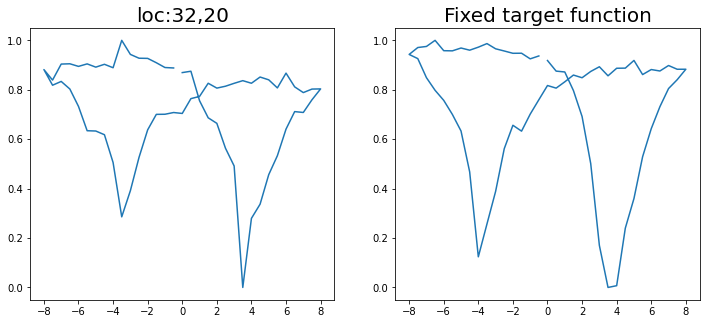

Epoch 1/200 ... Training loss: 2.9866
Epoch 10/200 ... Training loss: 2.881
Epoch 20/200 ... Training loss: 2.6988
Epoch 30/200 ... Training loss: 2.536
Epoch 40/200 ... Training loss: 2.3206
Epoch 50/200 ... Training loss: 2.1566
Epoch 60/200 ... Training loss: 1.957
Epoch 70/200 ... Training loss: 1.6424
Epoch 80/200 ... Training loss: 1.4613
Epoch 90/200 ... Training loss: 1.3596
Epoch 100/200 ... Training loss: 1.3461
Epoch 110/200 ... Training loss: 1.2686
Epoch 120/200 ... Training loss: 1.2156
Epoch 130/200 ... Training loss: 1.1704
Epoch 140/200 ... Training loss: 1.1437
Epoch 150/200 ... Training loss: 1.1005
Epoch 160/200 ... Training loss: 1.1011
Epoch 170/200 ... Training loss: 1.0667
Epoch 180/200 ... Training loss: 1.0184
Epoch 190/200 ... Training loss: 1.0094
Epoch 200/200 ... Training loss: 0.9561
step:  98
Sample #108




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


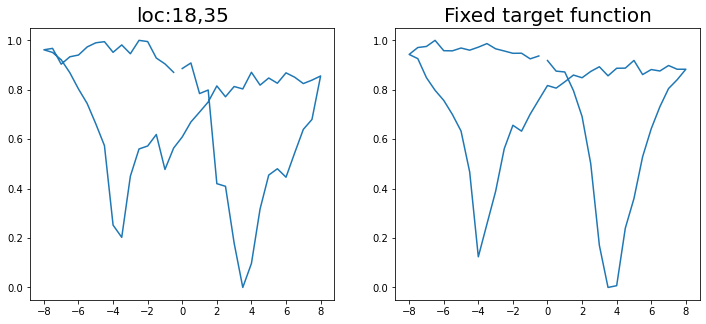

Epoch 1/200 ... Training loss: 2.972
Epoch 10/200 ... Training loss: 2.7889
Epoch 20/200 ... Training loss: 2.432
Epoch 30/200 ... Training loss: 2.2362
Epoch 40/200 ... Training loss: 2.049
Epoch 50/200 ... Training loss: 1.7364
Epoch 60/200 ... Training loss: 1.5053
Epoch 70/200 ... Training loss: 1.314
Epoch 80/200 ... Training loss: 1.2414
Epoch 90/200 ... Training loss: 1.1923
Epoch 100/200 ... Training loss: 1.1505
Epoch 110/200 ... Training loss: 1.1461
Epoch 120/200 ... Training loss: 1.1014
Epoch 130/200 ... Training loss: 1.0389
Epoch 140/200 ... Training loss: 1.0701
Epoch 150/200 ... Training loss: 0.998
Epoch 160/200 ... Training loss: 0.9541
Epoch 170/200 ... Training loss: 0.9213
Epoch 180/200 ... Training loss: 0.9012
Epoch 190/200 ... Training loss: 0.8442
Epoch 200/200 ... Training loss: 0.8793
step:  99
Sample #109




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


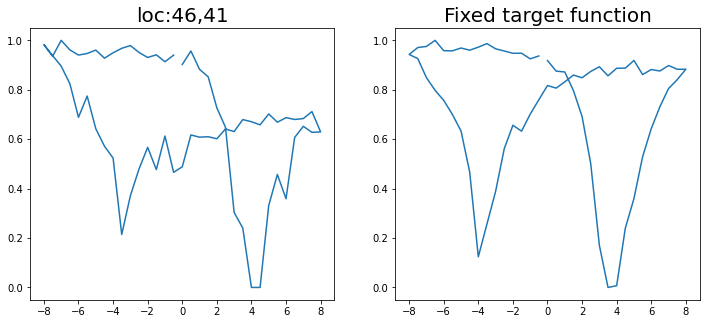

Epoch 1/200 ... Training loss: 2.9719
Epoch 10/200 ... Training loss: 2.8629
Epoch 20/200 ... Training loss: 2.4942
Epoch 30/200 ... Training loss: 2.3238
Epoch 40/200 ... Training loss: 2.1707
Epoch 50/200 ... Training loss: 1.7889
Epoch 60/200 ... Training loss: 1.6027
Epoch 70/200 ... Training loss: 1.437
Epoch 80/200 ... Training loss: 1.3483
Epoch 90/200 ... Training loss: 1.2108
Epoch 100/200 ... Training loss: 1.1785
Epoch 110/200 ... Training loss: 1.595
Epoch 120/200 ... Training loss: 1.2491
Epoch 130/200 ... Training loss: 1.113
Epoch 140/200 ... Training loss: 1.0697
Epoch 150/200 ... Training loss: 1.0281
Epoch 160/200 ... Training loss: 0.9908
Epoch 170/200 ... Training loss: 0.9477
Epoch 180/200 ... Training loss: 0.9215
Epoch 190/200 ... Training loss: 0.8955
Epoch 200/200 ... Training loss: 0.8648
step:  100
Sample #110




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


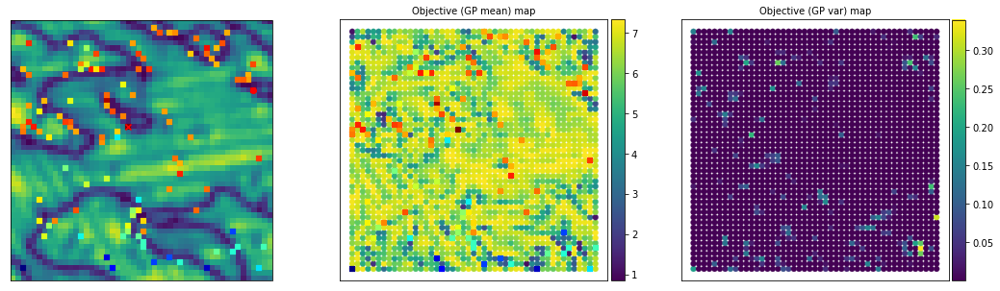

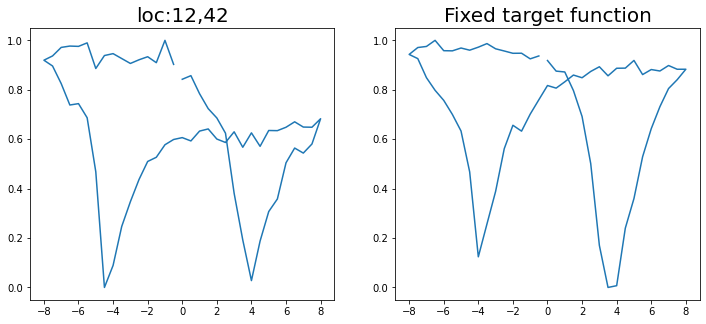

Epoch 1/200 ... Training loss: 2.9672
Epoch 10/200 ... Training loss: 2.7098
Epoch 20/200 ... Training loss: 2.4422
Epoch 30/200 ... Training loss: 2.3099
Epoch 40/200 ... Training loss: 2.0597
Epoch 50/200 ... Training loss: 1.6896
Epoch 60/200 ... Training loss: 1.586
Epoch 70/200 ... Training loss: 1.4645
Epoch 80/200 ... Training loss: 1.3195
Epoch 90/200 ... Training loss: 1.2621
Epoch 100/200 ... Training loss: 1.1784
Epoch 110/200 ... Training loss: 1.2328
Epoch 120/200 ... Training loss: 1.1678
Epoch 130/200 ... Training loss: 1.2298
Epoch 140/200 ... Training loss: 1.0814
Epoch 150/200 ... Training loss: 1.0423
Epoch 160/200 ... Training loss: 0.9987
Epoch 170/200 ... Training loss: 0.9814
Epoch 180/200 ... Training loss: 0.9324
Epoch 190/200 ... Training loss: 0.895
Epoch 200/200 ... Training loss: 1.2257
step:  101
Sample #111




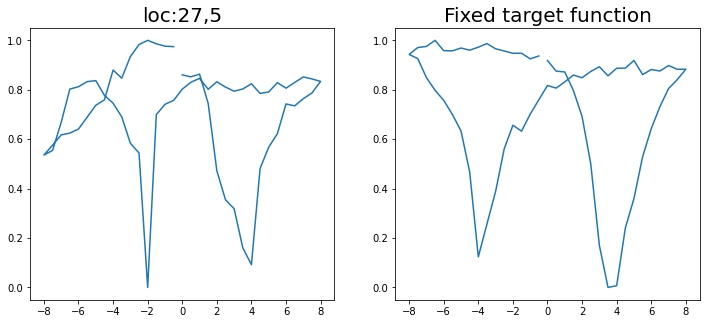

Epoch 1/200 ... Training loss: 2.9939
Epoch 10/200 ... Training loss: 2.8812
Epoch 20/200 ... Training loss: 2.7324
Epoch 30/200 ... Training loss: 2.4931
Epoch 40/200 ... Training loss: 2.3199
Epoch 50/200 ... Training loss: 2.2059
Epoch 60/200 ... Training loss: 2.057
Epoch 70/200 ... Training loss: 1.7862
Epoch 80/200 ... Training loss: 1.6576
Epoch 90/200 ... Training loss: 1.389
Epoch 100/200 ... Training loss: 1.3534
Epoch 110/200 ... Training loss: 1.2538
Epoch 120/200 ... Training loss: 1.2072
Epoch 130/200 ... Training loss: 1.1792
Epoch 140/200 ... Training loss: 1.1229
Epoch 150/200 ... Training loss: 1.1419
Epoch 160/200 ... Training loss: 1.1336
Epoch 170/200 ... Training loss: 1.0471
Epoch 180/200 ... Training loss: 1.0207
Epoch 190/200 ... Training loss: 0.9914
Epoch 200/200 ... Training loss: 1.052
step:  102
Sample #112




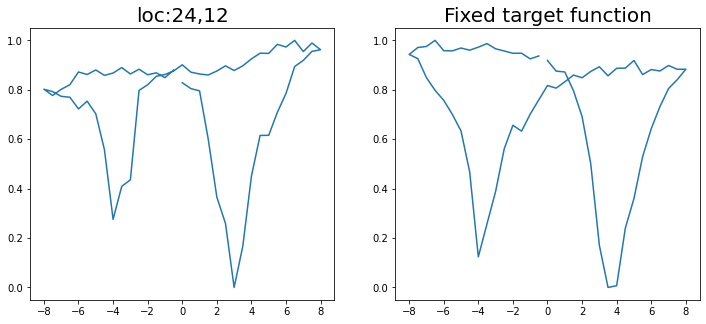

Epoch 1/200 ... Training loss: 2.9741
Epoch 10/200 ... Training loss: 2.8574
Epoch 20/200 ... Training loss: 2.7295
Epoch 30/200 ... Training loss: 2.5591
Epoch 40/200 ... Training loss: 2.3243
Epoch 50/200 ... Training loss: 2.1908
Epoch 60/200 ... Training loss: 2.0216
Epoch 70/200 ... Training loss: 1.7088
Epoch 80/200 ... Training loss: 1.5052
Epoch 90/200 ... Training loss: 1.3634
Epoch 100/200 ... Training loss: 1.5598
Epoch 110/200 ... Training loss: 1.2796
Epoch 120/200 ... Training loss: 1.2101
Epoch 130/200 ... Training loss: 1.2129
Epoch 140/200 ... Training loss: 1.1655
Epoch 150/200 ... Training loss: 1.0959
Epoch 160/200 ... Training loss: 1.0816
Epoch 170/200 ... Training loss: 1.0848
Epoch 180/200 ... Training loss: 1.0347
Epoch 190/200 ... Training loss: 0.9901
Epoch 200/200 ... Training loss: 0.9651
step:  103
Sample #113




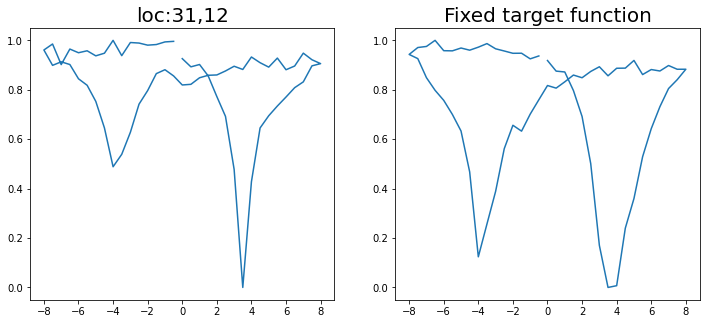

Epoch 1/200 ... Training loss: 2.9563
Epoch 10/200 ... Training loss: 2.6695
Epoch 20/200 ... Training loss: 2.4078
Epoch 30/200 ... Training loss: 2.2524
Epoch 40/200 ... Training loss: 1.8646
Epoch 50/200 ... Training loss: 1.5332
Epoch 60/200 ... Training loss: 1.4107
Epoch 70/200 ... Training loss: 1.2831
Epoch 80/200 ... Training loss: 1.2808
Epoch 90/200 ... Training loss: 1.1694
Epoch 100/200 ... Training loss: 1.1093
Epoch 110/200 ... Training loss: 1.0772
Epoch 120/200 ... Training loss: 1.0906
Epoch 130/200 ... Training loss: 1.018
Epoch 140/200 ... Training loss: 0.9682
Epoch 150/200 ... Training loss: 0.9411
Epoch 160/200 ... Training loss: 0.9381
Epoch 170/200 ... Training loss: 0.8735
Epoch 180/200 ... Training loss: 0.8513
Epoch 190/200 ... Training loss: 0.7872
Epoch 200/200 ... Training loss: 0.7536
step:  104
Sample #114




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


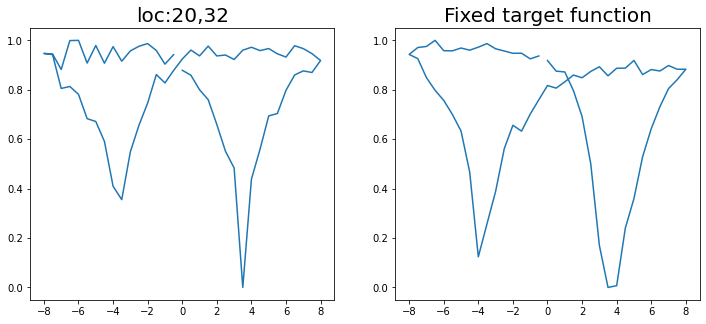

Epoch 1/200 ... Training loss: 2.9449
Epoch 10/200 ... Training loss: 2.6568
Epoch 20/200 ... Training loss: 2.3685
Epoch 30/200 ... Training loss: 2.2037
Epoch 40/200 ... Training loss: 1.7425
Epoch 50/200 ... Training loss: 1.5045
Epoch 60/200 ... Training loss: 1.4586
Epoch 70/200 ... Training loss: 1.4375
Epoch 80/200 ... Training loss: 1.2307
Epoch 90/200 ... Training loss: 1.1506
Epoch 100/200 ... Training loss: 1.1249
Epoch 110/200 ... Training loss: 1.0737
Epoch 120/200 ... Training loss: 1.0857
Epoch 130/200 ... Training loss: 1.0886
Epoch 140/200 ... Training loss: 1.0831
Epoch 150/200 ... Training loss: 1.0268
Epoch 160/200 ... Training loss: 1.1417
Epoch 170/200 ... Training loss: 0.9619
Epoch 180/200 ... Training loss: 0.8858
Epoch 190/200 ... Training loss: 0.8338
Epoch 200/200 ... Training loss: 0.8335
step:  105
Sample #115




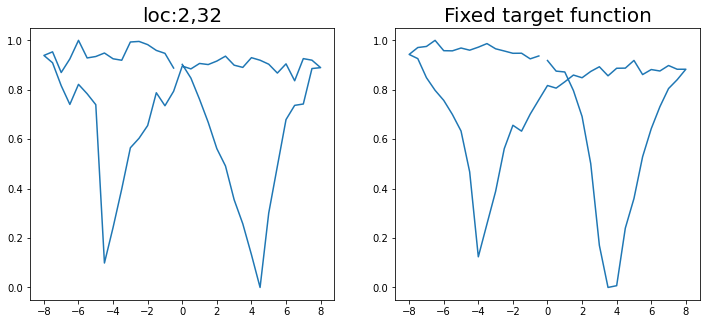

Epoch 1/200 ... Training loss: 2.9605
Epoch 10/200 ... Training loss: 2.6791
Epoch 20/200 ... Training loss: 2.4112
Epoch 30/200 ... Training loss: 2.1532
Epoch 40/200 ... Training loss: 1.735
Epoch 50/200 ... Training loss: 1.5151
Epoch 60/200 ... Training loss: 1.4138
Epoch 70/200 ... Training loss: 1.2599
Epoch 80/200 ... Training loss: 1.2939
Epoch 90/200 ... Training loss: 1.1752
Epoch 100/200 ... Training loss: 1.1888
Epoch 110/200 ... Training loss: 1.0884
Epoch 120/200 ... Training loss: 1.1384
Epoch 130/200 ... Training loss: 1.0405
Epoch 140/200 ... Training loss: 1.1127
Epoch 150/200 ... Training loss: 1.0466
Epoch 160/200 ... Training loss: 0.9272
Epoch 170/200 ... Training loss: 0.8786
Epoch 180/200 ... Training loss: 0.9554
Epoch 190/200 ... Training loss: 0.8305
Epoch 200/200 ... Training loss: 0.9068
step:  106
Sample #116




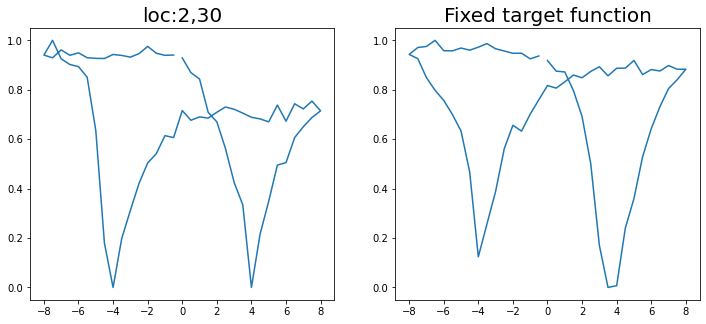

Epoch 1/200 ... Training loss: 2.9482
Epoch 10/200 ... Training loss: 2.8197
Epoch 20/200 ... Training loss: 2.7009
Epoch 30/200 ... Training loss: 2.5312
Epoch 40/200 ... Training loss: 2.3956
Epoch 50/200 ... Training loss: 2.2635
Epoch 60/200 ... Training loss: 2.1762
Epoch 70/200 ... Training loss: 2.0933
Epoch 80/200 ... Training loss: 1.999
Epoch 90/200 ... Training loss: 1.7785
Epoch 100/200 ... Training loss: 1.5365
Epoch 110/200 ... Training loss: 1.4887
Epoch 120/200 ... Training loss: 1.3477
Epoch 130/200 ... Training loss: 1.3024
Epoch 140/200 ... Training loss: 1.2864
Epoch 150/200 ... Training loss: 1.2466
Epoch 160/200 ... Training loss: 1.2283
Epoch 170/200 ... Training loss: 1.194
Epoch 180/200 ... Training loss: 1.2136
Epoch 190/200 ... Training loss: 1.1488
Epoch 200/200 ... Training loss: 1.1226
step:  107
Sample #117




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


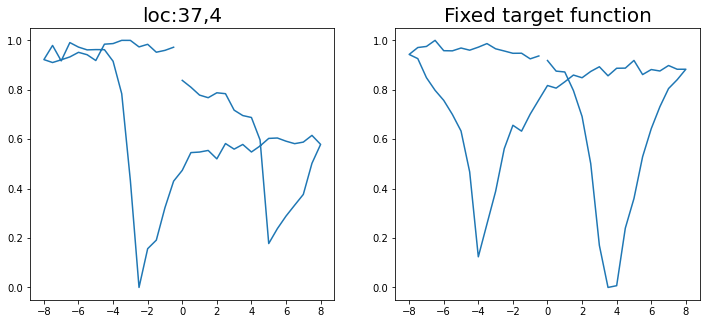

Epoch 1/200 ... Training loss: 2.9818
Epoch 10/200 ... Training loss: 2.6434
Epoch 20/200 ... Training loss: 2.2989
Epoch 30/200 ... Training loss: 2.2316
Epoch 40/200 ... Training loss: 1.8719
Epoch 50/200 ... Training loss: 1.7143
Epoch 60/200 ... Training loss: 1.462
Epoch 70/200 ... Training loss: 1.3186
Epoch 80/200 ... Training loss: 1.2638
Epoch 90/200 ... Training loss: 1.2289
Epoch 100/200 ... Training loss: 1.1375
Epoch 110/200 ... Training loss: 1.1248
Epoch 120/200 ... Training loss: 1.0554
Epoch 130/200 ... Training loss: 1.0105
Epoch 140/200 ... Training loss: 1.0122
Epoch 150/200 ... Training loss: 0.9635
Epoch 160/200 ... Training loss: 1.1442
Epoch 170/200 ... Training loss: 0.9638
Epoch 180/200 ... Training loss: 0.9215
Epoch 190/200 ... Training loss: 0.8546
Epoch 200/200 ... Training loss: 0.7856
step:  108
Sample #118




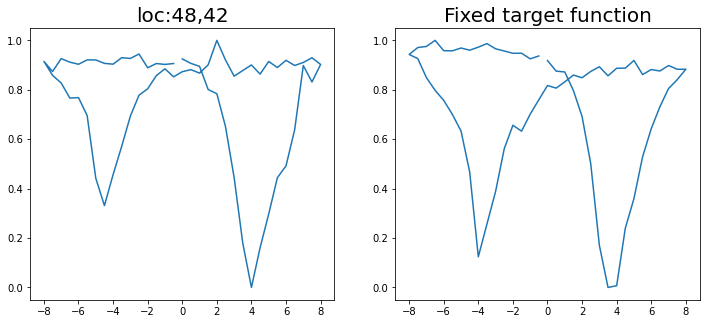

Epoch 1/200 ... Training loss: 2.9828
Epoch 10/200 ... Training loss: 2.9016
Epoch 20/200 ... Training loss: 2.7205
Epoch 30/200 ... Training loss: 2.5791
Epoch 40/200 ... Training loss: 2.4549
Epoch 50/200 ... Training loss: 2.2804
Epoch 60/200 ... Training loss: 2.1552
Epoch 70/200 ... Training loss: 2.0278
Epoch 80/200 ... Training loss: 1.7669
Epoch 90/200 ... Training loss: 1.54
Epoch 100/200 ... Training loss: 1.4271
Epoch 110/200 ... Training loss: 1.3215
Epoch 120/200 ... Training loss: 1.2485
Epoch 130/200 ... Training loss: 1.267
Epoch 140/200 ... Training loss: 1.1562
Epoch 150/200 ... Training loss: 1.1416
Epoch 160/200 ... Training loss: 1.1317
Epoch 170/200 ... Training loss: 1.0828
Epoch 180/200 ... Training loss: 1.0493
Epoch 190/200 ... Training loss: 1.0256
Epoch 200/200 ... Training loss: 0.993
step:  109
Sample #119




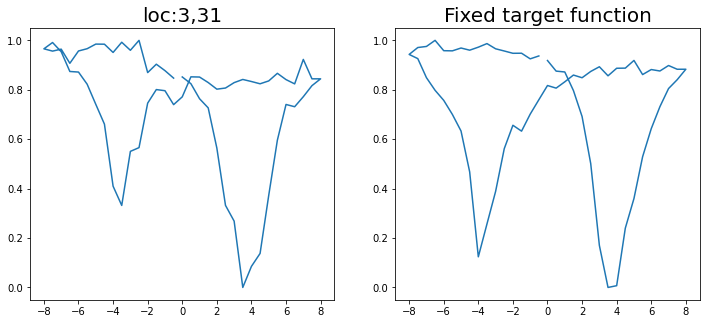

Epoch 1/200 ... Training loss: 2.9728
Epoch 10/200 ... Training loss: 2.8402
Epoch 20/200 ... Training loss: 2.7451
Epoch 30/200 ... Training loss: 2.6249
Epoch 40/200 ... Training loss: 2.4623
Epoch 50/200 ... Training loss: 2.3253
Epoch 60/200 ... Training loss: 2.1998
Epoch 70/200 ... Training loss: 2.1001
Epoch 80/200 ... Training loss: 1.9825
Epoch 90/200 ... Training loss: 1.6925
Epoch 100/200 ... Training loss: 1.5257
Epoch 110/200 ... Training loss: 1.6764
Epoch 120/200 ... Training loss: 1.5283
Epoch 130/200 ... Training loss: 1.3709
Epoch 140/200 ... Training loss: 1.2718
Epoch 150/200 ... Training loss: 1.2427
Epoch 160/200 ... Training loss: 1.1935
Epoch 170/200 ... Training loss: 1.1702
Epoch 180/200 ... Training loss: 1.145
Epoch 190/200 ... Training loss: 1.1081
Epoch 200/200 ... Training loss: 1.0652
step:  110
Sample #120




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


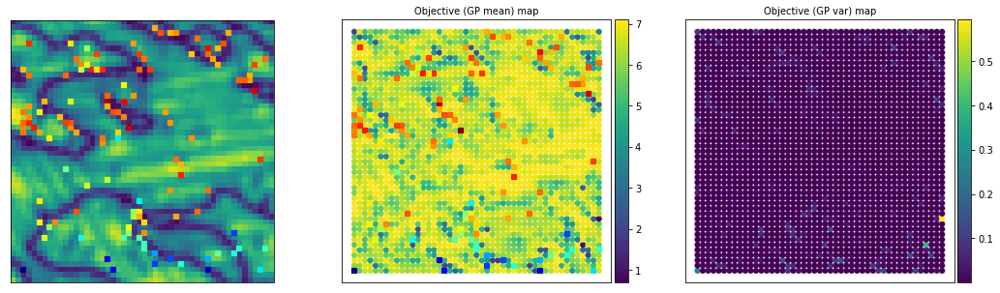

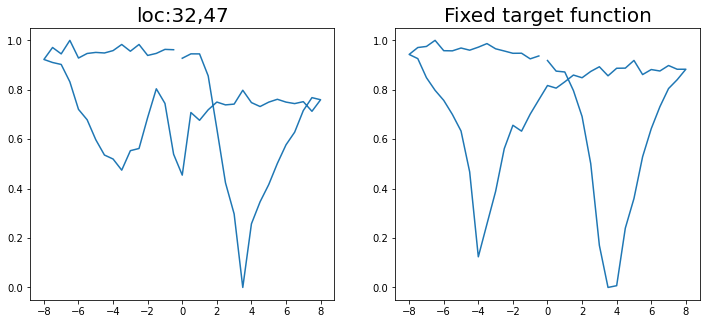

Epoch 1/200 ... Training loss: 2.955
Epoch 10/200 ... Training loss: 2.8547
Epoch 20/200 ... Training loss: 2.6823
Epoch 30/200 ... Training loss: 2.5011
Epoch 40/200 ... Training loss: 2.2683
Epoch 50/200 ... Training loss: 2.1024
Epoch 60/200 ... Training loss: 1.9314
Epoch 70/200 ... Training loss: 1.6467
Epoch 80/200 ... Training loss: 1.4456
Epoch 90/200 ... Training loss: 1.5205
Epoch 100/200 ... Training loss: 1.3234
Epoch 110/200 ... Training loss: 1.2362
Epoch 120/200 ... Training loss: 1.2279
Epoch 130/200 ... Training loss: 1.167
Epoch 140/200 ... Training loss: 1.1152
Epoch 150/200 ... Training loss: 1.0865
Epoch 160/200 ... Training loss: 1.0809
Epoch 170/200 ... Training loss: 1.0304
Epoch 180/200 ... Training loss: 0.9823
Epoch 190/200 ... Training loss: 1.0067
Epoch 200/200 ... Training loss: 0.942
step:  111
Sample #121




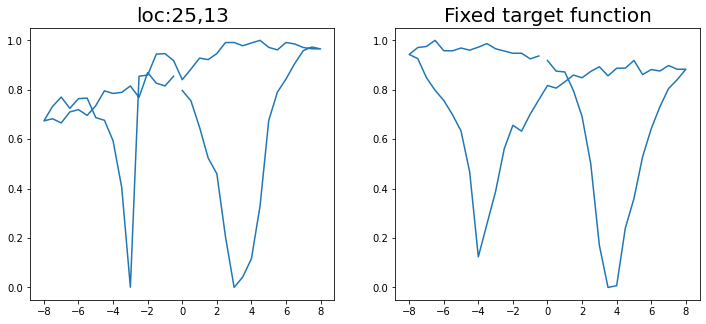

Epoch 1/200 ... Training loss: 2.9472
Epoch 10/200 ... Training loss: 2.8236
Epoch 20/200 ... Training loss: 2.7078
Epoch 30/200 ... Training loss: 2.562
Epoch 40/200 ... Training loss: 2.347
Epoch 50/200 ... Training loss: 2.1978
Epoch 60/200 ... Training loss: 2.0905
Epoch 70/200 ... Training loss: 1.9451
Epoch 80/200 ... Training loss: 1.7248
Epoch 90/200 ... Training loss: 1.6151
Epoch 100/200 ... Training loss: 1.4283
Epoch 110/200 ... Training loss: 1.3233
Epoch 120/200 ... Training loss: 1.3419
Epoch 130/200 ... Training loss: 1.2057
Epoch 140/200 ... Training loss: 1.2233
Epoch 150/200 ... Training loss: 1.1222
Epoch 160/200 ... Training loss: 1.0793
Epoch 170/200 ... Training loss: 1.1297
Epoch 180/200 ... Training loss: 1.0624
Epoch 190/200 ... Training loss: 1.0025
Epoch 200/200 ... Training loss: 0.9877
step:  112
Sample #122




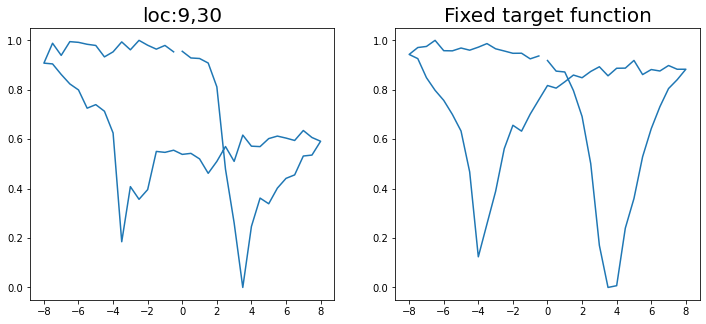

Epoch 1/200 ... Training loss: 2.9352
Epoch 10/200 ... Training loss: 2.7915
Epoch 20/200 ... Training loss: 2.6007
Epoch 30/200 ... Training loss: 2.3526
Epoch 40/200 ... Training loss: 2.2145
Epoch 50/200 ... Training loss: 1.9932
Epoch 60/200 ... Training loss: 1.7547
Epoch 70/200 ... Training loss: 1.5219
Epoch 80/200 ... Training loss: 1.4751
Epoch 90/200 ... Training loss: 1.347
Epoch 100/200 ... Training loss: 1.2841
Epoch 110/200 ... Training loss: 1.2544
Epoch 120/200 ... Training loss: 1.2504
Epoch 130/200 ... Training loss: 1.179
Epoch 140/200 ... Training loss: 1.1094
Epoch 150/200 ... Training loss: 1.1004
Epoch 160/200 ... Training loss: 1.0304
Epoch 170/200 ... Training loss: 1.3671
Epoch 180/200 ... Training loss: 1.0135
Epoch 190/200 ... Training loss: 0.9718
Epoch 200/200 ... Training loss: 0.9146
step:  113
Sample #123




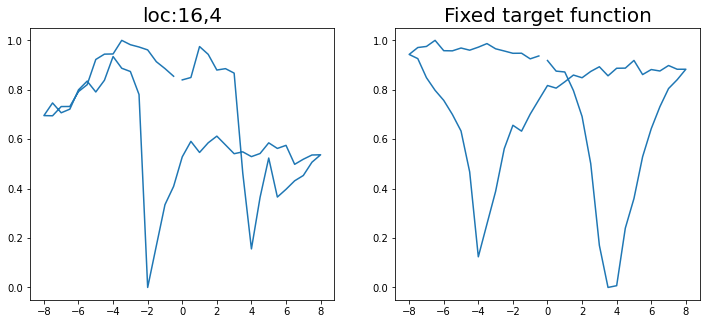

Epoch 1/200 ... Training loss: 2.9981
Epoch 10/200 ... Training loss: 2.8775
Epoch 20/200 ... Training loss: 2.7635
Epoch 30/200 ... Training loss: 2.5973
Epoch 40/200 ... Training loss: 2.4751
Epoch 50/200 ... Training loss: 2.3181
Epoch 60/200 ... Training loss: 2.1755
Epoch 70/200 ... Training loss: 2.0776
Epoch 80/200 ... Training loss: 1.9422
Epoch 90/200 ... Training loss: 1.7341
Epoch 100/200 ... Training loss: 1.5543
Epoch 110/200 ... Training loss: 1.4838
Epoch 120/200 ... Training loss: 1.392
Epoch 130/200 ... Training loss: 1.3117
Epoch 140/200 ... Training loss: 1.2604
Epoch 150/200 ... Training loss: 1.2491
Epoch 160/200 ... Training loss: 1.1695
Epoch 170/200 ... Training loss: 1.3293
Epoch 180/200 ... Training loss: 1.1797
Epoch 190/200 ... Training loss: 1.1067
Epoch 200/200 ... Training loss: 1.0645
step:  114
Sample #124




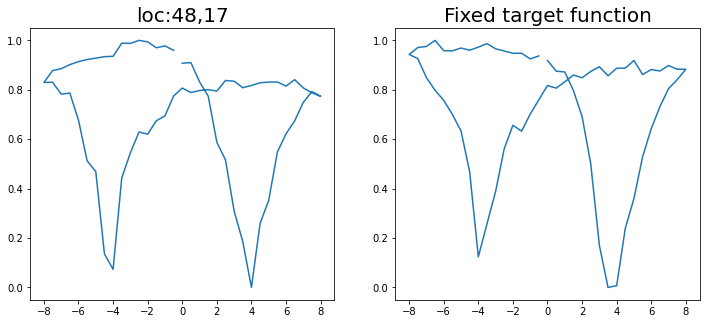

Epoch 1/200 ... Training loss: 2.9983
Epoch 10/200 ... Training loss: 2.92
Epoch 20/200 ... Training loss: 2.7357
Epoch 30/200 ... Training loss: 2.5992
Epoch 40/200 ... Training loss: 2.4905
Epoch 50/200 ... Training loss: 2.3802
Epoch 60/200 ... Training loss: 2.2323
Epoch 70/200 ... Training loss: 2.128
Epoch 80/200 ... Training loss: 2.0183
Epoch 90/200 ... Training loss: 1.7453
Epoch 100/200 ... Training loss: 1.6231
Epoch 110/200 ... Training loss: 1.489
Epoch 120/200 ... Training loss: 1.3687
Epoch 130/200 ... Training loss: 1.3841
Epoch 140/200 ... Training loss: 1.2505
Epoch 150/200 ... Training loss: 1.1898
Epoch 160/200 ... Training loss: 1.1734
Epoch 170/200 ... Training loss: 1.1561
Epoch 180/200 ... Training loss: 1.1332
Epoch 190/200 ... Training loss: 1.1447
Epoch 200/200 ... Training loss: 1.0902
step:  115
Sample #125




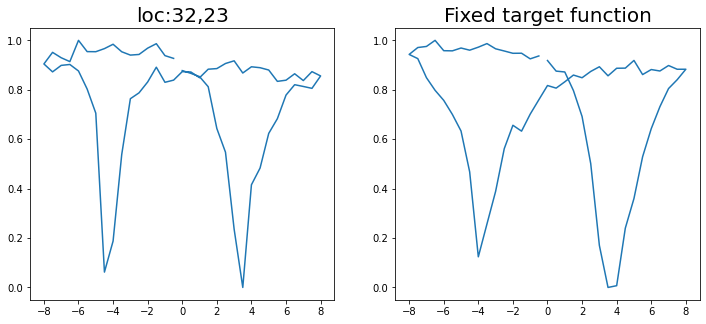

Epoch 1/200 ... Training loss: 2.9952
Epoch 10/200 ... Training loss: 2.7889
Epoch 20/200 ... Training loss: 2.4069
Epoch 30/200 ... Training loss: 2.2038
Epoch 40/200 ... Training loss: 2.1252
Epoch 50/200 ... Training loss: 1.7024
Epoch 60/200 ... Training loss: 1.5261
Epoch 70/200 ... Training loss: 1.3533
Epoch 80/200 ... Training loss: 1.2765
Epoch 90/200 ... Training loss: 1.1826
Epoch 100/200 ... Training loss: 1.1914
Epoch 110/200 ... Training loss: 1.2341
Epoch 120/200 ... Training loss: 1.0727
Epoch 130/200 ... Training loss: 1.0907
Epoch 140/200 ... Training loss: 0.9943
Epoch 150/200 ... Training loss: 0.9584
Epoch 160/200 ... Training loss: 0.9203
Epoch 170/200 ... Training loss: 0.9531
Epoch 180/200 ... Training loss: 0.9171
Epoch 190/200 ... Training loss: 0.8562
Epoch 200/200 ... Training loss: 0.8137
step:  116
Sample #126




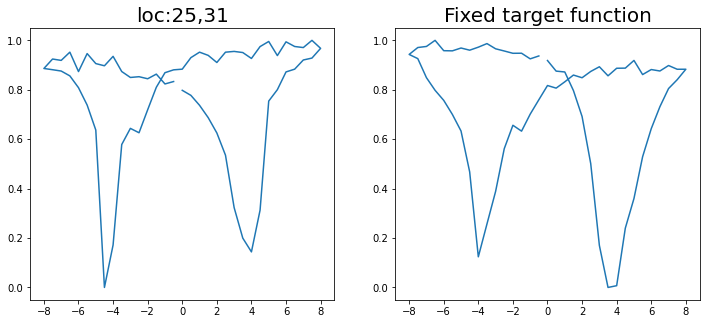

Epoch 1/200 ... Training loss: 2.9884
Epoch 10/200 ... Training loss: 2.8074
Epoch 20/200 ... Training loss: 2.416
Epoch 30/200 ... Training loss: 2.2906
Epoch 40/200 ... Training loss: 2.0976
Epoch 50/200 ... Training loss: 1.7378
Epoch 60/200 ... Training loss: 1.5433
Epoch 70/200 ... Training loss: 1.5248
Epoch 80/200 ... Training loss: 1.3774
Epoch 90/200 ... Training loss: 1.6346
Epoch 100/200 ... Training loss: 1.321
Epoch 110/200 ... Training loss: 1.259
Epoch 120/200 ... Training loss: 1.151
Epoch 130/200 ... Training loss: 1.1384
Epoch 140/200 ... Training loss: 1.0789
Epoch 150/200 ... Training loss: 1.0147
Epoch 160/200 ... Training loss: 1.0032
Epoch 170/200 ... Training loss: 0.9523
Epoch 180/200 ... Training loss: 0.9404
Epoch 190/200 ... Training loss: 0.9659
Epoch 200/200 ... Training loss: 0.8845
step:  117
Sample #127




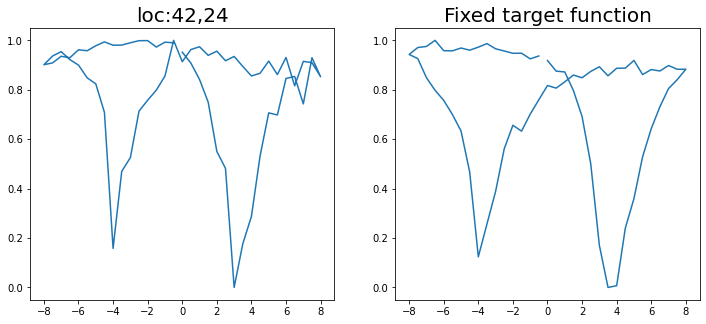

Epoch 1/200 ... Training loss: 2.9752
Epoch 10/200 ... Training loss: 2.5298
Epoch 20/200 ... Training loss: 2.3381
Epoch 30/200 ... Training loss: 1.9621
Epoch 40/200 ... Training loss: 1.7419
Epoch 50/200 ... Training loss: 1.6775
Epoch 60/200 ... Training loss: 1.4335
Epoch 70/200 ... Training loss: 1.6509
Epoch 80/200 ... Training loss: 1.3431
Epoch 90/200 ... Training loss: 1.2153
Epoch 100/200 ... Training loss: 1.2021
Epoch 110/200 ... Training loss: 1.1103
Epoch 120/200 ... Training loss: 1.1455
Epoch 130/200 ... Training loss: 1.0267
Epoch 140/200 ... Training loss: 1.0233
Epoch 150/200 ... Training loss: 0.9585
Epoch 160/200 ... Training loss: 0.9189
Epoch 170/200 ... Training loss: 0.8849
Epoch 180/200 ... Training loss: 0.9091
Epoch 190/200 ... Training loss: 0.8397
Epoch 200/200 ... Training loss: 0.8977
step:  118
Sample #128




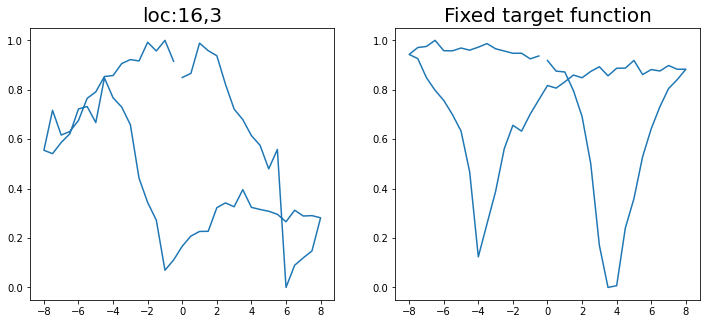

Epoch 1/200 ... Training loss: 3.1612
Epoch 10/200 ... Training loss: 3.0023
Epoch 20/200 ... Training loss: 2.7527
Epoch 30/200 ... Training loss: 2.5725
Epoch 40/200 ... Training loss: 2.4022
Epoch 50/200 ... Training loss: 2.1142
Epoch 60/200 ... Training loss: 1.8956
Epoch 70/200 ... Training loss: 1.7344
Epoch 80/200 ... Training loss: 1.6361
Epoch 90/200 ... Training loss: 1.4539
Epoch 100/200 ... Training loss: 1.3803
Epoch 110/200 ... Training loss: 1.3318
Epoch 120/200 ... Training loss: 1.301
Epoch 130/200 ... Training loss: 1.2348
Epoch 140/200 ... Training loss: 1.1884
Epoch 150/200 ... Training loss: 1.2097
Epoch 160/200 ... Training loss: 1.1543
Epoch 170/200 ... Training loss: 1.121
Epoch 180/200 ... Training loss: 1.0876
Epoch 190/200 ... Training loss: 1.0192
Epoch 200/200 ... Training loss: 1.0447
step:  119
Sample #129




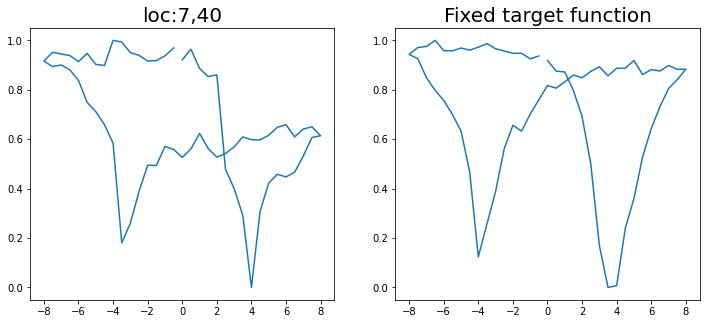

Epoch 1/200 ... Training loss: 3.1427
Epoch 10/200 ... Training loss: 2.9844
Epoch 20/200 ... Training loss: 2.7575
Epoch 30/200 ... Training loss: 2.5451
Epoch 40/200 ... Training loss: 2.2732
Epoch 50/200 ... Training loss: 1.971
Epoch 60/200 ... Training loss: 1.7672
Epoch 70/200 ... Training loss: 1.5753
Epoch 80/200 ... Training loss: 1.5049
Epoch 90/200 ... Training loss: 1.3872
Epoch 100/200 ... Training loss: 1.3802
Epoch 110/200 ... Training loss: 1.2631
Epoch 120/200 ... Training loss: 1.3183
Epoch 130/200 ... Training loss: 1.1813
Epoch 140/200 ... Training loss: 1.1778
Epoch 150/200 ... Training loss: 1.1021
Epoch 160/200 ... Training loss: 1.0573
Epoch 170/200 ... Training loss: 1.0222
Epoch 180/200 ... Training loss: 1.023
Epoch 190/200 ... Training loss: 1.0085
Epoch 200/200 ... Training loss: 1.0459
step:  120
Sample #130




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


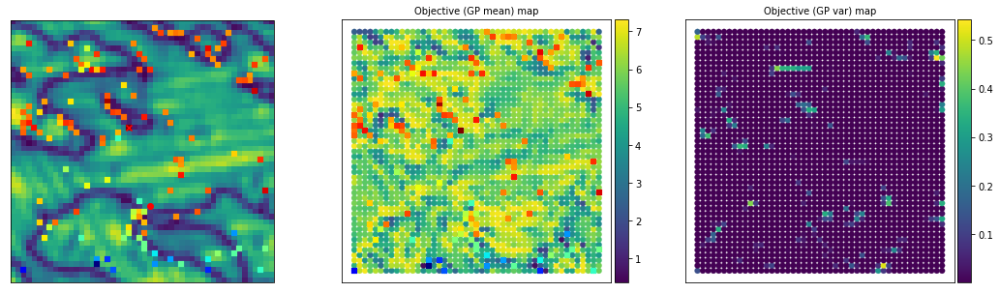

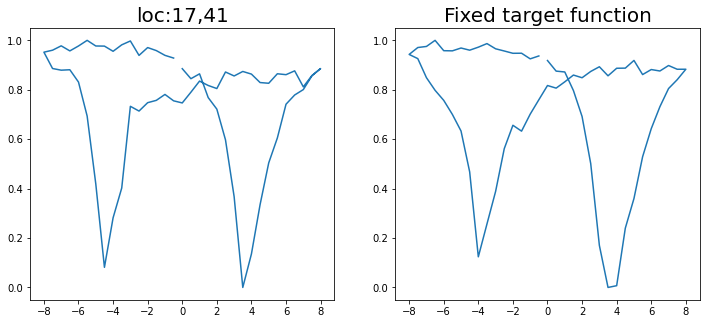

Epoch 1/200 ... Training loss: 3.128
Epoch 10/200 ... Training loss: 2.986
Epoch 20/200 ... Training loss: 2.8795
Epoch 30/200 ... Training loss: 2.6895
Epoch 40/200 ... Training loss: 2.5574
Epoch 50/200 ... Training loss: 2.3493
Epoch 60/200 ... Training loss: 2.2234
Epoch 70/200 ... Training loss: 2.0982
Epoch 80/200 ... Training loss: 1.8592
Epoch 90/200 ... Training loss: 1.7225
Epoch 100/200 ... Training loss: 1.6239
Epoch 110/200 ... Training loss: 1.5742
Epoch 120/200 ... Training loss: 1.4729
Epoch 130/200 ... Training loss: 1.3955
Epoch 140/200 ... Training loss: 1.2924
Epoch 150/200 ... Training loss: 1.245
Epoch 160/200 ... Training loss: 1.2125
Epoch 170/200 ... Training loss: 1.1813
Epoch 180/200 ... Training loss: 1.155
Epoch 190/200 ... Training loss: 1.1549
Epoch 200/200 ... Training loss: 1.1499
step:  121
Sample #131




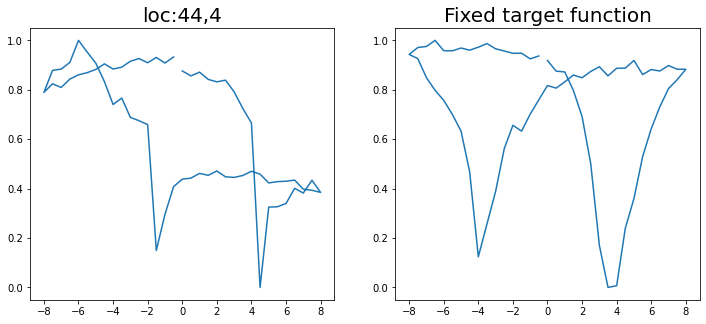

Epoch 1/200 ... Training loss: 3.2024
Epoch 10/200 ... Training loss: 2.9017
Epoch 20/200 ... Training loss: 2.6274
Epoch 30/200 ... Training loss: 2.2103
Epoch 40/200 ... Training loss: 1.8969
Epoch 50/200 ... Training loss: 1.7117
Epoch 60/200 ... Training loss: 1.5158
Epoch 70/200 ... Training loss: 1.3674
Epoch 80/200 ... Training loss: 1.3587
Epoch 90/200 ... Training loss: 1.3033
Epoch 100/200 ... Training loss: 1.2311
Epoch 110/200 ... Training loss: 1.2567
Epoch 120/200 ... Training loss: 1.1492
Epoch 130/200 ... Training loss: 1.3617
Epoch 140/200 ... Training loss: 1.0991
Epoch 150/200 ... Training loss: 1.0263
Epoch 160/200 ... Training loss: 0.9862
Epoch 170/200 ... Training loss: 0.9677
Epoch 180/200 ... Training loss: 0.9388
Epoch 190/200 ... Training loss: 0.9056
Epoch 200/200 ... Training loss: 0.9183
step:  122
Sample #132




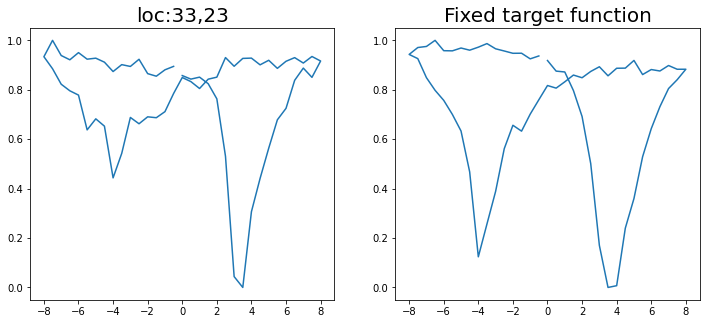

Epoch 1/200 ... Training loss: 3.2173
Epoch 10/200 ... Training loss: 3.0276
Epoch 20/200 ... Training loss: 2.7593
Epoch 30/200 ... Training loss: 2.4756
Epoch 40/200 ... Training loss: 2.1946
Epoch 50/200 ... Training loss: 1.8982
Epoch 60/200 ... Training loss: 1.7678
Epoch 70/200 ... Training loss: 1.5637
Epoch 80/200 ... Training loss: 1.5885
Epoch 90/200 ... Training loss: 1.4451
Epoch 100/200 ... Training loss: 1.3974
Epoch 110/200 ... Training loss: 1.3238
Epoch 120/200 ... Training loss: 1.2315
Epoch 130/200 ... Training loss: 1.2983
Epoch 140/200 ... Training loss: 1.1993
Epoch 150/200 ... Training loss: 1.2
Epoch 160/200 ... Training loss: 1.1326
Epoch 170/200 ... Training loss: 1.0783
Epoch 180/200 ... Training loss: 1.0516
Epoch 190/200 ... Training loss: 0.998
Epoch 200/200 ... Training loss: 0.9698
step:  123
Sample #133




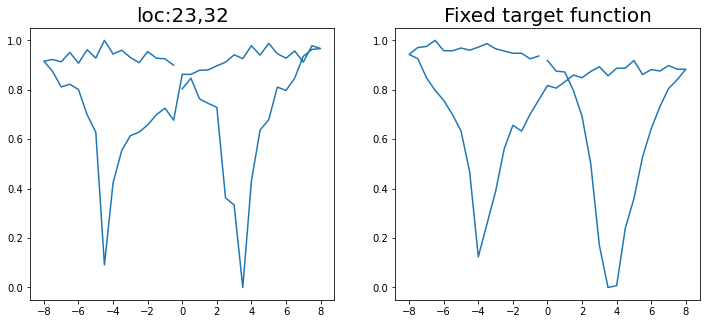

Epoch 1/200 ... Training loss: 3.2042
Epoch 10/200 ... Training loss: 2.944
Epoch 20/200 ... Training loss: 2.5885
Epoch 30/200 ... Training loss: 2.1534
Epoch 40/200 ... Training loss: 1.8692
Epoch 50/200 ... Training loss: 1.6258
Epoch 60/200 ... Training loss: 1.7444
Epoch 70/200 ... Training loss: 1.4901
Epoch 80/200 ... Training loss: 1.3514
Epoch 90/200 ... Training loss: 1.4928
Epoch 100/200 ... Training loss: 1.2818
Epoch 110/200 ... Training loss: 1.1645
Epoch 120/200 ... Training loss: 1.0858
Epoch 130/200 ... Training loss: 1.2338
Epoch 140/200 ... Training loss: 1.054
Epoch 150/200 ... Training loss: 1.0127
Epoch 160/200 ... Training loss: 1.0249
Epoch 170/200 ... Training loss: 0.9288
Epoch 180/200 ... Training loss: 0.8973
Epoch 190/200 ... Training loss: 0.8792
Epoch 200/200 ... Training loss: 0.8371
step:  124
Sample #134




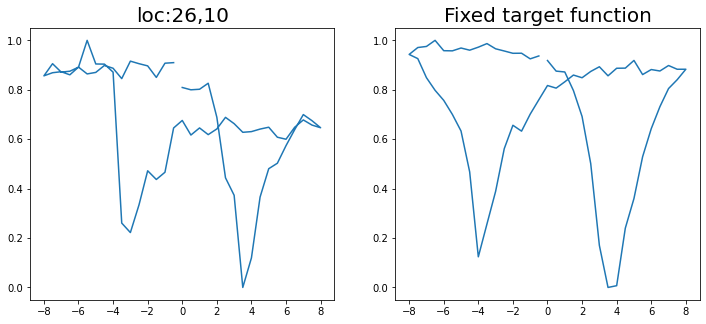

Epoch 1/200 ... Training loss: 3.1892
Epoch 10/200 ... Training loss: 2.9827
Epoch 20/200 ... Training loss: 2.6718
Epoch 30/200 ... Training loss: 2.3431
Epoch 40/200 ... Training loss: 2.058
Epoch 50/200 ... Training loss: 1.6763
Epoch 60/200 ... Training loss: 1.4754
Epoch 70/200 ... Training loss: 1.3412
Epoch 80/200 ... Training loss: 1.3639
Epoch 90/200 ... Training loss: 1.2817
Epoch 100/200 ... Training loss: 1.2287
Epoch 110/200 ... Training loss: 1.1231
Epoch 120/200 ... Training loss: 1.0869
Epoch 130/200 ... Training loss: 1.047
Epoch 140/200 ... Training loss: 1.0991
Epoch 150/200 ... Training loss: 1.0149
Epoch 160/200 ... Training loss: 0.9637
Epoch 170/200 ... Training loss: 0.9213
Epoch 180/200 ... Training loss: 0.9058
Epoch 190/200 ... Training loss: 0.8629
Epoch 200/200 ... Training loss: 0.8744
step:  125
Sample #135




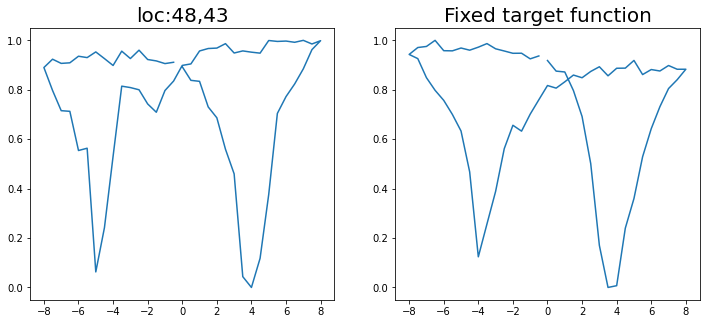

Epoch 1/200 ... Training loss: 3.1863
Epoch 10/200 ... Training loss: 2.9764
Epoch 20/200 ... Training loss: 2.615
Epoch 30/200 ... Training loss: 2.2694
Epoch 40/200 ... Training loss: 1.9687
Epoch 50/200 ... Training loss: 1.7035
Epoch 60/200 ... Training loss: 1.5003
Epoch 70/200 ... Training loss: 1.4128
Epoch 80/200 ... Training loss: 1.3051
Epoch 90/200 ... Training loss: 1.2225
Epoch 100/200 ... Training loss: 1.2572
Epoch 110/200 ... Training loss: 1.1694
Epoch 120/200 ... Training loss: 1.1524
Epoch 130/200 ... Training loss: 1.1153
Epoch 140/200 ... Training loss: 1.0796
Epoch 150/200 ... Training loss: 1.0128
Epoch 160/200 ... Training loss: 1.0769
Epoch 170/200 ... Training loss: 1.0263
Epoch 180/200 ... Training loss: 0.9583
Epoch 190/200 ... Training loss: 0.8937
Epoch 200/200 ... Training loss: 0.91
step:  126
Sample #136




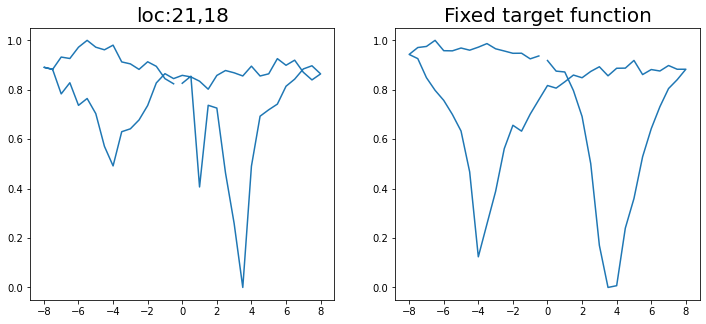

Epoch 1/200 ... Training loss: 3.1693
Epoch 10/200 ... Training loss: 2.9706
Epoch 20/200 ... Training loss: 2.7519
Epoch 30/200 ... Training loss: 2.3723
Epoch 40/200 ... Training loss: 1.9255
Epoch 50/200 ... Training loss: 1.7329
Epoch 60/200 ... Training loss: 1.576
Epoch 70/200 ... Training loss: 1.403
Epoch 80/200 ... Training loss: 1.3591
Epoch 90/200 ... Training loss: 1.2171
Epoch 100/200 ... Training loss: 1.2252
Epoch 110/200 ... Training loss: 1.169
Epoch 120/200 ... Training loss: 1.0957
Epoch 130/200 ... Training loss: 1.0778
Epoch 140/200 ... Training loss: 1.0457
Epoch 150/200 ... Training loss: 1.0301
Epoch 160/200 ... Training loss: 0.9502
Epoch 170/200 ... Training loss: 1.0327
Epoch 180/200 ... Training loss: 0.965
Epoch 190/200 ... Training loss: 0.8909
Epoch 200/200 ... Training loss: 0.9294
step:  127
Sample #137




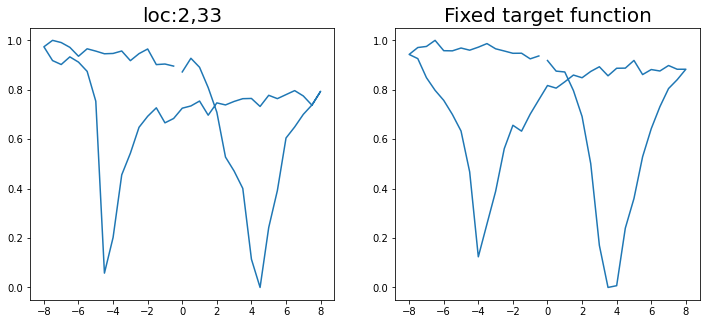

Epoch 1/200 ... Training loss: 3.1689
Epoch 10/200 ... Training loss: 3.0
Epoch 20/200 ... Training loss: 2.7995
Epoch 30/200 ... Training loss: 2.5912
Epoch 40/200 ... Training loss: 2.4535
Epoch 50/200 ... Training loss: 2.2737
Epoch 60/200 ... Training loss: 1.9661
Epoch 70/200 ... Training loss: 1.7501
Epoch 80/200 ... Training loss: 1.6339
Epoch 90/200 ... Training loss: 1.506
Epoch 100/200 ... Training loss: 1.4078
Epoch 110/200 ... Training loss: 1.3389
Epoch 120/200 ... Training loss: 1.2972
Epoch 130/200 ... Training loss: 1.3603
Epoch 140/200 ... Training loss: 1.2436
Epoch 150/200 ... Training loss: 1.1738
Epoch 160/200 ... Training loss: 1.1269
Epoch 170/200 ... Training loss: 1.0798
Epoch 180/200 ... Training loss: 1.132
Epoch 190/200 ... Training loss: 1.0769
Epoch 200/200 ... Training loss: 1.0362
step:  128
Sample #138




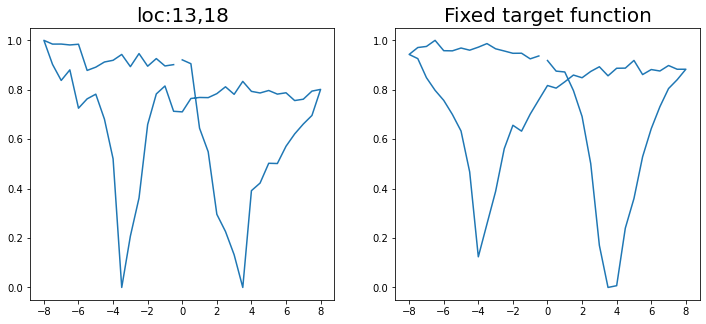

Epoch 1/200 ... Training loss: 3.1517
Epoch 10/200 ... Training loss: 2.9873
Epoch 20/200 ... Training loss: 2.8004
Epoch 30/200 ... Training loss: 2.453
Epoch 40/200 ... Training loss: 2.2589
Epoch 50/200 ... Training loss: 1.9768
Epoch 60/200 ... Training loss: 1.8091
Epoch 70/200 ... Training loss: 1.6905
Epoch 80/200 ... Training loss: 1.6139
Epoch 90/200 ... Training loss: 1.5208
Epoch 100/200 ... Training loss: 1.4226
Epoch 110/200 ... Training loss: 1.3515
Epoch 120/200 ... Training loss: 1.2391
Epoch 130/200 ... Training loss: 1.234
Epoch 140/200 ... Training loss: 1.1888
Epoch 150/200 ... Training loss: 1.1059
Epoch 160/200 ... Training loss: 1.104
Epoch 170/200 ... Training loss: 1.0521
Epoch 180/200 ... Training loss: 1.0372
Epoch 190/200 ... Training loss: 0.9819
Epoch 200/200 ... Training loss: 0.9493
step:  129
Sample #139




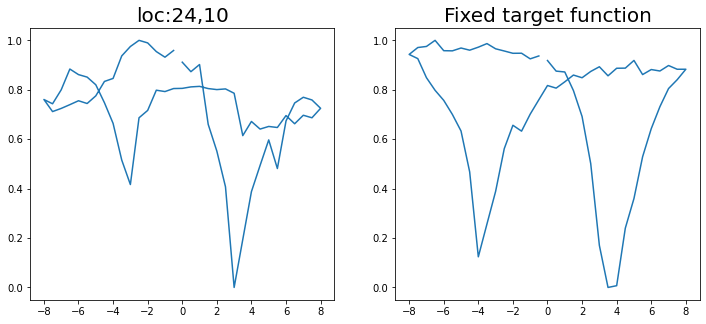

Epoch 1/200 ... Training loss: 3.1738
Epoch 10/200 ... Training loss: 2.9868
Epoch 20/200 ... Training loss: 2.6688
Epoch 30/200 ... Training loss: 2.3127
Epoch 40/200 ... Training loss: 1.9039
Epoch 50/200 ... Training loss: 1.6087
Epoch 60/200 ... Training loss: 1.5319
Epoch 70/200 ... Training loss: 1.46
Epoch 80/200 ... Training loss: 1.3394
Epoch 90/200 ... Training loss: 1.2738
Epoch 100/200 ... Training loss: 1.289
Epoch 110/200 ... Training loss: 1.1607
Epoch 120/200 ... Training loss: 1.1107
Epoch 130/200 ... Training loss: 1.1833
Epoch 140/200 ... Training loss: 1.0741
Epoch 150/200 ... Training loss: 1.0117
Epoch 160/200 ... Training loss: 1.0336
Epoch 170/200 ... Training loss: 0.9853
Epoch 180/200 ... Training loss: 0.9208
Epoch 190/200 ... Training loss: 0.8746
Epoch 200/200 ... Training loss: 0.929
step:  130
Sample #140




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


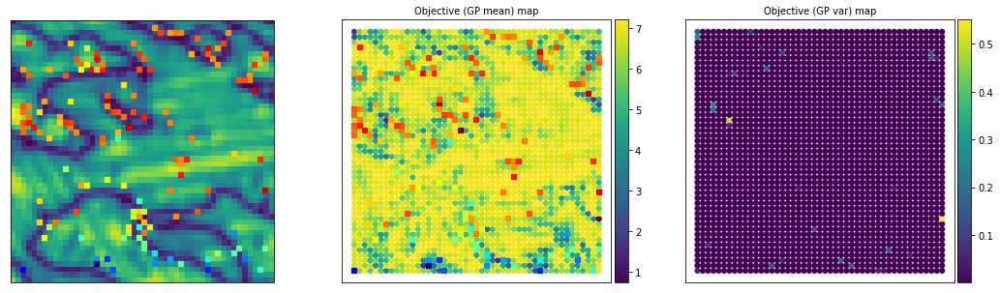

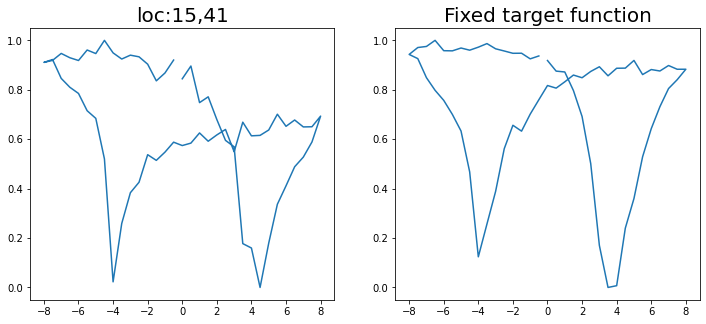

Epoch 1/200 ... Training loss: 3.1581
Epoch 10/200 ... Training loss: 2.9398
Epoch 20/200 ... Training loss: 2.6754
Epoch 30/200 ... Training loss: 2.3721
Epoch 40/200 ... Training loss: 2.0939
Epoch 50/200 ... Training loss: 1.8344
Epoch 60/200 ... Training loss: 1.6347
Epoch 70/200 ... Training loss: 1.5054
Epoch 80/200 ... Training loss: 1.4785
Epoch 90/200 ... Training loss: 1.37
Epoch 100/200 ... Training loss: 1.2784
Epoch 110/200 ... Training loss: 1.215
Epoch 120/200 ... Training loss: 1.2025
Epoch 130/200 ... Training loss: 1.1604
Epoch 140/200 ... Training loss: 1.0852
Epoch 150/200 ... Training loss: 1.0698
Epoch 160/200 ... Training loss: 1.168
Epoch 170/200 ... Training loss: 1.1025
Epoch 180/200 ... Training loss: 1.0816
Epoch 190/200 ... Training loss: 1.0125
Epoch 200/200 ... Training loss: 0.9573
step:  131
Sample #141




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


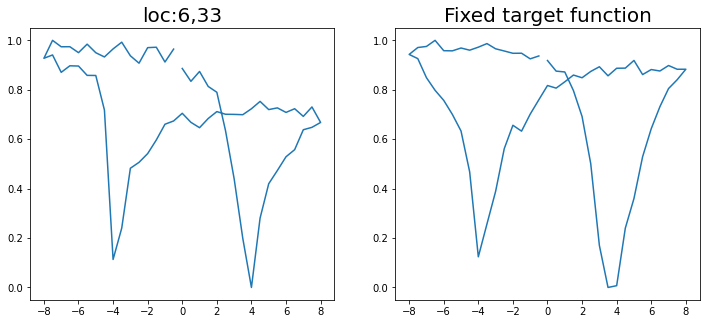

Epoch 1/200 ... Training loss: 3.1537
Epoch 10/200 ... Training loss: 2.9816
Epoch 20/200 ... Training loss: 2.7308
Epoch 30/200 ... Training loss: 2.4823
Epoch 40/200 ... Training loss: 2.1351
Epoch 50/200 ... Training loss: 1.8302
Epoch 60/200 ... Training loss: 1.6459
Epoch 70/200 ... Training loss: 1.4638
Epoch 80/200 ... Training loss: 1.4888
Epoch 90/200 ... Training loss: 1.3438
Epoch 100/200 ... Training loss: 1.2568
Epoch 110/200 ... Training loss: 1.1905
Epoch 120/200 ... Training loss: 1.1653
Epoch 130/200 ... Training loss: 1.1502
Epoch 140/200 ... Training loss: 1.0868
Epoch 150/200 ... Training loss: 1.0476
Epoch 160/200 ... Training loss: 1.0056
Epoch 170/200 ... Training loss: 0.992
Epoch 180/200 ... Training loss: 0.9558
Epoch 190/200 ... Training loss: 0.9173
Epoch 200/200 ... Training loss: 0.8784
step:  132
Sample #142




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


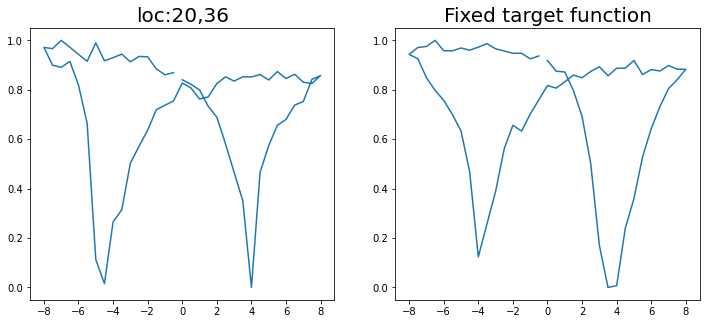

Epoch 1/200 ... Training loss: 3.1408
Epoch 10/200 ... Training loss: 2.9618
Epoch 20/200 ... Training loss: 2.7003
Epoch 30/200 ... Training loss: 2.5088
Epoch 40/200 ... Training loss: 2.2276
Epoch 50/200 ... Training loss: 2.0447
Epoch 60/200 ... Training loss: 1.7449
Epoch 70/200 ... Training loss: 1.6866
Epoch 80/200 ... Training loss: 1.4884
Epoch 90/200 ... Training loss: 1.4084
Epoch 100/200 ... Training loss: 1.3684
Epoch 110/200 ... Training loss: 1.2832
Epoch 120/200 ... Training loss: 1.2191
Epoch 130/200 ... Training loss: 1.5693
Epoch 140/200 ... Training loss: 1.2536
Epoch 150/200 ... Training loss: 1.1781
Epoch 160/200 ... Training loss: 1.1368
Epoch 170/200 ... Training loss: 1.1411
Epoch 180/200 ... Training loss: 1.0611
Epoch 190/200 ... Training loss: 1.1376
Epoch 200/200 ... Training loss: 1.0288
step:  133
Sample #143




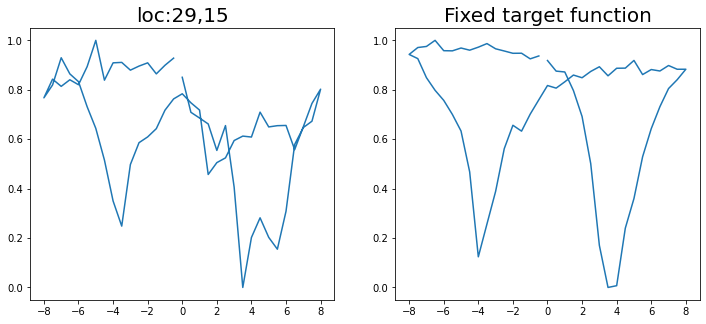

Epoch 1/200 ... Training loss: 3.1312
Epoch 10/200 ... Training loss: 2.976
Epoch 20/200 ... Training loss: 2.8225
Epoch 30/200 ... Training loss: 2.4325
Epoch 40/200 ... Training loss: 2.248
Epoch 50/200 ... Training loss: 2.0033
Epoch 60/200 ... Training loss: 1.8452
Epoch 70/200 ... Training loss: 1.6757
Epoch 80/200 ... Training loss: 1.5063
Epoch 90/200 ... Training loss: 1.3978
Epoch 100/200 ... Training loss: 1.5809
Epoch 110/200 ... Training loss: 1.274
Epoch 120/200 ... Training loss: 1.1679
Epoch 130/200 ... Training loss: 1.1163
Epoch 140/200 ... Training loss: 1.0831
Epoch 150/200 ... Training loss: 1.0451
Epoch 160/200 ... Training loss: 1.0965
Epoch 170/200 ... Training loss: 1.0273
Epoch 180/200 ... Training loss: 0.9758
Epoch 190/200 ... Training loss: 0.9468
Epoch 200/200 ... Training loss: 0.9263
step:  134
Sample #144




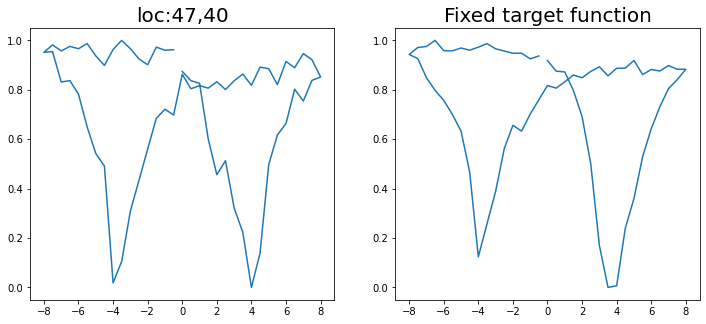

Epoch 1/200 ... Training loss: 3.134
Epoch 10/200 ... Training loss: 2.7247
Epoch 20/200 ... Training loss: 2.8141
Epoch 30/200 ... Training loss: 2.5943
Epoch 40/200 ... Training loss: 2.434
Epoch 50/200 ... Training loss: 2.2436
Epoch 60/200 ... Training loss: 2.0389
Epoch 70/200 ... Training loss: 1.7656
Epoch 80/200 ... Training loss: 1.8005
Epoch 90/200 ... Training loss: 1.5414
Epoch 100/200 ... Training loss: 1.4753
Epoch 110/200 ... Training loss: 1.3622
Epoch 120/200 ... Training loss: 1.4027
Epoch 130/200 ... Training loss: 1.3008
Epoch 140/200 ... Training loss: 1.2409
Epoch 150/200 ... Training loss: 1.1935
Epoch 160/200 ... Training loss: 1.211
Epoch 170/200 ... Training loss: 1.1503
Epoch 180/200 ... Training loss: 1.1074
Epoch 190/200 ... Training loss: 1.0721
Epoch 200/200 ... Training loss: 1.0978
step:  135
Sample #145




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


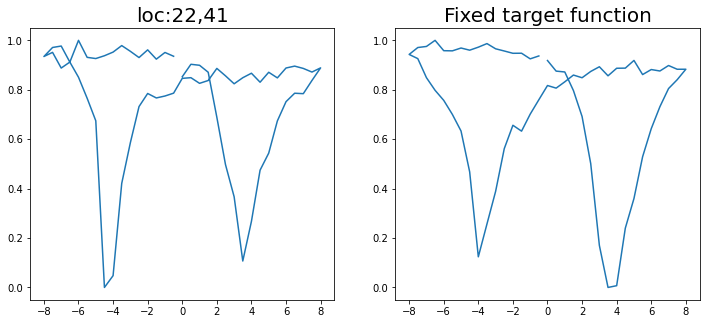

Epoch 1/200 ... Training loss: 3.1241
Epoch 10/200 ... Training loss: 2.9238
Epoch 20/200 ... Training loss: 2.6576
Epoch 30/200 ... Training loss: 2.3291
Epoch 40/200 ... Training loss: 1.9442
Epoch 50/200 ... Training loss: 1.8013
Epoch 60/200 ... Training loss: 1.5926
Epoch 70/200 ... Training loss: 1.488
Epoch 80/200 ... Training loss: 1.4165
Epoch 90/200 ... Training loss: 1.2798
Epoch 100/200 ... Training loss: 1.2295
Epoch 110/200 ... Training loss: 1.2325
Epoch 120/200 ... Training loss: 1.1456
Epoch 130/200 ... Training loss: 1.2515
Epoch 140/200 ... Training loss: 1.0718
Epoch 150/200 ... Training loss: 1.0176
Epoch 160/200 ... Training loss: 1.0297
Epoch 170/200 ... Training loss: 0.9615
Epoch 180/200 ... Training loss: 0.9514
Epoch 190/200 ... Training loss: 0.9081
Epoch 200/200 ... Training loss: 1.4442
step:  136
Sample #146




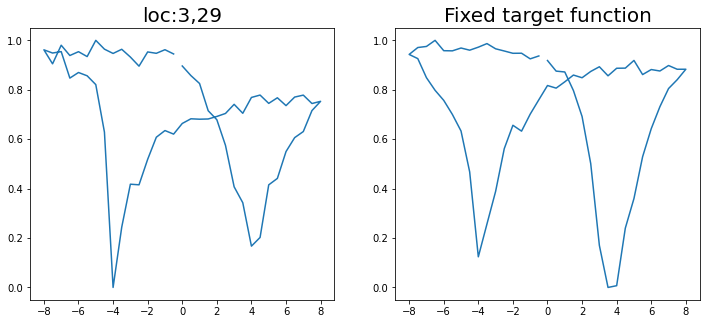

Epoch 1/200 ... Training loss: 3.1154
Epoch 10/200 ... Training loss: 2.9646
Epoch 20/200 ... Training loss: 2.8146
Epoch 30/200 ... Training loss: 2.5855
Epoch 40/200 ... Training loss: 2.3236
Epoch 50/200 ... Training loss: 2.1376
Epoch 60/200 ... Training loss: 1.8621
Epoch 70/200 ... Training loss: 1.7642
Epoch 80/200 ... Training loss: 1.6702
Epoch 90/200 ... Training loss: 1.5083
Epoch 100/200 ... Training loss: 1.396
Epoch 110/200 ... Training loss: 1.3226
Epoch 120/200 ... Training loss: 1.2276
Epoch 130/200 ... Training loss: 1.2077
Epoch 140/200 ... Training loss: 1.1544
Epoch 150/200 ... Training loss: 1.1533
Epoch 160/200 ... Training loss: 1.0998
Epoch 170/200 ... Training loss: 1.0588
Epoch 180/200 ... Training loss: 1.028
Epoch 190/200 ... Training loss: 0.9863
Epoch 200/200 ... Training loss: 0.9575
step:  137
Sample #147




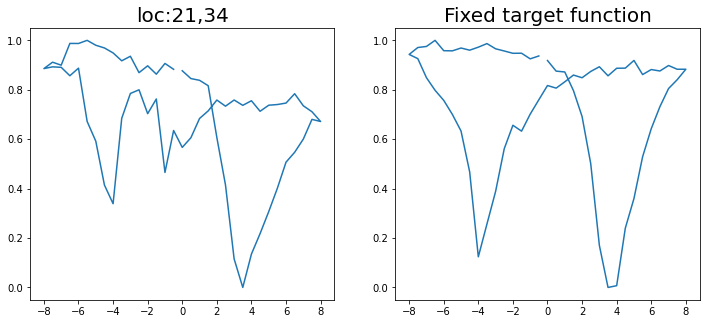

Epoch 1/200 ... Training loss: 3.0994
Epoch 10/200 ... Training loss: 2.9555
Epoch 20/200 ... Training loss: 2.7792
Epoch 30/200 ... Training loss: 2.3865
Epoch 40/200 ... Training loss: 2.1891
Epoch 50/200 ... Training loss: 1.8706
Epoch 60/200 ... Training loss: 1.6649
Epoch 70/200 ... Training loss: 1.6688
Epoch 80/200 ... Training loss: 1.4495
Epoch 90/200 ... Training loss: 1.3286
Epoch 100/200 ... Training loss: 1.2815
Epoch 110/200 ... Training loss: 1.1916
Epoch 120/200 ... Training loss: 1.136
Epoch 130/200 ... Training loss: 1.287
Epoch 140/200 ... Training loss: 1.112
Epoch 150/200 ... Training loss: 1.0428
Epoch 160/200 ... Training loss: 1.0042
Epoch 170/200 ... Training loss: 0.9713
Epoch 180/200 ... Training loss: 0.9491
Epoch 190/200 ... Training loss: 0.9247
Epoch 200/200 ... Training loss: 0.9087
step:  138
Sample #148




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


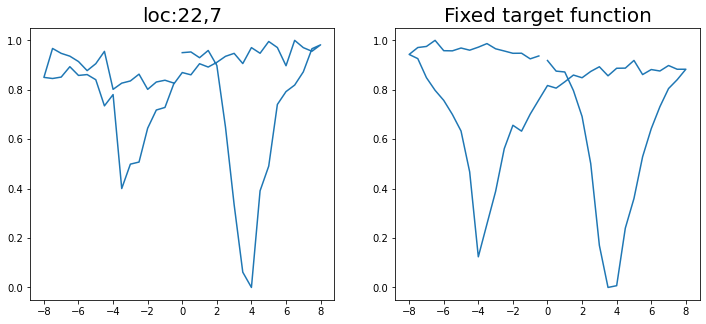

Epoch 1/200 ... Training loss: 3.0852
Epoch 10/200 ... Training loss: 2.9379
Epoch 20/200 ... Training loss: 2.7521
Epoch 30/200 ... Training loss: 2.569
Epoch 40/200 ... Training loss: 2.4224
Epoch 50/200 ... Training loss: 2.2175
Epoch 60/200 ... Training loss: 2.0556
Epoch 70/200 ... Training loss: 1.727
Epoch 80/200 ... Training loss: 1.6207
Epoch 90/200 ... Training loss: 1.5538
Epoch 100/200 ... Training loss: 1.5044
Epoch 110/200 ... Training loss: 1.3513
Epoch 120/200 ... Training loss: 1.2922
Epoch 130/200 ... Training loss: 1.357
Epoch 140/200 ... Training loss: 1.284
Epoch 150/200 ... Training loss: 1.1934
Epoch 160/200 ... Training loss: 1.1624
Epoch 170/200 ... Training loss: 1.1432
Epoch 180/200 ... Training loss: 1.0815
Epoch 190/200 ... Training loss: 1.1101
Epoch 200/200 ... Training loss: 1.0327
step:  139
Sample #149




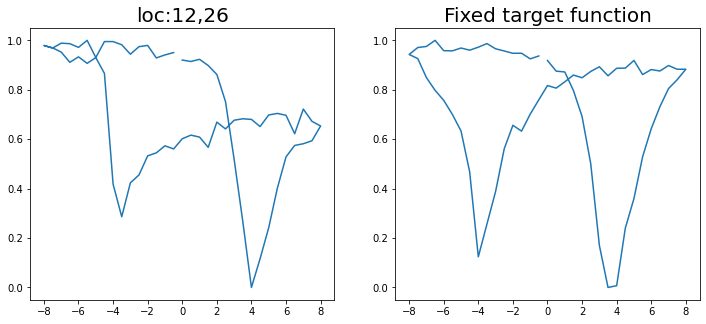

Epoch 1/200 ... Training loss: 3.0711
Epoch 10/200 ... Training loss: 2.9256
Epoch 20/200 ... Training loss: 2.7809
Epoch 30/200 ... Training loss: 2.6252
Epoch 40/200 ... Training loss: 2.3114
Epoch 50/200 ... Training loss: 2.1519
Epoch 60/200 ... Training loss: 1.8959
Epoch 70/200 ... Training loss: 1.734
Epoch 80/200 ... Training loss: 1.6991
Epoch 90/200 ... Training loss: 1.5883
Epoch 100/200 ... Training loss: 1.5569
Epoch 110/200 ... Training loss: 1.5454
Epoch 120/200 ... Training loss: 1.4526
Epoch 130/200 ... Training loss: 1.4061
Epoch 140/200 ... Training loss: 1.3691
Epoch 150/200 ... Training loss: 1.3394
Epoch 160/200 ... Training loss: 1.2417
Epoch 170/200 ... Training loss: 1.2057
Epoch 180/200 ... Training loss: 1.1116
Epoch 190/200 ... Training loss: 1.1196
Epoch 200/200 ... Training loss: 1.0632
step:  140
Sample #150




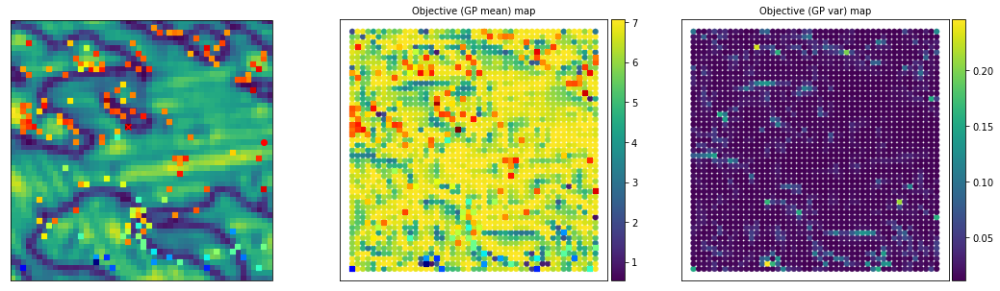

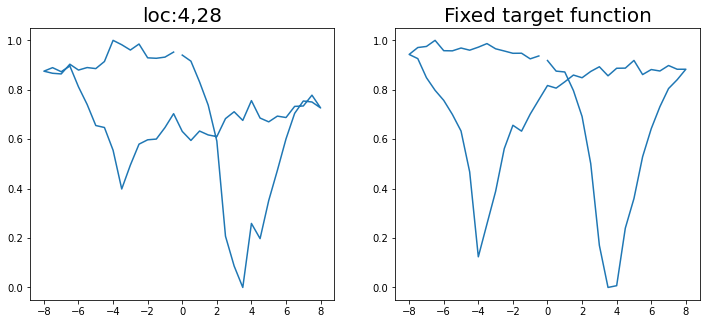

Epoch 1/200 ... Training loss: 3.0556
Epoch 10/200 ... Training loss: 2.9122
Epoch 20/200 ... Training loss: 2.7679
Epoch 30/200 ... Training loss: 2.5946
Epoch 40/200 ... Training loss: 2.3044
Epoch 50/200 ... Training loss: 2.1265
Epoch 60/200 ... Training loss: 1.8746
Epoch 70/200 ... Training loss: 1.7313
Epoch 80/200 ... Training loss: 1.654
Epoch 90/200 ... Training loss: 1.5927
Epoch 100/200 ... Training loss: 1.5532
Epoch 110/200 ... Training loss: 1.5401
Epoch 120/200 ... Training loss: 1.4491
Epoch 130/200 ... Training loss: 1.4403
Epoch 140/200 ... Training loss: 1.3519
Epoch 150/200 ... Training loss: 1.308
Epoch 160/200 ... Training loss: 1.2603
Epoch 170/200 ... Training loss: 1.195
Epoch 180/200 ... Training loss: 1.1435
Epoch 190/200 ... Training loss: 1.1899
Epoch 200/200 ... Training loss: 1.0866
step:  141
Sample #151




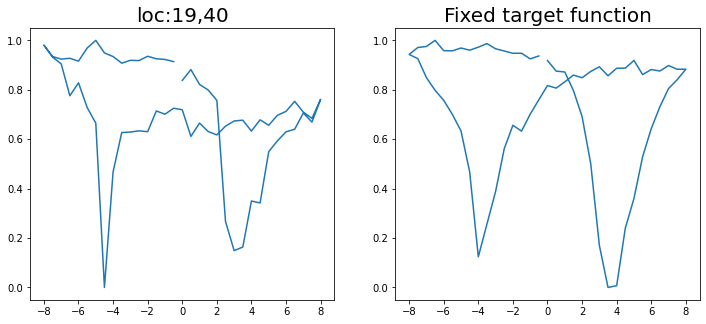

Epoch 1/200 ... Training loss: 3.0491
Epoch 10/200 ... Training loss: 2.9047
Epoch 20/200 ... Training loss: 2.7571
Epoch 30/200 ... Training loss: 2.4764
Epoch 40/200 ... Training loss: 2.2777
Epoch 50/200 ... Training loss: 2.0549
Epoch 60/200 ... Training loss: 1.7876
Epoch 70/200 ... Training loss: 1.805
Epoch 80/200 ... Training loss: 1.6798
Epoch 90/200 ... Training loss: 1.5641
Epoch 100/200 ... Training loss: 1.5328
Epoch 110/200 ... Training loss: 1.4212
Epoch 120/200 ... Training loss: 1.2917
Epoch 130/200 ... Training loss: 1.2752
Epoch 140/200 ... Training loss: 1.2541
Epoch 150/200 ... Training loss: 1.1738
Epoch 160/200 ... Training loss: 1.1071
Epoch 170/200 ... Training loss: 1.1585
Epoch 180/200 ... Training loss: 1.0662
Epoch 190/200 ... Training loss: 1.0174
Epoch 200/200 ... Training loss: 0.9826
step:  142
Sample #152




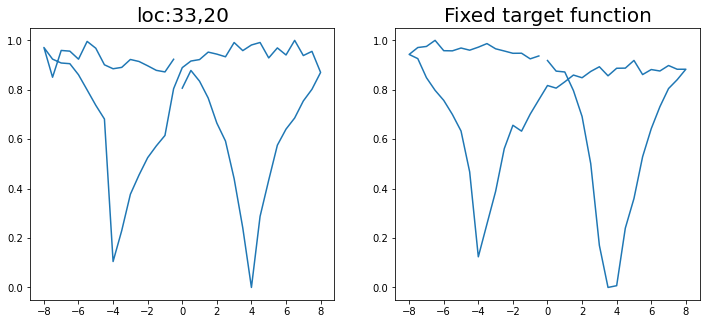

Epoch 1/200 ... Training loss: 3.0398
Epoch 10/200 ... Training loss: 2.8736
Epoch 20/200 ... Training loss: 2.421
Epoch 30/200 ... Training loss: 2.3222
Epoch 40/200 ... Training loss: 1.8092
Epoch 50/200 ... Training loss: 1.6241
Epoch 60/200 ... Training loss: 1.5005
Epoch 70/200 ... Training loss: 1.3676
Epoch 80/200 ... Training loss: 1.2943
Epoch 90/200 ... Training loss: 1.2152
Epoch 100/200 ... Training loss: 1.1627
Epoch 110/200 ... Training loss: 1.2082
Epoch 120/200 ... Training loss: 1.0671
Epoch 130/200 ... Training loss: 1.055
Epoch 140/200 ... Training loss: 1.043
Epoch 150/200 ... Training loss: 0.9596
Epoch 160/200 ... Training loss: 0.957
Epoch 170/200 ... Training loss: 0.8964
Epoch 180/200 ... Training loss: 0.9124
Epoch 190/200 ... Training loss: 0.8597
Epoch 200/200 ... Training loss: 0.8588
step:  143
Sample #153




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


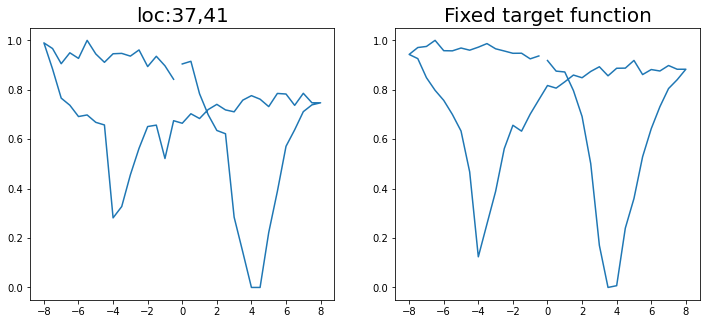

Epoch 1/200 ... Training loss: 3.0352
Epoch 10/200 ... Training loss: 2.8875
Epoch 20/200 ... Training loss: 2.6884
Epoch 30/200 ... Training loss: 2.514
Epoch 40/200 ... Training loss: 2.36
Epoch 50/200 ... Training loss: 2.0501
Epoch 60/200 ... Training loss: 1.7966
Epoch 70/200 ... Training loss: 1.687
Epoch 80/200 ... Training loss: 1.5092
Epoch 90/200 ... Training loss: 1.402
Epoch 100/200 ... Training loss: 1.337
Epoch 110/200 ... Training loss: 1.2607
Epoch 120/200 ... Training loss: 1.2211
Epoch 130/200 ... Training loss: 1.1882
Epoch 140/200 ... Training loss: 1.1434
Epoch 150/200 ... Training loss: 1.1134
Epoch 160/200 ... Training loss: 1.0589
Epoch 170/200 ... Training loss: 1.0495
Epoch 180/200 ... Training loss: 0.9908
Epoch 190/200 ... Training loss: 0.9781
Epoch 200/200 ... Training loss: 0.9349
step:  144
Sample #154




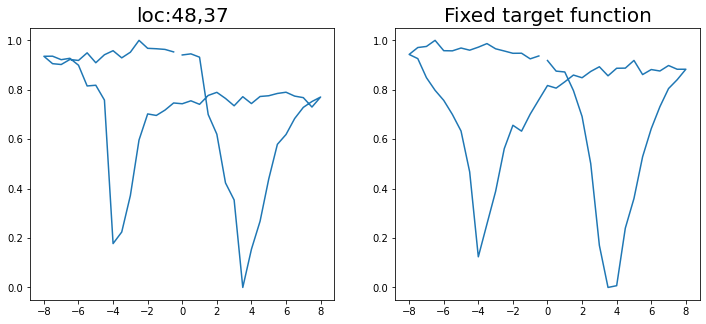

Epoch 1/200 ... Training loss: 3.0209
Epoch 10/200 ... Training loss: 2.8424
Epoch 20/200 ... Training loss: 2.5993
Epoch 30/200 ... Training loss: 2.31
Epoch 40/200 ... Training loss: 1.9906
Epoch 50/200 ... Training loss: 1.8006
Epoch 60/200 ... Training loss: 1.7361
Epoch 70/200 ... Training loss: 1.5397
Epoch 80/200 ... Training loss: 1.472
Epoch 90/200 ... Training loss: 1.3363
Epoch 100/200 ... Training loss: 1.2358
Epoch 110/200 ... Training loss: 1.2487
Epoch 120/200 ... Training loss: 1.1997
Epoch 130/200 ... Training loss: 1.1508
Epoch 140/200 ... Training loss: 1.1184
Epoch 150/200 ... Training loss: 1.0473
Epoch 160/200 ... Training loss: 1.0377
Epoch 170/200 ... Training loss: 0.9751
Epoch 180/200 ... Training loss: 0.9455
Epoch 190/200 ... Training loss: 0.9036
Epoch 200/200 ... Training loss: 0.8994
step:  145
Sample #155




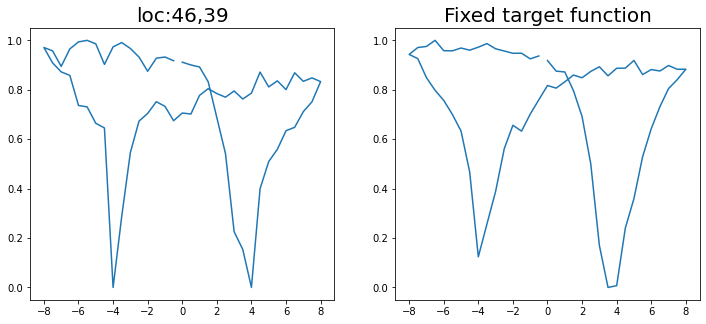

Epoch 1/200 ... Training loss: 3.0151
Epoch 10/200 ... Training loss: 2.8978
Epoch 20/200 ... Training loss: 2.7219
Epoch 30/200 ... Training loss: 2.5512
Epoch 40/200 ... Training loss: 2.2998
Epoch 50/200 ... Training loss: 2.1689
Epoch 60/200 ... Training loss: 1.9174
Epoch 70/200 ... Training loss: 1.7334
Epoch 80/200 ... Training loss: 1.6679
Epoch 90/200 ... Training loss: 1.6036
Epoch 100/200 ... Training loss: 1.5517
Epoch 110/200 ... Training loss: 1.5016
Epoch 120/200 ... Training loss: 1.4681
Epoch 130/200 ... Training loss: 1.4524
Epoch 140/200 ... Training loss: 1.4053
Epoch 150/200 ... Training loss: 1.3586
Epoch 160/200 ... Training loss: 1.3472
Epoch 170/200 ... Training loss: 1.2966
Epoch 180/200 ... Training loss: 1.2663
Epoch 190/200 ... Training loss: 1.2629
Epoch 200/200 ... Training loss: 1.2272
step:  146
Sample #156




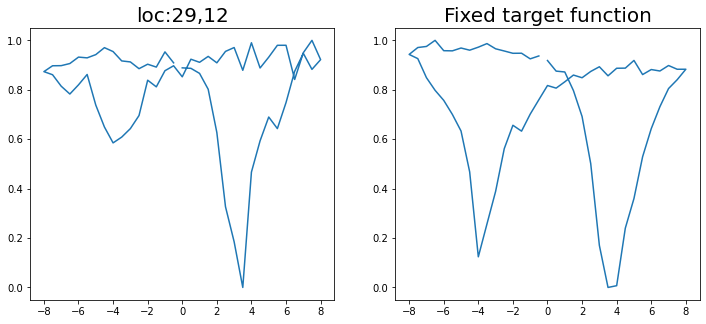

Epoch 1/200 ... Training loss: 3.001
Epoch 10/200 ... Training loss: 2.849
Epoch 20/200 ... Training loss: 2.7247
Epoch 30/200 ... Training loss: 2.578
Epoch 40/200 ... Training loss: 2.3006
Epoch 50/200 ... Training loss: 1.9748
Epoch 60/200 ... Training loss: 1.7883
Epoch 70/200 ... Training loss: 1.6138
Epoch 80/200 ... Training loss: 1.4855
Epoch 90/200 ... Training loss: 1.3337
Epoch 100/200 ... Training loss: 1.3661
Epoch 110/200 ... Training loss: 1.2544
Epoch 120/200 ... Training loss: 1.1805
Epoch 130/200 ... Training loss: 1.1995
Epoch 140/200 ... Training loss: 1.2013
Epoch 150/200 ... Training loss: 1.0955
Epoch 160/200 ... Training loss: 1.1175
Epoch 170/200 ... Training loss: 1.1262
Epoch 180/200 ... Training loss: 1.0339
Epoch 190/200 ... Training loss: 0.9814
Epoch 200/200 ... Training loss: 1.0283
step:  147
Sample #157




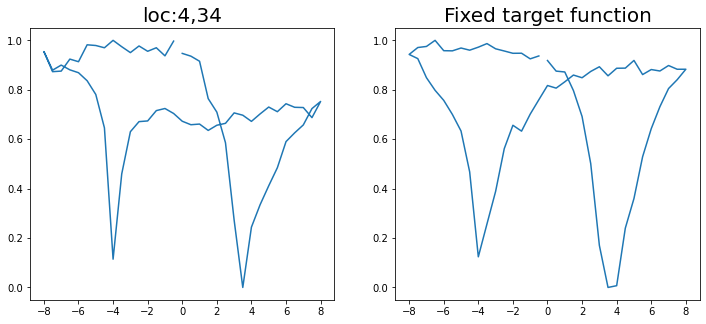

Epoch 1/200 ... Training loss: 2.9869
Epoch 10/200 ... Training loss: 2.8306
Epoch 20/200 ... Training loss: 2.6918
Epoch 30/200 ... Training loss: 2.561
Epoch 40/200 ... Training loss: 2.2837
Epoch 50/200 ... Training loss: 2.1721
Epoch 60/200 ... Training loss: 1.993
Epoch 70/200 ... Training loss: 1.7968
Epoch 80/200 ... Training loss: 1.6226
Epoch 90/200 ... Training loss: 1.596
Epoch 100/200 ... Training loss: 1.481
Epoch 110/200 ... Training loss: 1.3721
Epoch 120/200 ... Training loss: 1.3014
Epoch 130/200 ... Training loss: 1.2106
Epoch 140/200 ... Training loss: 1.2116
Epoch 150/200 ... Training loss: 1.1091
Epoch 160/200 ... Training loss: 1.2406
Epoch 170/200 ... Training loss: 1.0854
Epoch 180/200 ... Training loss: 1.0255
Epoch 190/200 ... Training loss: 1.0327
Epoch 200/200 ... Training loss: 0.985
step:  148
Sample #158




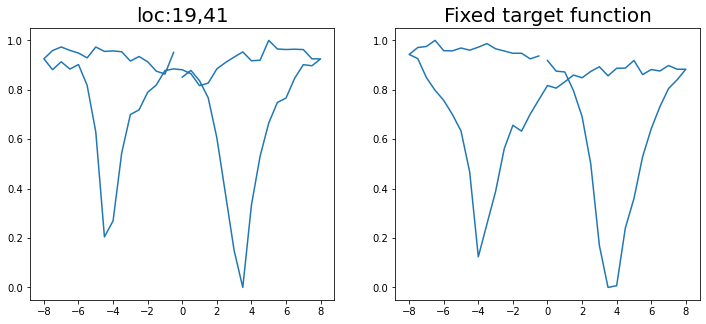

Epoch 1/200 ... Training loss: 2.9789
Epoch 10/200 ... Training loss: 2.8237
Epoch 20/200 ... Training loss: 2.4603
Epoch 30/200 ... Training loss: 2.3155
Epoch 40/200 ... Training loss: 2.1279
Epoch 50/200 ... Training loss: 1.8561
Epoch 60/200 ... Training loss: 1.6796
Epoch 70/200 ... Training loss: 1.5523
Epoch 80/200 ... Training loss: 1.4446
Epoch 90/200 ... Training loss: 1.3569
Epoch 100/200 ... Training loss: 1.3046
Epoch 110/200 ... Training loss: 1.2021
Epoch 120/200 ... Training loss: 1.1363
Epoch 130/200 ... Training loss: 1.1728
Epoch 140/200 ... Training loss: 1.0806
Epoch 150/200 ... Training loss: 1.0345
Epoch 160/200 ... Training loss: 1.0249
Epoch 170/200 ... Training loss: 0.9867
Epoch 180/200 ... Training loss: 0.9528
Epoch 190/200 ... Training loss: 0.9209
Epoch 200/200 ... Training loss: 0.8805
step:  149
Sample #159




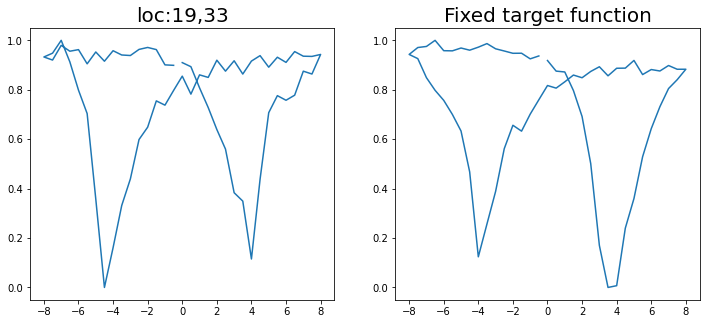

Epoch 1/200 ... Training loss: 2.9689
Epoch 10/200 ... Training loss: 2.8236
Epoch 20/200 ... Training loss: 2.6521
Epoch 30/200 ... Training loss: 2.4586
Epoch 40/200 ... Training loss: 2.1407
Epoch 50/200 ... Training loss: 1.7732
Epoch 60/200 ... Training loss: 1.5452
Epoch 70/200 ... Training loss: 1.4488
Epoch 80/200 ... Training loss: 1.3001
Epoch 90/200 ... Training loss: 1.2451
Epoch 100/200 ... Training loss: 1.2007
Epoch 110/200 ... Training loss: 1.2215
Epoch 120/200 ... Training loss: 1.1382
Epoch 130/200 ... Training loss: 1.1133
Epoch 140/200 ... Training loss: 1.1184
Epoch 150/200 ... Training loss: 1.0714
Epoch 160/200 ... Training loss: 1.0606
Epoch 170/200 ... Training loss: 0.9882
Epoch 180/200 ... Training loss: 1.0465
Epoch 190/200 ... Training loss: 0.9328
Epoch 200/200 ... Training loss: 0.8571
step:  150
Sample #160




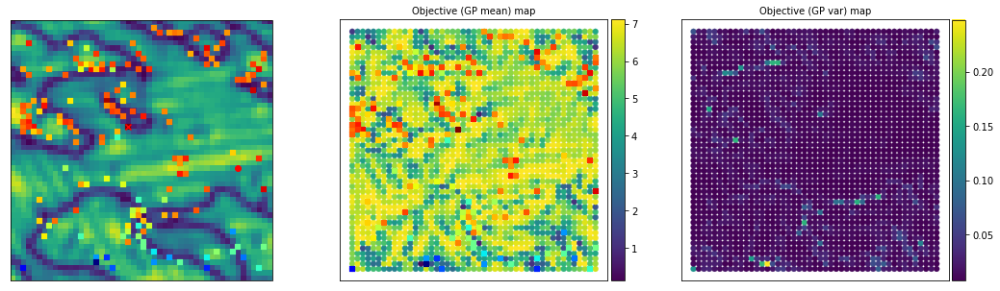

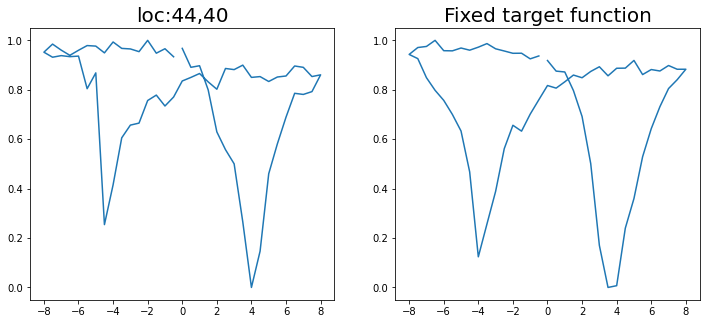

Epoch 1/200 ... Training loss: 2.9561
Epoch 10/200 ... Training loss: 2.8062
Epoch 20/200 ... Training loss: 2.6452
Epoch 30/200 ... Training loss: 2.3543
Epoch 40/200 ... Training loss: 2.2324
Epoch 50/200 ... Training loss: 2.0744
Epoch 60/200 ... Training loss: 1.8139
Epoch 70/200 ... Training loss: 1.688
Epoch 80/200 ... Training loss: 1.5811
Epoch 90/200 ... Training loss: 1.5332
Epoch 100/200 ... Training loss: 1.3704
Epoch 110/200 ... Training loss: 1.2583
Epoch 120/200 ... Training loss: 1.2411
Epoch 130/200 ... Training loss: 1.1312
Epoch 140/200 ... Training loss: 1.1158
Epoch 150/200 ... Training loss: 1.121
Epoch 160/200 ... Training loss: 1.0798
Epoch 170/200 ... Training loss: 1.0222
Epoch 180/200 ... Training loss: 0.9869
Epoch 190/200 ... Training loss: 0.9536
Epoch 200/200 ... Training loss: 0.9497
step:  151
Sample #161




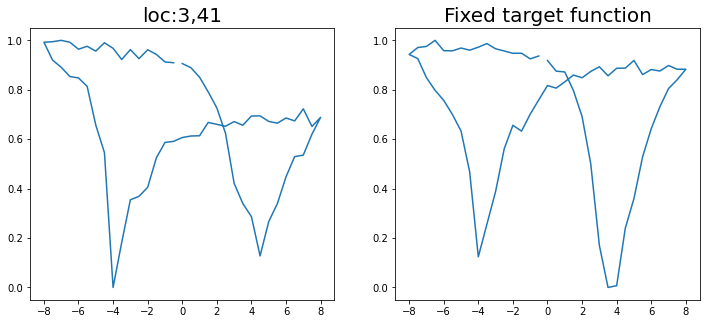

Epoch 1/200 ... Training loss: 2.9557
Epoch 10/200 ... Training loss: 2.785
Epoch 20/200 ... Training loss: 2.2372
Epoch 30/200 ... Training loss: 2.2125
Epoch 40/200 ... Training loss: 1.8911
Epoch 50/200 ... Training loss: 1.6869
Epoch 60/200 ... Training loss: 1.5258
Epoch 70/200 ... Training loss: 1.4354
Epoch 80/200 ... Training loss: 1.2947
Epoch 90/200 ... Training loss: 1.2566
Epoch 100/200 ... Training loss: 1.1704
Epoch 110/200 ... Training loss: 1.1169
Epoch 120/200 ... Training loss: 1.1559
Epoch 130/200 ... Training loss: 1.0377
Epoch 140/200 ... Training loss: 0.9932
Epoch 150/200 ... Training loss: 0.9698
Epoch 160/200 ... Training loss: 0.9345
Epoch 170/200 ... Training loss: 0.9622
Epoch 180/200 ... Training loss: 0.8717
Epoch 190/200 ... Training loss: 0.8954
Epoch 200/200 ... Training loss: 0.799
step:  152
Sample #162




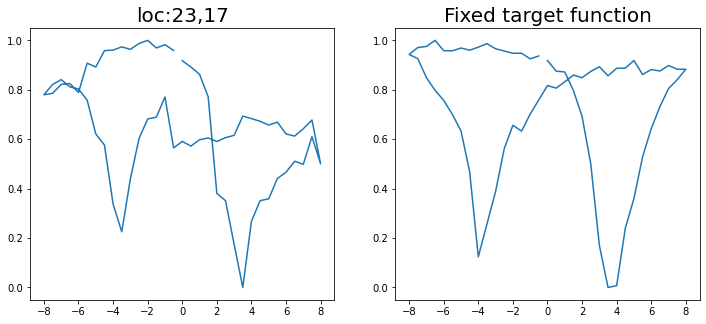

Epoch 1/200 ... Training loss: 2.9507
Epoch 10/200 ... Training loss: 2.8352
Epoch 20/200 ... Training loss: 2.672
Epoch 30/200 ... Training loss: 2.5437
Epoch 40/200 ... Training loss: 2.3069
Epoch 50/200 ... Training loss: 2.2387
Epoch 60/200 ... Training loss: 1.9851
Epoch 70/200 ... Training loss: 1.7504
Epoch 80/200 ... Training loss: 1.6043
Epoch 90/200 ... Training loss: 1.5679
Epoch 100/200 ... Training loss: 1.3898
Epoch 110/200 ... Training loss: 1.4588
Epoch 120/200 ... Training loss: 1.331
Epoch 130/200 ... Training loss: 1.2145
Epoch 140/200 ... Training loss: 1.1489
Epoch 150/200 ... Training loss: 1.1687
Epoch 160/200 ... Training loss: 1.0834
Epoch 170/200 ... Training loss: 1.0681
Epoch 180/200 ... Training loss: 1.0197
Epoch 190/200 ... Training loss: 0.9993
Epoch 200/200 ... Training loss: 0.9564
step:  153
Sample #163




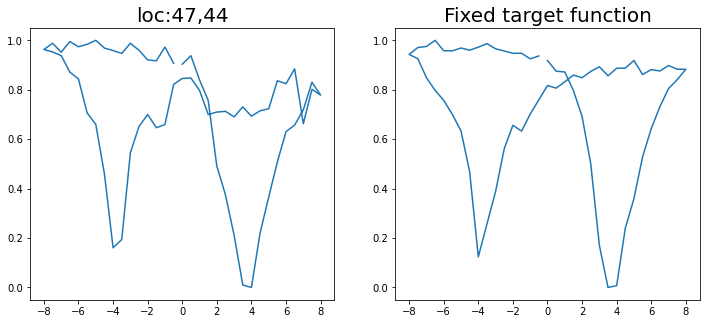

Epoch 1/200 ... Training loss: 2.9394
Epoch 10/200 ... Training loss: 2.796
Epoch 20/200 ... Training loss: 2.6587
Epoch 30/200 ... Training loss: 2.5117
Epoch 40/200 ... Training loss: 2.2349
Epoch 50/200 ... Training loss: 2.0646
Epoch 60/200 ... Training loss: 1.7166
Epoch 70/200 ... Training loss: 1.554
Epoch 80/200 ... Training loss: 1.4428
Epoch 90/200 ... Training loss: 1.3277
Epoch 100/200 ... Training loss: 1.2962
Epoch 110/200 ... Training loss: 1.1871
Epoch 120/200 ... Training loss: 1.2382
Epoch 130/200 ... Training loss: 1.1812
Epoch 140/200 ... Training loss: 1.1026
Epoch 150/200 ... Training loss: 1.0996
Epoch 160/200 ... Training loss: 1.0587
Epoch 170/200 ... Training loss: 1.0167
Epoch 180/200 ... Training loss: 1.0037
Epoch 190/200 ... Training loss: 0.9418
Epoch 200/200 ... Training loss: 0.9049
step:  154
Sample #164




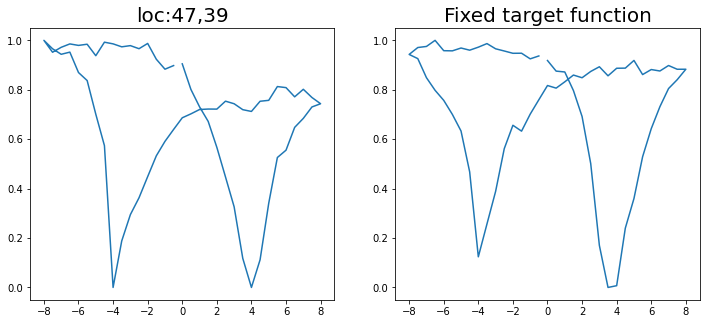

Epoch 1/200 ... Training loss: 2.9407
Epoch 10/200 ... Training loss: 2.8001
Epoch 20/200 ... Training loss: 2.664
Epoch 30/200 ... Training loss: 2.5884
Epoch 40/200 ... Training loss: 2.2999
Epoch 50/200 ... Training loss: 2.1365
Epoch 60/200 ... Training loss: 1.9235
Epoch 70/200 ... Training loss: 1.7233
Epoch 80/200 ... Training loss: 1.4778
Epoch 90/200 ... Training loss: 1.3793
Epoch 100/200 ... Training loss: 1.3074
Epoch 110/200 ... Training loss: 1.244
Epoch 120/200 ... Training loss: 1.1718
Epoch 130/200 ... Training loss: 1.1368
Epoch 140/200 ... Training loss: 1.1191
Epoch 150/200 ... Training loss: 1.0866
Epoch 160/200 ... Training loss: 1.0869
Epoch 170/200 ... Training loss: 1.038
Epoch 180/200 ... Training loss: 0.9842
Epoch 190/200 ... Training loss: 0.9626
Epoch 200/200 ... Training loss: 0.9585
step:  155
Sample #165




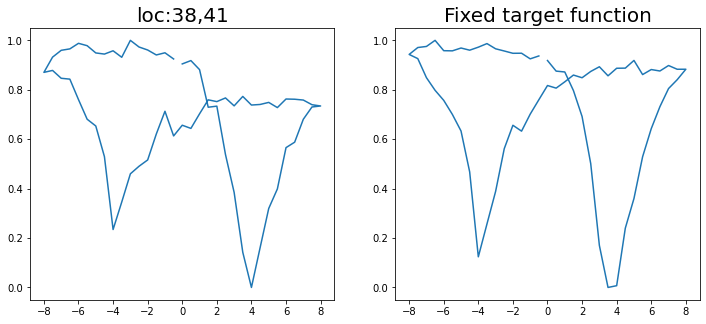

Epoch 1/200 ... Training loss: 2.9421
Epoch 10/200 ... Training loss: 2.8196
Epoch 20/200 ... Training loss: 2.6679
Epoch 30/200 ... Training loss: 2.5202
Epoch 40/200 ... Training loss: 2.3817
Epoch 50/200 ... Training loss: 2.2356
Epoch 60/200 ... Training loss: 1.9676
Epoch 70/200 ... Training loss: 1.7622
Epoch 80/200 ... Training loss: 1.625
Epoch 90/200 ... Training loss: 1.5121
Epoch 100/200 ... Training loss: 1.4307
Epoch 110/200 ... Training loss: 1.3787
Epoch 120/200 ... Training loss: 1.3485
Epoch 130/200 ... Training loss: 1.256
Epoch 140/200 ... Training loss: 1.203
Epoch 150/200 ... Training loss: 1.1926
Epoch 160/200 ... Training loss: 1.1818
Epoch 170/200 ... Training loss: 1.1955
Epoch 180/200 ... Training loss: 1.0916
Epoch 190/200 ... Training loss: 1.2377
Epoch 200/200 ... Training loss: 1.0997
step:  156
Sample #166




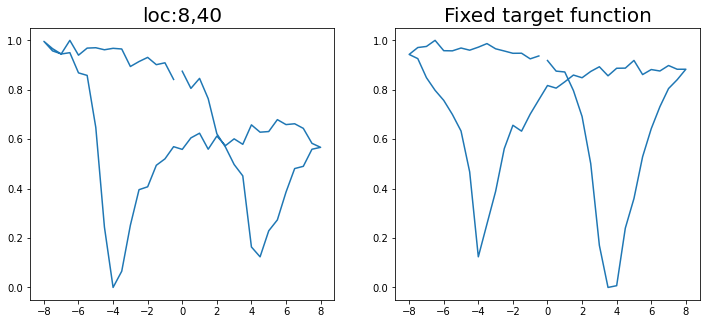

Epoch 1/200 ... Training loss: 2.9292
Epoch 10/200 ... Training loss: 2.8008
Epoch 20/200 ... Training loss: 2.6782
Epoch 30/200 ... Training loss: 2.5593
Epoch 40/200 ... Training loss: 2.4667
Epoch 50/200 ... Training loss: 2.4135
Epoch 60/200 ... Training loss: 2.3266
Epoch 70/200 ... Training loss: 2.1459
Epoch 80/200 ... Training loss: 2.0341
Epoch 90/200 ... Training loss: 1.8794
Epoch 100/200 ... Training loss: 1.7067
Epoch 110/200 ... Training loss: 1.5639
Epoch 120/200 ... Training loss: 1.461
Epoch 130/200 ... Training loss: 1.3442
Epoch 140/200 ... Training loss: 1.2858
Epoch 150/200 ... Training loss: 1.2225
Epoch 160/200 ... Training loss: 1.2431
Epoch 170/200 ... Training loss: 1.1502
Epoch 180/200 ... Training loss: 1.1704
Epoch 190/200 ... Training loss: 1.0932
Epoch 200/200 ... Training loss: 1.143
step:  157
Sample #167




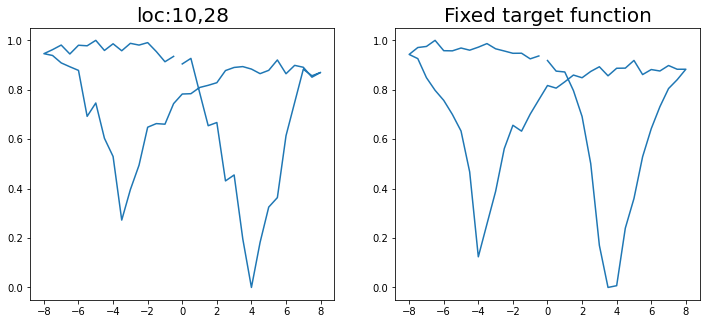

Epoch 1/200 ... Training loss: 2.9221
Epoch 10/200 ... Training loss: 2.7742
Epoch 20/200 ... Training loss: 2.6512
Epoch 30/200 ... Training loss: 2.4472
Epoch 40/200 ... Training loss: 2.2211
Epoch 50/200 ... Training loss: 2.0527
Epoch 60/200 ... Training loss: 1.7828
Epoch 70/200 ... Training loss: 1.645
Epoch 80/200 ... Training loss: 1.4654
Epoch 90/200 ... Training loss: 1.3801
Epoch 100/200 ... Training loss: 1.2709
Epoch 110/200 ... Training loss: 1.227
Epoch 120/200 ... Training loss: 1.2077
Epoch 130/200 ... Training loss: 1.1405
Epoch 140/200 ... Training loss: 1.1008
Epoch 150/200 ... Training loss: 1.0566
Epoch 160/200 ... Training loss: 1.0064
Epoch 170/200 ... Training loss: 1.0046
Epoch 180/200 ... Training loss: 0.9469
Epoch 190/200 ... Training loss: 0.9547
Epoch 200/200 ... Training loss: 0.8855
step:  158
Sample #168




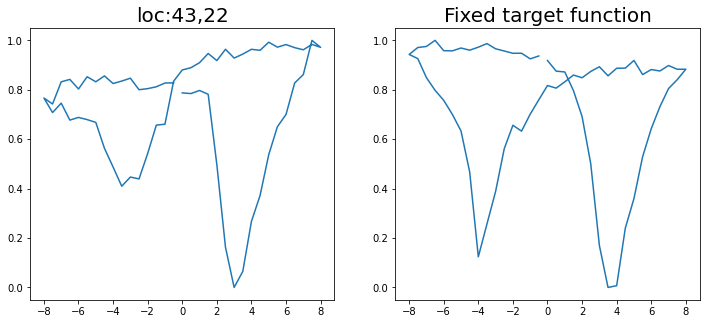

Epoch 1/200 ... Training loss: 2.9198
Epoch 10/200 ... Training loss: 2.7938
Epoch 20/200 ... Training loss: 2.6491
Epoch 30/200 ... Training loss: 2.5112
Epoch 40/200 ... Training loss: 2.281
Epoch 50/200 ... Training loss: 2.0609
Epoch 60/200 ... Training loss: 1.7983
Epoch 70/200 ... Training loss: 1.6486
Epoch 80/200 ... Training loss: 1.6224
Epoch 90/200 ... Training loss: 1.516
Epoch 100/200 ... Training loss: 1.3535
Epoch 110/200 ... Training loss: 1.2815
Epoch 120/200 ... Training loss: 1.2629
Epoch 130/200 ... Training loss: 1.215
Epoch 140/200 ... Training loss: 1.1523
Epoch 150/200 ... Training loss: 1.1531
Epoch 160/200 ... Training loss: 1.064
Epoch 170/200 ... Training loss: 1.0144
Epoch 180/200 ... Training loss: 1.0731
Epoch 190/200 ... Training loss: 0.9889
Epoch 200/200 ... Training loss: 0.9279
step:  159
Sample #169




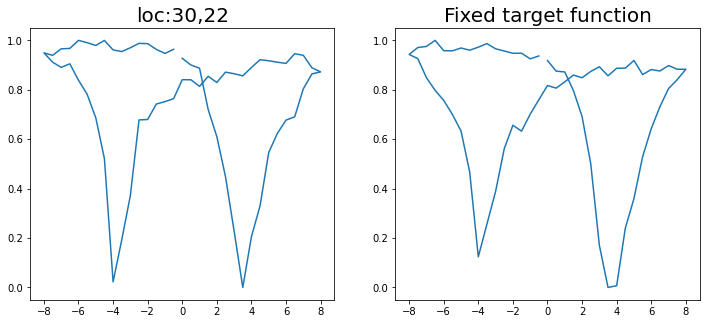

Epoch 1/200 ... Training loss: 2.9354
Epoch 10/200 ... Training loss: 2.8033
Epoch 20/200 ... Training loss: 2.671
Epoch 30/200 ... Training loss: 2.5576
Epoch 40/200 ... Training loss: 2.2367
Epoch 50/200 ... Training loss: 2.1582
Epoch 60/200 ... Training loss: 1.9203
Epoch 70/200 ... Training loss: 1.7112
Epoch 80/200 ... Training loss: 1.603
Epoch 90/200 ... Training loss: 1.5332
Epoch 100/200 ... Training loss: 1.5799
Epoch 110/200 ... Training loss: 1.4277
Epoch 120/200 ... Training loss: 1.391
Epoch 130/200 ... Training loss: 1.2361
Epoch 140/200 ... Training loss: 1.1542
Epoch 150/200 ... Training loss: 1.1718
Epoch 160/200 ... Training loss: 1.0652
Epoch 170/200 ... Training loss: 1.0418
Epoch 180/200 ... Training loss: 1.0217
Epoch 190/200 ... Training loss: 0.9891
Epoch 200/200 ... Training loss: 1.0217
step:  160
Sample #170




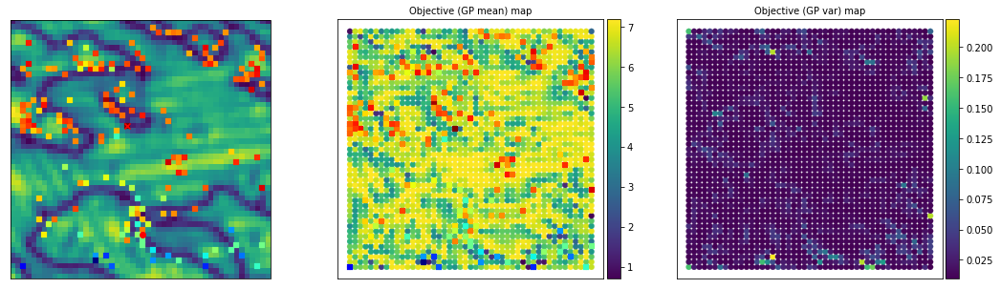

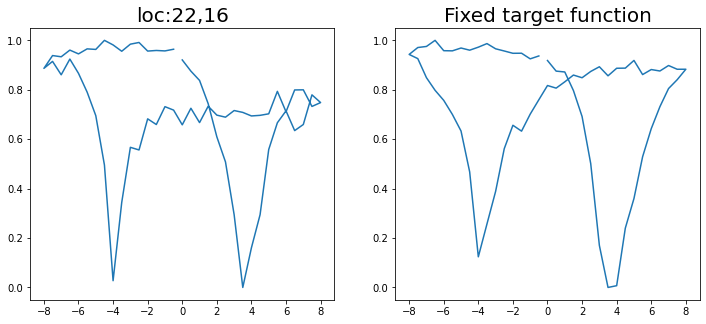

Epoch 1/200 ... Training loss: 2.9229
Epoch 10/200 ... Training loss: 2.7562
Epoch 20/200 ... Training loss: 2.6281
Epoch 30/200 ... Training loss: 2.5588
Epoch 40/200 ... Training loss: 2.4686
Epoch 50/200 ... Training loss: 2.3577
Epoch 60/200 ... Training loss: 2.1852
Epoch 70/200 ... Training loss: 2.0387
Epoch 80/200 ... Training loss: 1.7317
Epoch 90/200 ... Training loss: 1.6228
Epoch 100/200 ... Training loss: 1.4594
Epoch 110/200 ... Training loss: 1.3991
Epoch 120/200 ... Training loss: 1.3276
Epoch 130/200 ... Training loss: 1.2308
Epoch 140/200 ... Training loss: 1.2883
Epoch 150/200 ... Training loss: 1.1936
Epoch 160/200 ... Training loss: 1.1867
Epoch 170/200 ... Training loss: 1.1038
Epoch 180/200 ... Training loss: 1.1881
Epoch 190/200 ... Training loss: 1.0705
Epoch 200/200 ... Training loss: 1.0491
step:  161
Sample #171




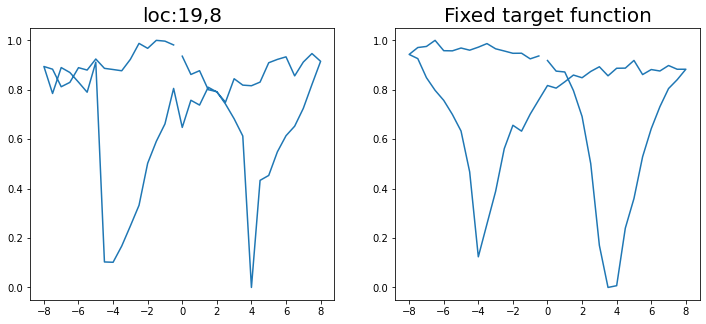

Epoch 1/200 ... Training loss: 2.9115
Epoch 10/200 ... Training loss: 2.7872
Epoch 20/200 ... Training loss: 2.6446
Epoch 30/200 ... Training loss: 2.5022
Epoch 40/200 ... Training loss: 2.3516
Epoch 50/200 ... Training loss: 2.1742
Epoch 60/200 ... Training loss: 1.8778
Epoch 70/200 ... Training loss: 1.6623
Epoch 80/200 ... Training loss: 1.5696
Epoch 90/200 ... Training loss: 1.3904
Epoch 100/200 ... Training loss: 1.3293
Epoch 110/200 ... Training loss: 1.2779
Epoch 120/200 ... Training loss: 1.2151
Epoch 130/200 ... Training loss: 1.1816
Epoch 140/200 ... Training loss: 1.2051
Epoch 150/200 ... Training loss: 1.1319
Epoch 160/200 ... Training loss: 1.0697
Epoch 170/200 ... Training loss: 1.0351
Epoch 180/200 ... Training loss: 1.0255
Epoch 190/200 ... Training loss: 1.0291
Epoch 200/200 ... Training loss: 0.953
step:  162
Sample #172




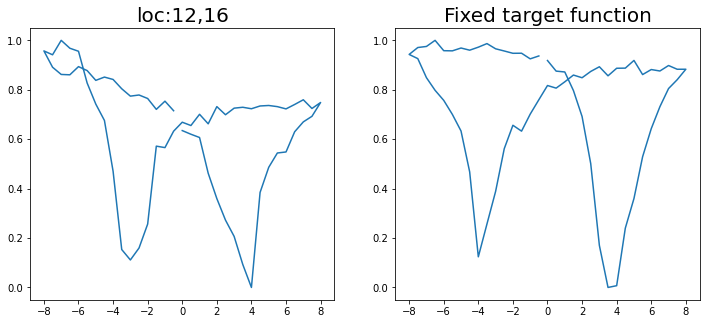

Epoch 1/200 ... Training loss: 2.8992
Epoch 10/200 ... Training loss: 2.7579
Epoch 20/200 ... Training loss: 2.6332
Epoch 30/200 ... Training loss: 2.5268
Epoch 40/200 ... Training loss: 2.4255
Epoch 50/200 ... Training loss: 2.2443
Epoch 60/200 ... Training loss: 2.1239
Epoch 70/200 ... Training loss: 2.0081
Epoch 80/200 ... Training loss: 1.7629
Epoch 90/200 ... Training loss: 1.6259
Epoch 100/200 ... Training loss: 1.6213
Epoch 110/200 ... Training loss: 1.5227
Epoch 120/200 ... Training loss: 1.4301
Epoch 130/200 ... Training loss: 1.3166
Epoch 140/200 ... Training loss: 1.2601
Epoch 150/200 ... Training loss: 1.1751
Epoch 160/200 ... Training loss: 1.1625
Epoch 170/200 ... Training loss: 1.1362
Epoch 180/200 ... Training loss: 1.1226
Epoch 190/200 ... Training loss: 1.0713
Epoch 200/200 ... Training loss: 1.1233
step:  163
Sample #173




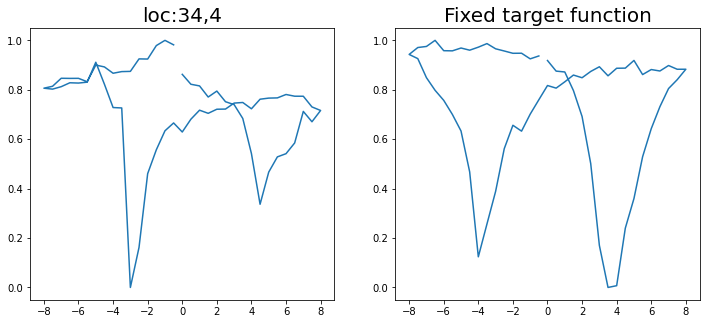

Epoch 1/200 ... Training loss: 2.9021
Epoch 10/200 ... Training loss: 2.7859
Epoch 20/200 ... Training loss: 2.6387
Epoch 30/200 ... Training loss: 2.5172
Epoch 40/200 ... Training loss: 2.4008
Epoch 50/200 ... Training loss: 2.2486
Epoch 60/200 ... Training loss: 1.9736
Epoch 70/200 ... Training loss: 1.7728
Epoch 80/200 ... Training loss: 1.6353
Epoch 90/200 ... Training loss: 1.5602
Epoch 100/200 ... Training loss: 1.4514
Epoch 110/200 ... Training loss: 1.3794
Epoch 120/200 ... Training loss: 1.3322
Epoch 130/200 ... Training loss: 1.2597
Epoch 140/200 ... Training loss: 1.2373
Epoch 150/200 ... Training loss: 1.3527
Epoch 160/200 ... Training loss: 1.3861
Epoch 170/200 ... Training loss: 1.2252
Epoch 180/200 ... Training loss: 1.1891
Epoch 190/200 ... Training loss: 1.1598
Epoch 200/200 ... Training loss: 1.0878
step:  164
Sample #174




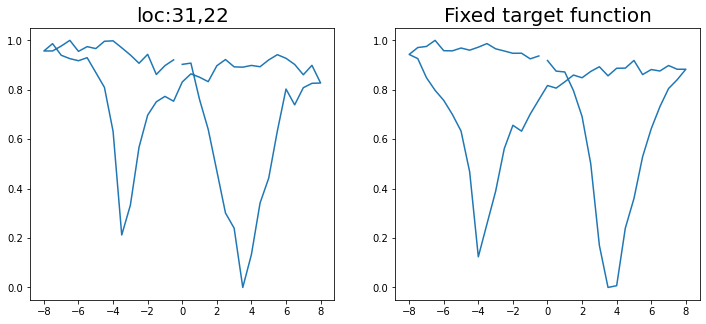

Epoch 1/200 ... Training loss: 2.8997
Epoch 10/200 ... Training loss: 2.7549
Epoch 20/200 ... Training loss: 2.6236
Epoch 30/200 ... Training loss: 2.2872
Epoch 40/200 ... Training loss: 2.1792
Epoch 50/200 ... Training loss: 1.9646
Epoch 60/200 ... Training loss: 1.7227
Epoch 70/200 ... Training loss: 1.6551
Epoch 80/200 ... Training loss: 1.5519
Epoch 90/200 ... Training loss: 1.4724
Epoch 100/200 ... Training loss: 1.5017
Epoch 110/200 ... Training loss: 1.3066
Epoch 120/200 ... Training loss: 1.3346
Epoch 130/200 ... Training loss: 1.2378
Epoch 140/200 ... Training loss: 1.1186
Epoch 150/200 ... Training loss: 1.079
Epoch 160/200 ... Training loss: 1.0705
Epoch 170/200 ... Training loss: 1.013
Epoch 180/200 ... Training loss: 1.0019
Epoch 190/200 ... Training loss: 0.9508
Epoch 200/200 ... Training loss: 0.9614
step:  165
Sample #175




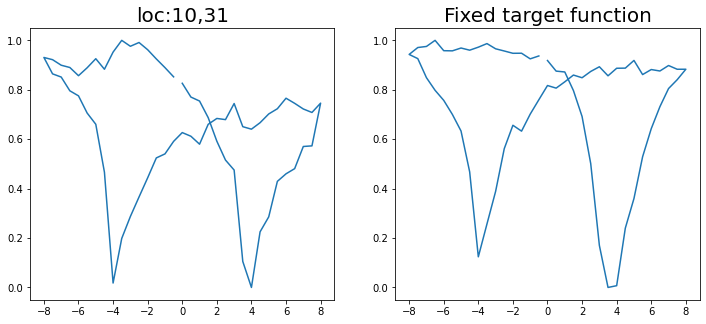

Epoch 1/200 ... Training loss: 2.8941
Epoch 10/200 ... Training loss: 2.7612
Epoch 20/200 ... Training loss: 2.6056
Epoch 30/200 ... Training loss: 2.4153
Epoch 40/200 ... Training loss: 2.1487
Epoch 50/200 ... Training loss: 1.8472
Epoch 60/200 ... Training loss: 1.6797
Epoch 70/200 ... Training loss: 1.5222
Epoch 80/200 ... Training loss: 1.46
Epoch 90/200 ... Training loss: 1.3233
Epoch 100/200 ... Training loss: 1.291
Epoch 110/200 ... Training loss: 1.2405
Epoch 120/200 ... Training loss: 1.1961
Epoch 130/200 ... Training loss: 1.1549
Epoch 140/200 ... Training loss: 1.0703
Epoch 150/200 ... Training loss: 1.0522
Epoch 160/200 ... Training loss: 1.0218
Epoch 170/200 ... Training loss: 1.0146
Epoch 180/200 ... Training loss: 1.0017
Epoch 190/200 ... Training loss: 0.9254
Epoch 200/200 ... Training loss: 0.9289
step:  166
Sample #176




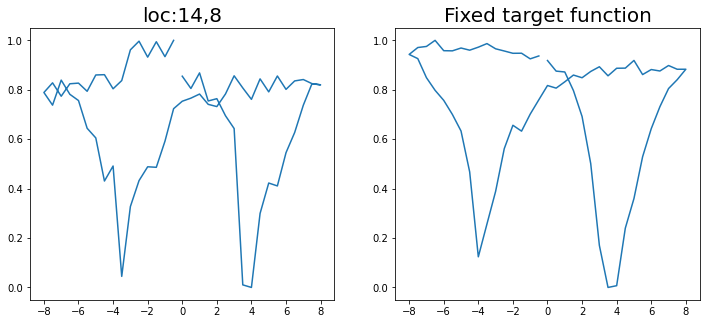

Epoch 1/200 ... Training loss: 2.8819
Epoch 10/200 ... Training loss: 2.7469
Epoch 20/200 ... Training loss: 2.5919
Epoch 30/200 ... Training loss: 2.3439
Epoch 40/200 ... Training loss: 2.1038
Epoch 50/200 ... Training loss: 1.8161
Epoch 60/200 ... Training loss: 1.6998
Epoch 70/200 ... Training loss: 1.5876
Epoch 80/200 ... Training loss: 1.6423
Epoch 90/200 ... Training loss: 1.3336
Epoch 100/200 ... Training loss: 1.2291
Epoch 110/200 ... Training loss: 1.2304
Epoch 120/200 ... Training loss: 1.1727
Epoch 130/200 ... Training loss: 1.1284
Epoch 140/200 ... Training loss: 1.0917
Epoch 150/200 ... Training loss: 1.047
Epoch 160/200 ... Training loss: 1.0504
Epoch 170/200 ... Training loss: 1.0252
Epoch 180/200 ... Training loss: 1.0004
Epoch 190/200 ... Training loss: 0.963
Epoch 200/200 ... Training loss: 0.9551
step:  167
Sample #177




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


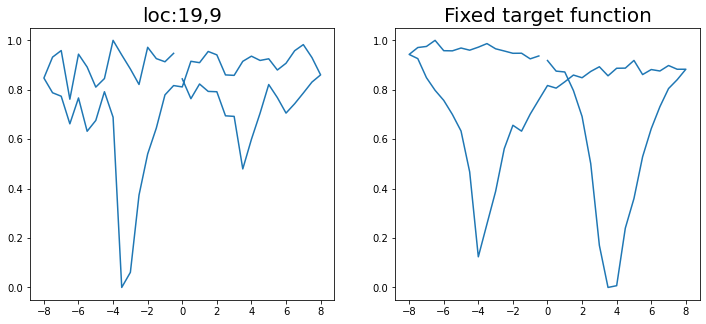

Epoch 1/200 ... Training loss: 2.8749
Epoch 10/200 ... Training loss: 2.7322
Epoch 20/200 ... Training loss: 2.6088
Epoch 30/200 ... Training loss: 2.481
Epoch 40/200 ... Training loss: 2.1988
Epoch 50/200 ... Training loss: 2.0907
Epoch 60/200 ... Training loss: 1.8786
Epoch 70/200 ... Training loss: 1.6464
Epoch 80/200 ... Training loss: 1.5809
Epoch 90/200 ... Training loss: 1.4306
Epoch 100/200 ... Training loss: 1.4723
Epoch 110/200 ... Training loss: 1.3278
Epoch 120/200 ... Training loss: 1.2316
Epoch 130/200 ... Training loss: 1.2104
Epoch 140/200 ... Training loss: 1.1575
Epoch 150/200 ... Training loss: 1.1029
Epoch 160/200 ... Training loss: 1.1336
Epoch 170/200 ... Training loss: 1.0773
Epoch 180/200 ... Training loss: 1.0497
Epoch 190/200 ... Training loss: 1.0877
Epoch 200/200 ... Training loss: 0.9884
step:  168
Sample #178




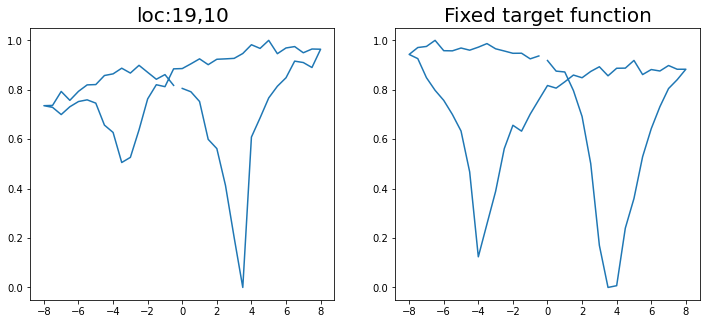

Epoch 1/200 ... Training loss: 2.8657
Epoch 10/200 ... Training loss: 2.7256
Epoch 20/200 ... Training loss: 2.2901
Epoch 30/200 ... Training loss: 2.2275
Epoch 40/200 ... Training loss: 1.9243
Epoch 50/200 ... Training loss: 1.7213
Epoch 60/200 ... Training loss: 1.6036
Epoch 70/200 ... Training loss: 1.4512
Epoch 80/200 ... Training loss: 1.5722
Epoch 90/200 ... Training loss: 1.4437
Epoch 100/200 ... Training loss: 1.3296
Epoch 110/200 ... Training loss: 1.4013
Epoch 120/200 ... Training loss: 1.2134
Epoch 130/200 ... Training loss: 1.1262
Epoch 140/200 ... Training loss: 1.0681
Epoch 150/200 ... Training loss: 1.0353
Epoch 160/200 ... Training loss: 0.9654
Epoch 170/200 ... Training loss: 0.9942
Epoch 180/200 ... Training loss: 0.9389
Epoch 190/200 ... Training loss: 0.9203
Epoch 200/200 ... Training loss: 0.8467
step:  169
Sample #179




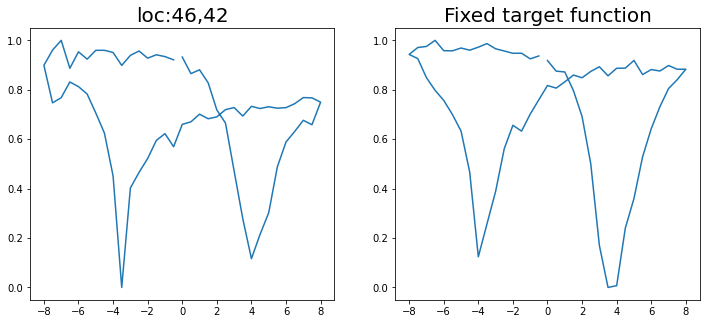

Epoch 1/200 ... Training loss: 2.8612
Epoch 10/200 ... Training loss: 2.7435
Epoch 20/200 ... Training loss: 2.611
Epoch 30/200 ... Training loss: 2.5068
Epoch 40/200 ... Training loss: 2.4197
Epoch 50/200 ... Training loss: 2.3438
Epoch 60/200 ... Training loss: 2.2316
Epoch 70/200 ... Training loss: 2.0555
Epoch 80/200 ... Training loss: 1.9077
Epoch 90/200 ... Training loss: 1.695
Epoch 100/200 ... Training loss: 1.6078
Epoch 110/200 ... Training loss: 1.497
Epoch 120/200 ... Training loss: 1.4503
Epoch 130/200 ... Training loss: 1.4454
Epoch 140/200 ... Training loss: 1.313
Epoch 150/200 ... Training loss: 1.2473
Epoch 160/200 ... Training loss: 1.1945
Epoch 170/200 ... Training loss: 1.147
Epoch 180/200 ... Training loss: 1.1135
Epoch 190/200 ... Training loss: 1.1681
Epoch 200/200 ... Training loss: 1.0792
step:  170
Sample #180




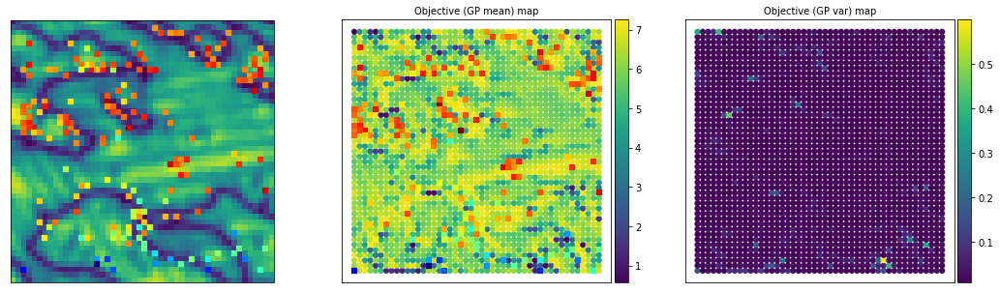

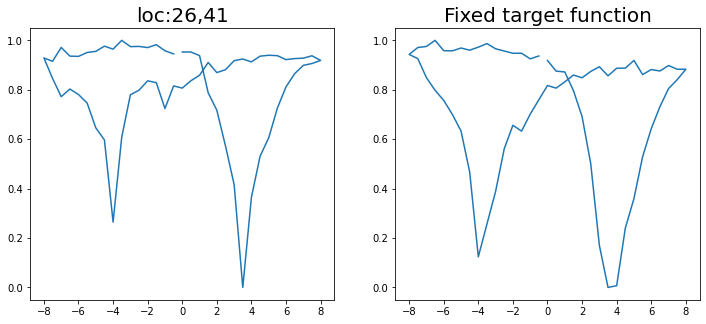

Epoch 1/200 ... Training loss: 2.8597
Epoch 10/200 ... Training loss: 2.7352
Epoch 20/200 ... Training loss: 2.5902
Epoch 30/200 ... Training loss: 2.442
Epoch 40/200 ... Training loss: 2.3253
Epoch 50/200 ... Training loss: 2.1806
Epoch 60/200 ... Training loss: 1.9228
Epoch 70/200 ... Training loss: 1.7202
Epoch 80/200 ... Training loss: 1.5612
Epoch 90/200 ... Training loss: 1.471
Epoch 100/200 ... Training loss: 1.35
Epoch 110/200 ... Training loss: 1.3869
Epoch 120/200 ... Training loss: 1.2462
Epoch 130/200 ... Training loss: 1.2015
Epoch 140/200 ... Training loss: 1.1427
Epoch 150/200 ... Training loss: 1.1121
Epoch 160/200 ... Training loss: 1.0759
Epoch 170/200 ... Training loss: 1.0465
Epoch 180/200 ... Training loss: 1.0203
Epoch 190/200 ... Training loss: 1.0053
Epoch 200/200 ... Training loss: 0.9643
step:  171
Sample #181




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


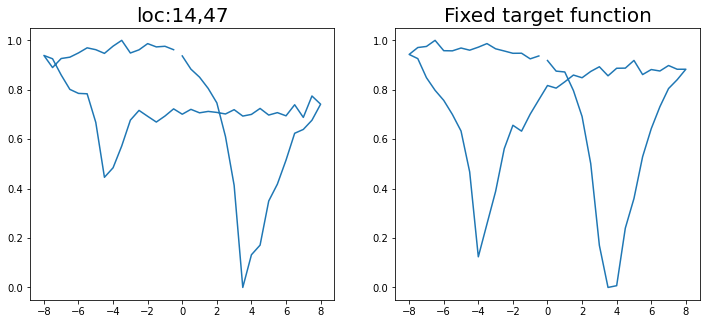

Epoch 1/200 ... Training loss: 2.8504
Epoch 10/200 ... Training loss: 2.7079
Epoch 20/200 ... Training loss: 2.5863
Epoch 30/200 ... Training loss: 2.4747
Epoch 40/200 ... Training loss: 2.2566
Epoch 50/200 ... Training loss: 2.098
Epoch 60/200 ... Training loss: 1.8575
Epoch 70/200 ... Training loss: 1.669
Epoch 80/200 ... Training loss: 1.5863
Epoch 90/200 ... Training loss: 1.432
Epoch 100/200 ... Training loss: 1.325
Epoch 110/200 ... Training loss: 1.3034
Epoch 120/200 ... Training loss: 1.2815
Epoch 130/200 ... Training loss: 1.1937
Epoch 140/200 ... Training loss: 1.1641
Epoch 150/200 ... Training loss: 1.1359
Epoch 160/200 ... Training loss: 1.0831
Epoch 170/200 ... Training loss: 1.0475
Epoch 180/200 ... Training loss: 1.063
Epoch 190/200 ... Training loss: 1.0077
Epoch 200/200 ... Training loss: 1.0233
step:  172
Sample #182




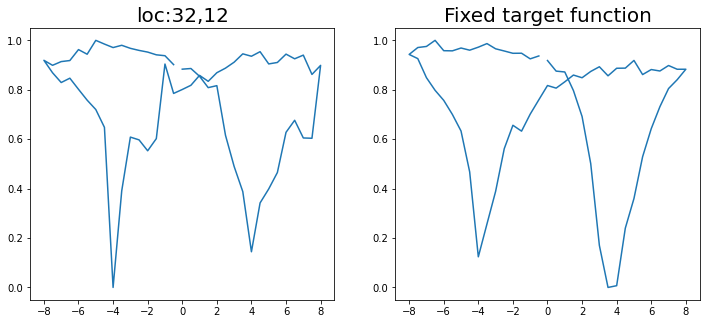

Epoch 1/200 ... Training loss: 2.8418
Epoch 10/200 ... Training loss: 2.713
Epoch 20/200 ... Training loss: 2.5617
Epoch 30/200 ... Training loss: 2.3819
Epoch 40/200 ... Training loss: 2.1051
Epoch 50/200 ... Training loss: 1.8522
Epoch 60/200 ... Training loss: 1.6339
Epoch 70/200 ... Training loss: 1.6208
Epoch 80/200 ... Training loss: 1.5202
Epoch 90/200 ... Training loss: 1.3586
Epoch 100/200 ... Training loss: 1.2691
Epoch 110/200 ... Training loss: 1.3184
Epoch 120/200 ... Training loss: 1.2331
Epoch 130/200 ... Training loss: 1.1595
Epoch 140/200 ... Training loss: 1.1605
Epoch 150/200 ... Training loss: 1.0752
Epoch 160/200 ... Training loss: 1.018
Epoch 170/200 ... Training loss: 1.0229
Epoch 180/200 ... Training loss: 1.0076
Epoch 190/200 ... Training loss: 1.0389
Epoch 200/200 ... Training loss: 0.9189
step:  173
Sample #183




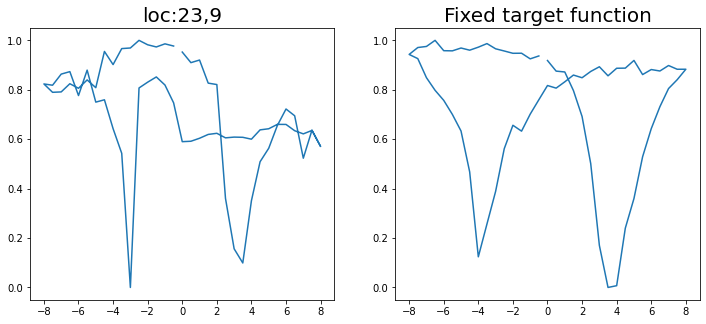

Epoch 1/200 ... Training loss: 2.8689
Epoch 10/200 ... Training loss: 2.7371
Epoch 20/200 ... Training loss: 2.5937
Epoch 30/200 ... Training loss: 2.4012
Epoch 40/200 ... Training loss: 2.0456
Epoch 50/200 ... Training loss: 1.9448
Epoch 60/200 ... Training loss: 1.7348
Epoch 70/200 ... Training loss: 1.5028
Epoch 80/200 ... Training loss: 1.5588
Epoch 90/200 ... Training loss: 1.3067
Epoch 100/200 ... Training loss: 1.384
Epoch 110/200 ... Training loss: 1.3477
Epoch 120/200 ... Training loss: 1.1979
Epoch 130/200 ... Training loss: 1.1433
Epoch 140/200 ... Training loss: 1.1561
Epoch 150/200 ... Training loss: 1.0653
Epoch 160/200 ... Training loss: 1.1222
Epoch 170/200 ... Training loss: 0.9848
Epoch 180/200 ... Training loss: 1.1461
Epoch 190/200 ... Training loss: 0.9897
Epoch 200/200 ... Training loss: 0.9402
step:  174
Sample #184




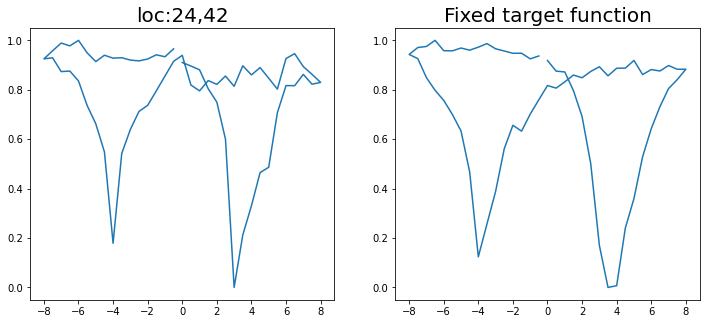

Epoch 1/200 ... Training loss: 2.8577
Epoch 10/200 ... Training loss: 2.7102
Epoch 20/200 ... Training loss: 2.5901
Epoch 30/200 ... Training loss: 2.4575
Epoch 40/200 ... Training loss: 2.2101
Epoch 50/200 ... Training loss: 2.0932
Epoch 60/200 ... Training loss: 1.8653
Epoch 70/200 ... Training loss: 1.6903
Epoch 80/200 ... Training loss: 1.6079
Epoch 90/200 ... Training loss: 1.563
Epoch 100/200 ... Training loss: 1.5026
Epoch 110/200 ... Training loss: 1.43
Epoch 120/200 ... Training loss: 1.2982
Epoch 130/200 ... Training loss: 1.2139
Epoch 140/200 ... Training loss: 1.182
Epoch 150/200 ... Training loss: 1.1576
Epoch 160/200 ... Training loss: 1.1423
Epoch 170/200 ... Training loss: 1.0657
Epoch 180/200 ... Training loss: 1.0377
Epoch 190/200 ... Training loss: 1.0212
Epoch 200/200 ... Training loss: 1.0043
step:  175
Sample #185




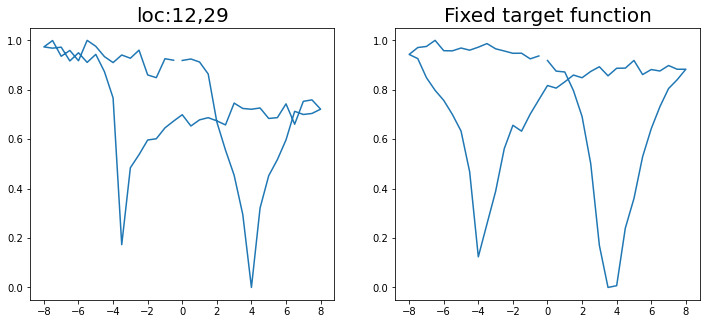

Epoch 1/200 ... Training loss: 2.8463
Epoch 10/200 ... Training loss: 2.7138
Epoch 20/200 ... Training loss: 2.5567
Epoch 30/200 ... Training loss: 2.3262
Epoch 40/200 ... Training loss: 2.0016
Epoch 50/200 ... Training loss: 1.7408
Epoch 60/200 ... Training loss: 1.5675
Epoch 70/200 ... Training loss: 1.3742
Epoch 80/200 ... Training loss: 1.3605
Epoch 90/200 ... Training loss: 1.3109
Epoch 100/200 ... Training loss: 1.2808
Epoch 110/200 ... Training loss: 1.163
Epoch 120/200 ... Training loss: 1.1004
Epoch 130/200 ... Training loss: 1.0876
Epoch 140/200 ... Training loss: 1.0585
Epoch 150/200 ... Training loss: 1.0003
Epoch 160/200 ... Training loss: 1.0146
Epoch 170/200 ... Training loss: 0.9592
Epoch 180/200 ... Training loss: 0.9371
Epoch 190/200 ... Training loss: 0.9377
Epoch 200/200 ... Training loss: 0.8503
step:  176
Sample #186




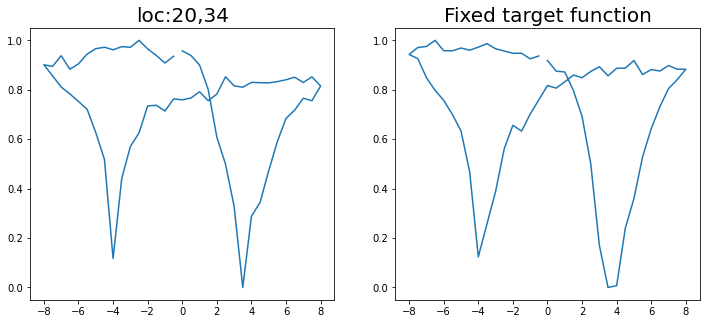

Epoch 1/200 ... Training loss: 2.8444
Epoch 10/200 ... Training loss: 2.7199
Epoch 20/200 ... Training loss: 2.5688
Epoch 30/200 ... Training loss: 2.4049
Epoch 40/200 ... Training loss: 2.1972
Epoch 50/200 ... Training loss: 1.9743
Epoch 60/200 ... Training loss: 1.7593
Epoch 70/200 ... Training loss: 1.5678
Epoch 80/200 ... Training loss: 1.4807
Epoch 90/200 ... Training loss: 1.3765
Epoch 100/200 ... Training loss: 1.4414
Epoch 110/200 ... Training loss: 1.371
Epoch 120/200 ... Training loss: 1.4366
Epoch 130/200 ... Training loss: 1.233
Epoch 140/200 ... Training loss: 1.1742
Epoch 150/200 ... Training loss: 1.1445
Epoch 160/200 ... Training loss: 1.1596
Epoch 170/200 ... Training loss: 1.1218
Epoch 180/200 ... Training loss: 0.997
Epoch 190/200 ... Training loss: 0.9432
Epoch 200/200 ... Training loss: 0.9737
step:  177
Sample #187




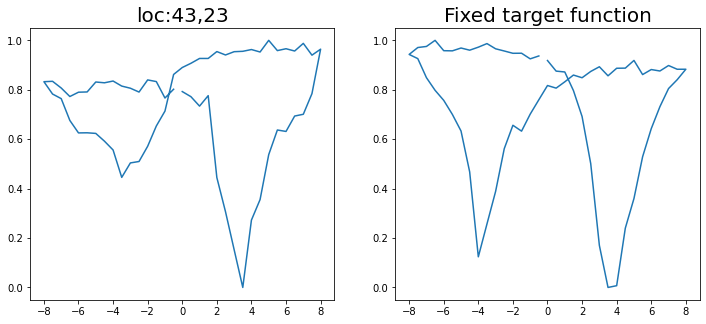

Epoch 1/200 ... Training loss: 2.8426
Epoch 10/200 ... Training loss: 2.7013
Epoch 20/200 ... Training loss: 2.3875
Epoch 30/200 ... Training loss: 2.2704
Epoch 40/200 ... Training loss: 2.0398
Epoch 50/200 ... Training loss: 1.767
Epoch 60/200 ... Training loss: 1.6969
Epoch 70/200 ... Training loss: 1.4224
Epoch 80/200 ... Training loss: 1.3419
Epoch 90/200 ... Training loss: 1.2375
Epoch 100/200 ... Training loss: 1.3516
Epoch 110/200 ... Training loss: 1.1833
Epoch 120/200 ... Training loss: 1.1041
Epoch 130/200 ... Training loss: 1.078
Epoch 140/200 ... Training loss: 1.1276
Epoch 150/200 ... Training loss: 1.0262
Epoch 160/200 ... Training loss: 0.9596
Epoch 170/200 ... Training loss: 1.0461
Epoch 180/200 ... Training loss: 0.915
Epoch 190/200 ... Training loss: 0.9136
Epoch 200/200 ... Training loss: 0.9139
step:  178
Sample #188




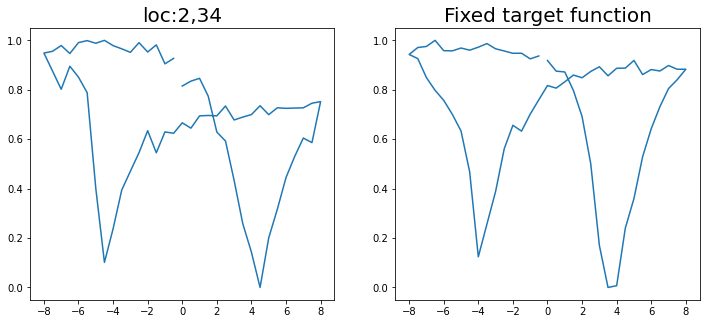

Epoch 1/200 ... Training loss: 2.8353
Epoch 10/200 ... Training loss: 2.6954
Epoch 20/200 ... Training loss: 2.5638
Epoch 30/200 ... Training loss: 2.3015
Epoch 40/200 ... Training loss: 2.1122
Epoch 50/200 ... Training loss: 1.8677
Epoch 60/200 ... Training loss: 1.6954
Epoch 70/200 ... Training loss: 1.5541
Epoch 80/200 ... Training loss: 1.4207
Epoch 90/200 ... Training loss: 1.3122
Epoch 100/200 ... Training loss: 1.2758
Epoch 110/200 ... Training loss: 1.181
Epoch 120/200 ... Training loss: 1.1528
Epoch 130/200 ... Training loss: 1.1059
Epoch 140/200 ... Training loss: 1.0727
Epoch 150/200 ... Training loss: 1.0556
Epoch 160/200 ... Training loss: 1.0804
Epoch 170/200 ... Training loss: 0.978
Epoch 180/200 ... Training loss: 1.1078
Epoch 190/200 ... Training loss: 0.9919
Epoch 200/200 ... Training loss: 0.9146
step:  179
Sample #189




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


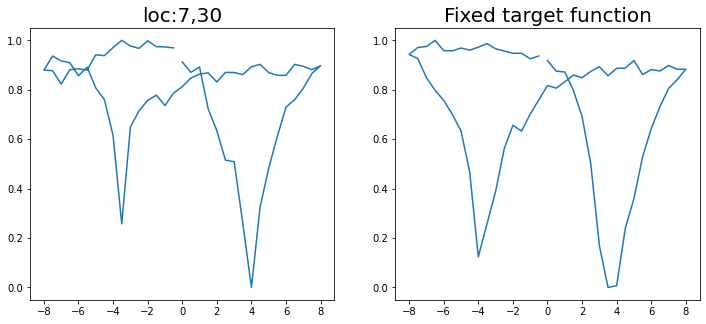

Epoch 1/200 ... Training loss: 2.8268
Epoch 10/200 ... Training loss: 2.6876
Epoch 20/200 ... Training loss: 2.5721
Epoch 30/200 ... Training loss: 2.4756
Epoch 40/200 ... Training loss: 2.3935
Epoch 50/200 ... Training loss: 2.3165
Epoch 60/200 ... Training loss: 2.1596
Epoch 70/200 ... Training loss: 2.0847
Epoch 80/200 ... Training loss: 1.9729
Epoch 90/200 ... Training loss: 1.7627
Epoch 100/200 ... Training loss: 1.6449
Epoch 110/200 ... Training loss: 1.5691
Epoch 120/200 ... Training loss: 1.4686
Epoch 130/200 ... Training loss: 1.415
Epoch 140/200 ... Training loss: 1.3244
Epoch 150/200 ... Training loss: 1.3278
Epoch 160/200 ... Training loss: 1.2352
Epoch 170/200 ... Training loss: 1.1757
Epoch 180/200 ... Training loss: 1.1569
Epoch 190/200 ... Training loss: 1.0904
Epoch 200/200 ... Training loss: 1.0948
step:  180
Sample #190




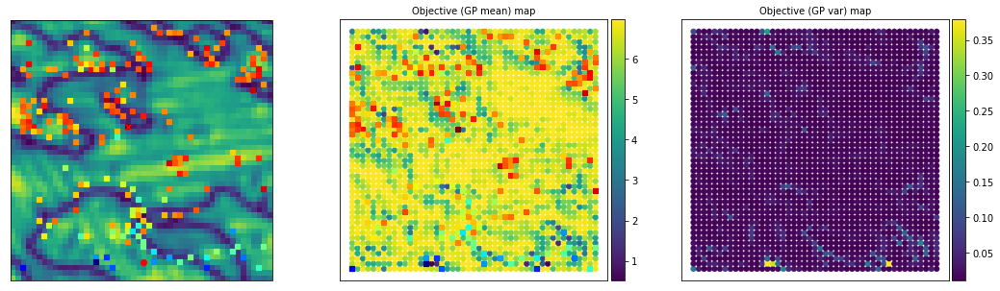

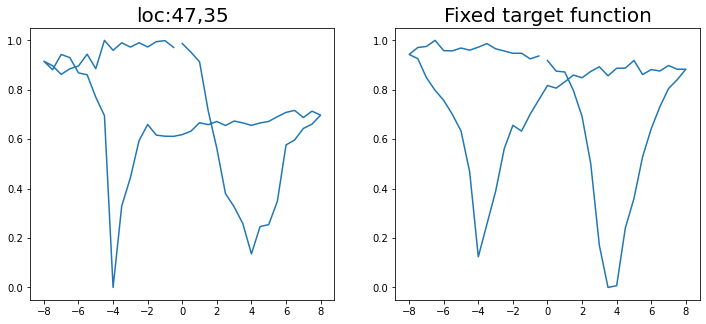

Epoch 1/200 ... Training loss: 2.8158
Epoch 10/200 ... Training loss: 2.6774
Epoch 20/200 ... Training loss: 2.5363
Epoch 30/200 ... Training loss: 2.3381
Epoch 40/200 ... Training loss: 2.2083
Epoch 50/200 ... Training loss: 2.0853
Epoch 60/200 ... Training loss: 1.9219
Epoch 70/200 ... Training loss: 1.7343
Epoch 80/200 ... Training loss: 1.714
Epoch 90/200 ... Training loss: 1.4621
Epoch 100/200 ... Training loss: 1.347
Epoch 110/200 ... Training loss: 1.2957
Epoch 120/200 ... Training loss: 1.2187
Epoch 130/200 ... Training loss: 1.2111
Epoch 140/200 ... Training loss: 1.1357
Epoch 150/200 ... Training loss: 1.1169
Epoch 160/200 ... Training loss: 1.0671
Epoch 170/200 ... Training loss: 1.0077
Epoch 180/200 ... Training loss: 0.9755
Epoch 190/200 ... Training loss: 0.9592
Epoch 200/200 ... Training loss: 0.9242
step:  181
Sample #191




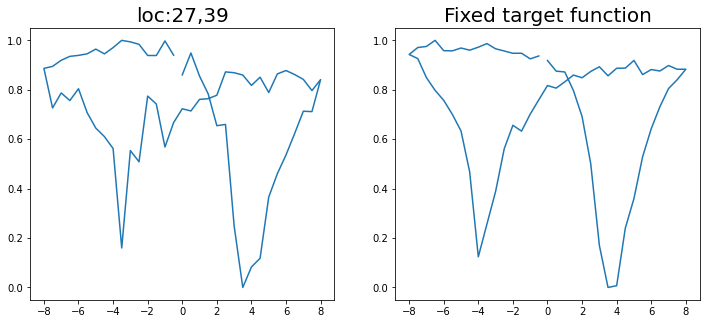

Epoch 1/200 ... Training loss: 2.8055
Epoch 10/200 ... Training loss: 2.667
Epoch 20/200 ... Training loss: 2.5161
Epoch 30/200 ... Training loss: 2.2596
Epoch 40/200 ... Training loss: 2.0706
Epoch 50/200 ... Training loss: 1.8626
Epoch 60/200 ... Training loss: 1.7242
Epoch 70/200 ... Training loss: 1.6297
Epoch 80/200 ... Training loss: 1.5426
Epoch 90/200 ... Training loss: 1.4807
Epoch 100/200 ... Training loss: 1.3967
Epoch 110/200 ... Training loss: 1.3676
Epoch 120/200 ... Training loss: 1.2769
Epoch 130/200 ... Training loss: 1.1967
Epoch 140/200 ... Training loss: 1.142
Epoch 150/200 ... Training loss: 1.1486
Epoch 160/200 ... Training loss: 1.0824
Epoch 170/200 ... Training loss: 1.0818
Epoch 180/200 ... Training loss: 1.0406
Epoch 190/200 ... Training loss: 0.9705
Epoch 200/200 ... Training loss: 1.0395
step:  182
Sample #192




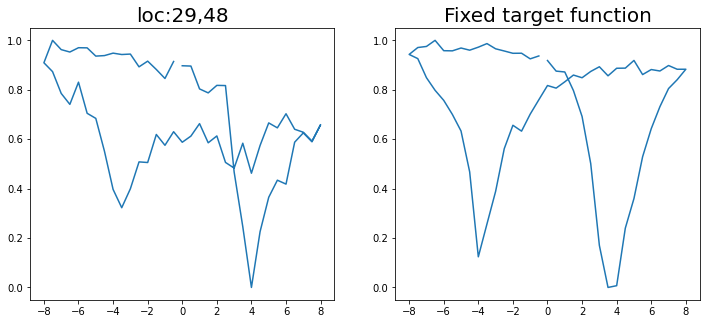

Epoch 1/200 ... Training loss: 2.7949
Epoch 10/200 ... Training loss: 2.6598
Epoch 20/200 ... Training loss: 2.4238
Epoch 30/200 ... Training loss: 2.2167
Epoch 40/200 ... Training loss: 2.0888
Epoch 50/200 ... Training loss: 1.8282
Epoch 60/200 ... Training loss: 1.7104
Epoch 70/200 ... Training loss: 1.6208
Epoch 80/200 ... Training loss: 1.664
Epoch 90/200 ... Training loss: 1.5019
Epoch 100/200 ... Training loss: 1.3269
Epoch 110/200 ... Training loss: 1.2537
Epoch 120/200 ... Training loss: 1.2101
Epoch 130/200 ... Training loss: 1.1242
Epoch 140/200 ... Training loss: 1.2023
Epoch 150/200 ... Training loss: 1.0917
Epoch 160/200 ... Training loss: 1.0315
Epoch 170/200 ... Training loss: 1.0104
Epoch 180/200 ... Training loss: 0.9724
Epoch 190/200 ... Training loss: 1.0186
Epoch 200/200 ... Training loss: 0.9177
step:  183
Sample #193




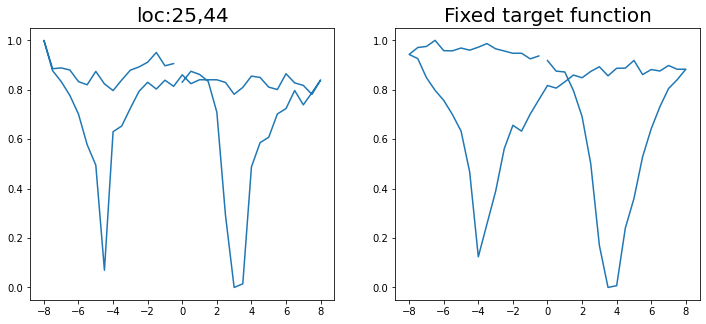

Epoch 1/200 ... Training loss: 2.7912
Epoch 10/200 ... Training loss: 2.6598
Epoch 20/200 ... Training loss: 2.5294
Epoch 30/200 ... Training loss: 2.3905
Epoch 40/200 ... Training loss: 2.2347
Epoch 50/200 ... Training loss: 2.0539
Epoch 60/200 ... Training loss: 1.8037
Epoch 70/200 ... Training loss: 1.6358
Epoch 80/200 ... Training loss: 1.4716
Epoch 90/200 ... Training loss: 1.4092
Epoch 100/200 ... Training loss: 1.4578
Epoch 110/200 ... Training loss: 1.3769
Epoch 120/200 ... Training loss: 1.2168
Epoch 130/200 ... Training loss: 1.1543
Epoch 140/200 ... Training loss: 1.2179
Epoch 150/200 ... Training loss: 1.0911
Epoch 160/200 ... Training loss: 1.0321
Epoch 170/200 ... Training loss: 1.1837
Epoch 180/200 ... Training loss: 1.0358
Epoch 190/200 ... Training loss: 1.017
Epoch 200/200 ... Training loss: 0.9415
step:  184
Sample #194




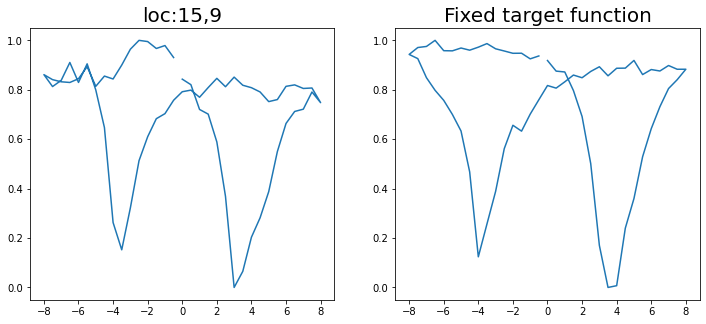

Epoch 1/200 ... Training loss: 2.7807
Epoch 10/200 ... Training loss: 2.6499
Epoch 20/200 ... Training loss: 2.5355
Epoch 30/200 ... Training loss: 2.4417
Epoch 40/200 ... Training loss: 2.3633
Epoch 50/200 ... Training loss: 2.2935
Epoch 60/200 ... Training loss: 2.1438
Epoch 70/200 ... Training loss: 2.0348
Epoch 80/200 ... Training loss: 1.8924
Epoch 90/200 ... Training loss: 1.7174
Epoch 100/200 ... Training loss: 1.6391
Epoch 110/200 ... Training loss: 1.5304
Epoch 120/200 ... Training loss: 1.48
Epoch 130/200 ... Training loss: 1.3738
Epoch 140/200 ... Training loss: 1.3052
Epoch 150/200 ... Training loss: 1.2638
Epoch 160/200 ... Training loss: 1.2547
Epoch 170/200 ... Training loss: 1.1859
Epoch 180/200 ... Training loss: 1.1817
Epoch 190/200 ... Training loss: 1.1143
Epoch 200/200 ... Training loss: 1.0785
step:  185
Sample #195




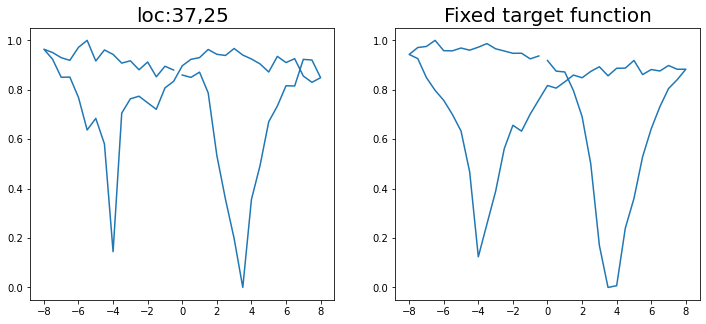

Epoch 1/200 ... Training loss: 2.7703
Epoch 10/200 ... Training loss: 2.6349
Epoch 20/200 ... Training loss: 2.4236
Epoch 30/200 ... Training loss: 2.2544
Epoch 40/200 ... Training loss: 2.122
Epoch 50/200 ... Training loss: 1.9044
Epoch 60/200 ... Training loss: 1.7384
Epoch 70/200 ... Training loss: 1.5327
Epoch 80/200 ... Training loss: 1.445
Epoch 90/200 ... Training loss: 1.414
Epoch 100/200 ... Training loss: 1.2746
Epoch 110/200 ... Training loss: 1.2213
Epoch 120/200 ... Training loss: 1.4379
Epoch 130/200 ... Training loss: 1.159
Epoch 140/200 ... Training loss: 1.1437
Epoch 150/200 ... Training loss: 1.1182
Epoch 160/200 ... Training loss: 1.0091
Epoch 170/200 ... Training loss: 1.0411
Epoch 180/200 ... Training loss: 0.9461
Epoch 190/200 ... Training loss: 0.9006
Epoch 200/200 ... Training loss: 0.9459
step:  186
Sample #196




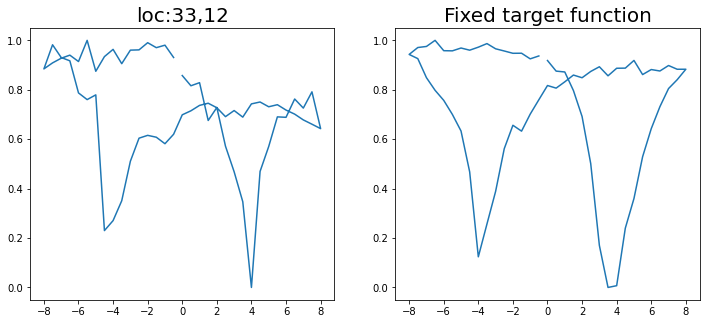

Epoch 1/200 ... Training loss: 2.7615
Epoch 10/200 ... Training loss: 2.629
Epoch 20/200 ... Training loss: 2.4995
Epoch 30/200 ... Training loss: 2.244
Epoch 40/200 ... Training loss: 2.0538
Epoch 50/200 ... Training loss: 1.8054
Epoch 60/200 ... Training loss: 1.6775
Epoch 70/200 ... Training loss: 1.5236
Epoch 80/200 ... Training loss: 1.4096
Epoch 90/200 ... Training loss: 1.3368
Epoch 100/200 ... Training loss: 1.2624
Epoch 110/200 ... Training loss: 1.26
Epoch 120/200 ... Training loss: 1.2068
Epoch 130/200 ... Training loss: 1.168
Epoch 140/200 ... Training loss: 1.1366
Epoch 150/200 ... Training loss: 1.0563
Epoch 160/200 ... Training loss: 1.0708
Epoch 170/200 ... Training loss: 1.0242
Epoch 180/200 ... Training loss: 0.9846
Epoch 190/200 ... Training loss: 0.979
Epoch 200/200 ... Training loss: 1.0388
step:  187
Sample #197




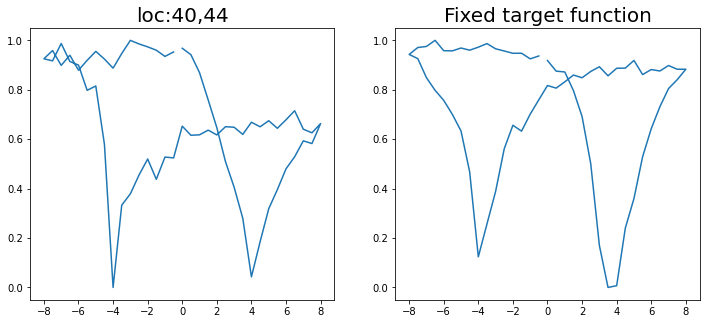

Epoch 1/200 ... Training loss: 2.7542
Epoch 10/200 ... Training loss: 2.6308
Epoch 20/200 ... Training loss: 2.4913
Epoch 30/200 ... Training loss: 2.3455
Epoch 40/200 ... Training loss: 2.1574
Epoch 50/200 ... Training loss: 1.9624
Epoch 60/200 ... Training loss: 1.8067
Epoch 70/200 ... Training loss: 1.5935
Epoch 80/200 ... Training loss: 1.4694
Epoch 90/200 ... Training loss: 1.358
Epoch 100/200 ... Training loss: 1.2953
Epoch 110/200 ... Training loss: 1.2615
Epoch 120/200 ... Training loss: 1.2016
Epoch 130/200 ... Training loss: 1.1378
Epoch 140/200 ... Training loss: 1.1271
Epoch 150/200 ... Training loss: 1.1128
Epoch 160/200 ... Training loss: 1.0629
Epoch 170/200 ... Training loss: 1.0683
Epoch 180/200 ... Training loss: 0.9738
Epoch 190/200 ... Training loss: 1.0259
Epoch 200/200 ... Training loss: 0.9691
step:  188
Sample #198




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


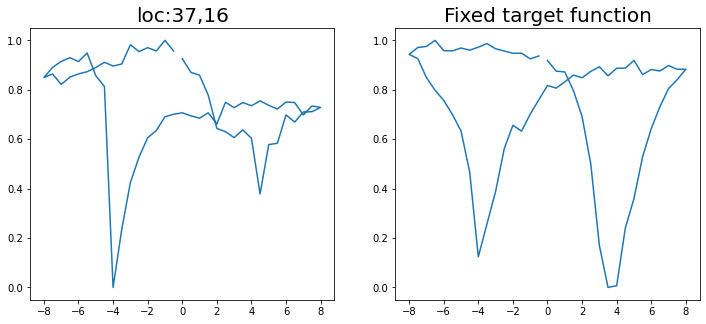

Epoch 1/200 ... Training loss: 2.7556
Epoch 10/200 ... Training loss: 2.6232
Epoch 20/200 ... Training loss: 2.515
Epoch 30/200 ... Training loss: 2.1494
Epoch 40/200 ... Training loss: 2.0639
Epoch 50/200 ... Training loss: 1.8469
Epoch 60/200 ... Training loss: 1.6268
Epoch 70/200 ... Training loss: 1.4572
Epoch 80/200 ... Training loss: 1.3755
Epoch 90/200 ... Training loss: 1.2517
Epoch 100/200 ... Training loss: 1.2499
Epoch 110/200 ... Training loss: 1.1953
Epoch 120/200 ... Training loss: 1.2017
Epoch 130/200 ... Training loss: 1.1081
Epoch 140/200 ... Training loss: 1.0687
Epoch 150/200 ... Training loss: 1.0665
Epoch 160/200 ... Training loss: 1.0352
Epoch 170/200 ... Training loss: 0.9691
Epoch 180/200 ... Training loss: 0.9639
Epoch 190/200 ... Training loss: 1.0669
Epoch 200/200 ... Training loss: 1.0057
step:  189
Sample #199




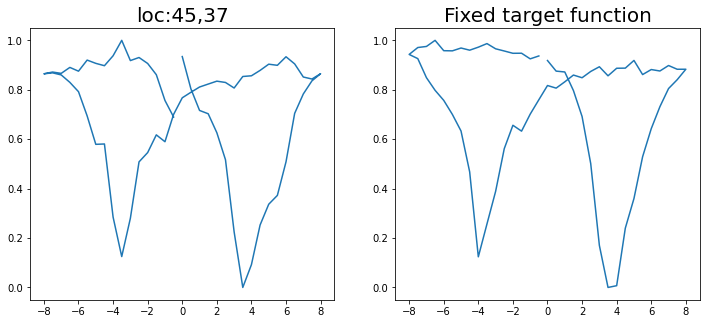

Epoch 1/200 ... Training loss: 2.7537
Epoch 10/200 ... Training loss: 2.5953
Epoch 20/200 ... Training loss: 2.3805
Epoch 30/200 ... Training loss: 2.1515
Epoch 40/200 ... Training loss: 1.8804
Epoch 50/200 ... Training loss: 1.683
Epoch 60/200 ... Training loss: 1.5721
Epoch 70/200 ... Training loss: 1.4487
Epoch 80/200 ... Training loss: 1.3192
Epoch 90/200 ... Training loss: 1.3641
Epoch 100/200 ... Training loss: 1.2471
Epoch 110/200 ... Training loss: 1.1646
Epoch 120/200 ... Training loss: 1.5143
Epoch 130/200 ... Training loss: 1.2923
Epoch 140/200 ... Training loss: 1.1228
Epoch 150/200 ... Training loss: 1.0474
Epoch 160/200 ... Training loss: 1.0603
Epoch 170/200 ... Training loss: 1.0199
Epoch 180/200 ... Training loss: 1.0027
Epoch 190/200 ... Training loss: 1.1652
Epoch 200/200 ... Training loss: 1.0255
step:  190
Sample #200




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


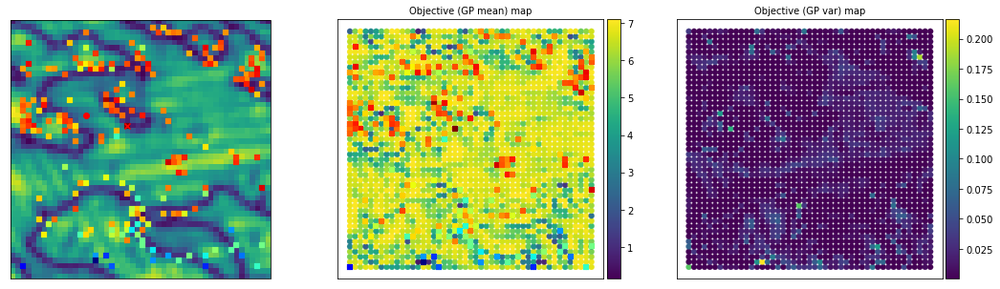

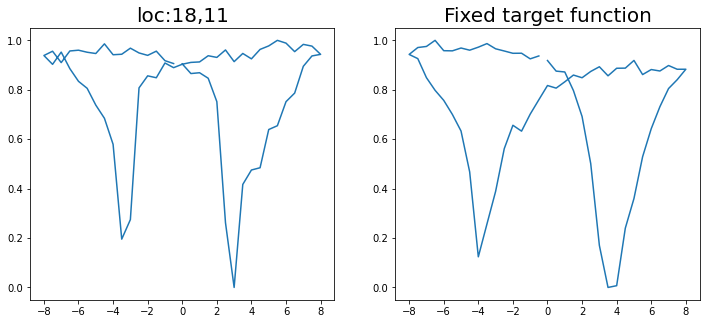

Epoch 1/200 ... Training loss: 2.7466
Epoch 10/200 ... Training loss: 2.6009
Epoch 20/200 ... Training loss: 2.4774
Epoch 30/200 ... Training loss: 2.3104
Epoch 40/200 ... Training loss: 2.1155
Epoch 50/200 ... Training loss: 1.8967
Epoch 60/200 ... Training loss: 1.7978
Epoch 70/200 ... Training loss: 1.6767
Epoch 80/200 ... Training loss: 1.4956
Epoch 90/200 ... Training loss: 1.3648
Epoch 100/200 ... Training loss: 1.3333
Epoch 110/200 ... Training loss: 1.3072
Epoch 120/200 ... Training loss: 1.381
Epoch 130/200 ... Training loss: 1.2461
Epoch 140/200 ... Training loss: 1.1702
Epoch 150/200 ... Training loss: 1.1336
Epoch 160/200 ... Training loss: 1.1844
Epoch 170/200 ... Training loss: 1.101
Epoch 180/200 ... Training loss: 1.0487
Epoch 190/200 ... Training loss: 1.0593
Epoch 200/200 ... Training loss: 1.0219
step:  191
Sample #201




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


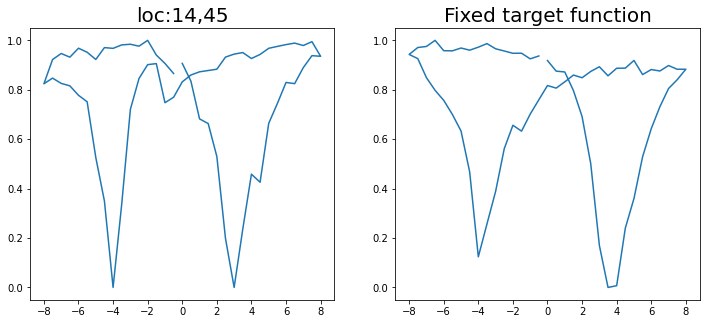

Epoch 1/200 ... Training loss: 2.74
Epoch 10/200 ... Training loss: 2.5842
Epoch 20/200 ... Training loss: 2.3877
Epoch 30/200 ... Training loss: 2.1518
Epoch 40/200 ... Training loss: 1.8673
Epoch 50/200 ... Training loss: 1.703
Epoch 60/200 ... Training loss: 1.7481
Epoch 70/200 ... Training loss: 1.5793
Epoch 80/200 ... Training loss: 1.373
Epoch 90/200 ... Training loss: 1.301
Epoch 100/200 ... Training loss: 1.223
Epoch 110/200 ... Training loss: 1.3187
Epoch 120/200 ... Training loss: 1.1677
Epoch 130/200 ... Training loss: 1.1526
Epoch 140/200 ... Training loss: 1.0666
Epoch 150/200 ... Training loss: 1.13
Epoch 160/200 ... Training loss: 1.0504
Epoch 170/200 ... Training loss: 1.2758
Epoch 180/200 ... Training loss: 1.0305
Epoch 190/200 ... Training loss: 0.9751
Epoch 200/200 ... Training loss: 0.9032
step:  192
Sample #202




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


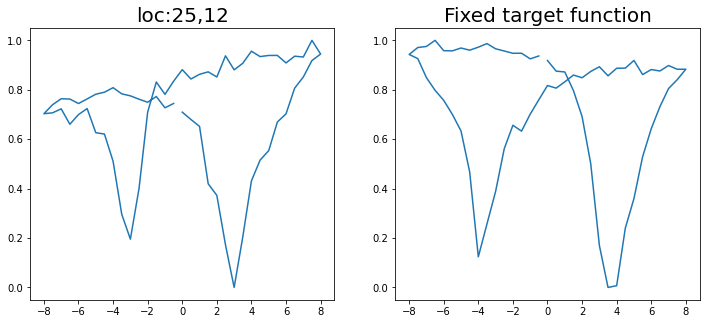

Epoch 1/200 ... Training loss: 2.7314
Epoch 10/200 ... Training loss: 2.5987
Epoch 20/200 ... Training loss: 2.4901
Epoch 30/200 ... Training loss: 2.3932
Epoch 40/200 ... Training loss: 2.1776
Epoch 50/200 ... Training loss: 2.02
Epoch 60/200 ... Training loss: 1.7811
Epoch 70/200 ... Training loss: 1.6471
Epoch 80/200 ... Training loss: 1.5656
Epoch 90/200 ... Training loss: 1.4838
Epoch 100/200 ... Training loss: 1.3935
Epoch 110/200 ... Training loss: 1.3625
Epoch 120/200 ... Training loss: 1.3492
Epoch 130/200 ... Training loss: 1.3492
Epoch 140/200 ... Training loss: 1.225
Epoch 150/200 ... Training loss: 1.171
Epoch 160/200 ... Training loss: 1.2075
Epoch 170/200 ... Training loss: 1.1213
Epoch 180/200 ... Training loss: 1.1185
Epoch 190/200 ... Training loss: 1.018
Epoch 200/200 ... Training loss: 1.0313
step:  193
Sample #203




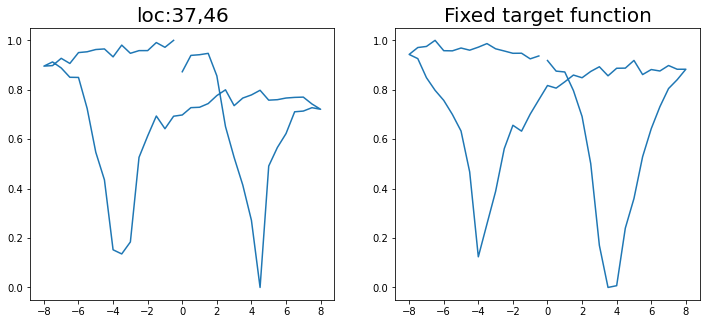

Epoch 1/200 ... Training loss: 2.7246
Epoch 10/200 ... Training loss: 2.5675
Epoch 20/200 ... Training loss: 2.3852
Epoch 30/200 ... Training loss: 2.1803
Epoch 40/200 ... Training loss: 1.8924
Epoch 50/200 ... Training loss: 1.6716
Epoch 60/200 ... Training loss: 1.5688
Epoch 70/200 ... Training loss: 1.5694
Epoch 80/200 ... Training loss: 1.4851
Epoch 90/200 ... Training loss: 1.4298
Epoch 100/200 ... Training loss: 1.2806
Epoch 110/200 ... Training loss: 1.2099
Epoch 120/200 ... Training loss: 1.2311
Epoch 130/200 ... Training loss: 1.1657
Epoch 140/200 ... Training loss: 1.0818
Epoch 150/200 ... Training loss: 1.0341
Epoch 160/200 ... Training loss: 1.0248
Epoch 170/200 ... Training loss: 0.9585
Epoch 180/200 ... Training loss: 1.3549
Epoch 190/200 ... Training loss: 0.9851
Epoch 200/200 ... Training loss: 0.8877
step:  194
Sample #204




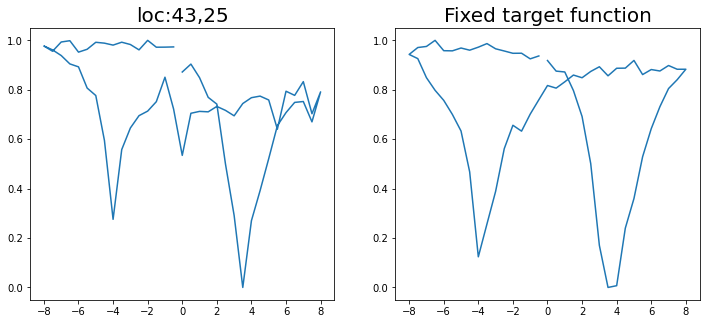

Epoch 1/200 ... Training loss: 2.7168
Epoch 10/200 ... Training loss: 2.5554
Epoch 20/200 ... Training loss: 2.384
Epoch 30/200 ... Training loss: 2.2361
Epoch 40/200 ... Training loss: 1.9782
Epoch 50/200 ... Training loss: 1.78
Epoch 60/200 ... Training loss: 1.6476
Epoch 70/200 ... Training loss: 1.5029
Epoch 80/200 ... Training loss: 1.4267
Epoch 90/200 ... Training loss: 1.3239
Epoch 100/200 ... Training loss: 1.4324
Epoch 110/200 ... Training loss: 1.2713
Epoch 120/200 ... Training loss: 1.1605
Epoch 130/200 ... Training loss: 1.1991
Epoch 140/200 ... Training loss: 1.0929
Epoch 150/200 ... Training loss: 1.0703
Epoch 160/200 ... Training loss: 0.9962
Epoch 170/200 ... Training loss: 1.052
Epoch 180/200 ... Training loss: 0.944
Epoch 190/200 ... Training loss: 0.9723
Epoch 200/200 ... Training loss: 0.9299
step:  195
Sample #205




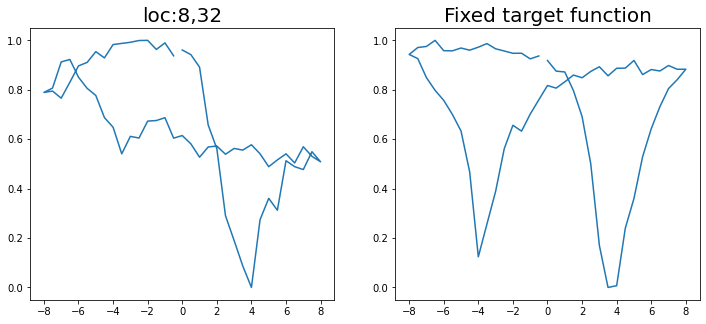

Epoch 1/200 ... Training loss: 2.731
Epoch 10/200 ... Training loss: 2.6012
Epoch 20/200 ... Training loss: 2.4914
Epoch 30/200 ... Training loss: 2.3867
Epoch 40/200 ... Training loss: 2.169
Epoch 50/200 ... Training loss: 1.9601
Epoch 60/200 ... Training loss: 1.748
Epoch 70/200 ... Training loss: 1.6656
Epoch 80/200 ... Training loss: 1.5831
Epoch 90/200 ... Training loss: 1.5126
Epoch 100/200 ... Training loss: 1.4673
Epoch 110/200 ... Training loss: 1.3687
Epoch 120/200 ... Training loss: 1.3143
Epoch 130/200 ... Training loss: 1.2208
Epoch 140/200 ... Training loss: 1.1627
Epoch 150/200 ... Training loss: 1.1904
Epoch 160/200 ... Training loss: 1.0711
Epoch 170/200 ... Training loss: 1.0151
Epoch 180/200 ... Training loss: 1.0913
Epoch 190/200 ... Training loss: 1.018
Epoch 200/200 ... Training loss: 0.9351
step:  196
Sample #206




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:259: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


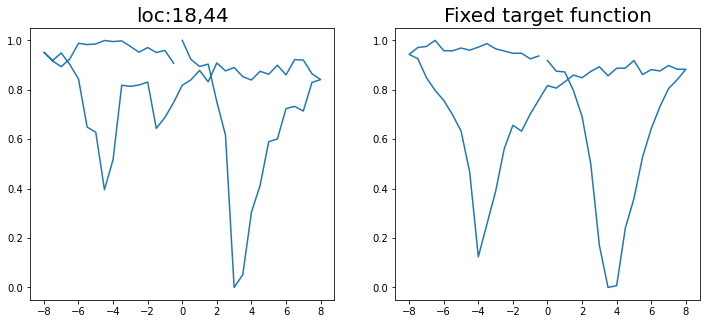

Epoch 1/200 ... Training loss: 2.7217
Epoch 10/200 ... Training loss: 2.569
Epoch 20/200 ... Training loss: 2.3768
Epoch 30/200 ... Training loss: 2.1255
Epoch 40/200 ... Training loss: 1.9196
Epoch 50/200 ... Training loss: 1.6693
Epoch 60/200 ... Training loss: 1.5592
Epoch 70/200 ... Training loss: 1.4373
Epoch 80/200 ... Training loss: 1.295
Epoch 90/200 ... Training loss: 1.2173
Epoch 100/200 ... Training loss: 1.2843
Epoch 110/200 ... Training loss: 1.2026
Epoch 120/200 ... Training loss: 1.145
Epoch 130/200 ... Training loss: 1.1035
Epoch 140/200 ... Training loss: 1.0135
Epoch 150/200 ... Training loss: 0.9829
Epoch 160/200 ... Training loss: 0.9828
Epoch 170/200 ... Training loss: 0.9686
Epoch 180/200 ... Training loss: 0.8948
Epoch 190/200 ... Training loss: 0.8407
Epoch 200/200 ... Training loss: 0.8241
step:  197
Sample #207




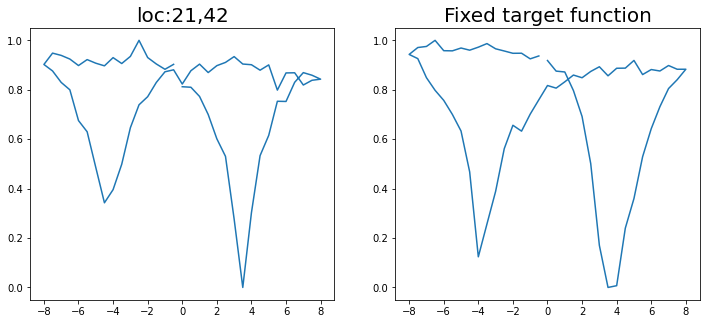

Epoch 1/200 ... Training loss: 2.7148
Epoch 10/200 ... Training loss: 2.3528
Epoch 20/200 ... Training loss: 2.4494
Epoch 30/200 ... Training loss: 2.1169
Epoch 40/200 ... Training loss: 1.9238
Epoch 50/200 ... Training loss: 1.691
Epoch 60/200 ... Training loss: 1.6045
Epoch 70/200 ... Training loss: 1.5582
Epoch 80/200 ... Training loss: 1.4252
Epoch 90/200 ... Training loss: 1.3728
Epoch 100/200 ... Training loss: 1.2968
Epoch 110/200 ... Training loss: 1.1709
Epoch 120/200 ... Training loss: 1.0987
Epoch 130/200 ... Training loss: 1.1152
Epoch 140/200 ... Training loss: 1.032
Epoch 150/200 ... Training loss: 1.0882
Epoch 160/200 ... Training loss: 1.0516
Epoch 170/200 ... Training loss: 0.9229
Epoch 180/200 ... Training loss: 0.906
Epoch 190/200 ... Training loss: 0.8552
Epoch 200/200 ... Training loss: 0.8166
step:  198
Sample #208




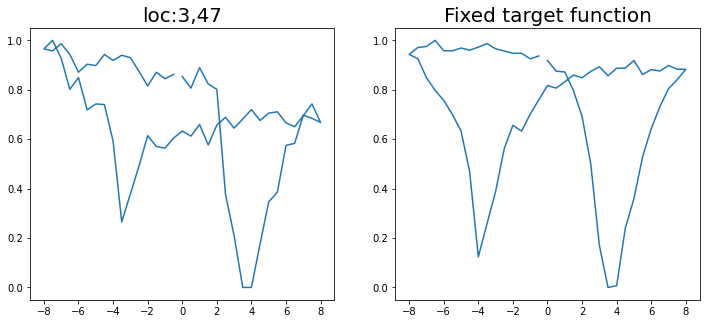

Epoch 1/200 ... Training loss: 2.7082
Epoch 10/200 ... Training loss: 2.5743
Epoch 20/200 ... Training loss: 2.4669
Epoch 30/200 ... Training loss: 2.3497
Epoch 40/200 ... Training loss: 2.1029
Epoch 50/200 ... Training loss: 1.8113
Epoch 60/200 ... Training loss: 1.6827
Epoch 70/200 ... Training loss: 1.6277
Epoch 80/200 ... Training loss: 1.5284
Epoch 90/200 ... Training loss: 1.4642
Epoch 100/200 ... Training loss: 1.324
Epoch 110/200 ... Training loss: 1.2318
Epoch 120/200 ... Training loss: 1.1823
Epoch 130/200 ... Training loss: 1.1827
Epoch 140/200 ... Training loss: 1.3439
Epoch 150/200 ... Training loss: 1.1234
Epoch 160/200 ... Training loss: 1.0505
Epoch 170/200 ... Training loss: 1.0883
Epoch 180/200 ... Training loss: 0.9842
Epoch 190/200 ... Training loss: 0.9777
Epoch 200/200 ... Training loss: 0.9675
step:  199
Sample #209




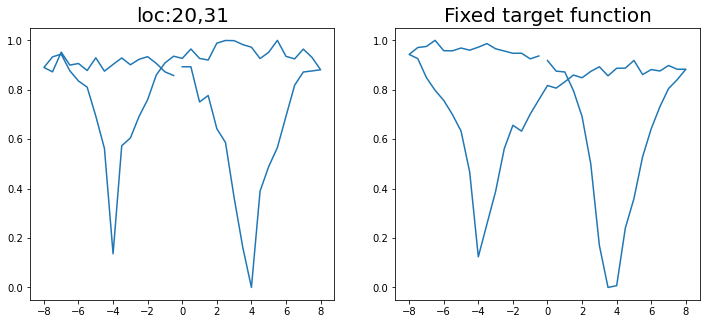

Epoch 1/200 ... Training loss: 2.7024
Epoch 10/200 ... Training loss: 2.4175
Epoch 20/200 ... Training loss: 2.471
Epoch 30/200 ... Training loss: 2.3823
Epoch 40/200 ... Training loss: 2.2973
Epoch 50/200 ... Training loss: 2.049
Epoch 60/200 ... Training loss: 1.9994
Epoch 70/200 ... Training loss: 1.7973
Epoch 80/200 ... Training loss: 1.6748
Epoch 90/200 ... Training loss: 1.5843
Epoch 100/200 ... Training loss: 1.5081
Epoch 110/200 ... Training loss: 1.443
Epoch 120/200 ... Training loss: 1.3589
Epoch 130/200 ... Training loss: 1.3572
Epoch 140/200 ... Training loss: 1.2364
Epoch 150/200 ... Training loss: 1.3465
Epoch 160/200 ... Training loss: 1.1927
Epoch 170/200 ... Training loss: 1.1243
Epoch 180/200 ... Training loss: 1.1708
Epoch 190/200 ... Training loss: 1.0704
Epoch 200/200 ... Training loss: 1.0484
step:  200
Sample #210




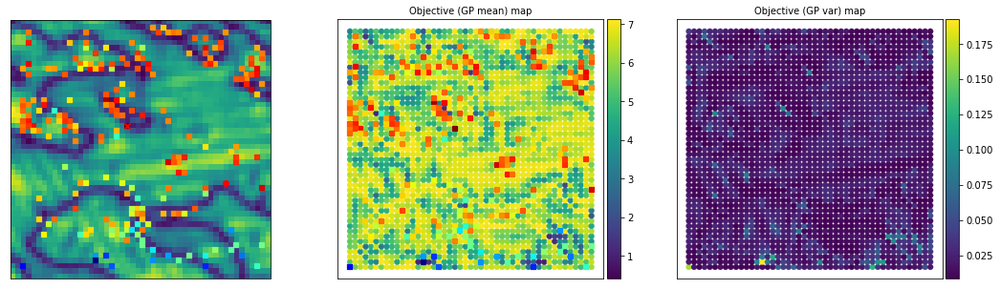

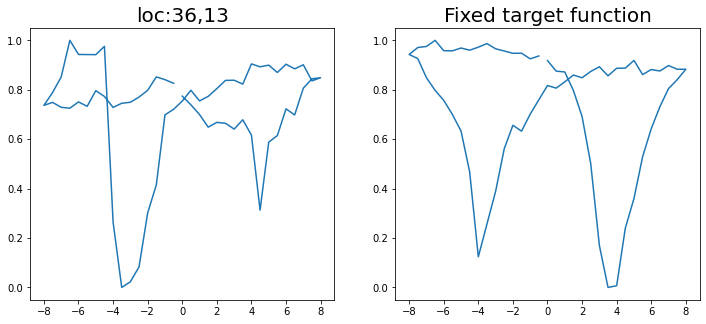

Epoch 1/200 ... Training loss: 2.7089
Epoch 10/200 ... Training loss: 2.5651
Epoch 20/200 ... Training loss: 2.412
Epoch 30/200 ... Training loss: 2.2827
Epoch 40/200 ... Training loss: 2.1264
Epoch 50/200 ... Training loss: 1.9226
Epoch 60/200 ... Training loss: 1.7349
Epoch 70/200 ... Training loss: 1.5947
Epoch 80/200 ... Training loss: 1.5097
Epoch 90/200 ... Training loss: 1.4255
Epoch 100/200 ... Training loss: 1.3712
Epoch 110/200 ... Training loss: 1.3783
Epoch 120/200 ... Training loss: 1.2473
Epoch 130/200 ... Training loss: 1.1923
Epoch 140/200 ... Training loss: 1.1694
Epoch 150/200 ... Training loss: 1.1355
Epoch 160/200 ... Training loss: 1.0788
Epoch 170/200 ... Training loss: 1.0328
Epoch 180/200 ... Training loss: 1.0814
Epoch 190/200 ... Training loss: 0.9621
Epoch 200/200 ... Training loss: 0.9453


#####----Max. sampling reached, model stopped----#####


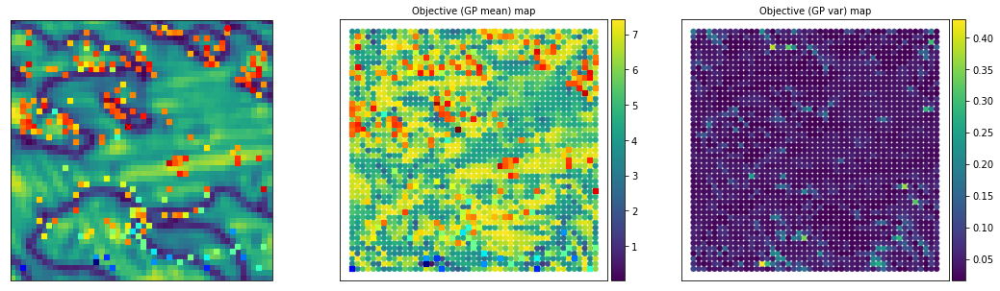

/usr/local/lib/python3.8/dist-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [ ]:
## Gp model fit
# Calling function to fit and optimizize Hyperparameter of Gaussian Process (using Adam optimizer)
# Input args- Torch arrays of normalized training data, parameter X and objective eval Y
# Output args- Gaussian process model lists
switch_obj_index = 0 # This is the index parameter to switch from 0 to 1 when the user satisfy with updating target
#Set up the surrogat emodel
gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

for i in range(1, N + 1):
    print("step: ", i)
    print("Sample #" + str(m + 1)+ "\n\n")
    # Calculate posterior for analysis for intermidiate iterations
    y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_surro, test_X_norm)
        
    #Plot every tenth iteration after running the evaluation
    if ((i == 1) or ((i % 10) == 0)):
        #This will estimate the surrogate
        X_eval, X_GP, _, _ = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
        #print(X_eval, X_GP)
        fig = plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_eval, X_GP, img, i)
        #put the savefig within the plot function
        #fig.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
    #calculate acquisition function
    acq_cand, acq_val, EI_val = play_varTBO.acqmanEI(y_pred_means, y_pred_vars, train_Y, idx)
    val = acq_val
    ind = np.random.choice(acq_cand) # When multiple points have same acq values
    idx = np.hstack((idx, ind))
    #print(new_points_measured, idx)

    ## Find next point which maximizes the learning through exploration-exploitation
    if (i == 1):
        val_ini = val
      # Check for convergence
    if ((val) < 0):  # Stop for negligible expected improvement
        print("Model converged due to sufficient learning over search space ")
        break
    else:
        nextX = np.zeros((1, test_X.shape[1]))
        nextX_norm = np.zeros((1, test_X_norm.shape[1]))
        next_indices = np.zeros((1,2))
        nextX[0,:] = test_X[ind, :]
        nextX_norm [0, :] = test_X_norm[ind, :]
        next_indices[0, :] = indices[ind, :]
        idx_x = int(next_indices[0, 0])
        idx_y = int(next_indices[0, 1])

        next_loc = np.asarray([idx_x, idx_y])
        new_points_measured = idx
        
        #polarization loop area
        IV, points_measured = return_new_measurement(targets, new_points_measured)

        new_iv = IV[points_measured,:]

        #new_spec_x = torch.from_numpy(vdc_vec)
        #new_spec_y = torch.from_numpy(new_iv)[-1]

        new_spec_x = vdc_vec
        new_spec_y = new_iv[-1]

      
        new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
        
        #clear_output(wait=True) Comment out as I need to check the run in colab
        
        eval_spec_y[idx_x, idx_y, :] = new_spec_y
        # Evaluate true function for new data, augment data
        train_X, train_X_norm, train_indices, train_Y, var_params, switch_obj_index, m =\
        play_varTBO.augment_newdata_KL(nextX, nextX_norm, next_indices, train_X, train_X_norm, train_indices, train_Y,
                                        new_spec_x, new_spec_y, eval_spec_y, img, var_params, switch_obj_index, m)


        #print(next_indices)
        # Gp model fit
        # Updating GP with augmented training data
        gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

    ## Final posterior prediction after all the sampling done

if (i == N):
    print("\n\n#####----Max. sampling reached, model stopped----#####")

#Optimal GP learning
gp_opt = gp_surro
# Posterior calculation with converged GP model
y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_opt, test_X_norm)

# Plotting functions to check final iteration
X_opt, X_opt_GP, ind_opt, ind_opt_GP = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img, i)

explored_data = [train_indices, train_indices, train_Y]
final_GP_estim = [y_pred_means, y_pred_vars]
user_votes = var_params[1]
optim_results = [X_opt, X_opt_GP, ind_opt, ind_opt_GP, user_votes, explored_data]

#Save few data
np.save("optim_results", optim_results)